# Synthetic Data II

In this notebook, we aim to investigate the performance of GIRAFFE on a synthetic dataset based on [2]. We benchmark GIRAFFE against other methods in terms of quality of the inferred GRN, and we compute statistics regarding its ability to 

- distinguish enhancing versus inhibitory regulation, 
- and estimating the correct active set of R.

This code reproduces the finding in Section 5.3 in the manuscript. 

## 1. Load required packages

In [1]:
import giraffe
import matplotlib.pyplot as plt
from netZooPy.otter.otter import otter
from netZooPy.panda.panda import Panda 
import notebooks
import numpy as np
from numpy.random import default_rng
import pandas as pd
import random
import scipy
from scipy import stats
from sklearn.metrics import roc_curve, auc

## 2. Create synthetic data

Based on the insights from [2], we test GIRAFFE's performance on synthetic data that are not explicitly modeled on GIRAFFE's underlying assumptions. We generate the true regulation matrix R, the PPI network, the gene expression, and the motif. The number of genes, transcription factors, and samples are picked to keep similar proportions as in a typical biological setting. 

In [3]:
TF = 100  # Number of transcription factors
G = 500  # Number of genes
n = 50  # Number of samples

We generate the true regulation matrix R, a sparse matrix where the non-zero entries are i.i.d. draws from a zero centered uniform distribution. 

In [4]:
def generate_regulation(g, tf, sparsity = .1, a = 1) :
    rng = default_rng()
    rvs = stats.uniform(loc = -a, scale = 2 * a).rvs
    R = scipy.sparse.random(g, tf, sparsity, random_state = rng, data_rvs = rvs).A
    return R

The motif is obtained by corrupting the ground-truth GRN R with additive zero-centered gaussian noise. 

In [5]:
def generate_motif(r, noise):
    return r + np.random.normal(0, noise, (r.shape[0], r.shape[1]))

We define two proteins to be interacting if they co-regulate "many" genes. To pick a proper threshold value, we plot the distribution of the number of co-regulated genes. 

(0.0, 910.0)

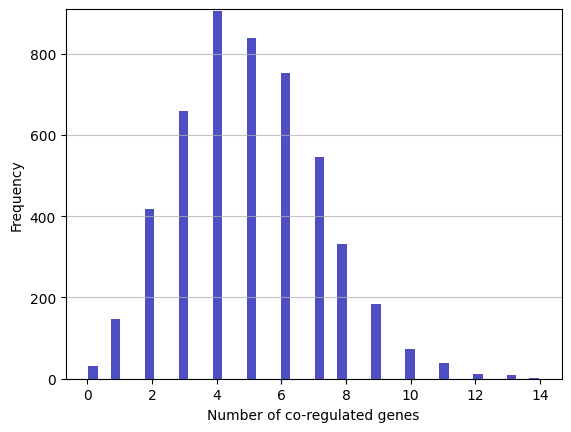

In [6]:
R = generate_regulation(G, TF)

cooperation = []
R[R != 0] = 1
for i in range(TF):
    for j in range(i + 1, TF):
        cooperation.append(R[:, i].dot(R[:, j]))

"The following lines or code are taken from https://realpython.com/python-histograms/ [Accessed on Jan. 13th 2023]"
s, bins, patches = plt.hist(x = cooperation, bins='auto', color='#0504aa', alpha=0.7, rwidth=0.85)
plt.grid(axis='y', alpha = 0.75)
plt.xlabel('Number of co-regulated genes')
plt.ylabel('Frequency')
maxfreq = s.max()
plt.ylim(ymax=np.ceil(maxfreq / 10) * 10 if maxfreq % 10 else maxfreq + 10)

And pick the .7 percentile as threshold value. This allows to have a sparse PPI (similarly as in biological applications), while providing enough information to recover R. 

In [7]:
def generate_ppi(R):
    ppi = np.zeros((R.shape[1], R.shape[1]))
    R[R != 0] = 1
    for i in range(R.shape[1]):
        for j in range(R.shape[1]):
            if i == j :
                ppi[i, j] = 1 # By definition
            else :
                if R[:, i].dot(R[:, j]) >= np.sort(cooperation)[int(len(cooperation) * .7)]:
                    ppi[i, j] = 1
    return ppi

We sample the expression matrix from a multivariate normal with mean zero and a given covariance matrix. 

In [8]:
def generate_expression(C) :
    return np.random.multivariate_normal([0 for i in range(G)], C.T, n).T

## 3. Simulation

We first generate R, PPI, and motif (with different noise settings to study its influence) as described above. The expression matrix is generated using the projection of R. The intuition is that if two genes are highly co-expressed, we expect them to have similar interactions with transcription factors. We recover the estimated regulation and benchmark it against PANDA [1], OTTER [2], and the motif. Moreover we compute statistics to determine
- GIRAFFE's ability to distinguish enhancing versus inhibitory regulation, 
- and estimating the correct active set of R.

Note that neither PANDA nor OTTER are designed to be sparse or to distinguish activation from inhibition. 

In [9]:
def simulation(noise, sparsity = .1, a = 1) :
    R = generate_regulation(G, TF, sparsity, a)
    ppi = generate_ppi(R.copy())
    motif = generate_motif(R, noise)
    expression = generate_expression(R.dot(R.T))

    otter_regulation = otter(motif.T, ppi, np.corrcoef(motif))
    giraffe_regulation = giraffe.Giraffe(expression, motif, ppi, lam = [0.000001, 5, 50, 1, 1], regularization = 1e-6).get_regulation() # Given the generation process, we assign higher weight to the agreement with the covariance matrix. 
    sign_accuracy = notebooks.utils.get_sign_accuracy(R, giraffe_regulation)
    saved_motif = motif.copy()
    motif[motif >= np.quantile(motif, .9)] = 1 # PANDA requires a binary motif
    motif[motif != 1] = 0
    panda_regulation = giraffe.utils.compute_panda_locally(expression, motif, ppi)
    scores = giraffe.utils.plot_auroc(
        R, 
        [otter_regulation.T, giraffe_regulation,panda_regulation, saved_motif], 
        ["OTTER", "Sparse GIRAFFE", "PANDA", "Prior"],
        title = "\u03C3 = " + str(noise)[0:4]
    )
    return scores, sign_accuracy

And we finally run our analysis using different noise settings. 

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.168102  1.993182 -0.664184 -0.684636 -0.117421 -1.257954 -2.393062   
1    4.304028 -1.330222 -2.117325  1.582422  0.276167 -1.494996 -0.762893   
2   -2.356946 -0.745520  0.617012 -0.876421  1.139332  0.847688 -2.206017   
3   -0.709504  0.091930  1.767036  0.389077 -1.205380 -0.140759 -0.606685   
4   -0.730524 -0.493820  2.045254 -4.844173  2.437011 -0.909544  1.689617   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.151698 -1.133992  0.728884  0.759617  0.478560  0.171139  1.470799   
496 -0.368173  0.090695  1.419918  1.154685  0.590518  0.431853  1.189367   
497 

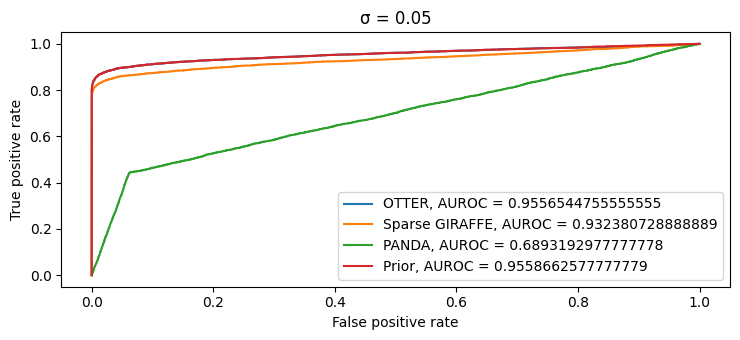

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.144161  1.962549 -0.200182 -1.614411 -0.534892 -2.296673  0.430466   
1    2.818113  1.415746  0.854365  3.776085  0.038107  0.822095  0.638289   
2   -0.687979 -3.038309 -1.489327 -2.495332 -2.002584  0.221215 -0.966827   
3   -1.392804 -0.106621  0.672228  0.730954  3.734250  4.629525  2.300213   
4   -0.456164  2.005630  1.282438 -2.077623  0.466705 -0.781708  0.990824   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.208459 -0.887979 -2.635880 -3.015778 -2.907519  1.125376  1.223335   
496 -1.495681 -2.072320  0.461507 -2.165826  0.858877  0.072844 -2.890258   
497 

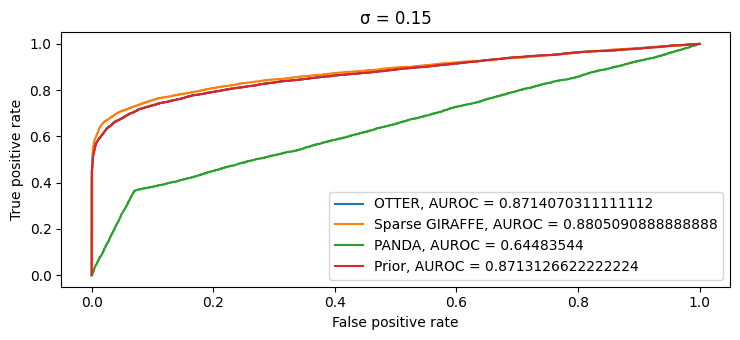

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.843602  1.283379  1.033918  1.170990  2.487088 -1.624842  3.128169   
1   -0.216016 -1.984976 -0.887865  0.319186  0.032244  1.475995 -1.687312   
2   -0.138923 -0.237529  0.575544 -0.088359  0.356854 -0.536538  1.383513   
3    1.268300  0.393030 -0.205050  3.016459 -0.861448  1.578542  1.819083   
4    0.380503 -1.491149 -0.207300 -0.377840  0.084689  2.094561 -1.505678   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.700145  1.168247  1.705739 -2.210552 -0.003493 -0.619108  0.661197   
496 -0.252990 -4.191135 -1.600241 -4.325236 -0.628190  1.694967 -0.467256   
497 

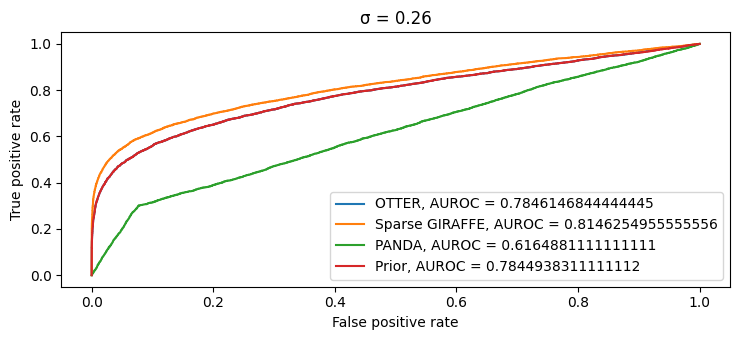

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.695570  0.276334  0.003424 -1.674045 -0.062255  0.494929 -1.492351   
1   -0.392573 -0.213357  0.902977 -1.687003  3.967632  1.917724 -2.099290   
2   -1.712893  0.826262  0.410793 -3.054067 -1.296226 -0.024994 -0.261057   
3   -2.451994  1.750685  0.207965  0.683355 -1.206953 -4.529928  2.517178   
4   -1.131587 -0.818071 -4.413261  0.328171 -3.296778  1.047124 -2.251595   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.282666 -2.797148  2.838528 -1.500208 -0.433850 -0.697086 -6.331890   
496 -1.002392 -1.082891 -0.229483  0.597994 -0.764932 -0.707803 -0.186448   
497 

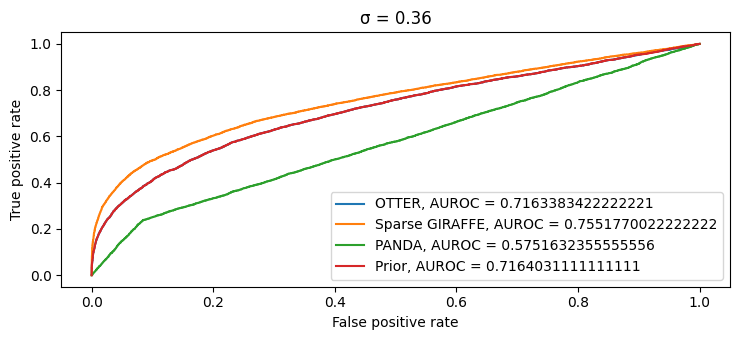

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.023642  1.532939 -2.023607 -0.335474  2.412360  1.403671 -0.427946   
1   -0.373894  0.254815  0.243990 -1.299121  3.852453  5.114420  0.190359   
2   -0.419502  0.883559  1.285256 -0.237248  1.383405 -1.106307 -0.183289   
3   -0.071587 -0.945607 -0.602971  0.522855  0.856408  1.177532 -0.494271   
4   -1.056093 -0.477714  0.974298 -0.866296  0.192946  1.482655  0.730776   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.380676 -0.365701 -2.916915 -0.423431  3.789951  0.649961 -3.447318   
496 -0.448440  1.467859  1.110804  0.872242  0.629164  0.241603  0.518402   
497 

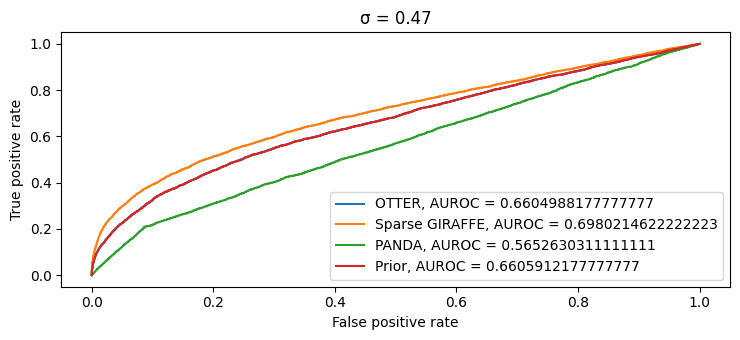

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.359119  2.030673 -1.807306 -1.059403  0.109767 -1.509642 -2.124536   
1    0.378911  2.442586 -0.788004 -1.564864  0.092132 -5.940789  3.886430   
2   -0.779697 -0.446625  0.283967 -2.252428  0.340930  0.705273 -1.192842   
3   -2.398775  0.642320  0.680367  1.672690 -2.921994 -0.197926  3.001197   
4   -0.731936 -0.380522  3.568276  2.304592  1.396129 -0.325342  2.803351   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.650558  1.539037  0.924115 -0.260981 -0.324923  0.506702 -1.161794   
496  0.203757 -1.702330 -1.863964 -2.884936  1.791438 -0.858736 -3.059552   
497 

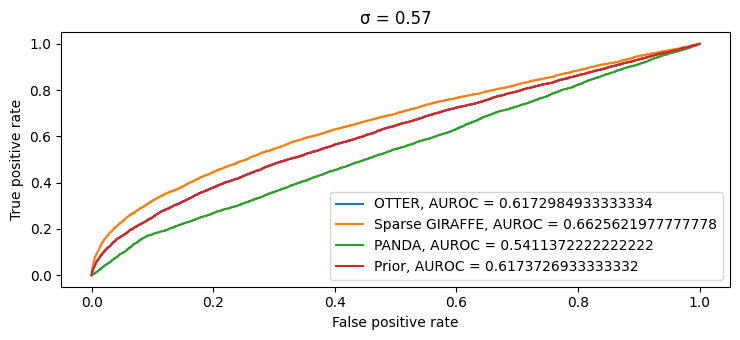

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.727287 -2.752363  0.180800 -1.111974  0.514253  1.111751 -1.793120   
1   -1.544744  0.346868 -2.473502  0.735416  0.392812  0.450545  0.432625   
2   -0.371565  1.966440 -0.920997  0.473906 -1.780347 -1.569310 -0.406464   
3    1.514645  0.632394 -0.929175 -3.614106  2.563322  0.462239  0.912242   
4    1.722732  1.726375 -2.201248 -1.871855  0.339832 -0.343371 -1.809410   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.077020 -1.843644 -3.534783 -0.823535  1.998430  2.993858 -4.342807   
496  0.641081  1.542269 -0.463515  1.060998  0.302798  0.131205  1.262162   
497 

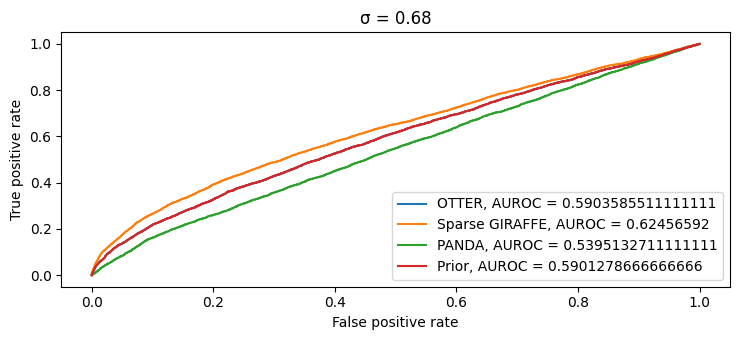

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.115138 -0.046941  1.258764 -0.857817  1.482996 -1.252215  1.571690   
1   -1.176697  1.317365  1.847706  2.415735 -0.343595 -4.419638  0.962323   
2   -0.057707 -2.909079  1.240840  0.384611  4.391107  3.890711  2.374109   
3    0.997710  0.196350  1.889851  0.367849 -1.031974  0.103999 -1.649888   
4   -0.994795  1.445462 -2.224863 -1.003241 -1.913484  0.152237  2.005086   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.202919 -1.070866 -1.699930 -3.310117  0.362507  0.973128  1.086839   
496  1.754357 -0.642455 -2.272661 -0.056464  2.905281  0.654261  2.180142   
497 

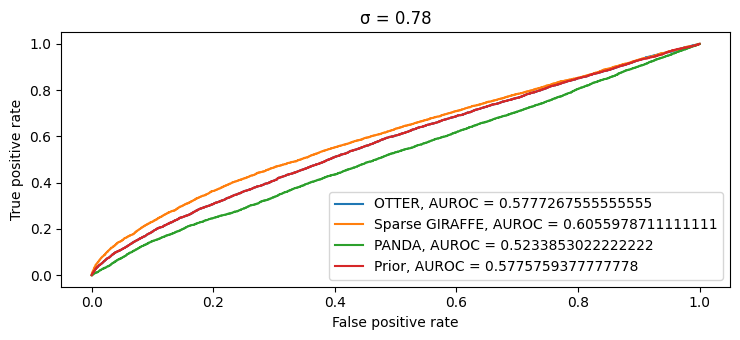

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.916211  0.306333  1.191359  1.526513  0.395694  1.917010 -0.627828   
1    0.599632 -0.063240  4.527345 -1.694723  0.433776  1.368597 -0.800493   
2   -1.298019  1.061594 -1.703268 -0.684321 -0.925692 -2.483970 -0.348760   
3    1.863783 -2.400368  1.308226  1.086933 -0.214775 -0.541473  1.588253   
4   -0.698101 -0.955819 -1.645991  0.800833 -0.399597 -1.533139 -0.046820   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.509383  0.083486 -2.713708 -0.504675  0.073765  1.422999  0.895368   
496  1.447326 -1.795598 -2.447600 -1.085588 -1.058841 -0.061871 -0.213617   
497 

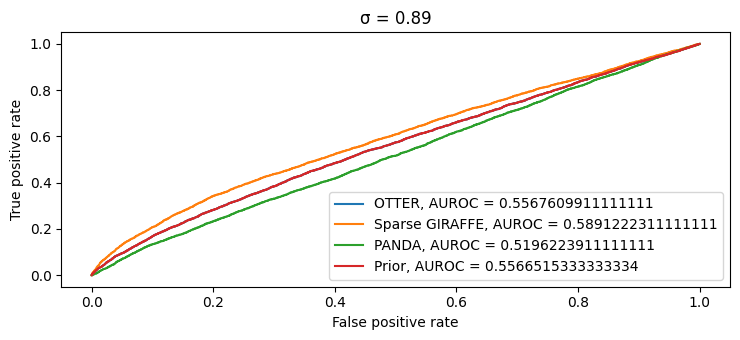

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 100
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.409526 -1.154132 -1.695015  2.830992 -1.737094  0.556378  0.361632   
1   -2.068217 -0.332858 -3.933046 -0.993745 -1.942636  0.901313 -1.569658   
2   -1.012942 -0.442393  0.985579 -0.279973 -1.155821 -2.317614  1.957218   
3   -1.823526  1.643165  0.452041 -2.078274 -1.064740 -0.793350 -1.083374   
4    0.665040  0.841581  2.231522  6.234718  0.768558 -0.087963  2.327511   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.552963  0.245178 -0.431607 -0.136710 -0.050358 -0.780853  0.419482   
496 -2.318206 -0.192973 -0.137966 -0.275981 -0.647048 -1.386825 -2.440340   
497 

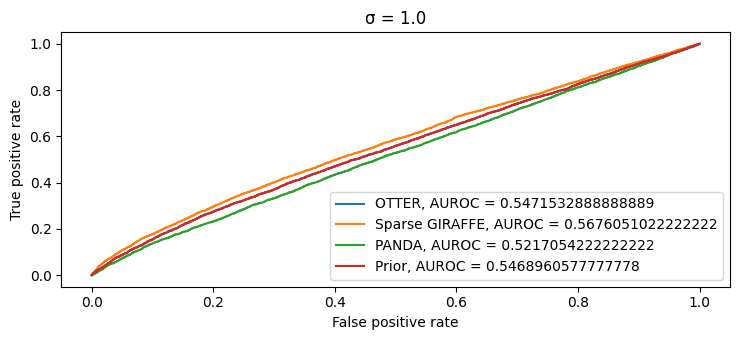

In [99]:
noises = np.linspace(.05, 1, 10)
sign_scores = []
scores = []
for noise in noises:
    score, sign_score = simulation(noise)
    scores.append(score)
    sign_scores.append(sign_score)

## 4. Run multiple times for robustness

To assess the robustness of our estimates, we run B=100 simulations and save the results.

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3814
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.737572 -0.315753  2.228209 -0.938675 -2.826515 -1.465629 -4.432954   
1   -1.736359 -3.601022 -2.511175 -1.109984  1.876741 -1.012426  1.800346   
2    1.751224 -1.306035  0.657400  0.459468  0.636667 -0.264100 -0.051171   
3   -0.066532 -0.751510  3.552118 -0.749556 -1.138442  0.185094 -1.060635   
4    1.837215 -0.241571  1.782034 -0.196154  2.093200 -0.982637  1.547238   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.176337  1.289377  0.335273 -1.062556 -1.725519  1.730255  0.510238   
496  0.858276  2.915083 -2.145732  0.452178  2.311945 -0.080992 -0.220257   
497

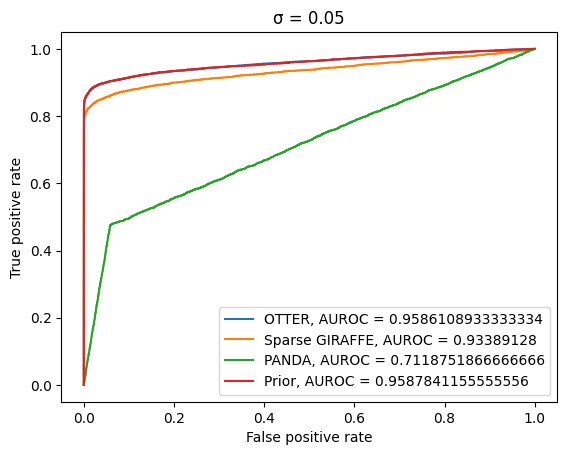

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3876
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.774996 -0.792715  1.478584 -2.534715 -1.409527 -1.580286 -0.535532   
1   -1.786725 -5.330187  3.339479 -2.530553  3.949984  1.639572  1.108024   
2   -1.331462  0.431362  2.124029  0.764525 -0.979680  0.733247 -2.386551   
3    1.681933  1.766307  0.997952 -0.648125  1.703236 -3.257325  1.242086   
4   -1.971310  2.300880  1.686863  0.896885 -0.979270  0.896501 -1.668789   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.931791  1.840201 -0.535479  2.506043  2.229948  2.018941  2.147016   
496 -1.408381 -0.527624  0.157585 -3.550281 -2.171570  1.433985 -0.577390   
497

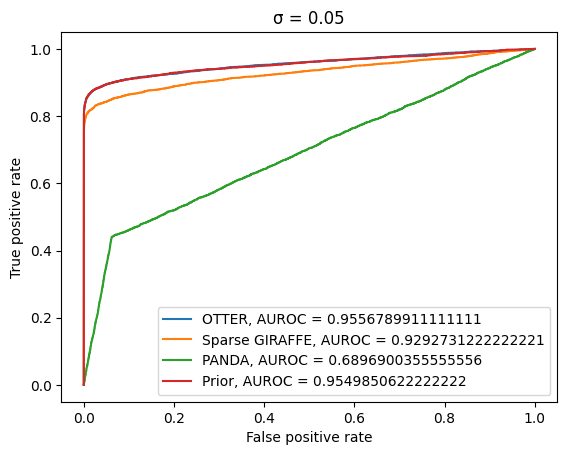

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3864
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.315783  0.900972 -1.137899 -0.808027 -0.537468 -0.460529  1.794858   
1   -0.782986 -0.194638  1.807567 -0.594724  0.031713  0.194662 -0.272212   
2   -1.018324  2.863141 -0.304545 -0.501090  1.608809  3.075940 -1.489665   
3   -0.056555  0.375845  0.629201 -2.156298 -1.854023 -1.529382 -0.609685   
4    1.051508 -0.086425  3.014357 -0.311560  1.030863 -1.652251  2.771728   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.977687 -0.483778 -0.188199 -2.787334  1.572368  1.415359  0.152814   
496  1.484211 -1.942063  1.125761  1.276041  3.445248  1.365811  0.410041   
497

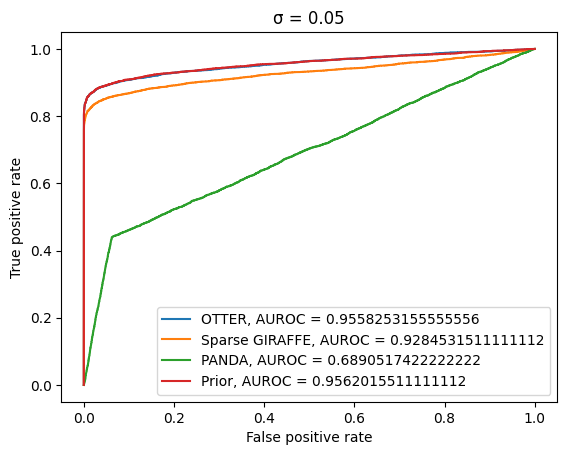

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3874
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.516062  1.652981 -1.298147 -0.392455 -0.856220 -0.297210 -3.993374   
1   -0.077560  0.689875 -0.847245 -1.351693 -0.798166 -2.410140 -0.196574   
2    2.884536 -3.710518 -4.528126 -1.083341 -2.729640 -2.196780  0.151327   
3    0.053676 -2.063013  0.982267  2.452193 -0.389529  0.378130 -2.579232   
4    0.839371 -2.030322  1.074474 -1.317576 -0.674960  3.152360 -3.726478   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.509219 -1.381254  1.339245  0.450392 -1.635323 -0.958766 -0.194162   
496  2.666391 -2.561661 -0.800922 -2.613070  2.403479 -2.325283  3.394466   
497

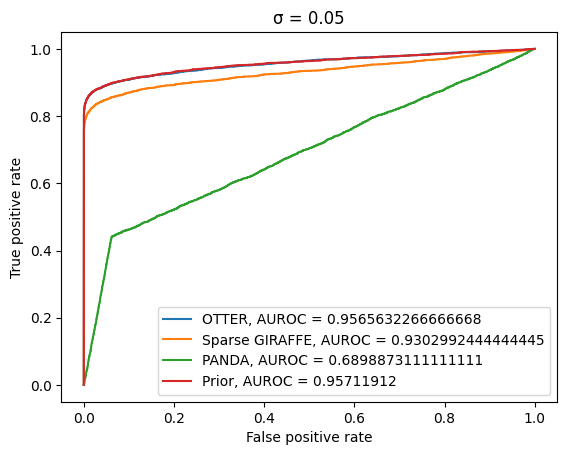

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3886
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.323760 -0.224468  1.766809 -1.877056  1.151126 -0.348944 -1.030211   
1   -4.832322  1.661899  1.349440  2.038390  0.076483 -0.108223  0.317542   
2    0.074277 -1.175617 -0.644412  0.952410 -0.476525 -0.695750  1.091361   
3   -1.208002  2.051357  0.775347 -1.409998 -0.587335 -1.920583  0.970580   
4    0.948289  0.392033 -0.611000 -0.616378  0.505371  0.040955 -0.146709   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.471870 -1.036432  3.342541  1.948196  0.091820 -1.310405  1.743310   
496  0.680530 -1.175812 -0.737785 -0.414644 -1.314624  2.890120 -1.223047   
497

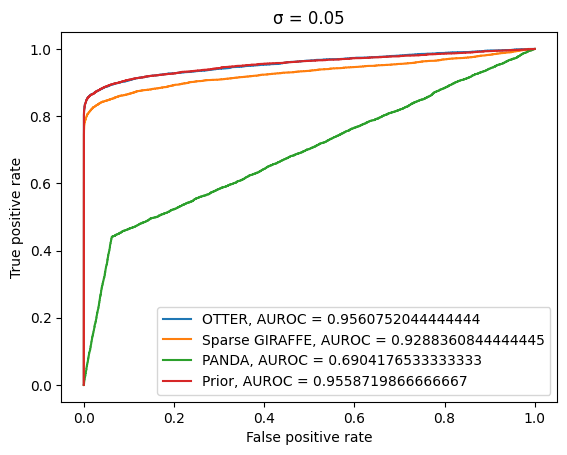

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3840
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.296265 -1.592690  0.312068 -0.696613  0.545913  0.278912  3.085986   
1    3.669233 -0.296010 -2.381061 -2.536260  3.825542 -0.208653  0.689496   
2    0.065162 -1.573007  1.405860 -0.776897 -2.942245 -1.290606  1.203366   
3   -0.418041 -0.920177  0.353686  0.660342  0.564850 -2.340259 -0.353399   
4   -0.262446 -1.270144 -0.738206 -1.626457  0.191040  2.263970 -2.081559   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.427594  2.730793 -0.193814  2.753917  0.893768  1.918350 -0.168520   
496 -2.040532 -0.714163  0.543065 -1.989390 -3.478208 -0.753122  1.310921   
497

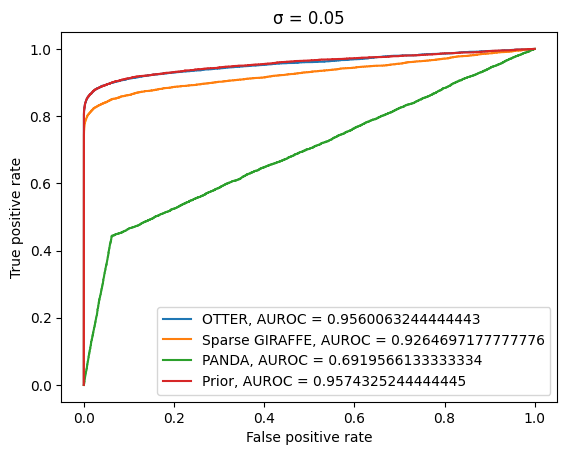

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3962
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.508821  0.746021  0.247093  0.308330  0.602081 -0.286776 -1.795321   
1    2.352661 -2.399216  2.505024 -2.287499  0.096151 -0.371998  0.540250   
2    0.181385  0.763053 -1.676748 -1.463337  0.174996 -1.314165  3.404351   
3   -2.689533  1.134647 -0.489377 -0.201904 -0.517870  0.241979 -1.019608   
4   -2.718705 -1.128060  1.480868  0.690245  0.747471  0.852546  0.676929   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.130649  3.107930  0.561023  2.399378 -2.912353 -2.248507  0.858532   
496 -1.143923 -1.090637 -1.852428  3.408242 -3.171578 -0.397358  0.134927   
497

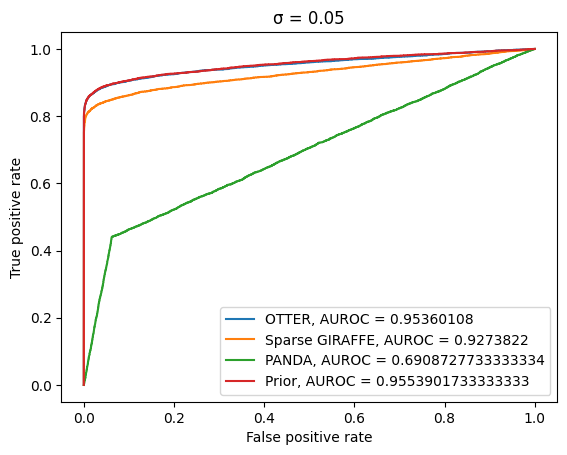

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3900
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.809203  0.516038  0.813405  2.409675  0.132470  2.513530 -1.139171   
1   -1.758487 -0.134840  1.517624  3.639379 -0.835187  1.083785  0.039718   
2    0.097448  1.042193  4.959439  0.284994  2.139397  1.971186  0.227807   
3   -0.098227 -0.294380 -0.363150  1.013017  0.863849  0.073044  1.773815   
4    4.116888  0.615137 -1.290055 -1.239456 -0.367423 -3.133421  2.519105   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.686441  1.092523 -2.574599 -0.155017  1.106200 -0.813242 -0.399556   
496  0.542684  1.161445  0.005153  1.048114  0.280579  0.336826 -2.035405   
497

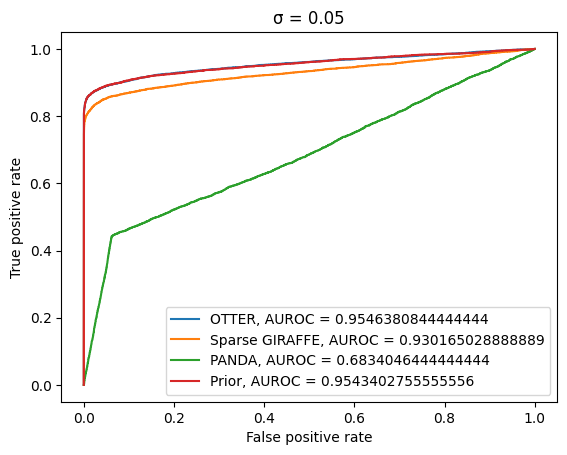

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3842
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.141909  1.466549 -0.075418  0.010763 -0.258253  0.163215  0.506070   
1    0.242121  2.411903 -0.864561  1.025631 -4.286332 -2.375388 -0.037542   
2    1.243837  2.188142  2.314232  3.266016 -0.452687  1.045938  1.724877   
3   -1.085795 -0.392445 -0.985238 -0.979285  1.598099  2.524808 -1.982454   
4   -0.713182  1.661317 -0.892988  3.638861  0.866238  0.596429  0.590386   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.057806 -0.835383 -0.910587 -0.060745  1.835369 -0.031885  0.090556   
496  0.370758  0.554119 -4.625888 -2.337181  3.012450  2.038115  3.052844   
497

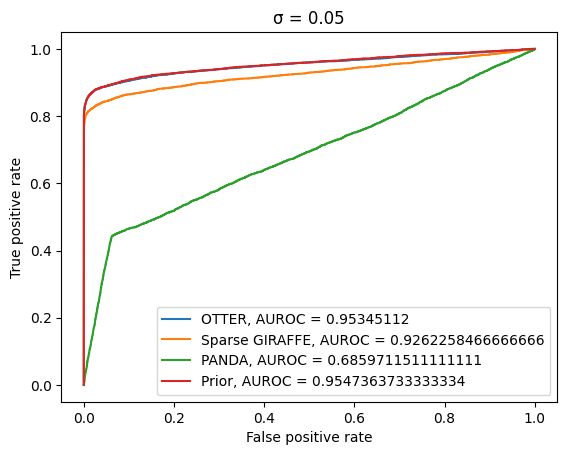

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3866
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.160764  2.893485  0.509313 -1.245862 -0.945270 -1.568308 -0.840538   
1    0.606520  0.515734 -0.362196 -1.413351  1.175479 -1.405671 -1.360642   
2   -0.360302  1.399163  1.409787  0.089527 -0.321656 -2.048497  0.404103   
3   -1.239435  1.698647  1.243658  3.214832 -1.504309  0.318082  6.413626   
4    3.221205 -2.684950  1.312364  0.644680 -0.423999 -0.611398  1.441559   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.409696 -0.121602  2.010209 -2.865530  0.516973  2.373244  1.311317   
496  0.422090  0.560928  1.642024 -5.077287 -1.466577 -1.326802  0.014600   
497

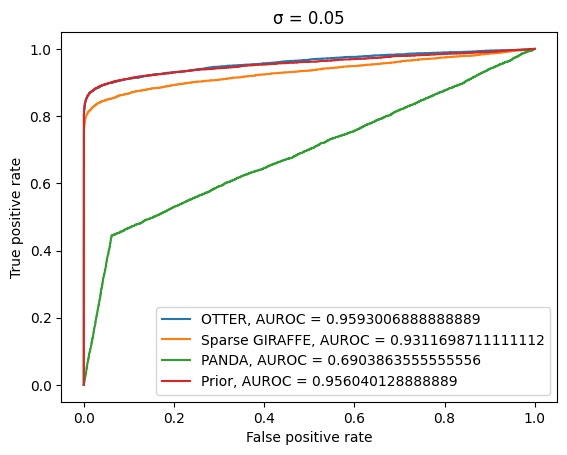

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3846
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.822299 -1.832911 -0.154985  0.216125  1.150561  1.256196  0.827182   
1    2.559123 -0.813597 -2.533030 -3.453040  2.181852  3.438053 -0.030770   
2   -1.022990  0.559471 -1.545114  2.370055  1.730994  0.972807  2.104881   
3   -0.347931 -0.464963 -0.397742  2.740520 -4.062069 -0.968246  1.593802   
4   -3.869931  0.802356 -2.621478  1.154430  0.052336  2.481934 -0.641468   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.873451  3.942883  0.471714  2.153399 -0.968040 -4.050692  2.254226   
496  2.311530  0.737331  0.333352  1.625005  2.441520  0.272065  2.216401   
497

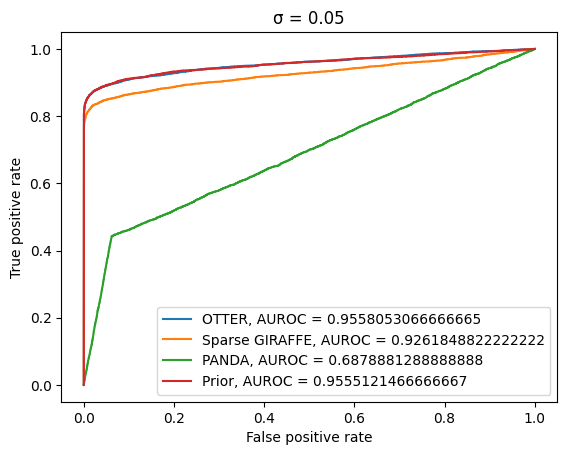

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3960
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    4.106017 -0.240233 -1.945487  0.983241 -0.469611 -1.337887  1.534643   
1    0.400951  0.116215 -0.661580  0.011867 -0.711166  0.560128 -0.046388   
2   -0.222442  0.727775  0.770796  0.213654 -0.769166 -1.304697  1.136825   
3   -0.663865 -1.992223  2.957135  0.329637 -1.405769  2.435776 -1.352632   
4   -0.186731 -0.425873  2.280933 -1.672320 -1.091875 -0.741220 -2.087749   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.408259  0.353074 -0.342917  0.077061 -1.028638 -3.113204 -1.725349   
496 -0.647274 -2.605015  1.006542  2.535524  1.171021 -0.527556  2.464374   
497

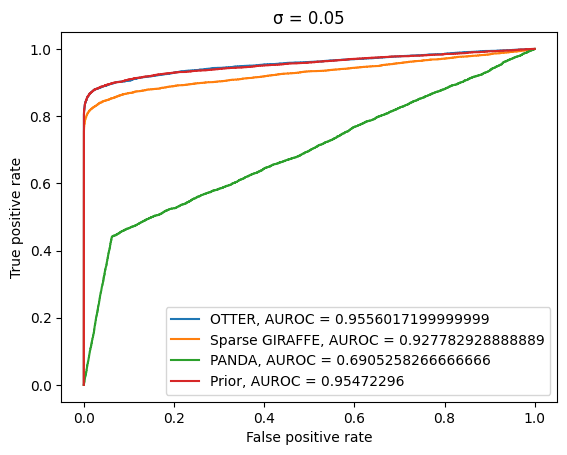

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3934
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.781556  2.648066 -0.521028 -1.820530  1.400617 -2.257671 -3.722281   
1    0.933384  1.190493  1.170114  1.672574 -0.522112  1.124663 -1.039378   
2   -1.484548  2.664220 -0.342365  3.094208 -0.619080 -5.138083  2.375495   
3    0.629099  1.936436  0.659168 -4.270431  2.958082 -5.293318 -0.543624   
4    0.613883  2.500585  0.478736  1.333576 -1.069939 -2.618654  0.426328   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.617546  1.639476 -1.976249  0.584256 -0.425368 -1.707700  0.672190   
496  0.358097  1.632288 -1.435047  2.155195  0.409935  0.694558  1.166745   
497

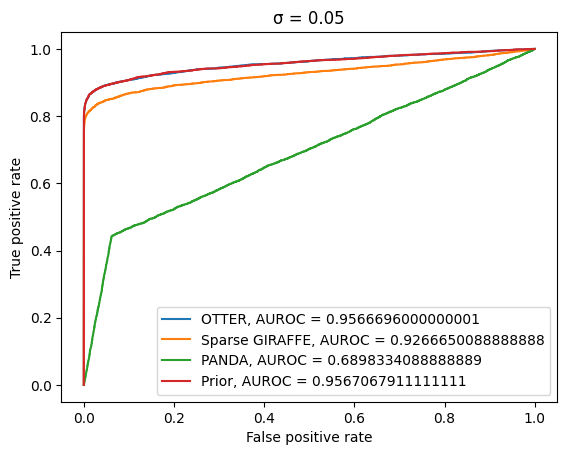

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3950
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    5.439173 -4.398499  1.980883  0.924399 -1.105964  1.672568  1.827541   
1   -3.258341 -0.094444  3.440448  2.588716 -1.047475 -0.842971  1.055291   
2    0.007810 -1.010613  0.646158  1.358181 -1.021831  2.677702  0.367526   
3    0.317176  1.216542  0.324767  0.969557  1.476456  3.361099 -0.556657   
4    2.996553 -0.668546  0.667931  4.738479  2.776171  1.825436 -3.306647   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.376262 -2.842113 -1.400376 -0.309984 -0.090777  0.961365 -3.680636   
496 -2.093715  1.671641  1.256662  1.091342 -0.650851 -3.450094  1.046049   
497

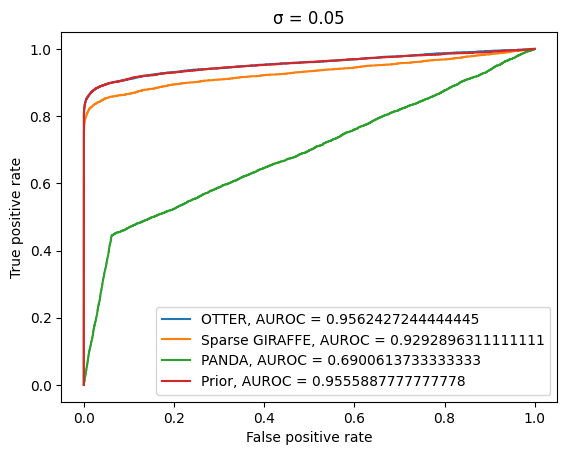

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3884
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.900771 -0.748544 -1.638990  0.833292 -1.565873 -1.363881 -2.411163   
1   -1.021866  0.817858 -0.348383 -0.431881  0.345414 -0.299321 -0.500657   
2    1.763359  1.421198  0.612564  2.889030  1.995000 -0.704020  1.184189   
3   -1.144996  2.553457 -1.099845 -2.513982  0.722531  0.226141  0.287259   
4   -1.299367  1.713734  1.263673 -4.290466  3.950743  0.880467  0.191154   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.303068 -1.274592 -0.417321 -0.515107  1.636453  2.137513 -1.388950   
496  1.176150 -1.872511  0.754308  1.105862  0.973725  0.116121  1.930408   
497

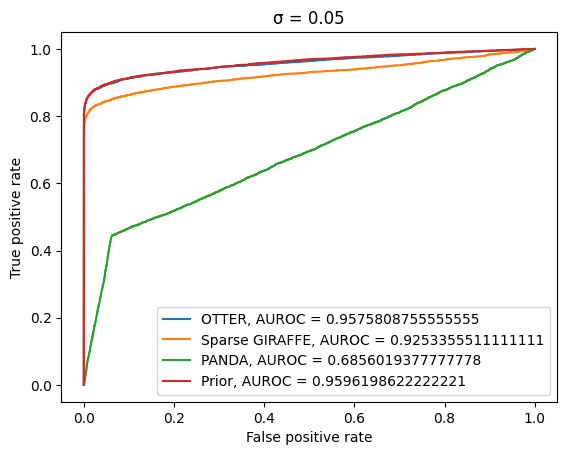

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4024
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.576626 -0.089175 -1.899852  1.417360  0.833220  1.107328 -1.644209   
1   -4.147615 -0.621212 -7.926611 -3.568513 -0.210847  0.265024  0.771276   
2   -1.255747  0.932090  0.369716  2.084461 -0.351405 -0.504068  1.820797   
3   -1.746565  1.828103 -0.443429 -1.837727  3.513108  0.085914  0.540132   
4    2.052670 -2.394432 -0.385841  0.307847  0.416938  1.629909 -0.386792   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.547976 -0.311711  0.561093 -0.407590  0.172839  0.241998 -0.376284   
496 -0.094397  0.246149 -0.202329 -1.312611 -0.052825 -0.186854  0.120924   
497

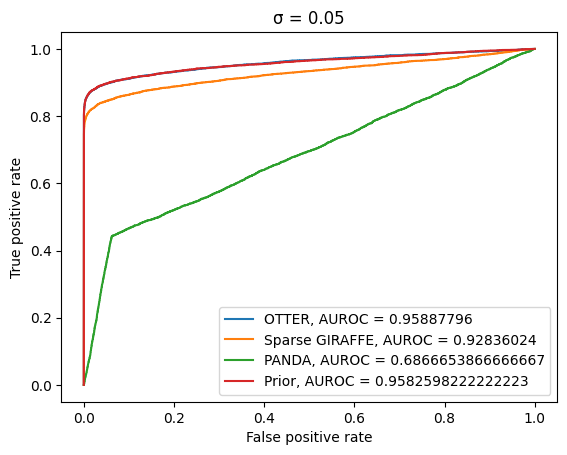

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3932
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.881474 -2.468007 -1.708610  2.292752  0.670428  1.282823  2.984058   
1    1.484544  1.619548 -3.375525 -1.752767  2.676164  1.129101 -4.641069   
2    0.235079  2.133568 -1.701128  0.688954 -3.008322  1.974713 -5.041306   
3   -0.557680 -0.944876  2.897285 -1.929617  0.096307  1.754265 -1.218845   
4   -0.945560 -2.190064  4.113276  1.405167 -1.276452 -0.036152  0.607381   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.817817  4.752247  3.527797  0.237562 -0.062674 -1.393144  5.317681   
496  4.474172 -0.361375 -4.708856 -4.519847  0.355870  3.078877 -0.718317   
497

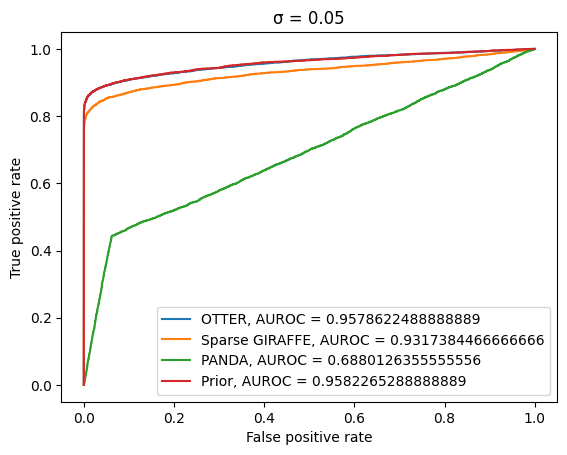

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4086
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.623553  5.032365 -1.083247 -1.108560  1.757772  0.043386 -0.529643   
1    1.887838 -0.504890 -1.288821 -1.597069 -0.420594 -0.885816 -2.433592   
2    2.936109  0.516883  2.235700  0.882825 -0.226785 -2.759984  0.075312   
3   -1.627208  3.009144  2.563058 -3.128539 -1.396415 -0.623151 -2.409166   
4    1.106842  1.917153 -2.496644 -1.935937 -2.048776 -3.073735 -2.102330   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.404085  2.760812  0.421896 -1.464310 -1.486407 -2.719382  1.981848   
496  1.362687 -3.301236 -2.076031 -2.802034  3.715984  1.308225 -0.320405   
497

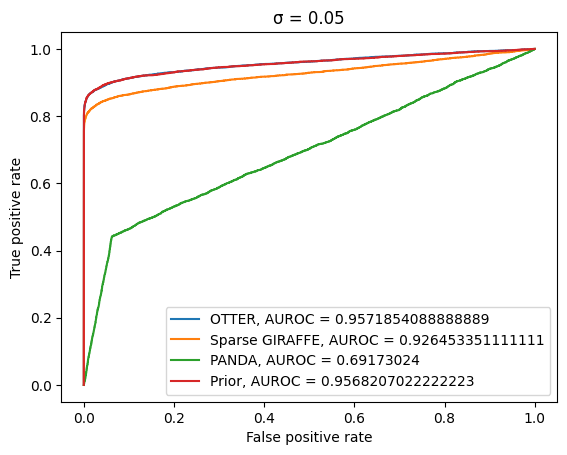

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3988
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.394190  0.137818 -0.654634 -0.653939  1.495815 -2.283830  0.549822   
1    0.856182  3.631470 -2.518197  3.072523 -0.102885 -2.546117  1.374503   
2   -0.810367  0.174981  0.654398  0.146404  0.401908  0.727955  1.451455   
3    2.360968  1.163145  2.719674  0.057115  3.681742 -0.569148 -0.291141   
4   -1.856493  2.395612 -0.723370 -0.704454  0.283105  2.183163  0.976155   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.691824  0.851471  0.571829  0.700452 -0.630620  0.560890  0.575163   
496  3.265530  0.699538 -2.235229 -1.924614  1.534055 -1.660281 -1.144806   
497

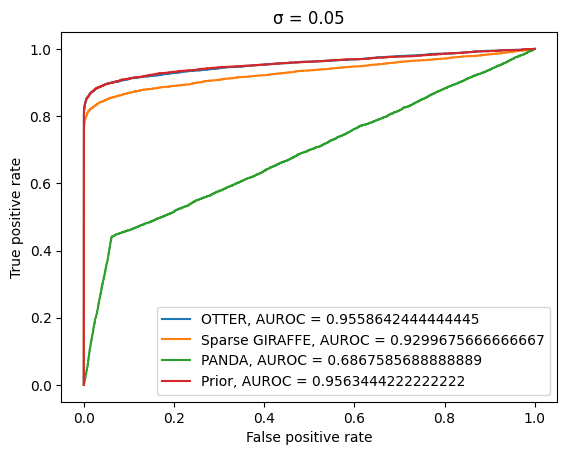

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3948
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.538078  2.658946  1.279397  3.177193  1.184838 -1.876578  1.130390   
1   -1.535029 -0.783638  1.640417  0.255783 -1.503824 -0.096292 -1.170125   
2   -1.153220  1.656848  1.759017 -2.087872 -0.302831  2.184815 -0.238017   
3   -1.334089 -0.856874  1.457887  0.860794 -3.692498 -1.457459 -0.853662   
4   -0.252958 -1.915980  0.141222 -1.077580  1.480024  1.214484 -0.840814   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.589384  0.447037 -0.365997  0.590048 -0.199377 -3.328130  0.141899   
496  1.410293 -0.684061 -3.493232 -0.178857 -0.826731  0.583054  2.051388   
497

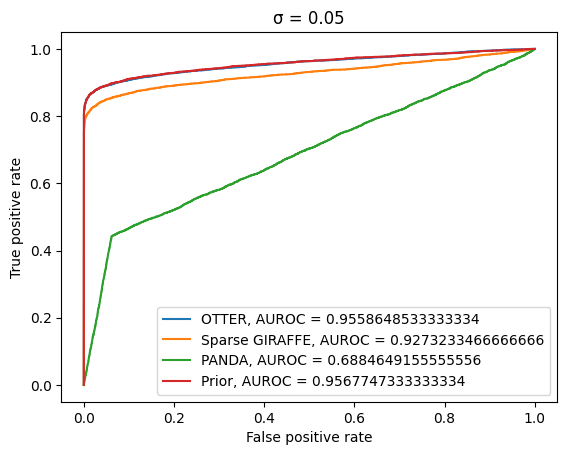

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3964
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.010528  2.144187  0.718994 -1.643806 -1.152108 -0.301292 -0.670999   
1    3.023321  0.918501  0.763546  2.073540  0.931333  0.520996  2.430725   
2   -0.849880 -0.482539  2.415756  1.066795  0.797780  0.720302 -0.051847   
3   -0.525814 -1.725523  2.496459  0.336975  3.519283 -0.681859  0.050878   
4    0.824963  3.923946  3.279244  1.587082 -3.209901 -1.568255  3.986471   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.595986 -1.581514  0.281249 -4.368888 -0.468386 -0.973711  0.548386   
496  1.020072 -1.472052 -3.091961 -0.143643  2.839825  1.968872  1.116551   
497

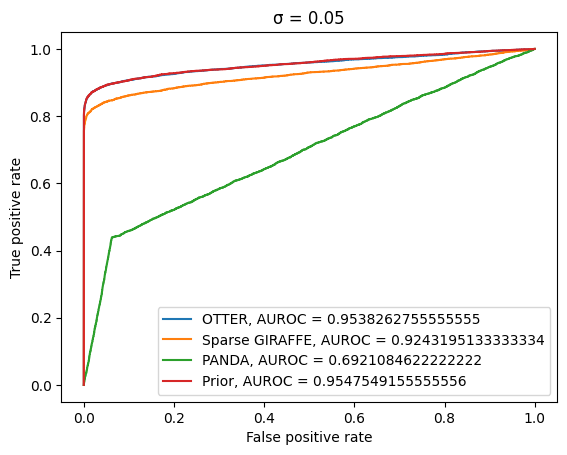

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3714
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.262944  1.609685  0.099323 -1.256704  3.572928 -1.612927 -0.625864   
1   -1.183420  0.079723  1.542299  4.840171 -0.669062 -1.924305  3.997791   
2    1.073253 -3.287837  1.567113  1.505839 -0.329259 -2.308448 -0.584225   
3   -0.394829  1.979885  1.576979 -0.200268 -2.706367  0.941297 -1.982801   
4    2.257415 -0.621582 -0.167880  1.625654  2.416921 -1.958256  3.032915   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.487193  0.421710  2.227428 -2.202526  2.418585  1.854062 -0.138826   
496  0.708727  1.020646  0.100808  0.703155  1.886077 -1.069331  0.579215   
497

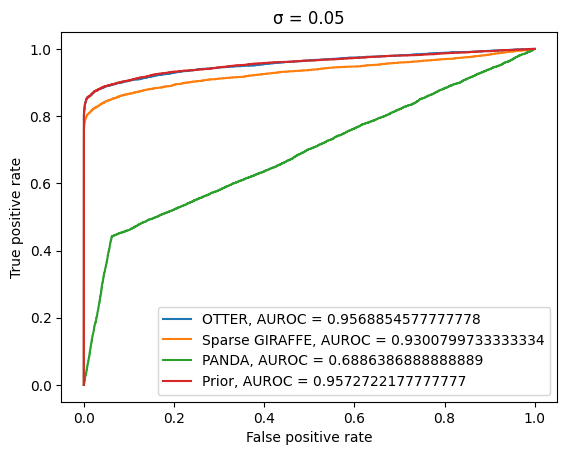

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3862
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.338698 -0.541989  0.229346  1.947778  2.740907 -0.958176  2.612355   
1    1.309290 -0.529250  0.511421  1.496182 -0.775611  0.174573  0.139266   
2    0.539283  0.124098  0.935036 -0.695599 -0.775560  2.032705 -2.381331   
3   -0.827786  0.448070 -4.385227 -2.819962 -0.051220 -1.783964 -0.904643   
4    0.520310  1.220847  1.335599  0.177994  0.555932  0.332249 -0.079003   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.285732  1.252418  3.111758 -1.531479 -0.877737  0.665621 -0.932934   
496 -1.433069  0.094618 -3.834944 -3.833569 -2.378661  0.982585 -0.153106   
497

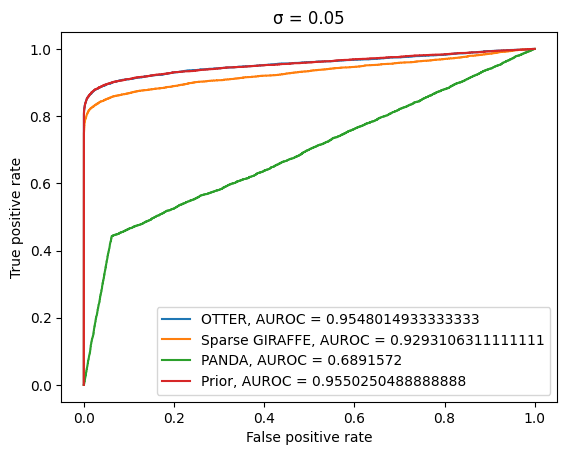

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3826
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.282274 -2.359803  4.120603 -3.013382  0.017996  1.179644 -0.268935   
1   -1.902251  0.402160  0.875923  1.496439 -0.465163  0.443545  1.997308   
2   -2.251215 -0.673432  1.011476 -1.037344  0.991397  1.026454  0.436320   
3   -0.416552  0.756616  0.227132 -1.365411 -0.008420 -0.583275  0.596583   
4   -0.842195 -2.208970  0.264842 -0.393015 -0.113978  3.464171 -0.785972   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.559683 -1.779141 -1.880411  0.109739 -0.994239  0.103110 -1.174782   
496 -1.885921  3.439410 -0.690931  2.495385  3.674158 -0.227461  1.754749   
497

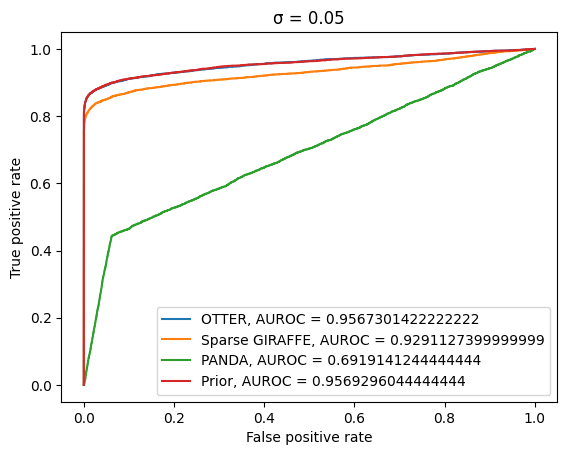

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3852
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.266419  1.142332 -2.075189  2.522720 -0.970496 -0.537426  0.909145   
1    0.531779 -0.304445  2.051961  3.626874 -1.426100 -1.286149  1.498696   
2    2.000869  1.897998 -0.648810  0.595147  2.435356  0.823443  1.805865   
3    0.768657  1.620132  0.855807  0.904509  0.691244 -0.393709 -1.262159   
4   -1.077512  2.911536 -2.719925 -1.904598  0.726622 -0.390686 -1.965115   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.569055 -2.009538 -0.295074  2.214320 -0.480549 -1.934993  4.528780   
496 -0.361205  0.569202  0.366223  1.701053  0.480266 -2.761135  0.348544   
497

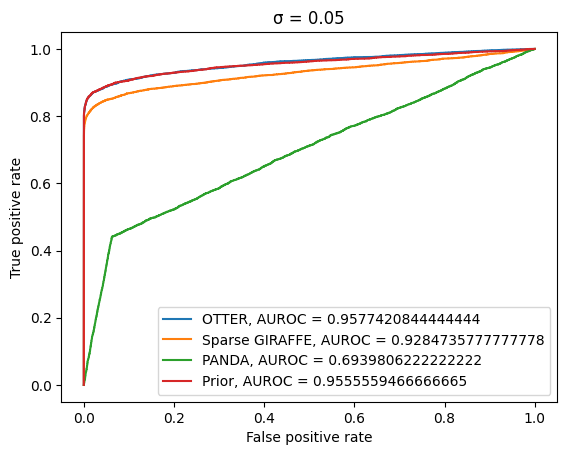

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3806
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.727880 -1.216656  1.450310  3.655714 -2.866794  0.629549  2.849099   
1   -0.632210 -1.306195  1.272544  1.080511 -0.248783  0.105565 -0.523567   
2   -0.539676  0.159437  0.222450 -2.099646 -2.243740 -0.938360 -2.086835   
3   -1.931016 -1.308405  1.866702  1.938757 -1.010785 -0.994201 -0.540569   
4   -0.545905  2.024269 -0.454164  0.176747 -0.624062  0.150273 -0.972909   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.027500 -1.117702 -0.730530 -1.800117 -1.947375 -0.163840  0.081503   
496  1.491093 -1.615967  1.683601 -1.943231 -2.809950 -1.408371  2.473256   
497

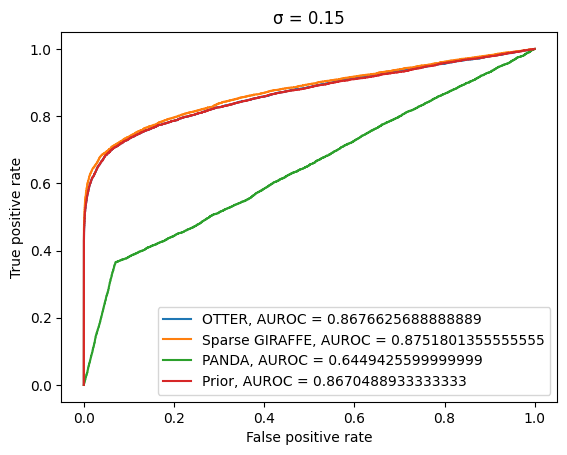

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3928
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.757862  0.265484 -0.573759 -1.618340 -1.303161 -0.909087  1.683619   
1    0.083140  0.991626  1.854560 -0.817068  0.591614  1.331851  1.025470   
2    2.218223 -1.920474 -0.254421  1.176224 -0.351792  1.948736 -0.397220   
3    0.941896 -0.189923  1.040336 -3.095459 -1.926100  2.422980 -1.176954   
4    1.808919  1.920551  0.138450  5.285325 -4.276828 -0.557411  1.188895   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.433273  2.158914  0.832204  2.057339 -2.312790 -0.308802 -0.400554   
496  0.054055  0.520325  1.634306 -2.568744 -0.550998 -1.075660 -1.234527   
497

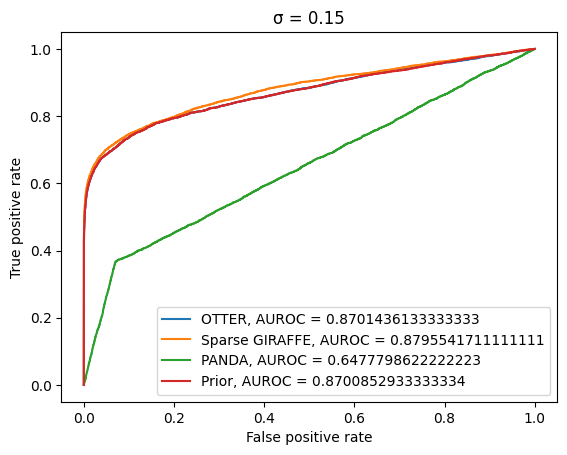

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3850
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.810852  0.066313  1.054631 -1.062301  0.358625 -0.013695 -0.557975   
1   -1.136401  1.156068 -2.465125  3.224773 -2.196475 -1.858506 -0.613396   
2   -0.397918 -0.505467  0.045694  0.175219 -2.429864 -1.153630 -3.490518   
3   -0.674014  1.665530  2.624520  0.302543  1.362981  1.218710 -0.453297   
4   -2.071297 -0.152473  2.673874 -0.777717 -3.695770  0.419827  0.224723   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.932694  2.288373  0.520875  3.640701 -0.107989 -1.929057  3.720088   
496  0.122354  0.061694  0.456365  3.369690 -0.617957  0.036295 -0.356245   
497

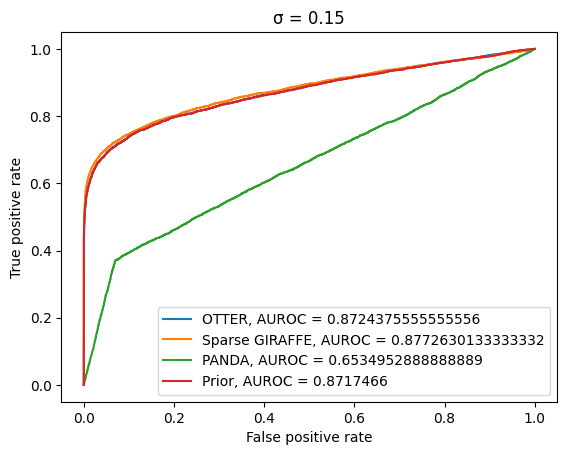

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3990
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.713767 -1.887403 -0.794338  0.171734 -1.135524 -0.886308 -1.485083   
1    1.121074  0.781400 -0.034057 -1.983407  1.712632 -0.969027 -1.749337   
2    0.931132 -0.796957  2.200388  0.108780 -0.076531 -1.859139  0.367405   
3    0.452404 -0.232750  0.353271  0.261580 -1.179063 -1.192160 -2.454272   
4   -1.466403 -0.155530  0.648803  3.297067 -1.283041 -1.225759  0.569838   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.810728 -0.573922  1.368605  1.811212  0.738225 -0.191341  0.046280   
496  0.509984 -1.844216 -0.190215 -0.107031  1.288518  1.323383 -0.225441   
497

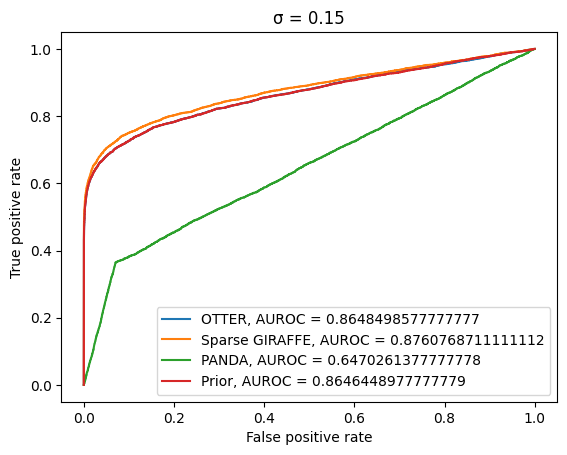

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3980
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.275361 -0.189994  0.312943  1.268340  1.500008  1.827437  0.037567   
1    5.076877 -0.543780  0.346045 -1.485558  3.108435 -0.399491  2.836388   
2   -1.419651  0.973845  1.707418  2.409711  1.030360 -1.678128 -0.358677   
3   -3.573947  0.631285  3.202411 -1.366684 -0.363082  0.618530 -1.030608   
4    1.215126 -0.821026 -1.326033  0.374709  1.151987  0.424538 -1.278346   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.529141  0.921695  2.843538  1.447065 -2.324498  0.537736 -0.402534   
496  1.670460 -0.217682  1.170905  2.743602  1.870470 -2.598606  0.090981   
497

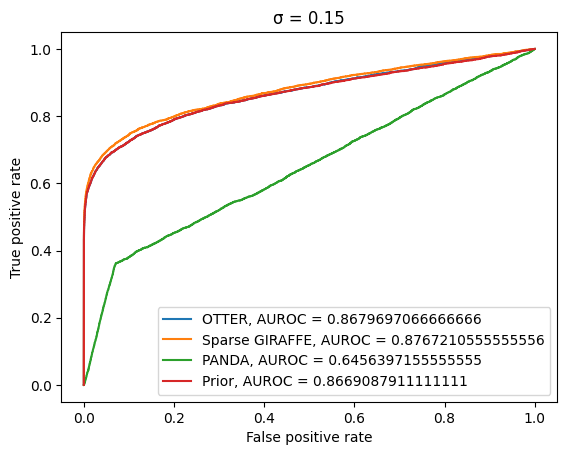

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3830
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.108044  2.558767 -0.347246 -2.118294  3.606061 -3.250024 -5.178921   
1   -1.206154  2.039646  0.612104 -0.387416 -0.925480 -0.259842  0.744457   
2   -1.080021  2.511091  1.214818  2.738056  2.125949 -1.448667  2.687070   
3   -1.336670  1.881154 -2.041750  2.837406 -0.288746 -4.433950  1.514553   
4   -0.901338  0.271948  0.577751  1.655329  0.380440  0.137346 -1.472243   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.230656  1.805050 -0.959320 -1.708317  1.718185  3.598092 -4.029369   
496  3.837350  0.030480 -2.497724 -0.535884 -0.724589 -3.557684  2.371107   
497

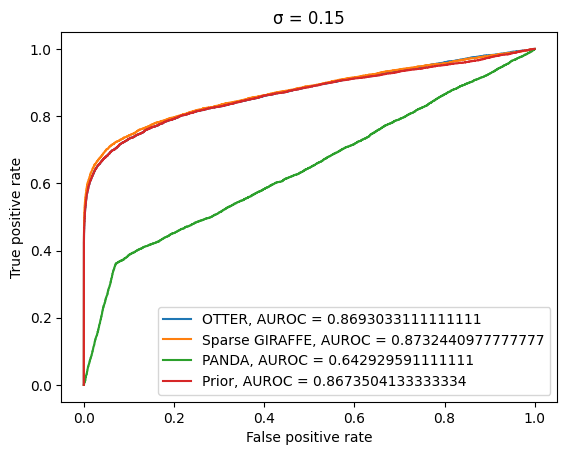

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3994
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.259048 -0.942330  0.464553  0.998395  1.345509 -1.239392 -0.404597   
1    2.141058  4.378471  0.358506 -1.244564 -0.323537 -2.033785  2.951196   
2   -0.782287 -1.899043  1.521743  5.144503 -1.223275  1.082065  1.799641   
3   -0.376016  0.628870 -2.048666  1.898794 -1.276015 -0.701713  0.161279   
4   -1.995928  1.251575 -3.631324 -4.832238 -0.959244  2.701767  0.692927   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.014799 -1.240447 -1.914508 -2.075607  1.303234  3.101630 -2.271729   
496  2.422661 -4.253385  0.039844 -0.915188 -0.587452  4.024375  3.137331   
497

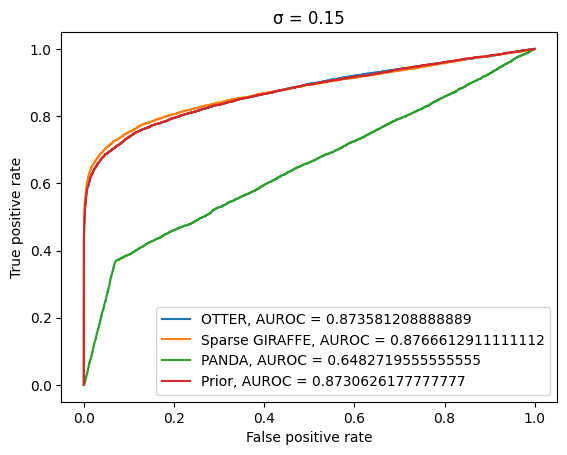

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3816
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.310899  0.936759  0.710523 -1.504574  1.098364 -0.905779 -2.201956   
1   -0.139042  1.768484 -1.482892 -1.365463  0.586090 -0.990760 -1.234284   
2    0.104813  3.249406  1.013651  1.641826  1.159026 -1.547929  1.628935   
3    2.797924  0.430353 -3.298145  0.173916  0.583185 -0.162954 -0.481296   
4   -1.113945 -1.029951 -2.169729  0.069008 -1.954044 -3.488411 -2.369926   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.019836 -1.720112  0.634070  2.911153 -2.202924  1.207653 -1.762592   
496  1.118572  2.993225  0.766705  0.784267  0.903025  1.518673  0.292023   
497

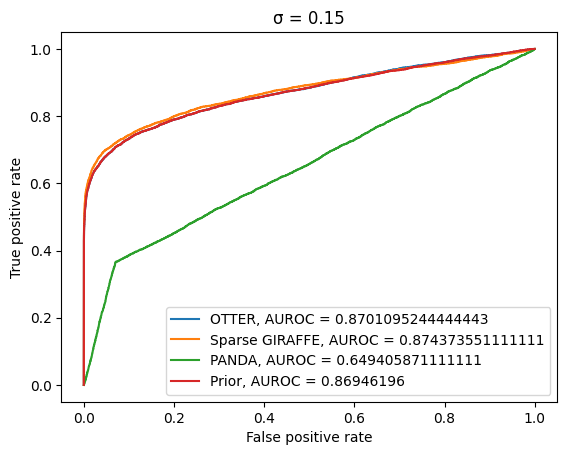

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4024
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.927597 -0.281992 -1.314353 -0.294110  1.470386  0.376721 -1.017433   
1    0.934250  1.067219 -2.138579 -0.484313  1.656383  1.644519 -1.504689   
2    1.980447  1.283055 -0.231012  0.026322 -0.415142 -0.470352  0.995725   
3    5.191254 -1.135498 -2.826123  3.071552 -2.839950 -2.851342 -0.959627   
4    1.613728 -2.565577 -1.668098  1.904955  0.201357  0.711349  1.428044   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.217857  3.446805  1.216484  3.883841 -0.210961 -0.592871  3.980184   
496 -2.155199  2.651704 -0.102551  1.772571 -3.013668  1.210063 -0.593404   
497

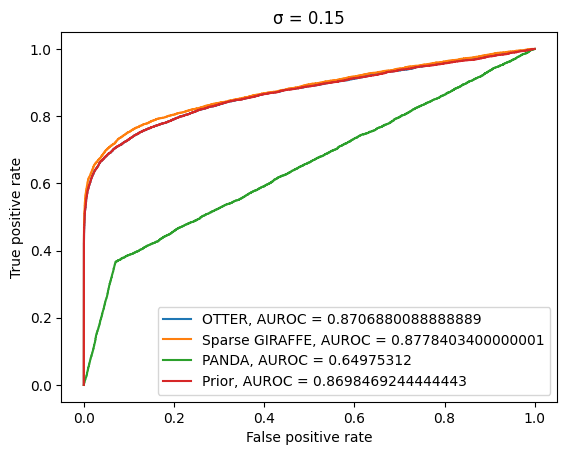

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3884
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.202122  0.706375  1.441574 -0.662721  1.953450 -0.035705  1.368616   
1    1.446468  0.678134  1.750862  1.365175 -0.807528 -2.252505 -0.775116   
2    0.729365  0.613363 -1.739604  0.513002 -1.014660 -1.288424 -0.410121   
3    4.321364  0.109753 -0.906522  0.368170 -2.436728  3.697248  0.036517   
4   -1.431244  2.072634 -0.570992 -1.129150  0.254575  0.351568 -0.499969   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.092363  1.493165  1.100137 -2.703918  1.934105  3.399916  2.467512   
496  2.646465 -0.083714  0.089676  7.350598 -1.899986 -0.752701  0.360966   
497

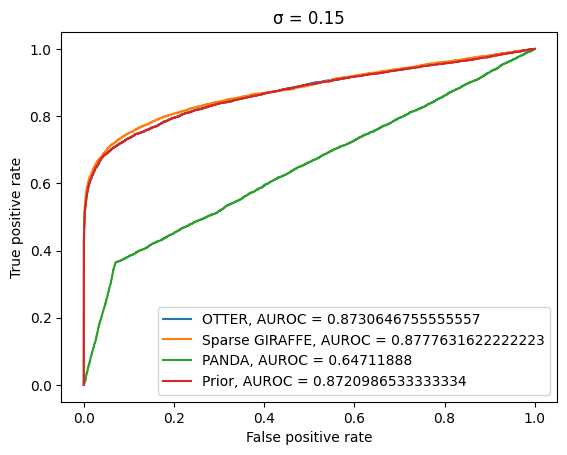

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3914
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.446485 -0.357612  0.570040  0.800318  0.013927 -1.947465 -0.401962   
1   -1.142567 -1.361015  0.570571  1.378969 -1.902188  0.965222 -0.637416   
2   -1.505279 -0.429380  0.352720  5.653253  0.589984  1.291062  2.627825   
3   -2.795240  2.082417 -1.216266  2.046648 -2.502227 -2.962088 -0.372500   
4    0.999376 -1.926745  2.634626  3.224100 -0.469539 -3.439003 -1.947363   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.598081 -0.608646 -1.360617  1.662593  1.150660  1.233255 -0.948638   
496  0.816240  0.668314 -2.959537 -0.493077 -5.055789 -3.667986 -0.242525   
497

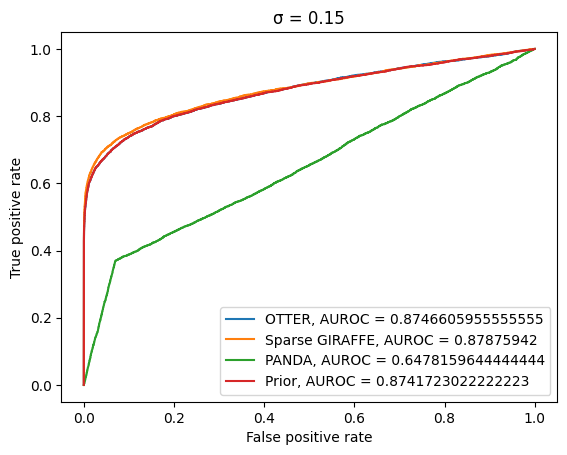

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3838
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.372300  1.112179  0.887806  0.445434 -0.050442  0.214203  1.476051   
1   -0.604201  3.451209  1.642437 -1.587637  1.753661  1.055448 -0.100467   
2   -0.122396 -0.649407 -0.292727  2.275434 -0.291353 -1.059795 -1.780803   
3    0.996394  0.243058  0.622999 -2.478422 -1.017897 -0.126909 -1.652839   
4    0.292917 -0.096442  1.029666  1.713994  0.732246  1.151521 -0.236555   
..        ...       ...       ...       ...       ...       ...       ...   
495 -3.030013 -2.405299  0.326266 -0.682161  0.091477  0.621916  2.014709   
496 -1.994822  1.153457  2.794249  1.123987  0.664718 -0.803998  2.014170   
497

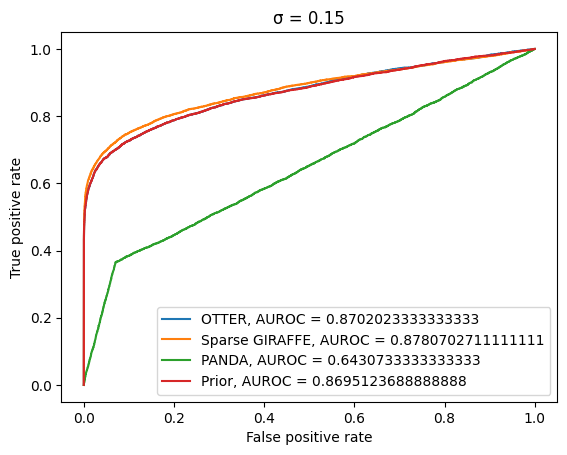

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3932
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.117864  0.730466  1.299026  0.008921 -0.262736  0.567937  1.486945   
1   -0.798282  1.514415 -0.527634 -2.912297  1.158595 -4.567176  0.610017   
2    3.172270 -1.278319 -2.240822 -1.356809  1.847007 -3.475506 -0.765131   
3   -0.452598 -1.878159 -0.268822 -1.607129  2.606886  0.272384 -1.939633   
4    2.691227  2.134808 -1.029922 -0.003775 -0.091027 -3.032571 -0.376924   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.670708  2.369613 -0.658946 -1.965087  2.569346 -0.490221 -3.058784   
496 -0.761840  1.289637 -0.132630 -1.481662  1.633023  2.349436 -1.726636   
497

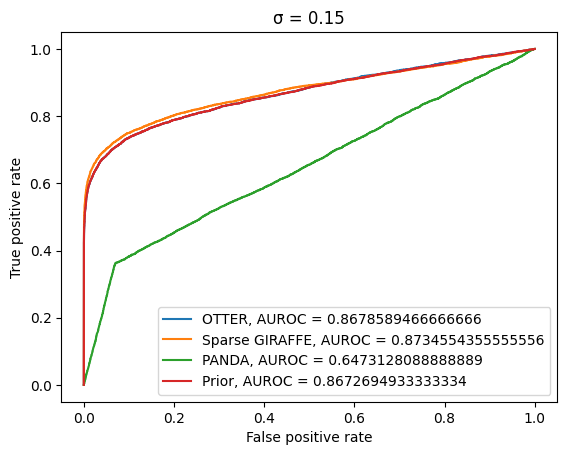

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3878
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.468335  1.561759  2.014448 -0.671398 -2.241569 -1.215960 -3.442200   
1   -0.421939 -0.388290  1.097818 -0.389614 -0.667212  0.970228 -0.673595   
2    1.195016  1.480560  0.755041  2.625654 -0.919340 -0.701621  1.208133   
3   -1.659263 -0.970871 -0.545993  1.775557  1.087959 -2.263381  1.599408   
4   -0.148870 -0.127937 -1.222750  0.821517  0.276225  1.716393  0.540882   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.131237 -1.417992 -0.669241 -3.341692 -1.270275  0.351754 -0.412137   
496  0.048862  1.184656  1.511856  0.474032 -2.079445 -1.231239 -2.397177   
497

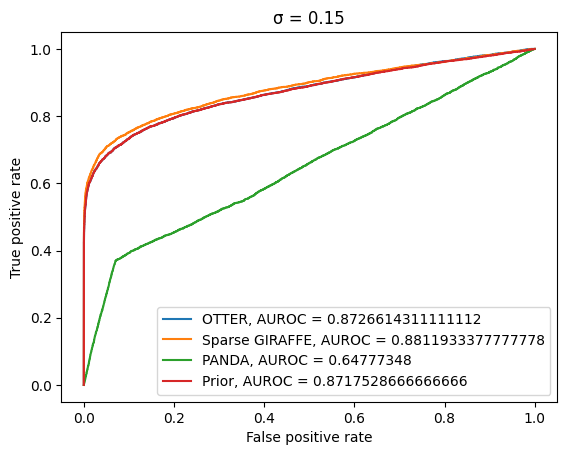

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3864
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.534537 -2.545306 -2.026743  0.740086 -1.511203  0.648378 -0.606367   
1   -1.111922  1.090593  0.469843  1.416312 -2.050910 -1.640034 -0.842082   
2    1.410349 -0.920459 -1.260917  0.878647  0.137497  2.449182  0.470816   
3    2.653671  0.948896 -1.488041 -2.932997 -1.437731  1.193527  1.947256   
4    0.566449 -2.297013 -0.612570 -2.564551  0.382065  0.411010 -0.683895   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.675953 -0.532632 -1.264546 -0.661496  0.973382 -0.427218 -1.861354   
496 -2.653621  1.175198 -0.336651  1.542380  1.123637 -2.013932  0.475881   
497

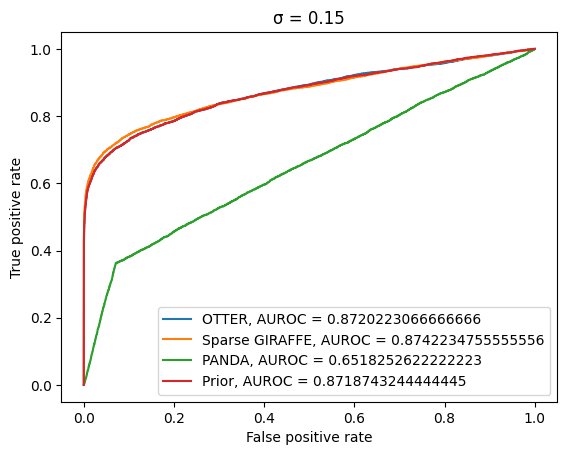

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3898
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.112484  0.084235 -1.311265 -1.927557  0.422727 -0.649593 -0.353748   
1    2.639836  2.892574  1.187281 -3.890460  0.791232 -0.946483  2.622288   
2    3.408658 -0.937659 -0.426923  2.172892  0.930794 -0.564031  1.646765   
3    3.056658  0.632888 -1.844821  0.207346  1.252968 -3.250619 -1.530635   
4    0.617527  2.048031  1.428664  2.013380 -3.218783 -2.525532  1.055853   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.794768  1.148811 -2.589414  2.401921  0.466497 -0.684562  1.968958   
496 -2.330892  0.615075 -0.927993  1.235270 -0.749137 -2.606762  1.503200   
497

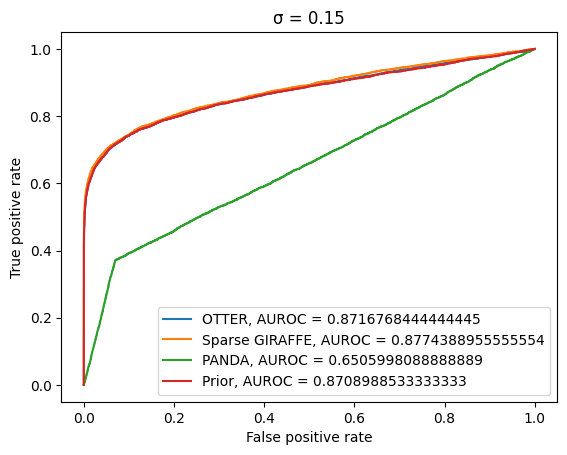

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4022
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.046238 -1.127140 -0.940809  0.209575  1.270596  2.554757 -2.052122   
1   -1.420779 -0.973786 -0.676848  4.525488 -0.123582 -0.263313  0.479156   
2   -2.486239 -0.524857 -0.712957  0.063434 -2.239639  0.324377  2.320633   
3    0.521723 -2.914924  0.018314  1.087320 -0.225381  0.011185  0.649224   
4   -3.323705  0.809448 -0.133770  1.738564  0.807454  1.287193 -2.108722   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.742099  0.162711 -0.077686 -1.772029 -5.470286 -1.354378 -2.639904   
496  0.016204 -2.523075 -1.949491 -0.676111  0.470756 -1.364455  0.736833   
497

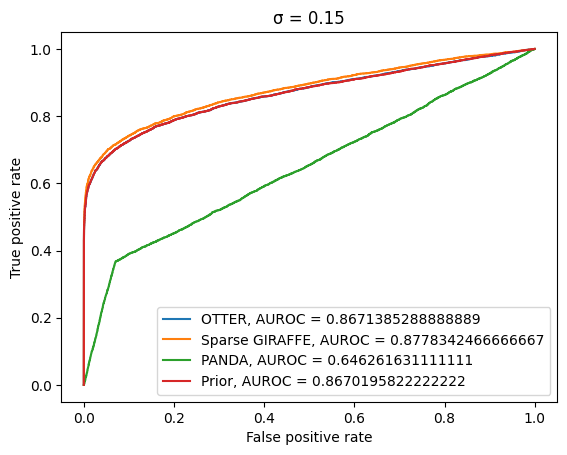

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3914
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.853559 -2.090670  1.317749  0.656218 -0.972718  0.090793  0.296008   
1   -1.529488  1.821402 -0.780919  0.757717 -1.488996 -1.386237  2.958241   
2   -0.421042 -2.009794 -0.741544 -0.124949 -1.758943  2.005569  1.462094   
3   -0.110075 -3.007549  4.292087 -1.673016 -0.232351 -2.119547 -4.170962   
4   -0.116798  0.403332  0.307864 -2.207867  1.447039 -2.103496 -2.734462   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.336935  1.364031  1.460074  0.889787 -0.097075  1.713597  1.273003   
496 -3.427944 -0.639248  2.052563  2.529131  2.075887 -0.726973  1.482361   
497

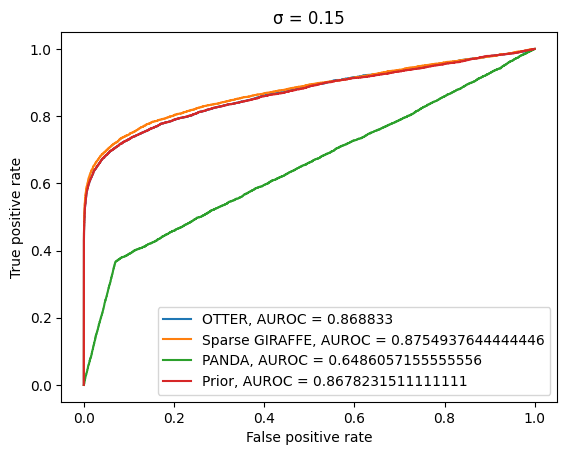

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3922
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.682560 -3.496723  1.522486 -1.521484 -1.775265 -1.097931 -0.928215   
1   -0.113622  2.538475  2.932404 -2.420279  0.132799 -1.301681  2.586556   
2    2.939686 -3.680473  1.070000 -0.825863 -1.465315  4.412994 -0.844820   
3    2.089141 -0.319101 -3.864105 -2.247751  3.077111  1.833887 -0.496905   
4    2.959491 -2.632109  0.496188  4.152624  0.692867  1.391189 -1.205788   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.282492 -0.878274  0.641034  1.236109  1.560568  1.288012 -3.649292   
496  1.093057  0.651056 -2.092004  2.279852  0.338419  0.612767  0.234743   
497

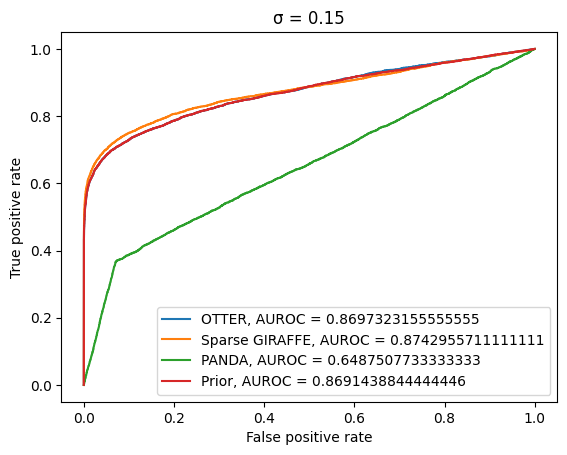

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3976
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.439311  2.486327  1.999148  0.020922  0.614484  0.596300  0.498174   
1   -0.612894 -0.313544 -1.259332 -0.073290 -2.125902  1.015460  2.215207   
2    0.156143  2.446721 -2.762267 -0.260452  4.295622 -0.272008  1.700056   
3    0.790005  1.043058  0.242784 -0.745070 -0.169111  0.329646  0.046639   
4   -2.215558 -0.177093  1.336045  0.687911 -3.145298 -1.053360 -1.286170   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.627974 -0.655803 -2.694530  1.544907 -0.748789  1.141819 -4.533527   
496  1.028448 -1.053992  1.200292 -1.170607 -1.066258 -0.349687 -1.314663   
497

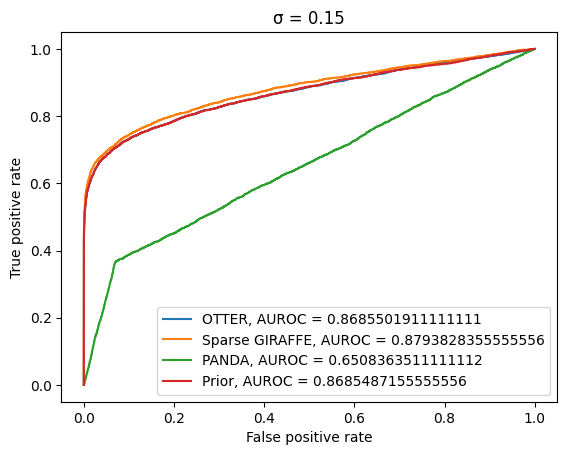

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3944
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.747369 -1.014461  2.601497 -1.561799 -0.759282  0.322148 -2.362265   
1    3.858694 -1.376486 -0.084985  0.659879  0.543649 -0.084977  0.650291   
2    0.669011  0.131802 -1.960912  1.076485 -1.560350  0.759710  2.591542   
3   -1.077754 -2.679480 -1.187598  0.084421  2.217702  0.130473 -3.929334   
4    0.341300  1.178071 -0.013608 -0.421959  0.781396  0.145904 -0.883067   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.224325  3.581270  0.886379  3.858723 -3.916830 -4.619509  0.238409   
496  0.879457  1.022306 -0.032434  0.380403  0.427959  1.047823 -1.425123   
497

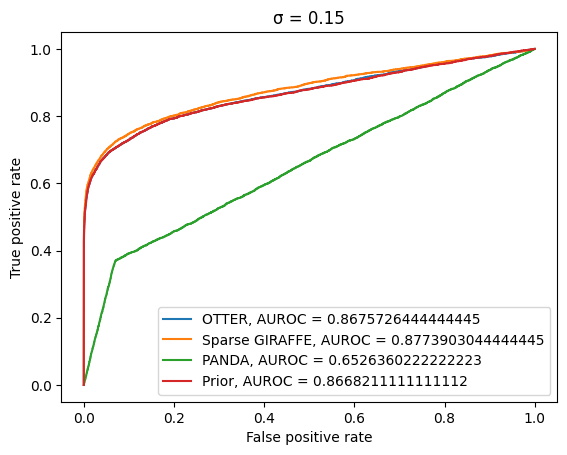

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4008
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.654562 -0.929116  2.619259 -5.494732  1.472044  1.766086  1.694552   
1   -0.086398  0.829397  4.317009  1.637201 -1.445914  1.403144 -3.683389   
2   -1.071227 -1.421172 -0.100605 -4.522612 -0.468168 -0.528900 -1.073044   
3   -0.303148  0.844675  0.190467  0.710836  0.210831 -0.462906 -0.379099   
4   -0.715264  0.034605  3.735797  1.230539  1.120038  1.500482  2.199111   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.173612 -2.820003 -0.387760 -3.616582  2.150934  1.181633 -3.969659   
496  1.755653  1.958738 -2.907889 -3.069515  0.530820 -2.835720 -1.427692   
497

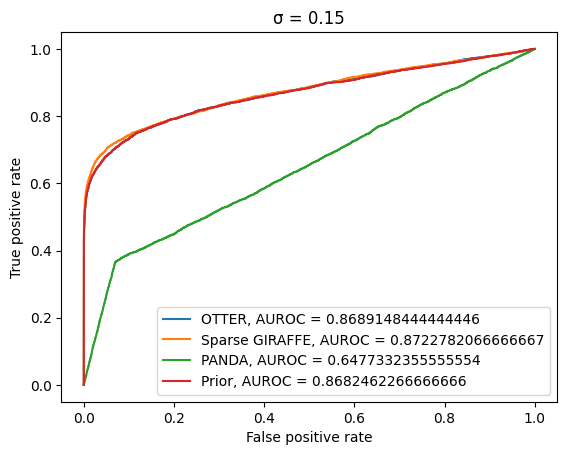

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3806
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.648304 -0.273498  0.773950  1.317942  2.393457 -4.148633 -3.288266   
1    1.751809 -0.949288  1.377596 -1.103310 -0.816621  3.904311 -2.567545   
2    0.666409 -0.570556  0.539343  1.112778 -0.620716  0.127471 -2.143611   
3    2.167337 -0.235621 -2.328826 -1.126892 -0.074171  1.428365  3.144319   
4   -1.418910  0.179060 -0.477524  0.406675  0.592358 -0.883694 -0.393546   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.178222  2.538602  1.504268  1.097690 -2.556653 -0.551677 -0.503428   
496  1.268671  0.114294 -1.009084  0.775536 -0.329145 -1.431313  0.517287   
497

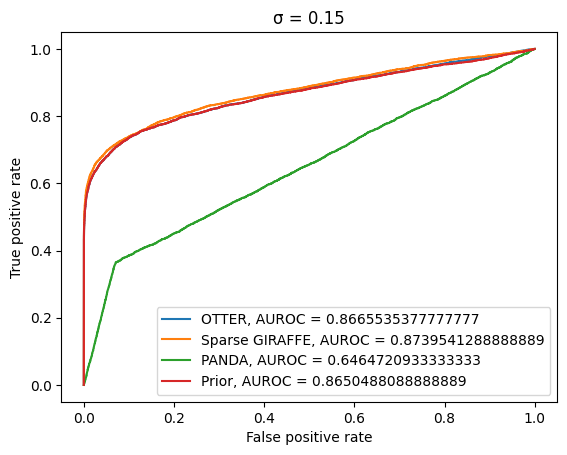

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3938
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.077662 -0.788897 -5.310863  1.673598 -0.897985  2.847968 -0.007284   
1    1.043663  0.873324 -2.639198  0.890540 -0.488561 -3.187973 -0.712150   
2    0.063348 -2.273315 -0.897719  1.855948  1.327148  1.001337  2.944432   
3    1.616440  0.856608 -0.957759 -1.375772 -1.044817  0.817627 -1.500022   
4   -0.706860  0.363855  2.114916  0.885481 -0.303585  0.963539  1.352035   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.123446 -2.273220 -1.290236 -0.557305 -0.687181  0.566808 -2.360511   
496  0.698604  2.923046 -1.651250  0.434289 -3.514175 -3.645860  4.613019   
497

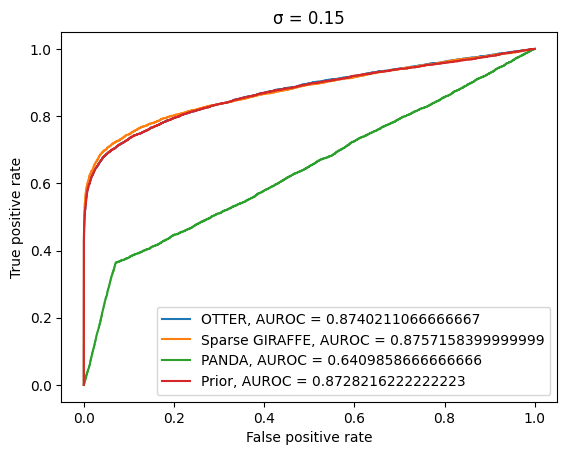

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3838
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.250343 -1.153180  0.500189  0.011367  0.283040  1.127297  2.112131   
1    2.215553  0.369743 -0.755546  1.694441  1.352722 -1.829728  1.462238   
2    0.199937 -1.024092  1.896652  2.148910  0.494446 -3.150695  2.348007   
3   -1.919777 -0.852879 -1.301255 -0.931832 -0.215655  0.989967 -1.028772   
4    1.623400 -1.580624 -1.648755 -2.246889 -0.505603 -0.088483 -1.719649   
..        ...       ...       ...       ...       ...       ...       ...   
495 -3.122035  3.760381  2.981653 -0.975708 -1.997993 -2.826042  1.453505   
496  0.731386  0.357582  0.777744  1.343823  0.080771  0.498841 -3.391971   
497

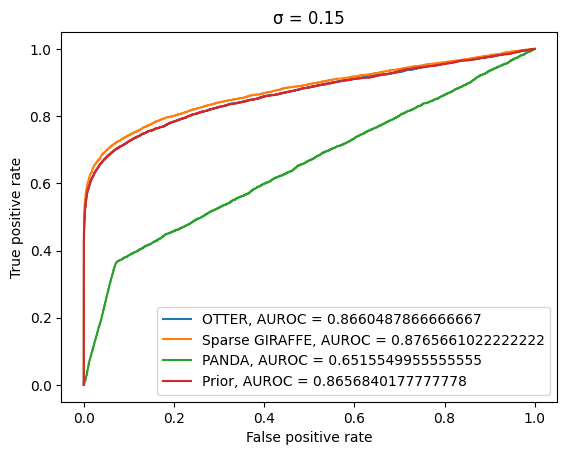

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3796
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.146235  1.135663 -1.096899 -1.012700 -1.303059 -0.901106 -0.607632   
1    1.197983 -0.108151  0.683175  1.250831  2.079097 -2.049579  2.426455   
2    0.653532  0.210568  1.180941  1.017059 -0.086626 -0.047214 -0.161393   
3   -1.473266  0.754745  1.112649  4.848132 -1.882188 -2.699293  1.576311   
4    1.483828 -0.007747  0.762591 -0.228475 -1.522575 -0.050144 -1.266086   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.946668  3.148958 -2.464958  1.457156 -1.538706  0.172308 -1.127153   
496 -0.631552 -0.984280 -1.445446  0.495713 -1.652443 -2.365855  1.233003   
497

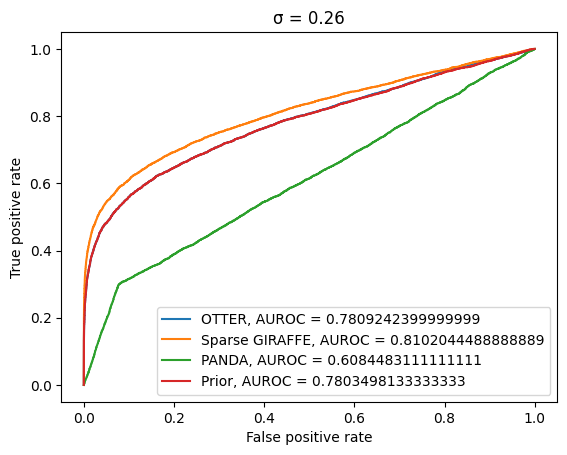

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4010
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.165529  0.803539 -2.701674 -4.488631  0.177871 -3.051429 -2.137352   
1    3.249634  1.019996 -0.112303  0.765290 -0.650703  0.401255 -1.132539   
2   -0.826371 -0.726629 -0.177550 -0.548794 -0.946464  0.082508 -0.772305   
3   -1.246502 -0.714298  2.778502  3.823138  2.348159  0.881954  2.774309   
4    1.642651  0.788731  0.652729 -0.356929 -2.201433  0.685419 -2.499578   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.502135  0.416512  0.077862 -0.763150  1.927553 -1.969707 -0.093787   
496  3.459890  2.989088 -2.000686  3.278628  0.544973 -2.293739  0.585488   
497

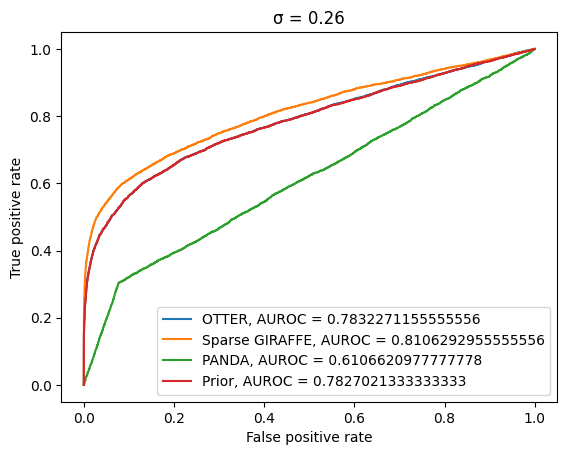

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3876
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.884817  1.279327  0.321631 -0.056056 -1.323236 -1.704067 -0.493823   
1   -1.139296 -0.336784  1.260149  0.893817 -0.156149  1.306958 -1.541265   
2    1.209558 -1.317859  0.102636  0.656004  1.480130 -1.605533  0.149309   
3    1.916065 -0.028019  1.091681 -2.195245  2.507988 -0.020577  0.492206   
4   -0.206125  2.756572 -2.642685 -3.199804 -0.490034  1.968173 -3.076767   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.916931 -1.627614  4.579564  2.034500  1.936797  3.560232 -0.922239   
496 -3.211405  0.817191 -0.302481  1.609845 -0.597078 -1.541526  0.555415   
497

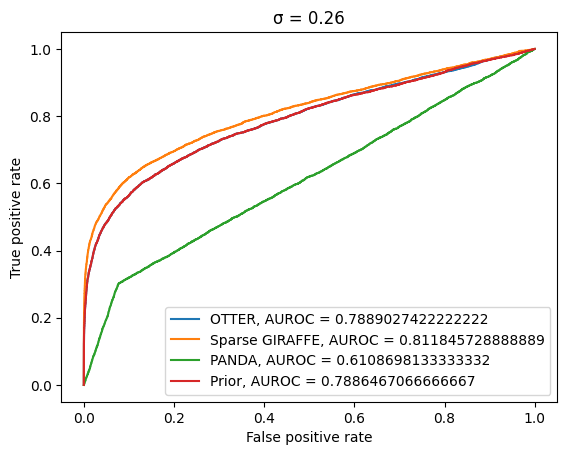

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3850
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.000577 -1.195078  0.848004 -0.306251  0.060329  0.892696  1.657904   
1    1.638760 -4.199137  2.448924 -1.713778  0.845599  0.507471 -1.179171   
2   -3.500916  0.978097 -0.140667 -0.108010  0.543292  0.620858 -0.426707   
3    2.293488 -0.136401 -2.340891  0.339954  1.124003 -2.925495  1.540500   
4    1.015725 -2.165044  0.353045  2.094554  1.133911  0.163173  0.592577   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.784156  0.082308  0.507579  1.091541  0.938366  3.106029 -1.123622   
496  1.262704  0.929066  2.955315  2.276041 -2.508635 -3.582014  1.513262   
497

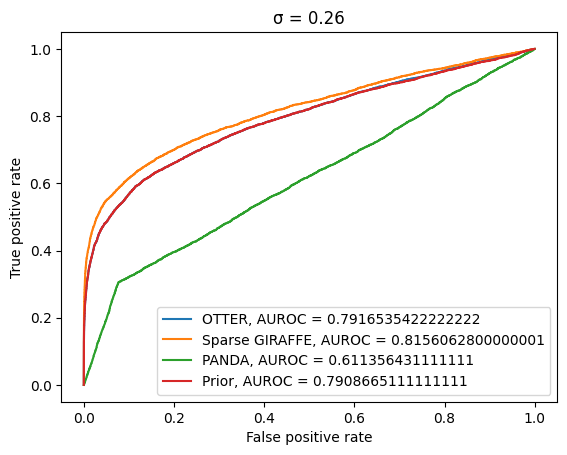

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3942
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.024513 -0.858257  1.701135 -0.321702 -1.654769  2.864781  2.141020   
1   -0.527217 -1.661726  0.203252  0.456992 -0.646081  1.282450 -2.006714   
2    0.500909 -0.883979 -0.643459 -0.524986  0.344332 -0.577286 -1.323554   
3   -0.211725 -0.121667  0.963916 -1.644236  0.147657 -0.400979 -0.458425   
4    0.619440 -3.532315  0.335527 -0.448693  0.170600 -0.373923 -1.523436   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.538819  0.794561 -0.329712  0.613180  3.445608  2.569761  1.419172   
496  1.028743  0.874332 -0.455700  2.422269 -3.405840 -0.410337 -0.015742   
497

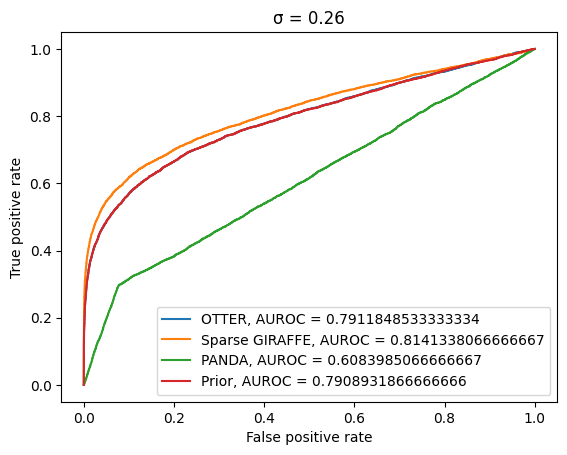

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3736
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.237351 -0.312202  1.261321 -5.904798  0.775346 -0.218807 -3.763896   
1    0.630539  1.763915  1.090174 -2.702351  0.653199 -0.350467  2.615103   
2   -1.547213  0.311605  0.744908 -5.862668  1.316379 -0.191840 -3.514047   
3   -0.980416  0.796300  0.933010  0.590466  1.877374  0.785632 -0.879993   
4   -1.155460 -1.692074 -1.705632 -0.544011  2.035611 -1.172762 -0.337273   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.973952  2.127233 -0.614889  1.176716  2.795861 -1.901782  0.085947   
496  1.507204 -0.575930  1.385713 -0.741497 -1.569348 -3.693128 -2.197245   
497

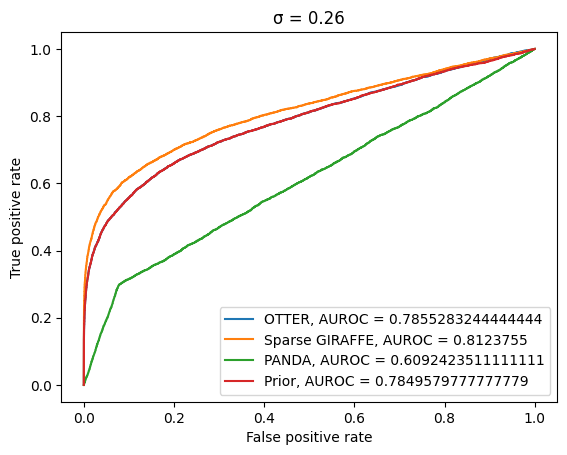

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.401810 -0.693898 -0.912546  1.374210 -2.808385 -0.810761 -1.967080   
1    1.222715 -0.487977 -0.441922  1.692946  0.195991 -0.264958 -1.711721   
2    0.481778 -0.982158 -3.441949  1.337898 -1.368511 -0.436702 -1.564777   
3   -0.473383 -0.590844  1.138008 -2.310719 -2.151852  0.589354 -4.716453   
4    1.264106 -0.662286 -2.463620  3.665707 -0.095897  0.719081  0.569259   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.325133  0.629603 -1.935849 -0.440028 -1.504353  0.564595  0.304529   
496  0.440314  0.981704 -0.220417 -0.900115  1.654800 -0.198025  0.560136   
497

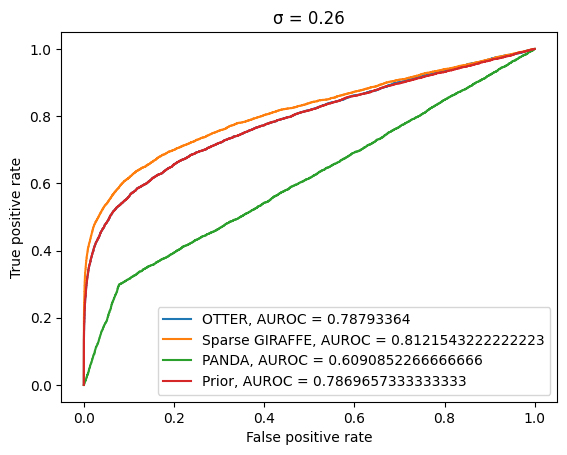

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3750
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.232437 -1.311555 -1.369180 -1.071643 -1.964526  0.099024 -0.321682   
1   -0.867295  0.316229 -1.412267 -2.103628 -2.126594  1.707140 -0.827261   
2   -0.678448  1.428892 -1.315381 -1.432763  0.074560 -1.756535 -1.168057   
3    1.480488  1.311421  1.932496  1.596895  0.777888  0.959947 -0.094857   
4   -2.160361 -4.657277 -0.048541  1.033844 -0.712750  0.548379  0.702024   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.657382  0.268561 -2.682853 -0.695273 -0.302595 -2.981963  0.577009   
496 -0.262216  1.269672  0.385403 -1.683275  1.149563 -0.948370  3.509093   
497

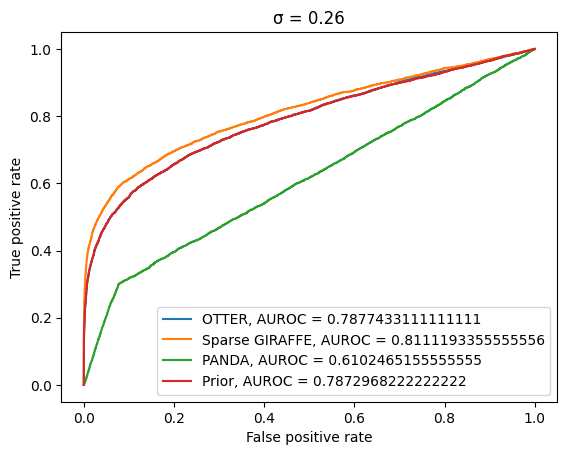

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3878
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.715997  0.115319  1.329603  0.386089 -0.025639  0.469856 -0.720040   
1    1.984356 -0.622302 -2.115407  0.612564  0.454578  0.898204 -2.636377   
2    0.075871 -1.824596 -0.620892 -0.600962 -1.754526 -1.444106 -0.444274   
3   -0.938553 -1.683855 -0.142980 -0.612614 -0.593770  0.409291 -0.491194   
4    0.059276 -1.069561 -1.004979  3.511778  0.088007 -1.002969  2.069979   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.639157  0.127755  1.313511  2.297618  0.250912 -3.371292  2.638135   
496 -0.075578  0.817408 -0.295788 -0.250008 -0.300004  1.027709 -0.094281   
497

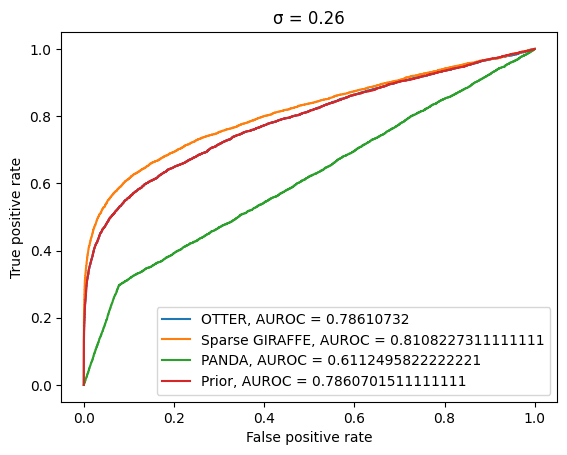

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3826
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.551243  1.724580 -1.035557  0.593223  0.143559  1.265918 -0.362900   
1   -1.253243 -1.055464  2.642963  1.441512 -0.599102  0.151740 -0.831631   
2   -0.599719 -0.350550  2.794268 -0.939105  0.654668 -0.180874  1.360684   
3    0.450304 -1.165469 -1.348242  3.192002 -0.215080  1.297218 -0.454987   
4   -6.250222  2.868531  1.372986 -2.199501 -2.509421 -4.407878  1.077523   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.568291  0.641519  1.473519 -0.726826 -1.123203  0.219801 -0.504127   
496  0.086804 -2.139583 -0.341189 -0.709734 -1.543252  0.897443  0.305113   
497

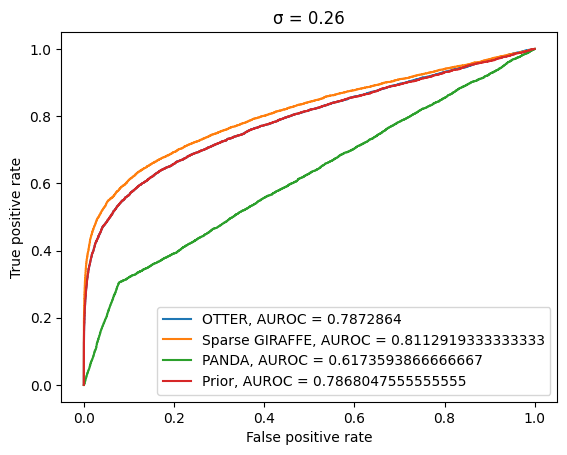

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3750
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.218142 -1.088481  0.390536  1.173511  0.589422  1.263992  0.510914   
1    0.198625 -0.689275 -0.804910  0.462715  1.896301  1.049623 -0.005188   
2   -2.436130  0.418442  2.865741  3.859959  2.225511 -0.816875  3.020609   
3    0.812385  3.643548 -2.105391  0.429089 -1.147246  1.561896  0.031047   
4   -1.402062  1.862934  0.062629  0.462800 -1.168060 -1.480429  2.948036   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.135357 -0.620157 -2.176837  1.732776  0.256972 -1.069004  0.847225   
496  0.783015  2.979803 -4.040201 -1.298689  1.245311 -1.644650 -3.515277   
497

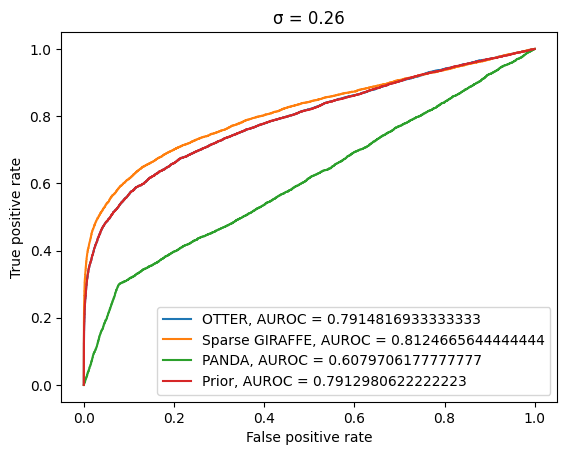

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3970
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.158797  0.344470 -0.807659 -2.393320  0.272097 -0.279474  1.228225   
1    1.159577  0.068568  1.361901 -1.007364 -1.253764  0.879713 -0.144168   
2   -0.780333 -1.991946 -1.588946  0.464976 -0.642263 -1.853975  0.445290   
3   -0.492355 -0.182155 -2.566495  0.905090 -2.788419 -0.572581  2.269626   
4   -1.004351 -1.365382 -0.647928 -0.774392 -0.051196  3.126863 -0.773382   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.130212  1.530209  0.063282 -2.902967 -1.221803 -3.975370  0.968857   
496 -0.244110 -0.754048  0.189627 -0.986110  1.179834  1.629831 -0.639718   
497

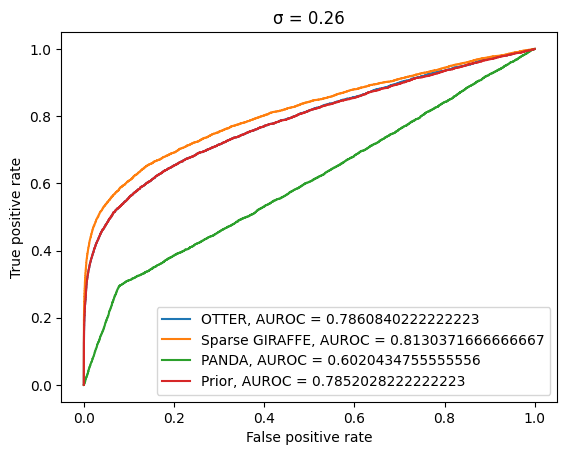

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3942
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.047742  3.069974 -2.852986  4.028835  1.216493 -1.748382  0.629354   
1   -0.449725 -1.611356 -3.413520  0.629520 -0.367130  2.312920  1.791253   
2   -2.697529 -3.749472  1.310559 -2.151339  1.350060  2.038763  0.067000   
3    0.413433  1.966992 -2.835347 -4.203988  0.306218  0.805025 -1.632302   
4    0.908141  2.240702 -0.470760 -2.621791  0.464842  0.808546  0.050927   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.413153  1.206059  0.725278 -1.419111 -1.570093  1.670107  0.889709   
496  0.021599  1.460657 -3.020779 -0.849676  0.823880  0.256417  0.251514   
497

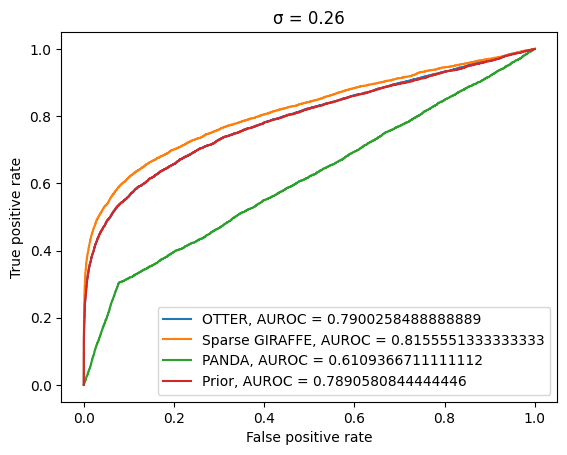

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3888
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.676775  2.546148 -2.255305  0.604752 -1.812989 -1.348502 -2.317994   
1    1.400686  1.984998  0.386591 -0.239591  0.867715  1.601300 -2.565518   
2   -1.568244 -1.205433  0.015834  2.324121 -0.229835  2.437021  0.124648   
3   -1.363117  0.432079 -3.058363 -5.190454 -2.294493 -1.451819 -2.700869   
4    2.130986  0.219388 -2.173030  1.699633  0.998265  4.719362  2.600782   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.773545  0.106216 -0.135798  0.260493  0.338386  1.786475  1.328406   
496 -1.271774  1.241081  0.745390  0.071568 -2.949154  0.747879 -0.319898   
497

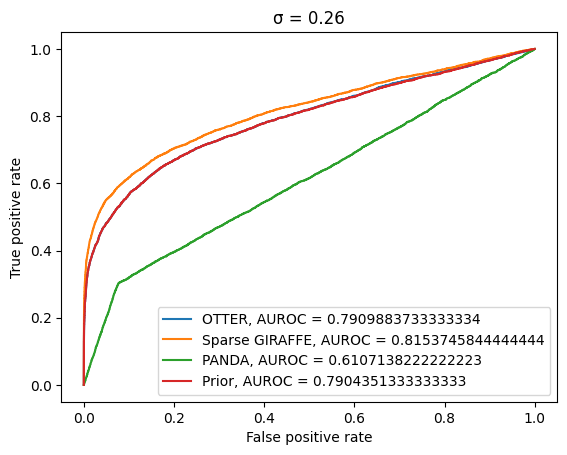

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3860
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.631982 -0.723242  0.156563 -3.229121  0.681817 -0.924532 -1.433060   
1    1.698229  1.828816  2.466926 -0.737385  1.531096 -0.947600  0.987593   
2    0.423820 -1.308192  1.051529 -0.585753 -0.475996  0.252337 -0.169373   
3   -0.919465 -2.202279 -1.398692  1.113257  1.549230 -1.365483 -0.721655   
4   -0.963114  0.566719  1.857502  2.881681 -3.525888  1.315212 -1.945681   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.000806  1.063549  0.357141  0.126917 -2.945822 -2.849084  0.354615   
496 -1.938649  0.297005  0.631895 -3.145928  1.884782  0.245998 -3.109620   
497

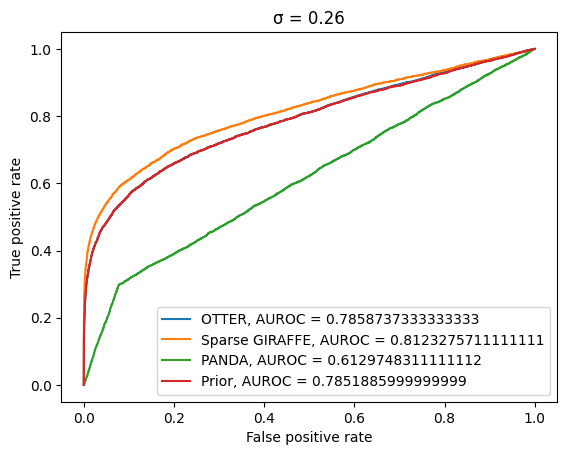

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3838
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.154668  1.847371 -1.531518 -1.074431  1.250608 -2.104826 -1.940310   
1   -1.540878 -0.378870 -1.332201  1.854416 -1.879788  1.106887 -0.180241   
2   -2.622002  2.626921 -0.326945 -0.861666  0.178861  0.193291 -1.435080   
3    3.339331 -0.369079  0.489883 -0.301853  1.121460 -3.585426 -0.424084   
4    1.305284  0.432804 -0.149572 -0.380458  2.359390  0.059572 -1.977280   
..        ...       ...       ...       ...       ...       ...       ...   
495 -4.638773  0.478779  0.562480 -0.080536  0.726022  0.910294 -0.274261   
496 -2.770264 -1.735458  0.310840  1.312958 -0.879593 -1.577218  3.111936   
497

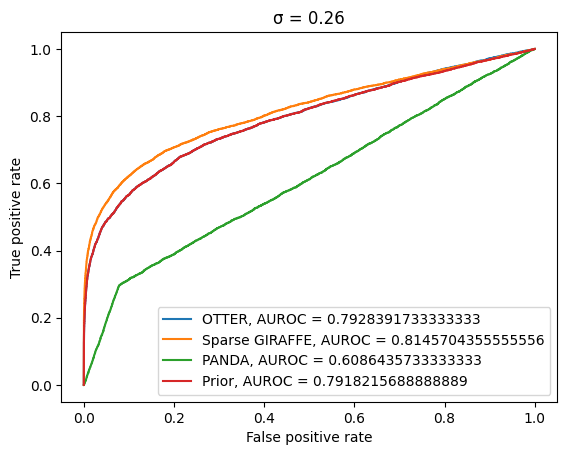

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3958
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.124636  0.200107  0.950935 -1.218914 -0.607949  0.503594 -0.986920   
1    0.574351  1.644652 -1.700774  5.296631  0.431028 -2.912460  2.895309   
2    2.525698  1.050963 -0.902529 -0.873516 -1.478006 -3.200394 -0.471835   
3    0.130150  0.953207 -0.206033 -0.111313  0.030306 -0.801204  1.163848   
4    1.602948  0.175781  0.256194  1.385380  3.457747  2.666401 -0.957237   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.151052 -0.598012  2.564430  1.142068  0.651255  0.308424 -2.051154   
496 -1.272736  1.433743 -0.856960  1.596872 -2.730355 -1.772836  2.032312   
497

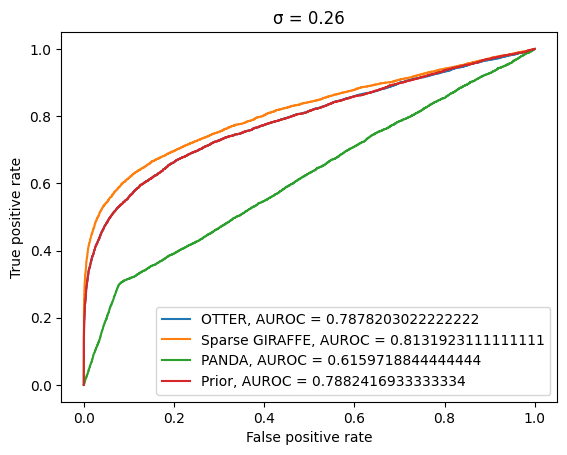

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3964
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.896896  1.672456 -2.162665  0.076430  0.395436 -1.239453  1.134647   
1    1.417000  0.395331 -1.193144  2.129071 -1.093287 -1.378865  2.844506   
2    0.234690 -0.411583 -1.032344 -0.795787  0.225384  0.355208 -2.616290   
3    3.055005  1.706031  3.643860  2.795107  0.241113  1.155614  2.673072   
4   -0.798501  1.404042 -0.364624 -0.071997  0.940581 -1.062620  0.217624   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.523744 -0.723118  1.816340  2.045513  1.482124 -0.538208  2.238159   
496 -3.294653  1.228054 -1.173714 -0.507870 -2.181901 -0.866267  0.555731   
497

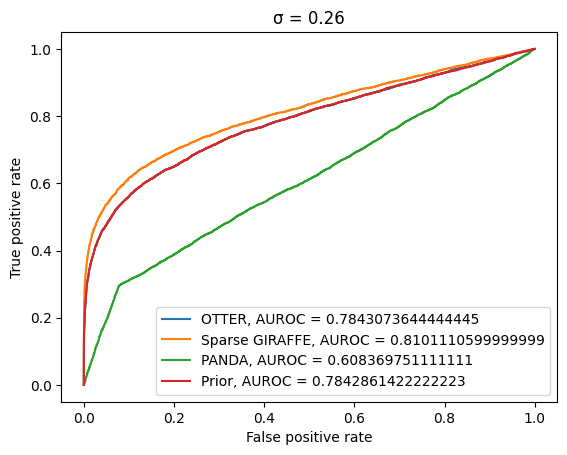

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3904
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.446305  1.026901  1.805082 -0.961650  2.202230 -0.914770  1.013570   
1   -4.108818 -1.981034 -1.975237 -5.517387  0.868480  0.972077 -1.110011   
2    0.428726  0.727409 -1.464482  0.926617  3.471522 -1.309937  1.416318   
3    1.789762  0.258601 -1.310090 -0.790098 -0.778582  0.940211  1.617643   
4    0.779362 -3.782736 -0.304729  2.352723  1.762864  4.159477  1.825828   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.092694  1.112724 -0.568500  1.954285  0.451395 -0.691327  1.139493   
496 -0.281987  0.625664 -0.988215  1.480619  2.282954  1.920578 -0.158177   
497

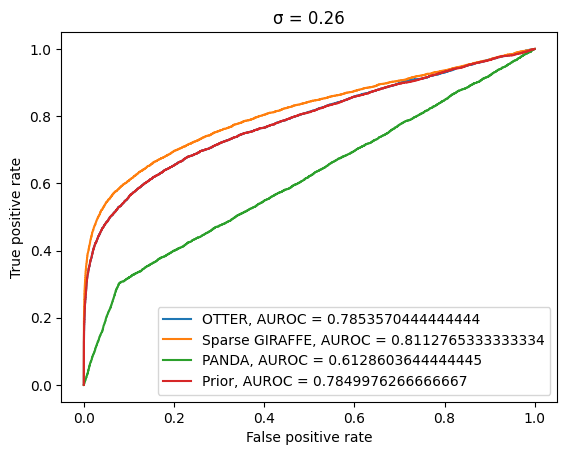

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3858
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.324231  0.513169 -2.541041  2.092411  1.739130  1.018036  3.182555   
1    0.813295 -0.649925 -2.358942 -2.609577  2.086095  1.974751  0.329890   
2    1.395998 -0.680837  0.173350  1.450041  0.016546 -0.939284  1.089141   
3   -0.818512  0.378294  0.225004  0.475871  1.275887 -1.951535 -0.616278   
4   -0.876396  1.775942 -0.745158  2.285016 -4.602275 -2.656253 -0.473600   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.314384  1.872230  1.794634  0.860580 -0.615205 -0.706689 -0.162740   
496 -2.810371 -1.141192  2.476484  3.897767  0.715650  1.591423  0.609173   
497

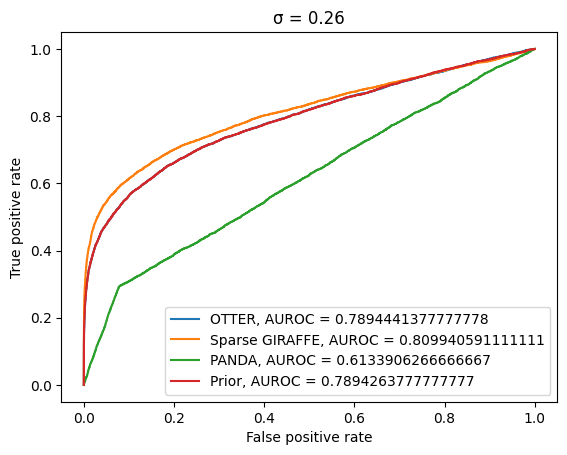

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3824
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.392547  2.131663 -0.703414 -0.037867 -2.360069 -1.992853 -3.182320   
1    0.671128  0.522798 -1.741704  1.067360 -2.604690 -1.760558 -2.078449   
2    0.634809  0.888705 -0.715357 -2.336094  1.436290 -2.036794 -1.303152   
3    1.371888 -1.361608  1.256748 -1.558392  0.835569  0.707860  0.316705   
4   -1.348655 -0.702884 -0.578880 -2.691044  0.627965 -0.946259  0.409918   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.496589  2.744170 -0.710609 -2.211826 -0.697051 -0.153352  1.173529   
496  1.977766 -0.766302 -2.697609  1.741200  0.901651 -1.701997  2.692823   
497

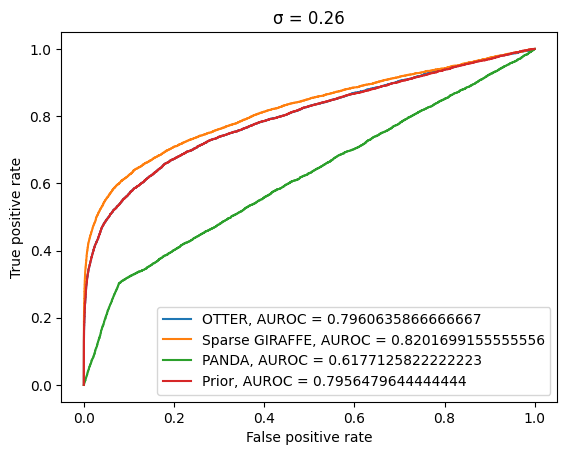

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3868
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.733392 -1.052147 -0.579758  0.054053  1.105827 -0.176270  1.029200   
1   -1.016714  1.326197  3.838614  1.694763 -0.440121  1.233293  1.649571   
2    0.149030  0.871345  3.584608 -0.975888  0.879377  1.273930 -0.295253   
3    2.156120  1.961014  0.471557 -0.737860 -0.014117 -1.710908 -1.988988   
4    1.564734  5.160277  0.370018  2.481823 -0.846277 -0.990825 -0.957965   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.679155  3.887102 -0.539665 -1.201261  1.220682  1.241479  0.338474   
496 -0.494257  0.925127 -1.177861 -1.786875  0.118454  1.348196 -1.723042   
497

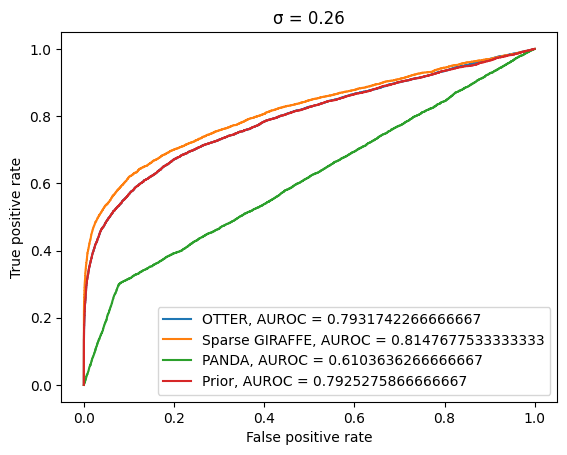

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3910
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.903599 -1.720055  0.105095 -1.711649 -1.957931  0.141540  0.626304   
1   -0.544955  1.000678  1.722406 -3.259151  1.864820 -0.080474  2.562242   
2    2.375441  0.926751 -0.578599 -3.336328  0.041370 -0.640340 -2.408882   
3   -1.908597  1.436493  0.109685 -0.152092 -2.245498  2.345110 -0.942305   
4    0.358661 -0.926004 -1.070051 -0.517423 -1.716327  2.370600 -2.119139   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.105556 -3.871066  1.708269  2.277887 -1.519567  1.435154  1.761383   
496  1.254547 -1.151407  0.444366 -0.291058  1.582725 -0.621712 -0.045634   
497

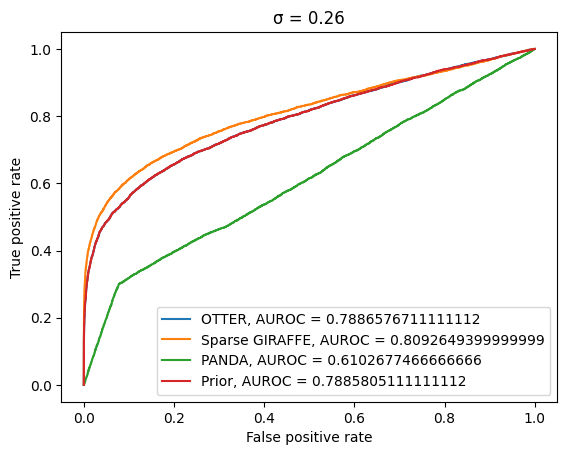

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3896
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.639733  0.234032  1.063185 -0.506597  0.447752  0.372213 -0.418495   
1    0.868866 -2.077575 -3.564164 -0.579501 -0.928266  0.773724 -1.234117   
2    2.018077  2.268437  2.979759 -0.713551 -2.127995 -0.249759  1.141057   
3    2.449895  0.215422 -1.145501 -0.974145  0.005200  0.635308 -0.449846   
4   -1.415990  0.843281  0.520622 -0.263993  0.568978  1.154215  2.887281   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.383938  1.777074  0.143331 -2.073633 -2.256544  0.642730 -0.308205   
496 -0.597923 -0.940668  1.137940 -0.755919  2.534659 -0.272417  2.286183   
497

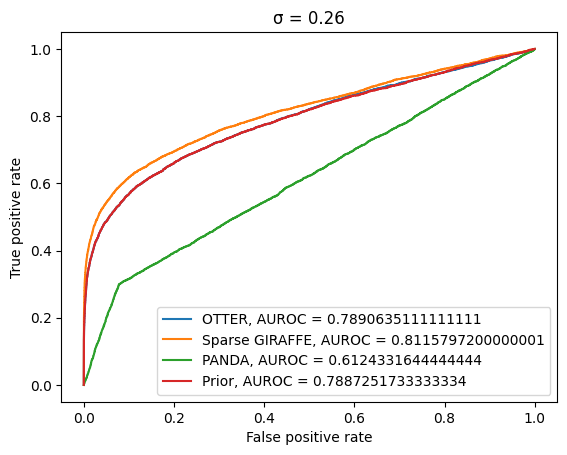

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3978
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.248299 -0.679947 -1.516632 -1.214702 -3.509298  0.311141 -0.372407   
1    4.488195 -0.346002  2.004238  3.542990 -1.149831  0.183915  2.368925   
2   -2.817867  1.136881 -1.487082  1.107595 -2.321786  0.781544 -0.168971   
3   -1.653168  0.074278 -0.002664  0.776518 -1.876176  1.102473  0.550457   
4    1.617236 -1.466989 -1.948996  0.355784 -1.682949 -0.082103  1.435035   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.104165 -1.078076 -0.443475 -1.667601 -1.380965  2.243500 -2.582044   
496  0.359811 -0.416188  3.830447  2.765746  2.186652  1.747953  2.761551   
497

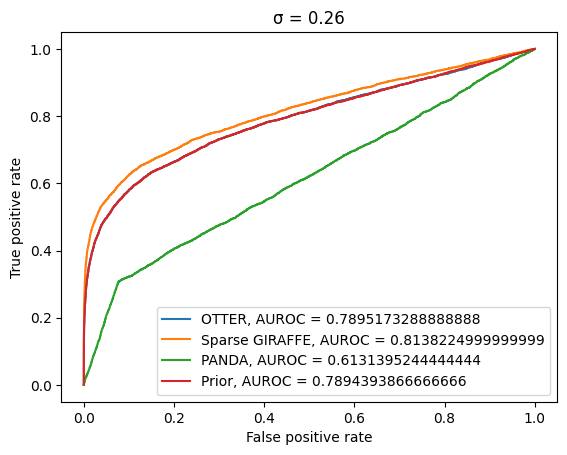

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3960
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.027305 -1.046816 -0.205211 -1.445025  0.293442 -0.649719 -1.515783   
1    2.331619 -0.925823  4.318197  3.106700  1.370843 -0.180757 -2.524372   
2   -2.165363  2.144121 -3.267470 -2.273834 -1.236095  0.943824 -1.771528   
3   -1.565483 -0.761138 -0.983130  1.013948  0.121540  0.215490 -0.398426   
4    1.344144 -1.103116  0.318408 -3.007765  2.908368 -0.897669 -0.586614   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.154651  0.607563  0.962021  0.534803 -0.607529  0.140379  1.113520   
496  1.452962 -1.764200  2.410439 -0.393660  1.104408 -1.066103  0.177210   
497

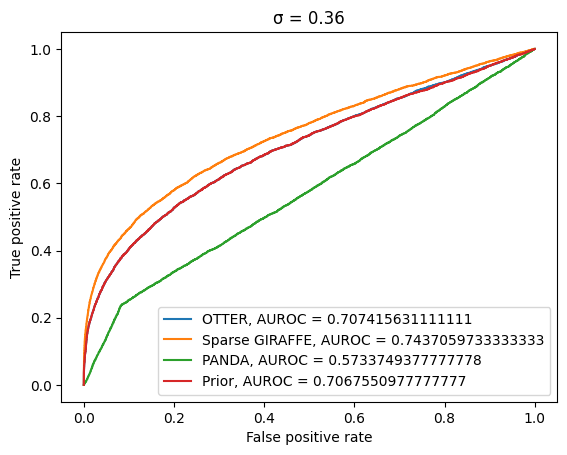

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3938
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.820555 -2.584044  4.814182  1.507967  2.389997  2.835013  1.915306   
1   -1.890027  1.364523  0.656977 -0.757973 -0.873731 -1.968605 -0.827075   
2    2.829921  0.570286 -1.961611  2.353908 -0.284266  0.253729  0.858227   
3    0.384598 -0.595536 -1.213163 -1.202163  2.454326 -0.268399  0.887030   
4    1.200602  2.014313 -0.081190 -1.185907 -0.385323  1.515623 -4.717464   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.336587  0.425731  4.156767  0.186290  1.886230 -2.541048  0.787442   
496  0.056462 -1.247389 -0.232175 -1.018828 -0.055793  1.216557  0.435523   
497

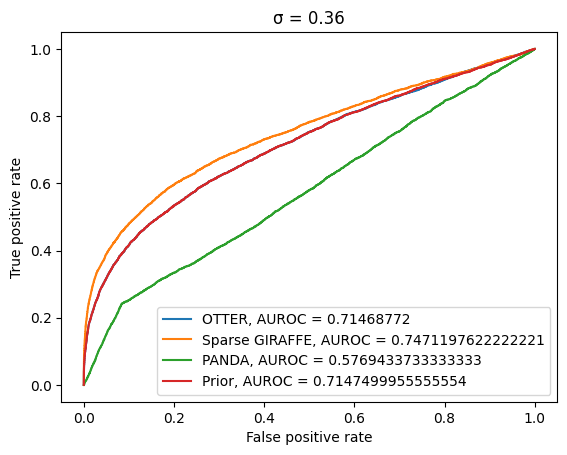

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3996
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.398191 -2.710887 -0.428327 -2.320068  1.928730  0.450670 -1.432094   
1   -2.686657  0.767818 -0.675857 -0.616737  3.646940 -1.721769 -1.295563   
2    2.231389 -3.632462  0.277503  0.089262 -0.107750 -0.501290  5.015440   
3    1.861210 -0.776401 -1.660677  0.390940  0.169462  2.987379  0.318193   
4   -1.082593 -0.854377 -0.175058  2.134624  0.857949  2.219089  0.720061   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.594891 -1.289402 -2.678614 -4.466014 -4.341881 -2.431569 -1.240673   
496  0.233648 -2.194211 -2.610115  0.079316  1.199523  2.023565 -1.397029   
497

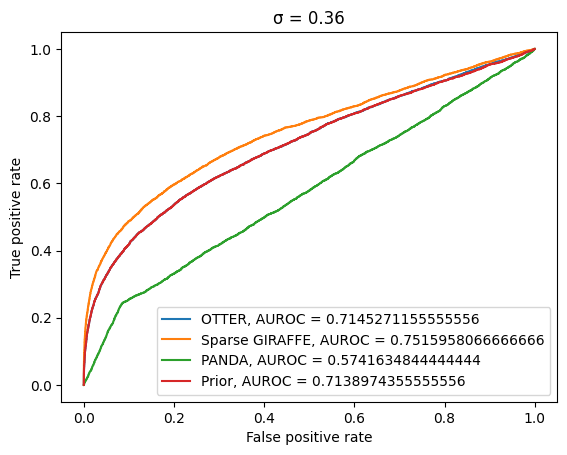

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3986
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.076811 -2.800602  2.651015 -5.291411 -1.628002  1.472973 -0.974401   
1   -1.311415 -0.187535  1.200528 -2.196934  0.226195 -1.920122  1.825559   
2    0.318161 -1.877668 -1.910750 -1.548395 -0.948304  4.472697 -0.678503   
3   -1.638248  1.557219 -3.289779 -2.669032  1.608378  1.045031 -0.874128   
4    2.487840 -0.249534 -0.980298 -0.707746  0.898013 -1.059939 -0.375794   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.348045 -1.570193 -0.134748 -0.587968 -0.814436 -1.320937 -0.308132   
496  0.471109 -0.766978  2.275336  2.843542  2.733570  0.779169 -0.033997   
497

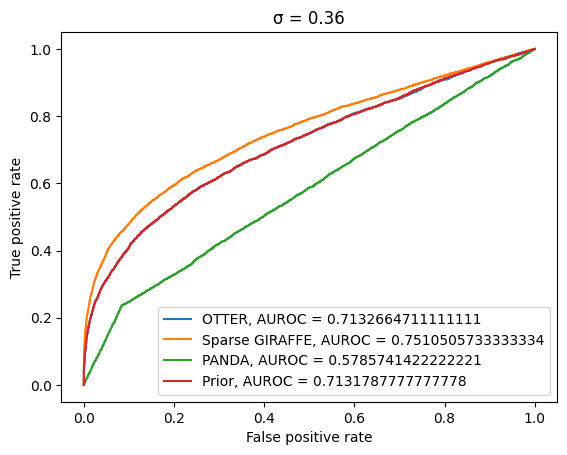

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3848
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.791124 -2.195811 -2.937147 -1.256169  0.263076  1.624940  4.236062   
1    0.036319  1.065583 -0.148201  0.283029 -0.521451  0.481328  1.353747   
2   -0.618602 -0.094260 -0.590254  0.260830  0.507036  0.465925 -0.446524   
3    3.187697  1.911018 -3.949816 -1.071490 -2.055102 -0.308223 -3.037222   
4    1.146777 -1.600753 -0.316599  1.525276  1.933454 -2.024012 -0.394098   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.259394  0.373030  0.028545  1.725914 -3.173746 -2.278051 -1.762568   
496 -1.745116 -1.973952 -0.516022 -0.351180 -1.680361 -2.420843 -0.215615   
497

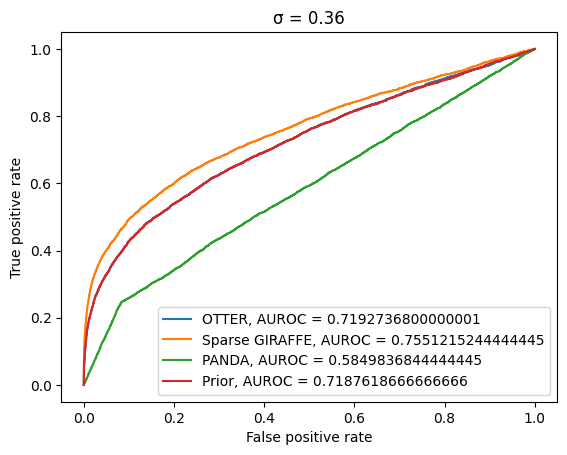

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3926
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.166886  0.926695 -2.672462  0.399718 -1.290910 -4.136677 -2.966203   
1    0.183890  2.697535  0.202460  2.529077 -1.033356 -2.379353  2.692875   
2    0.380619 -0.877272 -2.432098  0.661934  0.782741 -0.400495 -1.186600   
3    0.608618  1.217899  2.841779 -0.522092 -1.562764 -0.741526 -1.196146   
4   -1.278502 -0.403550  2.001807  0.429594 -1.290212  1.244196 -1.343554   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.448550 -0.690066  1.645762  2.179919 -0.191799 -0.672577  2.500674   
496  0.530101 -0.935742 -0.046885  0.658653 -0.059376 -0.737608  0.605150   
497

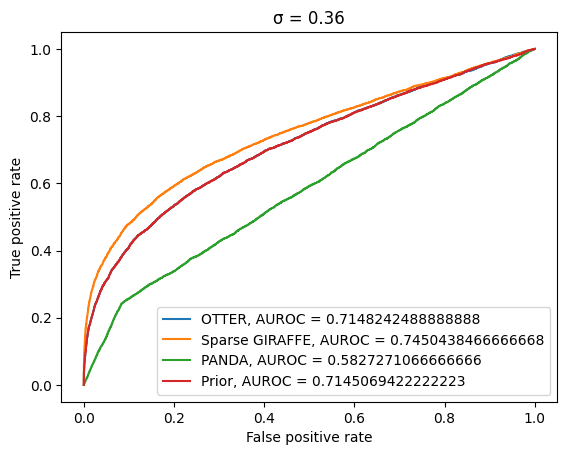

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3982
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.455965  0.146635  3.903868 -2.822164 -0.878526  1.917210 -3.906445   
1    1.035389 -0.970574  2.065970  0.753136  0.038756  0.725637 -2.464894   
2    0.695239  1.249325 -0.122098  1.420449 -0.024071  1.264761 -0.984810   
3   -1.137614  2.155542 -1.659447  2.803353 -1.413069  0.521318 -1.825060   
4   -3.862152 -0.044791 -1.164072 -0.195459 -3.137274 -0.630882  0.526845   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.607394 -0.569857 -4.139606 -2.143462  1.197092 -0.363343 -1.864061   
496 -1.090836 -2.336022  2.439308  3.522266  1.180656  0.880493  0.703915   
497

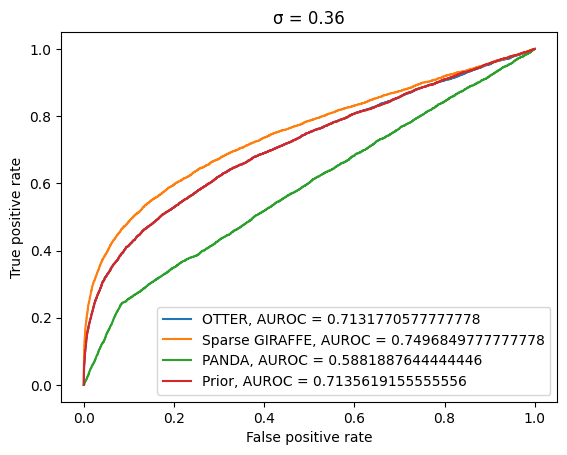

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3860
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.921064 -0.306707 -1.456442  0.195965  0.308321  1.043366 -1.937454   
1   -2.353022 -1.509810  0.973370  0.531041 -4.943459 -2.375488  1.337036   
2    0.197703  0.730700  0.839868 -0.405284  0.212093  0.203567  1.652516   
3   -1.017839 -1.064267  2.024268 -0.040269  1.237263  2.990232 -2.281704   
4    1.565802 -0.546103 -1.090045 -0.734615  2.245970 -1.475547 -1.086712   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.149264 -1.833310  0.826777  1.599056 -0.160069  0.740243  0.181481   
496 -0.564108 -2.043240  1.998217  0.984132  1.598368  2.955746 -0.250418   
497

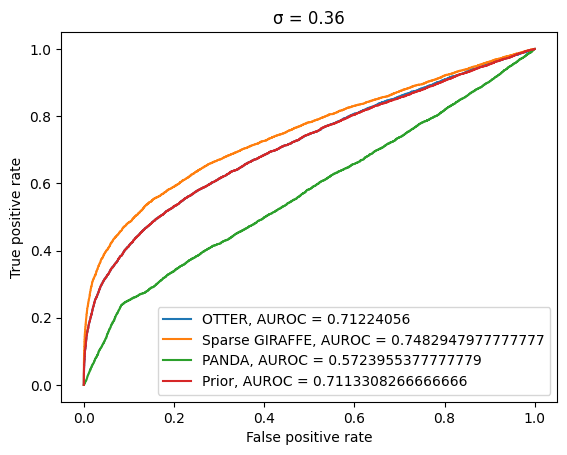

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3946
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.553190 -2.741678 -0.563784  2.059175  0.270031  0.104711 -0.648521   
1    0.823175 -0.896977 -2.476368  3.570837 -1.189869 -1.076697  1.861975   
2   -0.209354 -1.895638  0.914101 -0.383379 -1.694837  0.553674 -2.137038   
3    2.305749 -0.976040 -0.678423  0.745010  0.647405  1.086922 -0.291552   
4    1.704965  0.624645 -2.260656  2.217495 -1.861676  1.060323 -6.333926   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.685211 -2.781288 -3.938396 -4.336000  0.828699  4.252779 -3.276790   
496  1.919281  0.900763 -0.895593 -0.894557  4.243830 -1.068485 -1.685800   
497

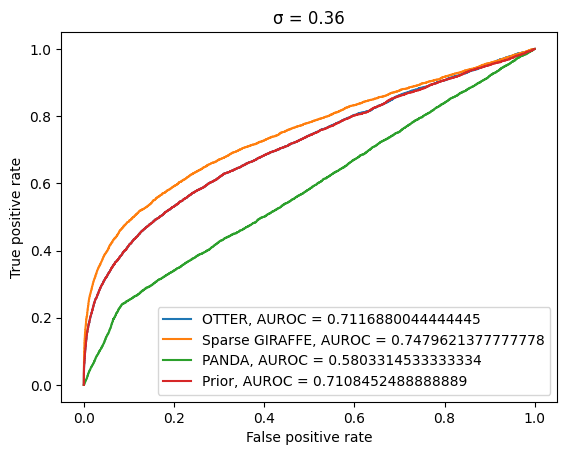

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3808
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.149752  1.108647 -2.961309  2.115919  0.730957 -1.595703 -3.010707   
1   -0.201335  1.666225 -1.432022 -3.798529  2.648005 -0.116344  1.200746   
2    0.671357 -0.600794  1.682669 -3.537332  2.649930 -1.443285  1.248699   
3    1.338540  0.003431 -1.062543 -1.632030  1.829251  0.763126  0.176968   
4    1.279788  0.065412 -1.579325 -0.597517  1.063598  0.154216 -0.256179   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.089681  0.635614  1.914825 -1.316272 -0.339987 -0.375396  3.818759   
496 -0.412752  1.426344  0.550635 -0.800686  1.788504  1.349315  1.026340   
497

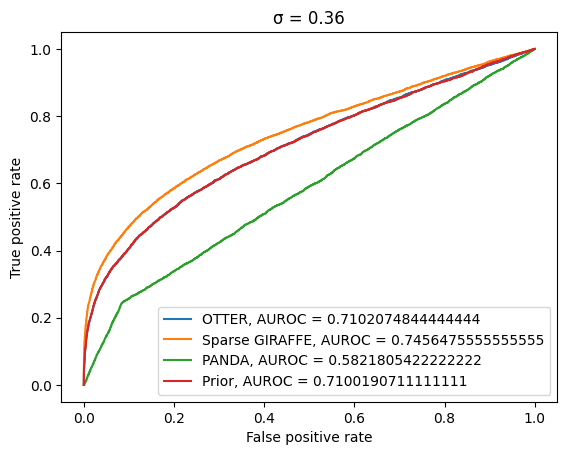

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3848
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.247091 -2.540603  2.784756  0.255888  1.303444  2.470494 -1.840247   
1   -1.399860 -1.470928 -1.856311 -1.324120  0.116674  3.412371 -0.544572   
2    2.433041 -0.958915 -0.343723 -1.492568 -1.154718 -0.921944 -2.548115   
3    2.014789 -0.945321  0.286948 -0.288806  0.740228  0.522126 -2.473412   
4    0.147845 -0.054056  0.242315  0.791490  0.466596 -0.122465 -1.029043   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.940237  0.384189  2.792819  1.381781 -4.535304 -1.669473 -1.084292   
496 -0.974406  0.790774 -0.711576  1.039047  0.127205 -0.404697 -2.503159   
497

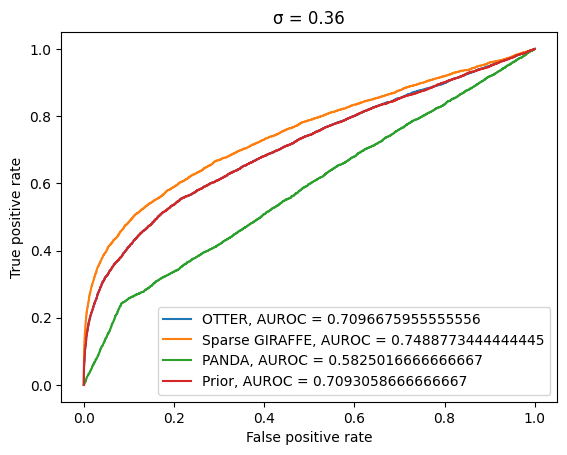

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3912
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.254265 -0.737262  0.483261  2.058118 -3.151493 -0.245811 -0.000109   
1    0.988900  0.399338 -2.997310 -1.238175 -0.288594  1.093670  0.805638   
2    1.660688  2.600971 -2.061540  0.868409  4.477104  0.094500  0.587787   
3   -3.040642  2.235222 -2.805467 -2.107879  1.073350  2.547946 -0.897217   
4    0.899987 -0.452466 -0.704268  0.426422  0.476365 -1.998676  1.290121   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.453174  0.001643 -0.997345 -5.142098 -1.289165  1.566575 -1.218455   
496  3.076320  0.031748 -0.025901 -0.126068  3.307743 -0.599704 -0.116051   
497

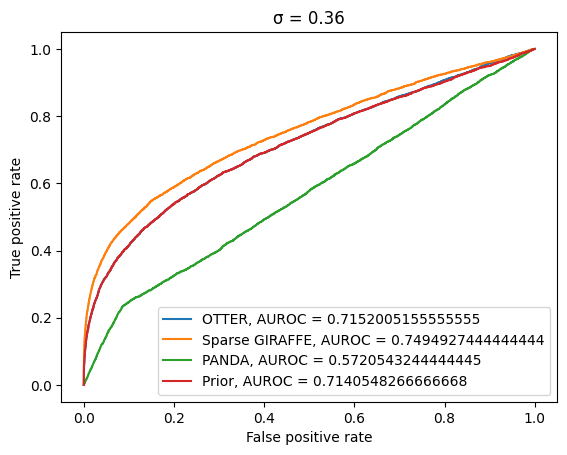

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3906
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.151628  0.149067 -0.630527  1.719734  0.191639  1.950629  1.705360   
1    4.129023 -0.859414 -1.125891  2.593033 -0.766359 -0.332795  0.875268   
2   -1.543703 -1.052596 -0.308957 -1.064408  1.665173  0.663964  2.975015   
3    0.782013 -0.442377 -0.897106 -0.668007 -0.324558  2.086949  0.474450   
4    1.825394  0.606896  3.299355 -1.421236 -2.283267  1.010559 -1.113109   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.401300 -2.106435  2.482307  0.171000  2.660328  2.339880  0.363887   
496 -1.671849  0.773987 -2.384205 -1.243953  3.382479  2.166278  1.483544   
497

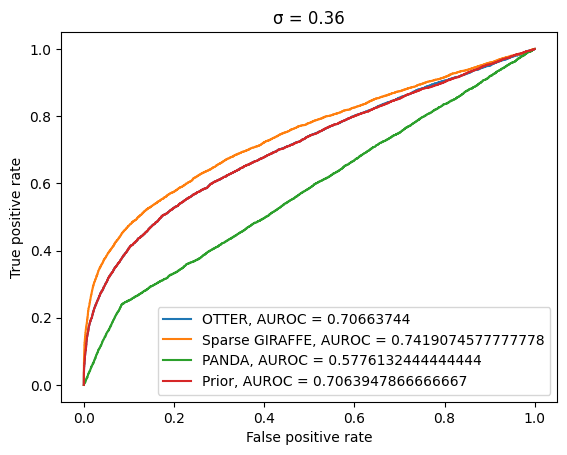

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3958
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.970524 -0.762140 -1.183643  1.469418  0.964704  0.315887 -2.752794   
1   -1.501670 -0.561991  0.868156 -1.031597  2.162437  1.805865  0.008689   
2    0.848966 -2.290996  4.582599  0.850282 -0.021809  0.170506 -0.953961   
3   -0.296078  0.141031 -2.987420  1.477122 -1.485550  0.660544 -1.308500   
4    1.341450 -1.652515  0.989235  0.824494  3.567144  1.913277  3.437128   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.734203  0.894529 -1.179243 -0.816000 -0.085577  1.374842  0.374252   
496  1.466687  1.731462 -0.975445  1.747087 -2.907879 -4.058658  0.826064   
497

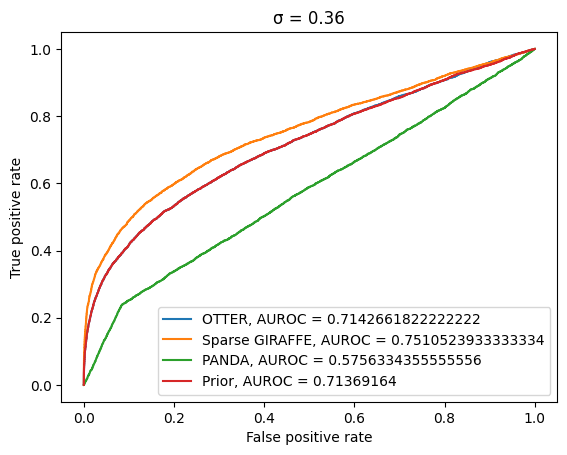

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3926
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.816599 -1.116164  1.057610 -0.977882 -0.761346  1.857969  2.333092   
1    1.444204 -2.305394 -2.787992 -2.021906 -1.028209 -0.261554 -0.390425   
2    0.693706  1.516384  0.369453  0.057718  0.604176 -3.163554  2.015863   
3   -1.056026  2.548973  0.515459  2.971099  0.190304  4.260109  4.401920   
4   -3.398376 -4.010250  0.947174 -0.605534  4.524373  2.187790 -0.054002   
..        ...       ...       ...       ...       ...       ...       ...   
495 -3.820525  2.124527 -3.379924  1.620734  0.475824 -0.096578  1.046605   
496  4.987408  0.233197  0.174678  3.369832  1.010849  3.095649  2.080842   
497

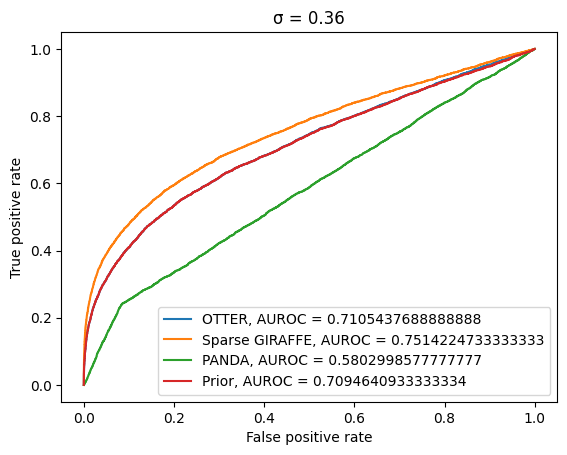

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3820
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.458436  1.571763 -1.015948  0.531374  0.021786 -0.734445  0.643727   
1    2.340460  0.835124  0.341885  0.025490  1.605716 -2.049246  0.107768   
2   -1.818257  3.943387  4.408050  1.651732  0.439924 -3.203625 -0.445594   
3    3.143461 -0.028917 -2.537665 -3.162746  1.030337  2.469347 -1.717967   
4   -0.373615 -0.370581 -0.980812 -1.716028  0.250150  0.865742 -1.402879   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.103623  0.848833  1.388734 -0.477577  0.194441 -1.695172 -0.128675   
496 -1.009520 -0.409776 -3.010132 -1.327303  1.558098 -0.247375  3.126278   
497

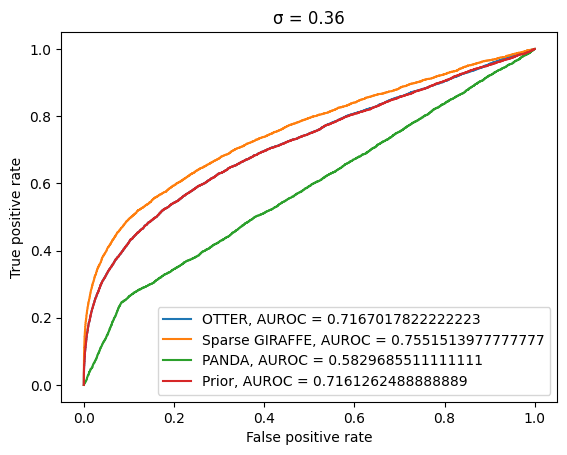

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3886
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.656105 -1.686257  1.917248  5.365190  0.666795  1.814441  1.577208   
1   -4.532253 -0.770964  0.525560  0.240957  0.277001 -0.031578 -1.056518   
2    1.558209  2.634510 -3.257659 -2.376759 -0.308828 -1.232794 -1.707133   
3    4.571167 -1.497225  2.607555  1.545349  0.093758 -0.183618  1.731189   
4    0.599114  0.831154  1.961148 -1.208581  1.896412  2.043162 -2.748136   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.120562 -0.992655 -1.339008  1.169452  1.780194  1.465038 -0.195075   
496 -3.311038  1.312036  0.533957  0.562708 -2.375760 -1.918720  1.611271   
497

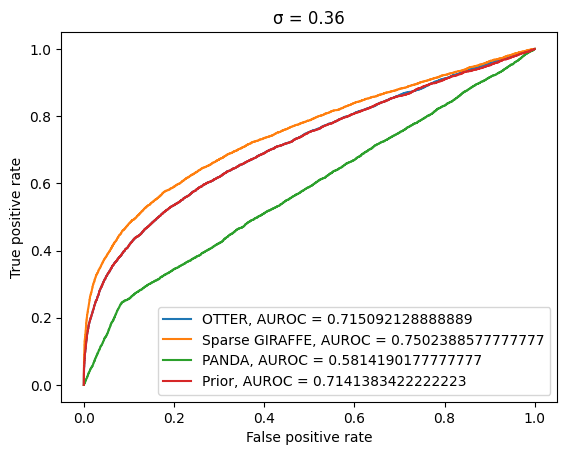

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3934
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.098864  0.132591  1.699952 -2.429904  0.206647  1.182145  1.279888   
1    0.675633 -0.712006  0.569375 -0.771343 -0.303178 -2.406992  0.871527   
2    1.255941 -0.077235  0.382480 -2.638251 -2.223431 -1.550547 -0.258891   
3    1.900755 -0.486629 -3.238696 -2.359541 -0.345855  2.856891 -1.202286   
4    1.052015  0.823305 -3.511787  0.717839  0.626394 -0.450798 -0.337251   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.428698  0.158236 -4.102243  1.256356 -0.518306 -0.358755 -1.839123   
496 -0.088189  1.450213 -1.218417  0.505847 -0.617469  0.189844  0.247472   
497

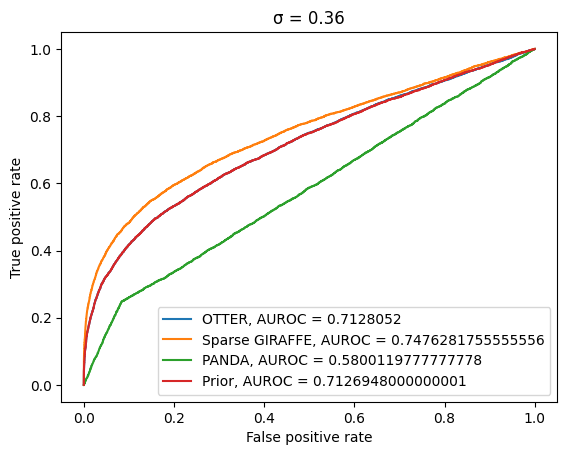

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4024
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.155651 -0.459908 -1.340493 -0.358875  0.141664  1.684964 -1.671801   
1    5.019979 -1.710462  4.199073 -3.893574  5.184572  2.306511 -1.935273   
2   -0.535002  3.230106 -0.015989  1.526041 -1.409852 -0.338771  2.686497   
3    0.066492  0.985747 -1.310671 -0.371845 -0.075464  3.042270  1.735978   
4   -1.827476  2.902859  2.097000  0.349425 -1.098114 -1.087037 -0.644326   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.745629 -1.113381  0.412982  2.412003  2.894701 -0.516660  1.133528   
496 -1.714445 -2.314833 -1.035589 -0.256614 -0.228586  2.365067  3.475580   
497

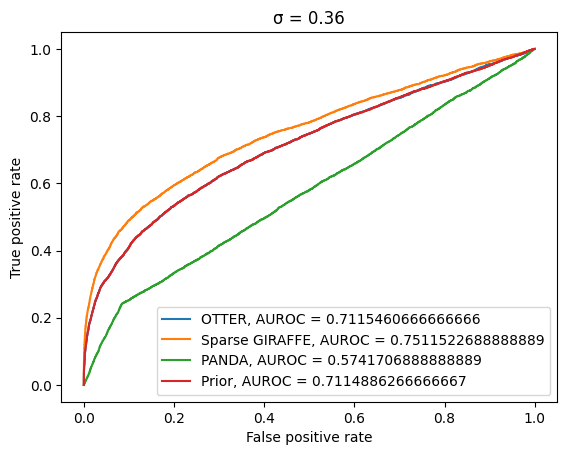

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3984
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.105443  2.419342 -0.759297  1.107212 -1.223854 -0.153628 -1.262929   
1    0.360379 -1.417569 -1.742132  1.237186  1.184469  2.197093  1.054780   
2    2.684610 -1.560793  1.964921  2.265697 -0.060805 -0.833887  2.204870   
3   -1.172506  0.022070 -1.519237  1.874531  0.525735 -0.060111  1.209981   
4   -0.865054 -3.103772  0.034095 -0.084285  3.038803  2.017765 -1.289038   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.280647  0.203672  2.054180  0.614553 -0.918509  0.134403  2.193059   
496 -1.579351 -0.494421  1.891513  2.683127 -3.112555  2.627925 -1.562320   
497

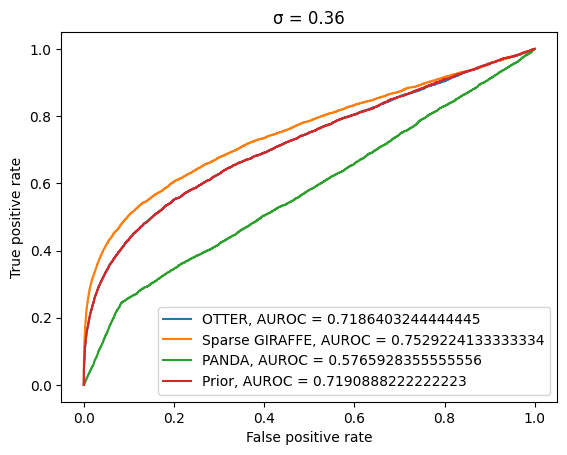

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3976
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.485270 -0.850352  3.560302 -1.581485  2.394841  0.756246  3.010126   
1    0.752753  0.447852 -1.994563  1.216729 -0.971867 -1.271737  3.660489   
2    2.862847 -2.028091 -1.390618 -0.560765  1.055090 -0.410874  1.072552   
3    1.309249 -0.287348  0.235360  1.713632  0.312864 -0.284231  0.917281   
4   -1.692228  0.338797 -0.163637  0.280874  0.635685  0.965295 -1.820023   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.020971 -0.103022 -0.356746  2.103021  1.579956  1.692818 -1.027126   
496  0.585463 -0.923674  2.864093  1.813955  0.473290 -2.246847  0.147665   
497

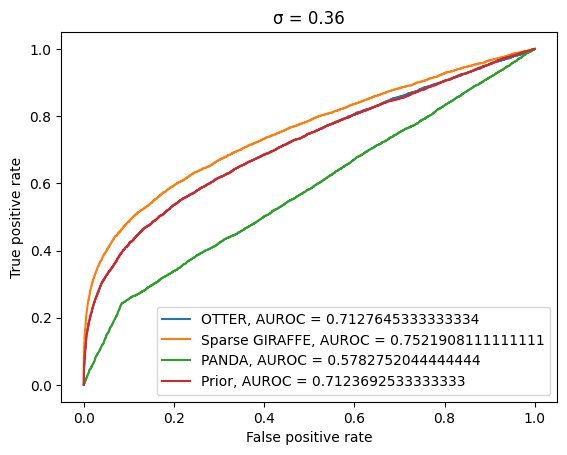

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3916
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.909517 -0.945375  0.827578  0.527598 -1.169229  0.399704  1.123865   
1   -1.537525  2.401017 -2.546370 -4.610611 -0.022386 -1.240002  0.532568   
2    1.109873 -3.917213 -0.288361 -3.031222  0.442588 -1.158318 -2.878431   
3    1.144006 -0.154580 -1.439908 -1.581442 -0.622343 -2.037096  2.711181   
4   -1.044565  0.536772 -0.380230 -0.282490  1.174435  0.312795  1.235882   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.804229 -3.792402 -3.390362  0.777113  0.923731 -0.789697  3.933621   
496 -0.252345  1.856440 -1.369287 -2.605086 -0.161784  1.527097 -0.327568   
497

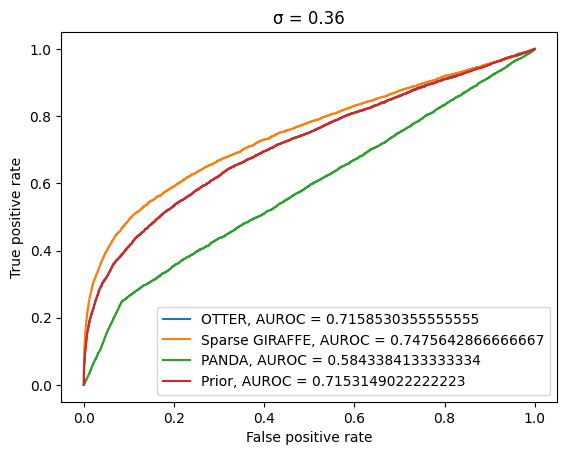

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3856
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.063180  2.643459 -1.030399  2.424162 -2.610638 -2.337734 -0.435914   
1   -0.444045  1.281578  1.149389 -0.631396  0.145220 -1.534587 -3.746557   
2   -1.313828  0.623416  1.176365  0.709235 -1.361919  0.107460 -0.580850   
3    0.018589  0.162578  0.091777  3.113833 -2.827717 -1.353636 -2.894435   
4   -0.171176  0.934627  0.719845 -0.511489  0.869157 -0.299496 -1.124753   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.502366  0.502032 -0.096134  2.378288 -1.141476  0.018827 -2.154106   
496 -1.666700 -0.436619 -0.345076  1.509621 -0.979571  2.670237  1.077885   
497

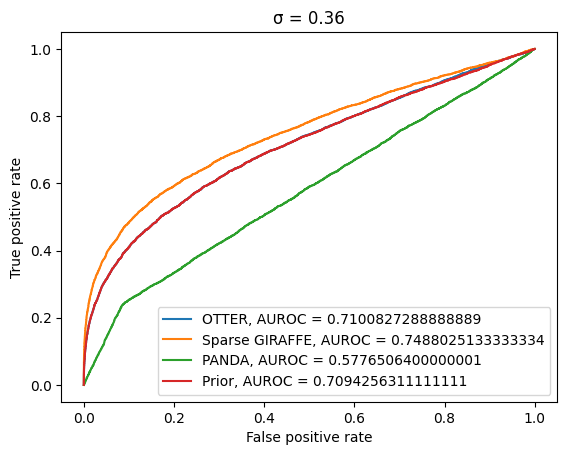

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3844
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.640006 -2.175796 -1.087764 -0.093436 -3.898073 -0.001616 -0.465168   
1    1.282824  1.714786 -2.345663  0.814831  2.582590  0.841262 -0.804535   
2   -1.617365 -2.224580 -0.874452 -1.164906  1.946817  1.660178  0.707395   
3    1.390438  1.005749  1.336998  5.078833 -2.286805 -0.653767 -1.640323   
4   -0.784763 -1.824761 -0.937130  1.138744 -0.718818  1.581598  0.509473   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.420500  1.657463  4.218883  0.420897 -0.803922  0.319536 -0.137419   
496 -0.650138 -2.061081  2.384233  3.899085 -0.241332 -0.474738  0.801612   
497

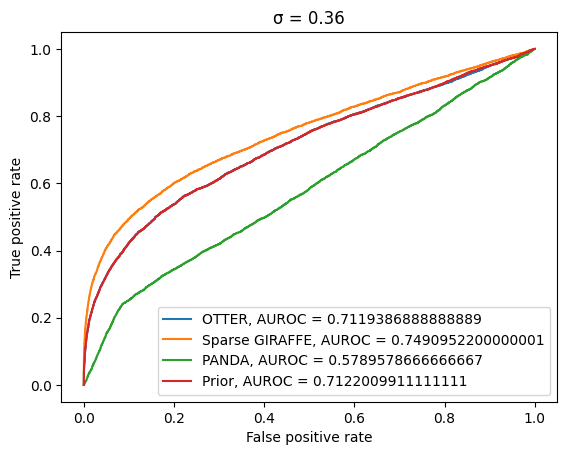

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3940
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.739714 -4.108252  0.245551 -0.004637  1.742246  3.542064  3.119150   
1    1.129831 -0.180350 -0.355889 -2.378426  0.831409 -3.841189 -1.956055   
2    4.109830 -0.946657 -2.683634  0.417473  1.585524  1.135596  1.019347   
3   -2.831427  2.532641  3.953406 -1.629037 -2.897749  2.226890  1.446735   
4   -2.235964 -0.244016 -0.113888  0.783886  0.994285 -0.037335  3.117079   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.275008 -0.410692  0.245743 -0.529727 -0.989796 -2.024777  0.946988   
496  0.086108 -0.767158 -1.987217 -1.107639  0.614205  1.092361  1.551151   
497

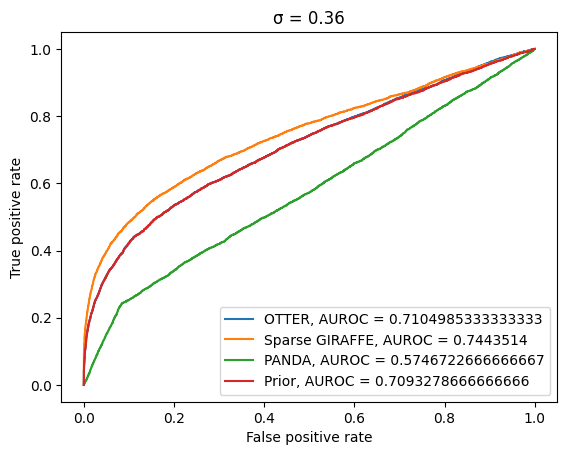

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3802
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.206656  0.186154  1.421983 -1.345138  1.314164 -0.997968 -1.760889   
1    1.900909  1.656896 -1.761490  0.108754 -0.684039 -2.093834  0.784364   
2    1.296327 -0.155798 -2.581249  1.780345 -3.020578  1.099446  1.046233   
3    0.148893 -0.295062  0.091499  1.536192 -1.027771 -2.069882  0.763290   
4    1.402374  0.131241  0.100148  0.107034 -0.938731  1.081676  0.974277   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.521875  0.239713  1.055019  0.732083 -0.594291 -0.668850  1.665681   
496  0.125650 -1.514739  0.556739 -0.576995  2.872122  0.082817  1.807886   
497

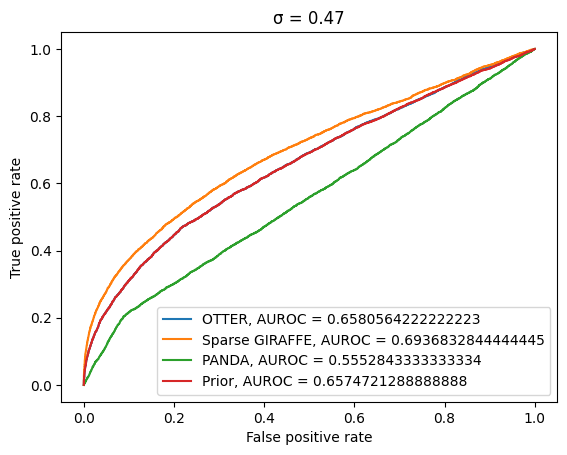

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3920
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.335766  0.103110 -1.781735  0.034006  0.547877  0.107029 -1.393159   
1   -1.322488 -1.229429 -6.840104 -0.217278  1.512081  1.907119  1.674216   
2   -0.240556 -0.459962  1.435659  1.198280 -1.199710 -0.524985 -0.588943   
3   -2.423947  2.952494  0.994964 -3.812058 -1.556468  2.756411 -0.406769   
4   -0.012851  2.101335 -0.162632  1.222216  1.106083 -0.000169 -1.637252   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.990126  1.551706 -1.432604 -1.384050 -0.931239  1.211855  0.457816   
496  0.141213 -2.548064 -0.024986 -0.751037  0.299625  0.198272  0.587140   
497

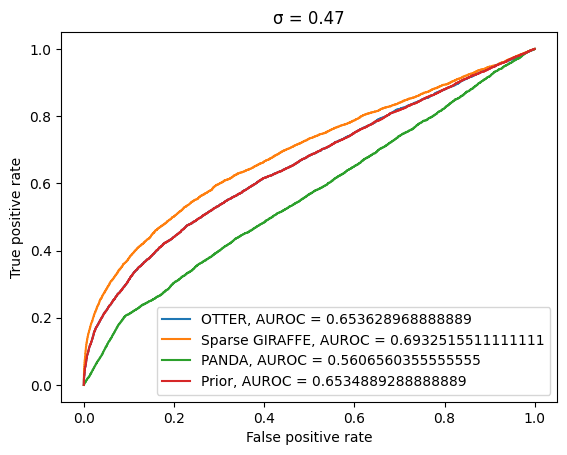

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3816
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.415668 -2.237834 -1.918242  2.478487 -2.350062  2.232224  0.831407   
1   -1.035466 -0.743038 -2.178305 -0.064487 -0.066925  1.685371 -2.206926   
2    5.092631 -0.167360  0.200253  1.631728  2.729069 -0.284685 -3.205076   
3   -0.132830 -0.844661  2.097422  2.302884 -0.568389 -2.392449  2.787013   
4    0.922466  1.910178 -1.939878 -2.551240  0.232743 -2.591425  1.700223   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.244950 -0.820163 -2.624112 -2.635551 -3.069392 -1.390835 -0.536606   
496  1.201822  0.845977 -0.827476 -1.232151  0.671157  1.414698 -2.151378   
497

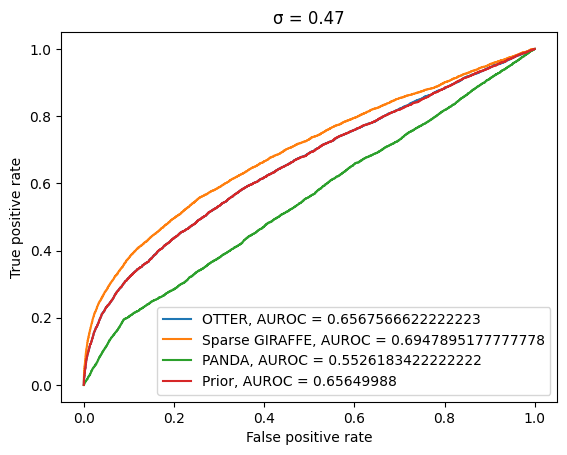

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3908
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.024717  1.038597  1.782021  1.612683 -0.280704 -0.506273 -2.382357   
1    2.272935 -1.939805  3.425855  3.959842  0.235946  0.606532 -0.172333   
2   -1.476531 -3.338856  1.371391 -0.500262  1.565449  2.661569 -0.744118   
3    1.921399  0.101038  1.200924 -0.505946 -1.260471  1.219267  0.008748   
4   -0.997948  0.753279  0.134159  0.500263  1.859013  0.194356  1.694750   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.395673  0.959769 -1.312321 -0.368535  0.755113  1.208705 -2.747247   
496 -0.607363 -1.466245  2.012778  1.310523 -1.671065 -3.098249  0.807669   
497

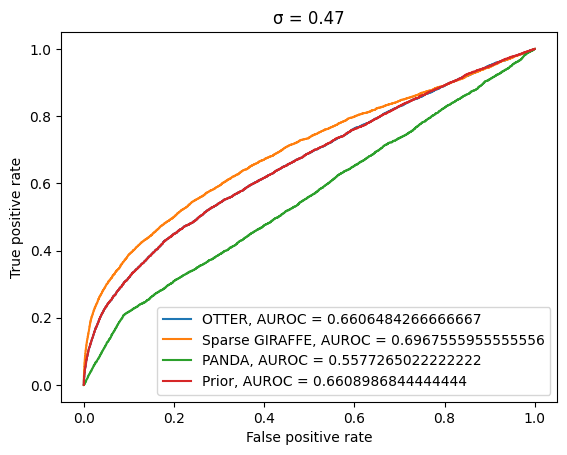

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3922
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.133073  1.449689  2.855598 -2.535060  0.572253 -1.973367 -4.091729   
1    2.069337 -2.201407 -0.072003  0.401513  1.283391  0.894397 -1.929803   
2    0.085448  0.300798  3.043585  2.570742  0.323206 -0.070460 -0.980077   
3    0.926753 -1.633724 -1.141386 -0.574436  0.429480  0.216175  0.566166   
4    0.541820 -1.216261 -1.344555  0.730689  1.043537  2.137429 -0.478361   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.639392 -0.214457 -0.999501  0.485244  1.206758  0.393105  0.417291   
496  0.075100  0.091927 -0.874366 -0.384257  0.822797 -0.092112  0.814272   
497

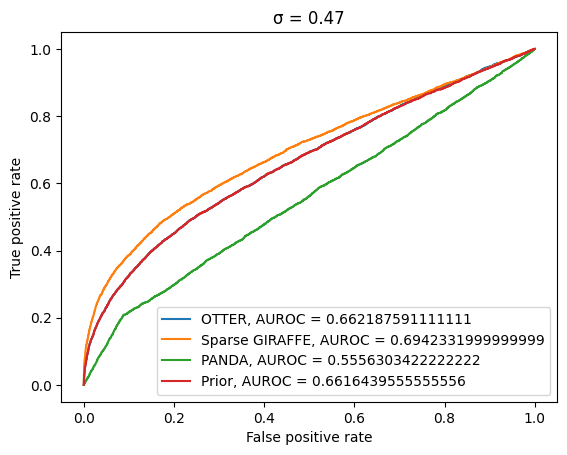

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3978
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.366262 -1.349732  0.744274 -2.599031 -3.062727 -1.950587 -3.480524   
1   -0.506313  0.424647  0.397717 -0.588095  0.029709  1.022191  0.492931   
2    1.037727 -2.790692 -0.156058  0.892772  3.113760  0.615200  1.914437   
3   -0.251780 -0.418604  0.315042  2.076454 -2.039911  2.201560  2.404199   
4    2.544187  2.010932 -3.688673 -0.329731 -3.195967 -3.289045 -0.702273   
..        ...       ...       ...       ...       ...       ...       ...   
495  5.337059 -1.288368 -2.883432 -3.155783  2.519695  4.907130 -1.774112   
496  3.980013  1.346147 -0.975564  0.390017  1.497041 -1.944029  2.613136   
497

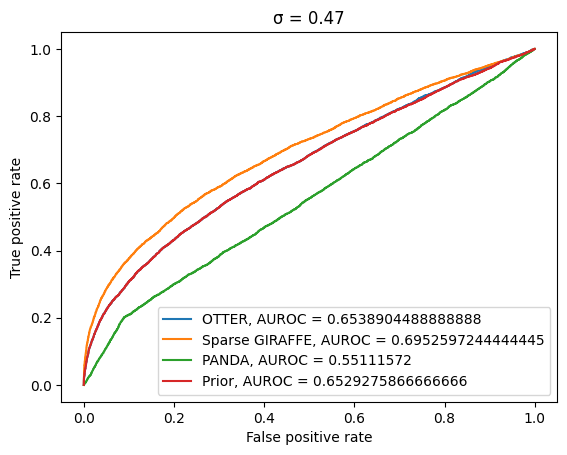

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3816
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.800257 -1.190503  2.789375 -1.420360 -3.722376 -4.102818 -2.011684   
1   -3.523275 -0.154228 -1.287688  0.862987 -0.218550  0.057870 -0.242205   
2    0.523332 -1.444364  3.684288 -1.356152  0.994648  2.454750 -0.778792   
3    2.340943 -2.930359  1.388922  2.434966  1.277035  8.424667 -0.647622   
4   -0.147787  2.155162  1.923966  1.358300 -1.649516 -1.427168 -2.582890   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.390541 -0.200638  0.698845  1.017682 -2.042628 -1.033858 -1.416309   
496  0.589554  0.491083 -0.893098 -0.529847 -1.412585  0.009670 -2.116345   
497

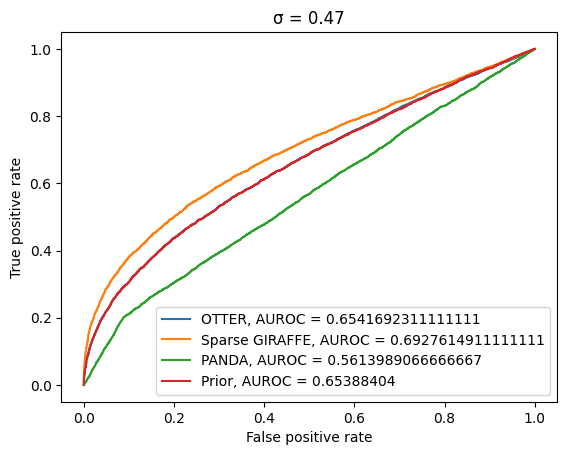

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3930
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.284258 -1.108634  0.004507  0.029689 -1.548508 -1.166879 -0.211338   
1   -0.408075 -1.119803  1.216595  1.720073 -1.562574  0.780675  3.090096   
2    1.373763  1.162266 -0.383656 -2.605689 -0.194387  0.121079 -0.442591   
3    0.314325 -2.242961 -2.139740 -0.383862  0.602953  1.118135  0.550037   
4   -2.004455  2.372646  0.453763  0.095408 -0.539330 -0.164936 -0.783125   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.096052  1.197866 -2.286332 -1.948847  0.013987  0.489702  0.298874   
496 -2.427827  2.181596  2.101424  2.465238 -0.736687 -0.093302 -1.666429   
497

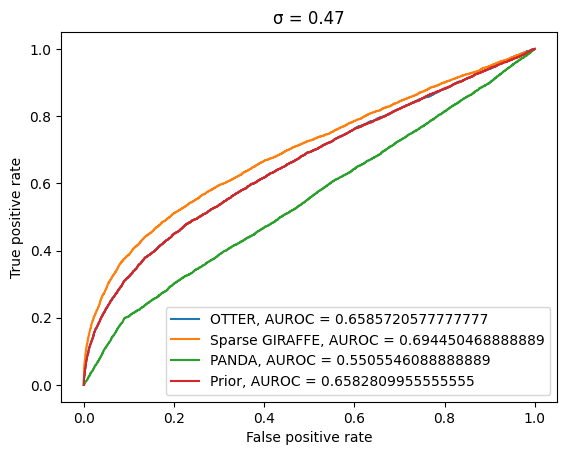

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3936
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.909880 -0.466915 -1.043471  1.129818 -0.196624  2.738052 -0.755420   
1   -0.711672 -1.077655 -0.854256 -1.162814  0.861084  1.171116  1.220650   
2    1.734944  0.238228  1.335932 -0.241116  1.608679 -2.338468  0.751813   
3   -1.059917  1.198642 -2.086828 -0.731255  1.065196 -2.041526 -0.107434   
4    3.438767  3.572663 -1.089886  1.849185  0.744248 -1.886488  1.844175   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.179365  0.104031  1.600704 -1.274316  0.844981  1.821317  0.882807   
496 -2.174193  0.114027 -0.864092 -3.171788 -2.720360  2.097472 -2.150981   
497

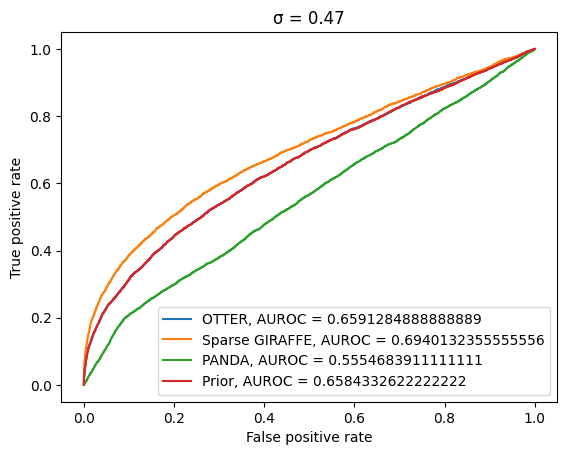

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3830
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.783839 -1.548713 -1.385565  0.340100  0.572344  2.868181 -2.067357   
1    0.808210 -1.882887  1.305520 -0.788039  1.283756 -0.799566 -3.655755   
2   -0.917107  2.368638 -3.078773 -0.845654  0.769017 -0.849801 -0.017250   
3    0.485520  0.796504  3.003423  2.982964  2.798332  0.237455 -1.760075   
4    0.780356 -0.463992 -0.972134  0.978915  2.422943 -0.146960  1.597870   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.807339 -0.357976 -0.495090 -0.605149 -0.386175 -0.440660 -1.469437   
496 -1.347671 -1.182713 -0.468642  3.836470 -0.620796  0.484915 -3.995167   
497

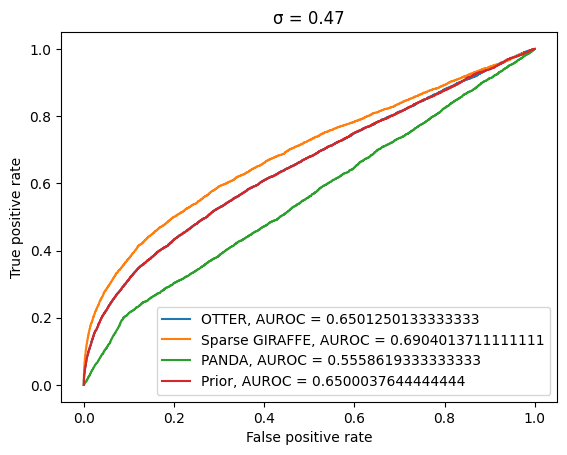

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3808
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.380769  0.179982 -1.751529  1.166206 -0.046296  0.721349 -1.644546   
1   -2.249406 -1.119640 -0.688285  2.030050 -2.531491  0.421956 -1.949112   
2    0.574210  1.239732 -0.313433  0.755019  0.267641  0.038086  0.590864   
3    0.644527  1.537038  3.025786  2.670259 -0.942404  1.387132 -1.744769   
4    1.583091  0.129768 -2.257441 -0.530153  0.497114  1.602884 -2.270064   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.966828  2.400097  1.522865 -1.685404  0.040207  2.970189 -1.504466   
496  0.061107 -1.581902 -0.373482 -2.125337 -0.767411 -0.889485  0.318794   
497

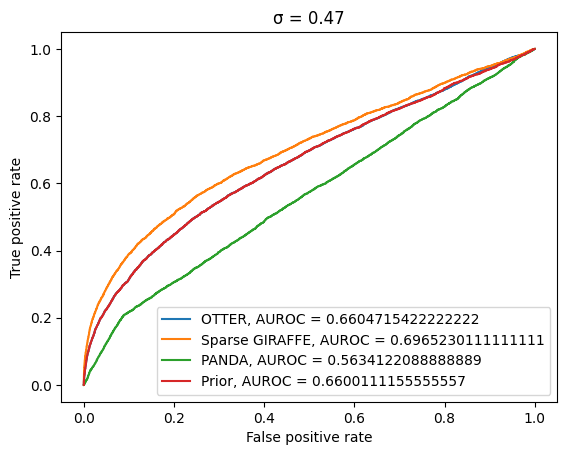

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3820
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.886964 -2.724612  2.086526 -1.441262 -0.825640  4.246624  1.188690   
1    0.312798  2.379398 -2.059809 -0.042468 -1.455366 -2.884626  2.291556   
2    1.491816  0.446900  0.273527 -1.899106 -0.629768 -0.706075  0.511464   
3    1.740572  2.627775 -1.961266 -0.351398  0.606227 -0.824974 -0.517673   
4    3.502331 -0.342642  1.268943  4.543358  0.696032 -1.314203  3.567604   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.637615 -0.945975  0.075121 -0.605659 -0.406831  3.287909  0.388125   
496 -1.985868 -1.201780  0.365234  2.116375  2.821478  0.340126  2.043312   
497

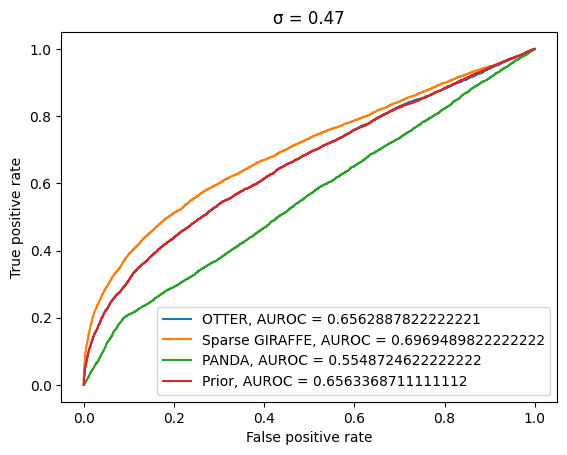

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3898
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.773756 -1.223267 -1.849274  1.519533  1.521249 -0.008586  1.968391   
1   -1.295268 -3.433735 -0.254248  1.437320  0.110638  4.526672 -2.321690   
2   -1.132524 -0.454252  0.210488  0.907815  2.239602 -0.415881  0.069718   
3    1.344848 -1.773641  0.641661 -0.365854 -3.443990 -1.500294 -2.892738   
4   -1.587259  2.250268  1.913722 -0.694577 -0.356676 -1.443858 -0.721802   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.185504  0.430865 -0.902791  0.374129  2.447985 -0.224448 -0.321220   
496 -0.494863  0.989593  2.613684 -1.639947 -2.272557 -1.721140 -2.980014   
497

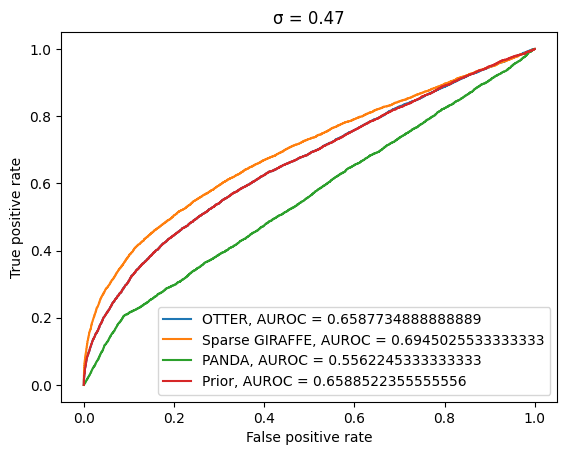

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3916
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.430187  1.355668  0.176978  1.365777  0.152334  0.649785  2.305720   
1   -0.496072  2.826882  1.223457  0.566580  1.569685 -1.180229  2.755997   
2   -0.494573  0.370938  3.147379 -1.961225 -1.595761  2.202327 -2.053872   
3    0.535165  0.501709  3.618946  3.223415  1.799859 -2.281544  1.353367   
4   -1.110594  1.729309  0.822828  0.074607  1.626931 -0.818153  1.513310   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.955669 -0.542006 -1.760438 -0.870863 -1.085672 -1.176617 -0.153114   
496  3.423980  0.299139  0.536906 -0.266464 -0.896439 -1.352527  0.863267   
497

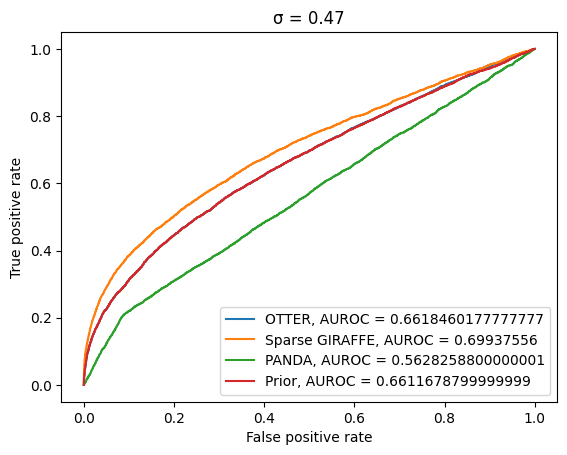

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3804
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.000626 -0.401436 -1.588702 -1.722839  0.419995 -0.003246  0.651357   
1   -1.384279  2.861164 -0.620581  0.062683  1.555013 -0.175763 -0.211411   
2   -1.317584 -0.595136  1.035012  0.444562  1.891710 -0.503406 -1.126021   
3    0.345221  1.062991 -2.210817  0.671914 -1.494232 -1.344026  0.708486   
4    1.841705 -1.384673  0.983560  1.971785 -0.910743 -0.192134 -0.093594   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.015596  0.451911  1.883888 -0.455106 -1.975327 -0.686800  0.423771   
496 -0.117327  1.337922 -1.120331  3.266693 -0.368143  0.808584  0.761555   
497

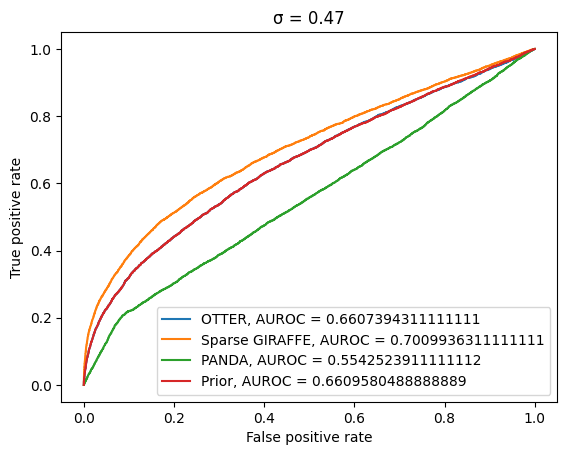

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3868
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.319662 -0.607862  0.179518  2.986024  2.489232  1.487937  0.800440   
1    5.435674 -2.194333 -1.019682 -0.821849  0.359530  1.379594 -0.372054   
2   -0.665864 -0.668562 -2.073632 -4.014394  0.466811 -0.397008 -0.599740   
3    1.989608 -0.548603 -1.827280 -1.254849 -0.888152 -2.906698 -1.694910   
4   -1.122004 -2.176694  0.003708  1.517510  0.502507 -0.618482 -2.109054   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.017121 -0.118087 -3.119749 -0.039683  1.314872 -3.399869  0.834258   
496 -3.099780 -0.723333  0.578025  2.424568  3.852220  0.659119 -2.293055   
497

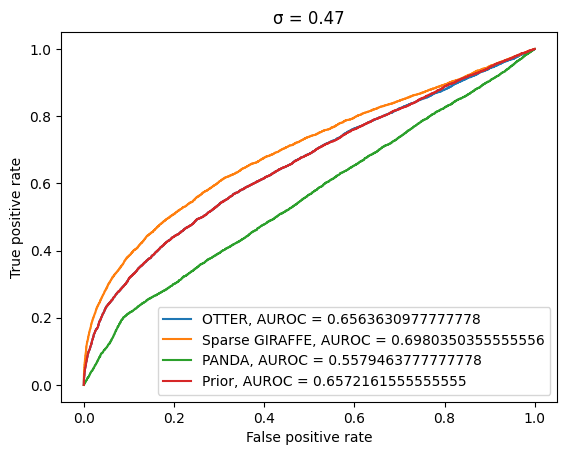

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3968
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.490554 -0.229685  0.067046  0.979338  1.703956  0.131103 -0.145600   
1   -0.341027  2.902018  3.113565 -0.054392  0.650041  0.397932  1.078114   
2   -1.110762 -0.065595 -1.341204  0.515782 -0.573910 -0.948138  0.607043   
3    1.210012  0.645371 -0.484338 -1.225508 -0.152325  1.334206 -1.202891   
4    0.694057 -1.962701  0.097963  2.241410 -2.419301  0.006113  1.089654   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.744543  2.860724 -1.490343 -1.176374 -0.198596 -1.605515 -2.195065   
496 -0.011794  2.300041 -2.838141 -1.494356  0.664975 -2.520533 -1.602471   
497

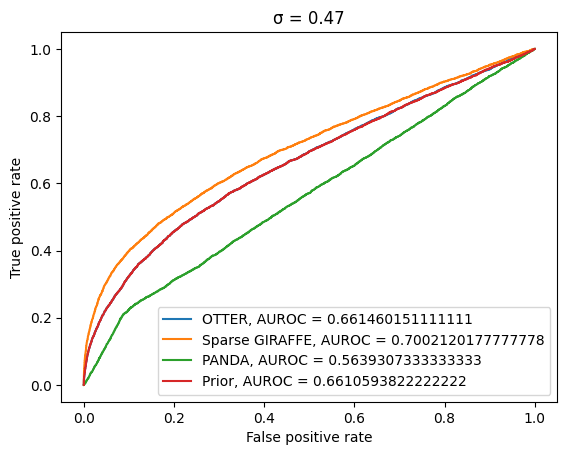

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3880
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.340315  1.057148  2.982671 -2.466383  1.443271 -2.163538  0.752116   
1    0.710917 -2.481424  0.561758 -1.439606 -0.852818  0.654475  2.158680   
2   -0.937715 -2.648389  1.214220  2.533469 -0.321416  0.178915 -1.440891   
3   -1.033695  0.133221  2.346332  0.697262 -0.943013 -0.610642 -1.306567   
4    4.151086 -3.073088 -1.322107  1.685136 -0.356188 -0.374430 -0.776331   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.195312 -0.566829  4.152639  0.463727  2.533975 -0.045689 -1.311924   
496  0.069103 -3.071493  1.406948 -0.033563 -1.823468 -0.709445 -0.992160   
497

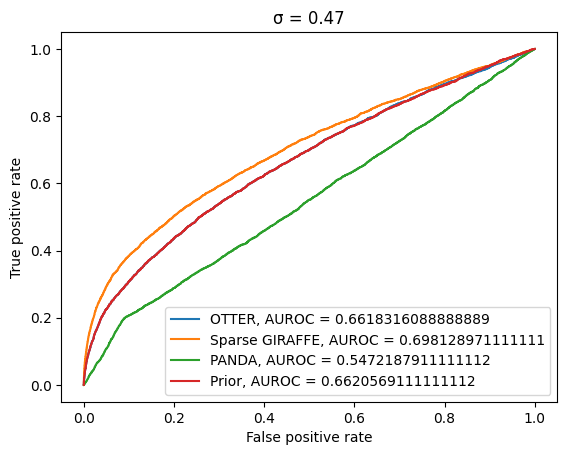

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3850
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.411071  1.741052 -0.871182  2.148156  1.436854  0.811239  0.311764   
1    0.362677 -0.627938  1.253264  0.719772  1.877489 -0.095951  0.534376   
2    0.414190  0.198361  0.018437 -0.485683  0.649461 -0.591152  1.653115   
3    2.700521  0.834861 -2.065136 -1.287541 -1.355970  3.904171 -2.695153   
4   -3.389523  4.341861 -0.682531 -4.418182 -0.857280 -2.607102  2.570604   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.646692  0.370500 -1.297764 -1.391723 -2.881633  0.388590 -1.521429   
496  0.365562  0.291490 -0.595133  0.325114 -1.560402 -2.158781 -0.087705   
497

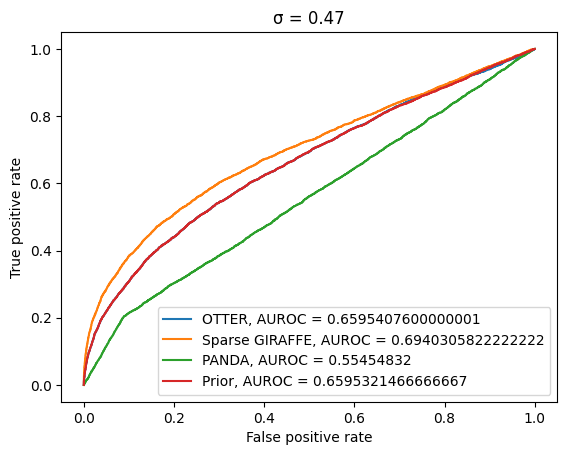

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3842
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.093983  1.229951 -1.628285  1.799009 -1.038628 -0.315807  1.484646   
1    0.654530 -3.003668  1.928432  0.818476  0.869561  2.888713  1.403143   
2    0.637949  3.706547 -1.499122  1.972201 -0.533174 -3.169623 -0.540853   
3    2.418882  0.736720  1.122813  1.393130 -2.055274  0.935133 -1.438330   
4    0.534493 -1.761714  0.582598 -1.244273 -2.460658  3.019503  0.124357   
..        ...       ...       ...       ...       ...       ...       ...   
495 -3.967224  1.819537  2.433479  1.134943 -2.827930  0.321985 -4.074918   
496 -0.349827  1.411962  0.066176 -2.074037  0.722784 -1.249823 -1.357435   
497

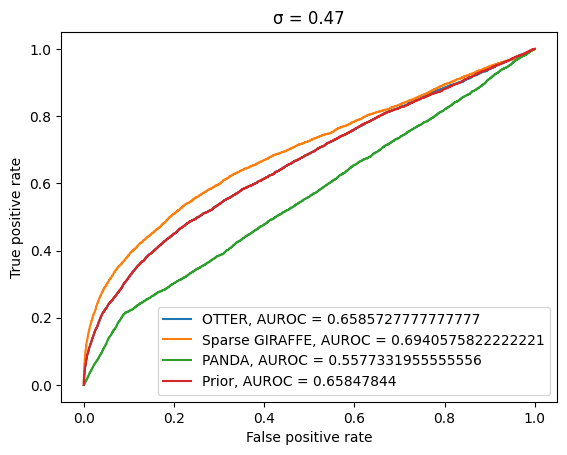

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3890
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.433243 -2.540124 -2.906335  0.518702  0.963165 -1.247099  0.460694   
1    2.304085 -3.298782 -0.923539  1.351822  2.028883  3.550593  0.668486   
2    0.279534 -2.170775  4.350705  0.482399  0.076853  1.414583 -3.045666   
3    1.448484 -0.282245  2.981962  2.786113 -1.435727  0.546272  3.211451   
4    0.371978  2.016015 -2.682444 -0.987275  0.325329 -1.498451  0.720421   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.350068 -2.521194 -1.059173  5.797033  0.513598 -3.376421  3.271647   
496 -1.100354  1.401640  0.780302 -0.708369 -0.108007  4.840754  0.918113   
497

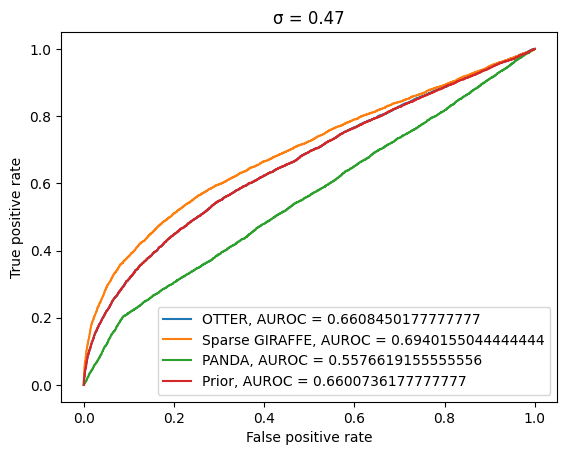

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3918
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.320066 -0.776716  0.784729  1.406198 -1.508327 -1.195830  0.537837   
1   -2.618127  1.541807  0.464457 -1.509566 -2.406047  1.239444 -0.537915   
2    0.224056  1.059737  0.038857 -0.597002 -1.662488 -1.959299  0.773415   
3   -0.506362 -4.975199  1.638218 -1.904034 -0.176860  1.221521 -3.354286   
4    2.659972 -0.326289 -0.460580 -0.764046  2.933916 -0.849296  0.599343   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.141009 -0.748160 -0.980017  1.266581  1.248780 -4.061314  1.493165   
496  1.671957  1.079757 -2.396276 -3.299761 -1.391268 -3.073082 -2.880352   
497

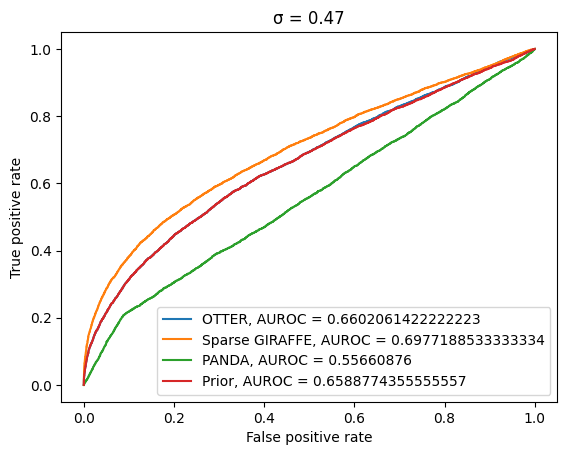

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3924
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.430928  0.415950  0.086264  2.445455 -0.820956 -2.369906  0.362744   
1   -1.554336  2.671301 -3.488218 -0.507829 -1.083787 -0.545001 -1.449527   
2   -0.745719 -1.606612 -4.051302 -2.726225 -1.999046  1.380898  1.309215   
3    1.168686 -2.774828  0.418117 -1.762242 -0.770523  1.083903  0.594932   
4   -0.132409  1.782634 -1.840289 -0.508355 -0.781906 -3.425623 -0.073297   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.201836  1.863795 -3.100098 -2.700029 -2.720280 -1.780611 -1.643983   
496  3.384032 -2.131720 -0.549979  0.231286  1.371641 -2.799173 -1.822955   
497

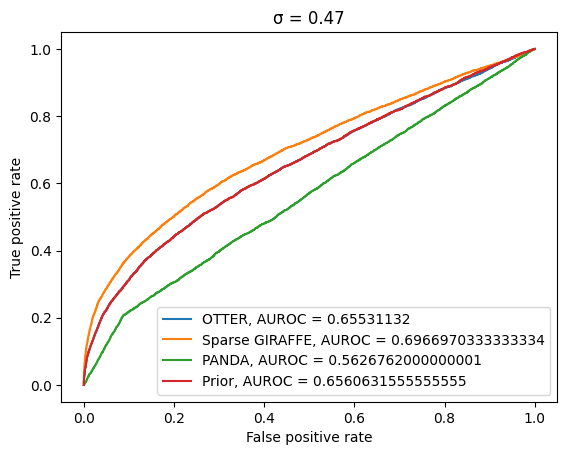

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3956
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.547607  0.542001  2.591443 -2.691471 -1.353458  0.325409 -1.420471   
1   -0.552735 -1.999984  0.945230  0.014218  1.989694  0.650318  2.955721   
2    0.340975  0.260473 -0.518103 -0.381343  0.349696 -1.380787 -0.067279   
3   -0.611094 -0.215016 -0.556455  0.649458 -1.011311  1.833672  0.965089   
4    2.746924 -2.224877 -1.123504 -0.172460  0.745678  1.196233 -0.637594   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.321013 -0.722729  0.046212 -0.496342 -1.341312 -0.046415  2.239576   
496  3.547802  2.506578 -1.207790 -1.205697  4.166310 -2.694356  0.780109   
497

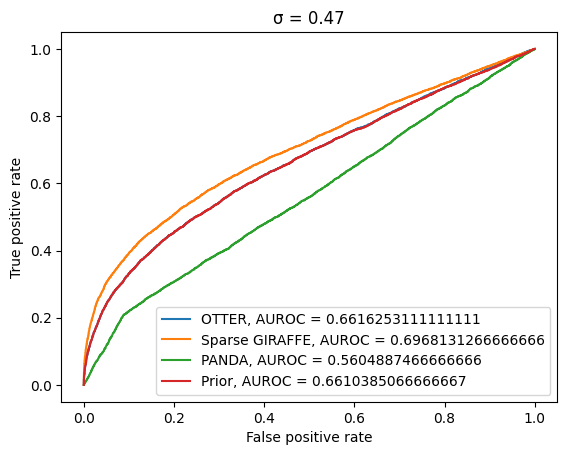

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3894
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.818068 -0.342734 -0.995779 -1.079463  4.540802  2.512561 -3.058722   
1    4.284582  1.111403 -1.565516  0.895101  0.431347 -0.584583 -2.083729   
2   -1.985474  0.427787 -2.939805 -0.752556 -0.748726  1.053806  1.645440   
3    3.170852  0.383756  1.770136 -1.457409  2.885803 -0.276301 -1.556125   
4    1.097731 -0.170973 -2.321253 -0.675681 -0.706302 -1.005669  0.605857   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.347454 -0.367993  0.082233  0.625491 -0.240841  1.269548 -0.396713   
496 -2.612961 -1.196730  3.296791  3.027337  2.673688  0.236543  0.582358   
497

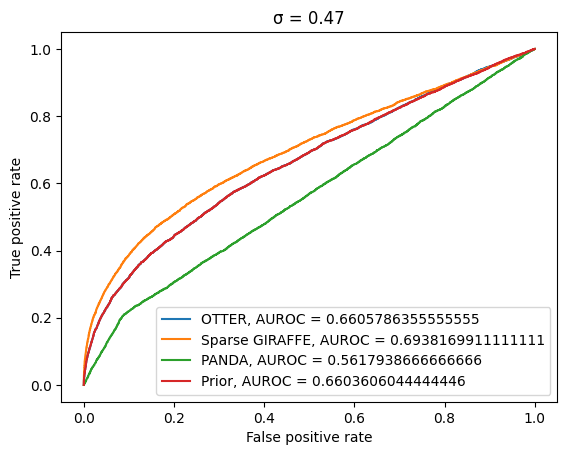

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3940
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.913990 -3.058796  0.291399  2.518294 -1.612529  0.838817  3.866388   
1   -0.861134 -1.436630  2.666335  3.674868  0.127953  1.814285 -0.558819   
2    0.606844  1.810104 -0.987314  1.228527  0.831576  0.557851 -0.410301   
3   -2.957468  0.224856 -0.410181  1.721440  0.821582 -3.040946  0.568791   
4    1.798556  1.021813 -0.024368  2.480200 -1.016698 -2.221850 -0.094632   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.083465 -0.436047  1.979260  0.426889  1.248015 -1.459183  3.962523   
496 -0.336458 -3.353577 -3.637853 -5.613843 -2.177379  4.233709 -5.607571   
497

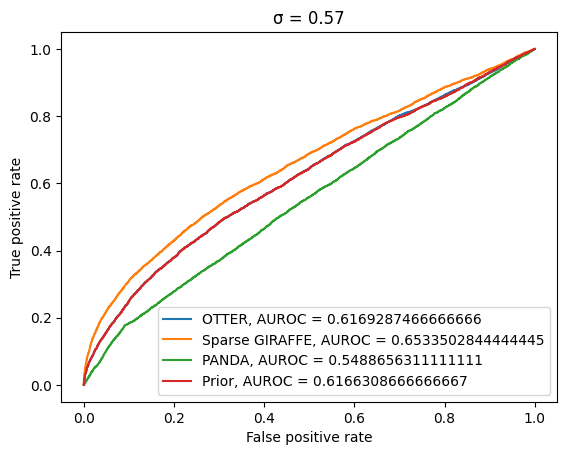

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3980
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.149975  1.334795 -1.067509  3.861061 -1.612258 -2.173429 -1.258995   
1    0.304536 -0.156781  0.149775  1.171844  0.696244  0.541891 -1.612562   
2   -0.755979 -1.632944  0.976604 -0.464084 -0.463122  0.156055 -2.117097   
3   -1.194279 -0.717240  0.867318  0.331790 -1.333692  2.038936 -1.491121   
4   -0.455840  1.676085 -2.201147 -1.815170 -0.776513  1.699067  1.606825   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.018748 -2.727340  3.731766 -0.731897  2.331317  2.291923 -0.793436   
496 -2.052823 -1.768880  0.803722  0.787426 -1.567869 -0.544577 -1.709270   
497

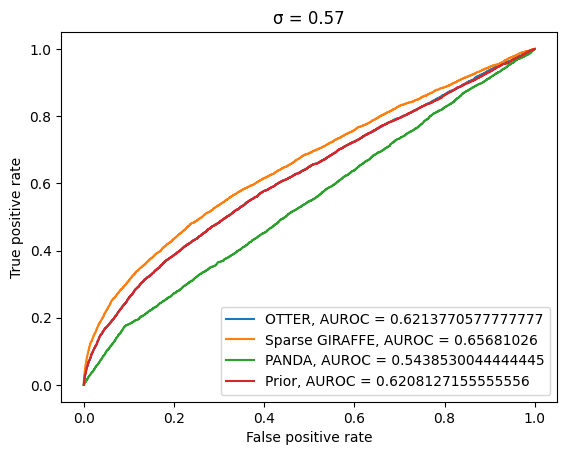

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3888
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.001648  0.232741 -0.931748 -1.949163 -0.402763  1.437696 -1.328295   
1    2.064435 -1.132955  0.863893  1.923974  3.332596 -1.351633 -0.354180   
2   -0.122588 -0.730765  1.780272 -1.612221  2.812327  2.447084 -0.772503   
3    0.518508  1.458982 -2.184945 -0.988450 -0.164841 -0.968457 -0.391422   
4    1.961696  0.217530  0.352121  2.422422  3.090534  0.511061  1.123805   
..        ...       ...       ...       ...       ...       ...       ...   
495 -3.476811  2.515030  2.962343 -1.543218  1.310389 -5.193784  0.345611   
496 -0.535797 -2.214011  5.017717  2.324925 -0.947379  3.036104  2.803018   
497

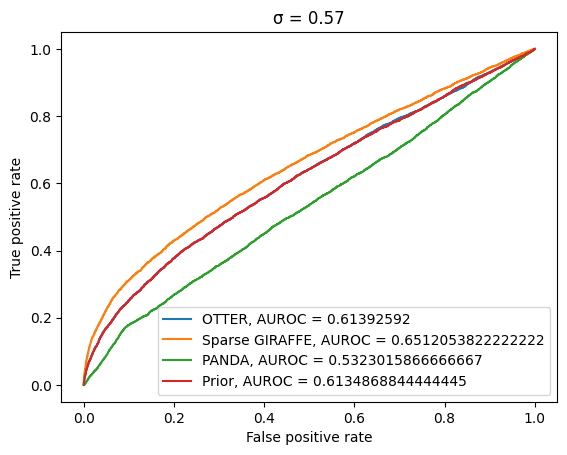

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3968
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.843785  0.346068 -0.484619  1.284416 -0.114641  1.717293  1.293845   
1   -0.043385 -0.375646  0.486521  2.559165 -0.507000  2.582014  1.009388   
2    1.366764  1.089635 -0.695566 -2.793814  0.081569 -2.285791 -3.062252   
3    0.591494  0.832078 -3.019855 -0.791777 -0.915125 -1.489207  2.410489   
4    1.395478 -2.093149  0.720096 -1.970859 -0.863356  3.241690 -1.208417   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.099809 -1.102560 -1.403191 -0.773886 -1.531683  1.136674  0.131055   
496 -0.555297  0.729391  0.124790 -0.994456 -1.564944 -0.273924 -1.389813   
497

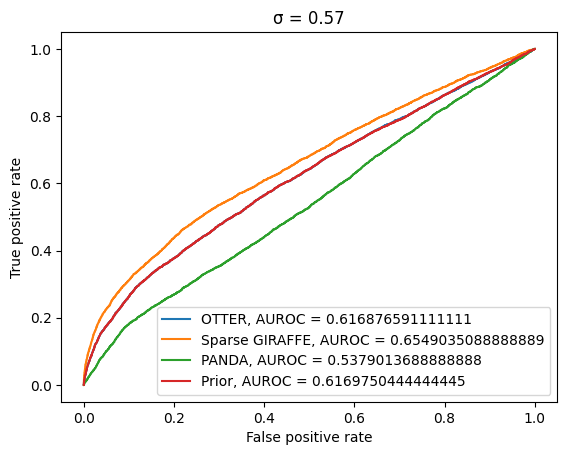

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3842
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.662685 -1.779072  0.172466 -0.320462 -0.555757 -1.544052  0.543169   
1   -1.956361 -1.890243  1.849376 -2.895071  0.035960  0.419503 -2.088324   
2    1.197052  1.403186 -0.260446  1.126399 -1.333525  2.873603  0.897571   
3    1.610123 -2.934119 -0.143207  0.722226 -0.248384  3.552274 -2.085026   
4   -0.263224 -1.085049 -0.066289 -0.916411  1.301914  0.598410  0.003474   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.547666 -2.454799 -0.560904  1.621926 -0.708200 -0.020272  0.581306   
496  3.984430  0.307181  3.144864 -0.617125  0.224008  0.118363 -0.770863   
497

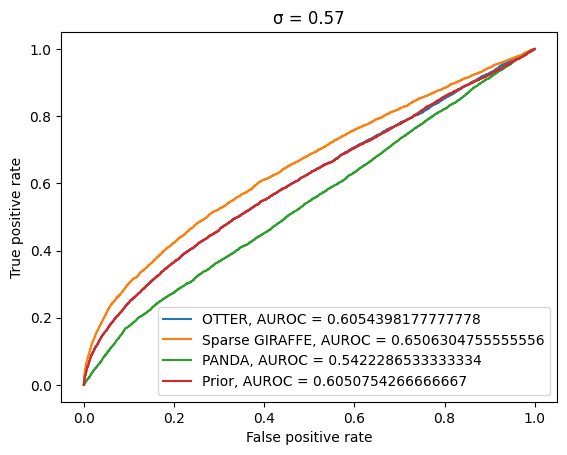

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3806
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.718734 -0.279021 -0.450700 -1.295939  2.008779  0.820410 -3.509597   
1   -1.034141 -1.645028  2.011379  2.334150 -2.857303 -0.255915  2.147949   
2   -0.956400  0.031637  1.174268  4.688210 -1.590321  1.675553  1.334353   
3   -0.267323  0.121257  2.652469  1.336281 -0.943385 -2.846819  0.283883   
4    0.014792 -2.370164 -0.047069  0.581116  1.162637 -0.216459  2.091465   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.779154  0.450867  2.889973 -0.404182  1.422990  0.964457 -0.661243   
496  1.480885  1.853161 -3.088525 -1.490394 -4.125181 -1.044133  0.370809   
497

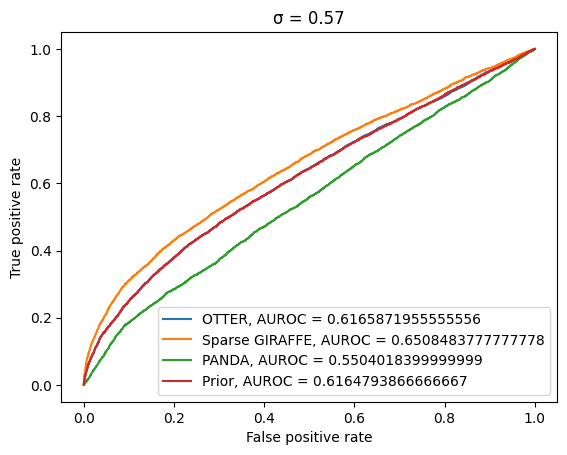

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3890
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.104929  1.301736 -1.301823  0.904528 -2.304792 -1.177810 -0.649884   
1   -0.322366  1.256902  0.737944 -0.005104  1.204619  0.986957  1.567875   
2   -0.245095  0.059284  0.243601 -2.711216  0.116201 -0.175748 -3.183270   
3    3.349316 -0.860238 -1.413198  2.446541  1.151873  1.899841 -1.748842   
4   -0.184053 -1.655891  0.160480  1.294862  1.572305  1.620863  0.708453   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.085628 -0.572272  0.875594 -1.983234 -2.241530 -0.141973 -1.932801   
496 -1.245946 -0.533773  2.231614  0.506713  1.674661  2.396451 -2.332680   
497

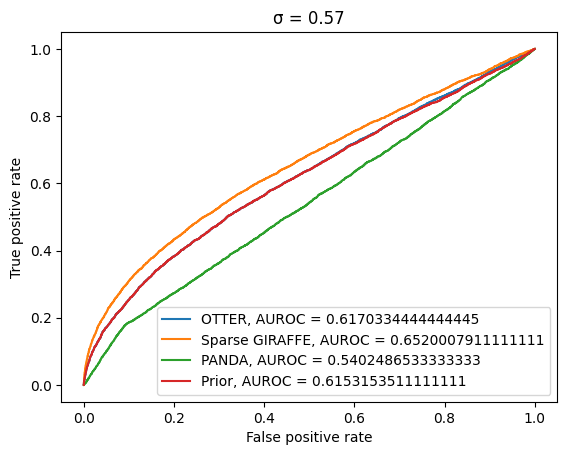

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3848
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.690580  2.271182  0.489670  2.244144  2.317610  1.059148  1.967338   
1   -2.402908 -1.133215  1.528502 -2.783009 -0.874944 -0.606262 -1.823690   
2    1.212235 -1.608730 -0.776810  2.310888 -0.084718 -0.765497 -0.703262   
3   -4.577204  2.004585  1.122352 -3.455224 -1.074132  1.181766 -2.055072   
4    2.022310 -2.293618 -1.757208  1.697007 -1.141310  0.055270  2.188475   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.049852 -0.968331  0.723380  0.746357 -1.033855  0.034399 -1.197222   
496 -0.500703  0.291658  1.134122 -0.201408  0.198468 -0.087343 -0.030133   
497

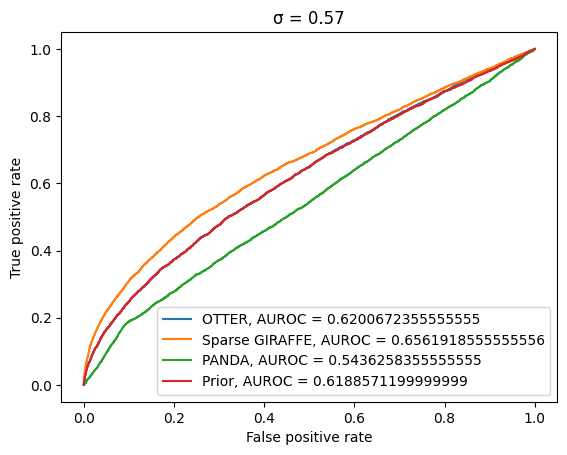

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3856
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.075547 -0.954451 -1.651948  2.913337 -2.689667 -1.039344 -0.671607   
1    3.258877 -0.120269 -0.793488 -1.802844 -3.005248 -1.344336 -0.194746   
2   -3.430118  2.100433 -2.585098 -0.199428 -1.545026 -0.881994 -0.111093   
3   -0.213566 -0.691722 -3.452322 -0.264759  0.026023 -3.310204 -2.002069   
4    2.352754 -1.083558 -1.771283  2.698519  1.304567  2.757177  1.904728   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.789741 -0.408619 -0.407022  0.842250  1.399626 -0.318118  1.336062   
496 -0.597306  1.304392 -1.601332  1.640631 -1.863959  0.160906 -0.233414   
497

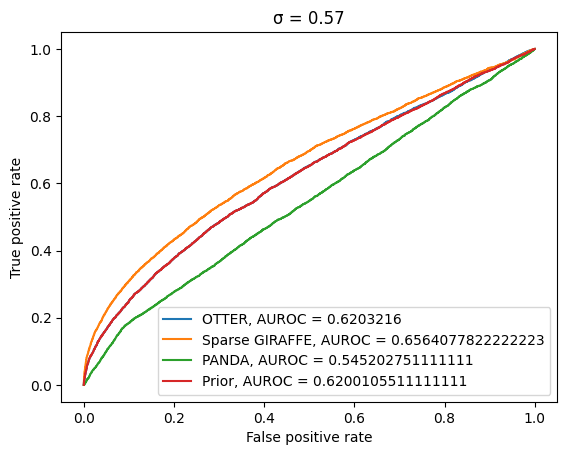

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3864
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.012441  0.866223  1.098553 -2.245477  3.288987 -1.307803 -3.261903   
1    0.777584 -2.642218 -0.693062 -0.652557  0.064832  0.171219 -2.005630   
2    1.180587 -0.357913 -1.990372 -1.157812 -1.356799  1.425623 -1.494582   
3   -1.067847  0.011470  0.015315 -0.855750 -1.685986 -2.486809 -0.686384   
4    1.967061  2.135421 -0.858402  1.904563  1.907930  1.772252 -1.181583   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.638189  0.610831 -1.327128  0.698396  0.569943 -0.561577  0.070638   
496 -0.301480  1.865274  1.615406 -3.838034 -0.478000 -4.164920 -0.340753   
497

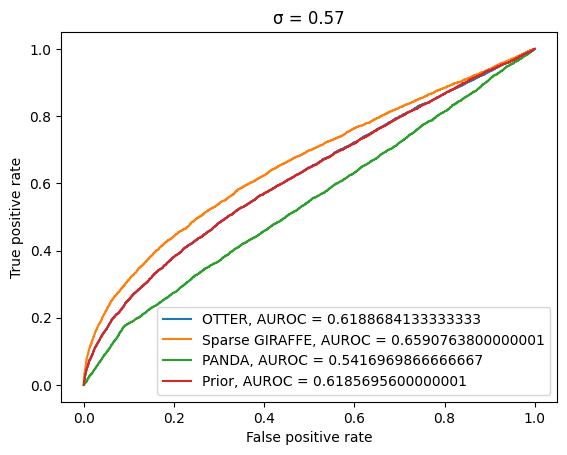

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4050
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.166436 -2.939779 -2.713792  1.313922 -1.444196  1.247687  2.848351   
1    1.923355  0.144869 -0.639484  1.070624 -0.493678  2.811761  2.296472   
2    0.315502 -1.532096 -0.413628 -1.343621  0.497430 -1.383122 -2.342216   
3   -0.737854  0.635328 -0.974060 -1.958640 -1.227051  1.128792 -1.250763   
4   -1.152295  0.807737  0.327347 -0.061842 -1.011069 -2.060896 -0.803005   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.795644 -1.212547 -0.069385 -1.244756  1.191037  1.171576  0.959517   
496 -5.033717 -1.965804  2.806361  1.428687 -2.602429 -3.638844 -1.144155   
497

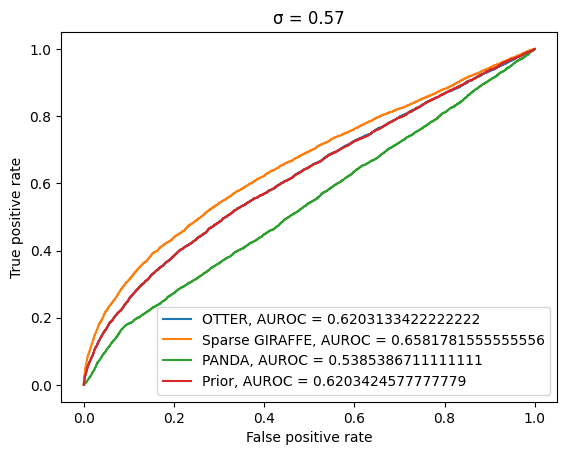

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3872
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.085581 -0.448091 -1.880003  0.614256 -0.152778  0.506839 -1.379452   
1   -0.077043 -0.357544  2.246364  3.301729 -0.646074 -0.584487  2.115276   
2    1.576719  1.369780 -0.996005  0.632250 -1.944569 -0.689661 -0.535535   
3   -0.512635  0.873541 -0.541816 -1.362976  1.100055 -1.480916 -0.324350   
4    0.427644  1.741770 -0.430815  2.258551  1.352700 -0.337368  1.240916   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.611455 -1.912877  0.125518  2.720386  0.024299  2.502996  3.004151   
496  2.298024  1.178795 -1.177838  0.732901 -0.192996 -0.479658 -4.528611   
497

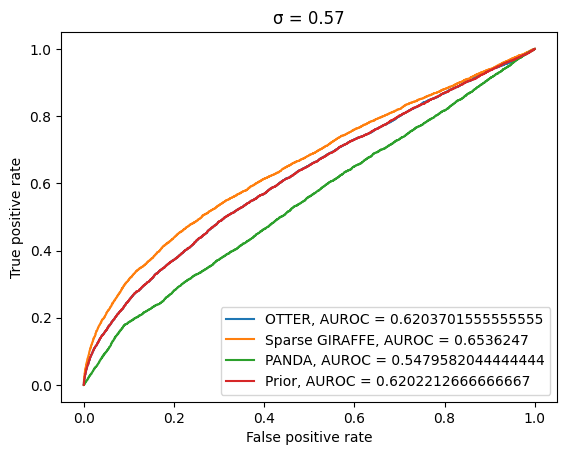

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3902
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.198288 -1.028107  2.035038 -2.021865 -2.772072  0.255995  0.985888   
1    2.080972 -0.057074 -1.071371  2.384542 -1.329246 -2.031931  2.953364   
2    0.729071 -1.188732 -2.742348  2.100046  0.419684  0.390125 -1.693297   
3   -0.379427  2.083246  0.136336 -2.799230 -1.257746 -1.615181 -0.416202   
4   -0.145212  0.534602  0.682968 -0.434135 -0.541095 -2.389327  1.436488   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.532186  0.735199 -0.342533 -0.310051 -0.117820 -1.067942 -0.788618   
496  0.782276  0.146068  1.713372  1.792547  1.067083 -3.351266  0.552091   
497

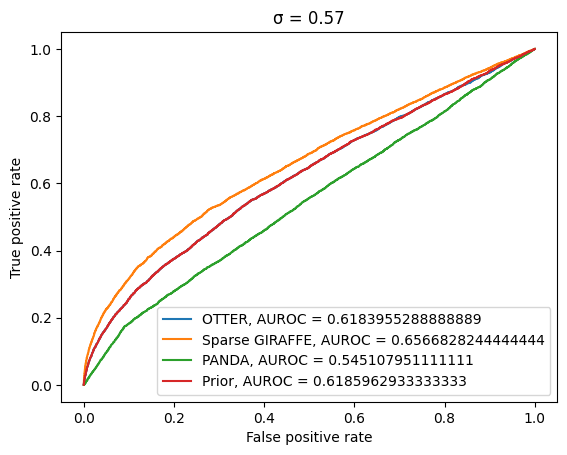

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3910
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.141606  1.206098  3.333577  0.222752  1.427148  0.083003  3.070166   
1   -1.582268  0.305408  0.993521  2.460827 -1.584016  0.148167 -0.072029   
2   -1.425498 -0.601014  1.057273  0.179981 -0.926538 -4.297444 -2.248185   
3   -2.980440 -0.752023  0.821456 -0.973193 -0.534312  2.385737 -0.707905   
4    2.573321  1.368878  0.304073  0.225180 -0.228223 -2.067296  0.775654   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.821237  1.932978 -0.321230  1.476467 -3.009773 -1.739157  1.743744   
496 -1.579597  0.898172 -3.333804 -1.276448 -0.121841  0.539516 -0.971052   
497

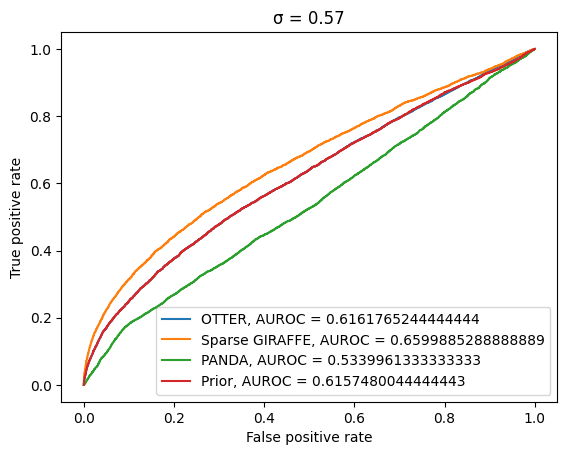

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3918
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.979626 -2.164959  1.662546  0.728509  0.397084  2.410958  3.162263   
1    2.579765 -2.839697 -0.771486  1.668529  1.949113  1.112893 -1.197223   
2    2.404745 -1.321872 -3.118765 -0.187237  0.893604 -1.048822  1.181362   
3    2.441246 -1.233466  0.651024  2.459969  1.283674  3.248245 -0.310733   
4    0.358301  1.148436 -2.017204 -2.508688  0.949420 -2.934192  4.021034   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.971189  0.165130 -5.414673  0.006513  3.030188  0.008764 -1.813876   
496  3.231323  2.462617  0.643988 -1.087618 -1.128456 -2.346847  1.265739   
497

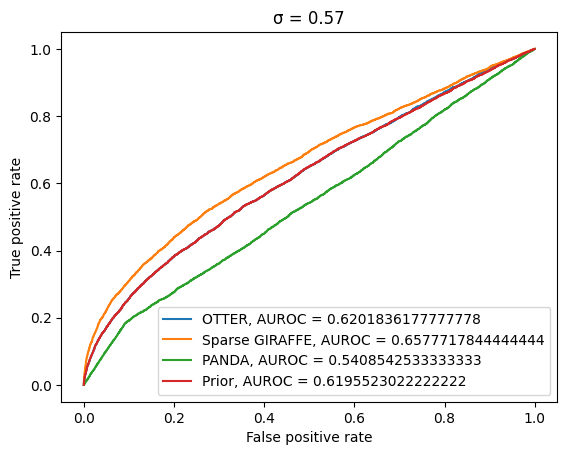

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3946
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.010752 -1.191859  1.515884  0.063148  0.144447  1.918358 -0.116840   
1   -2.065480 -0.390560  2.018938 -1.268053  1.216185 -1.210101 -0.002346   
2    3.017589 -2.148147  1.936320  0.048117 -1.908116  3.126591 -1.191112   
3   -1.051781 -0.463655  1.779973  1.588619  0.245208 -1.617166 -0.382660   
4   -0.600489 -2.117111 -1.641298 -0.659037  0.598426  2.787846  0.454109   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.565473  1.227183 -0.118726  0.437936 -0.165077 -0.339317 -0.572439   
496 -1.352459 -0.605774 -0.339557 -0.085336 -1.492613  0.746297  2.350393   
497

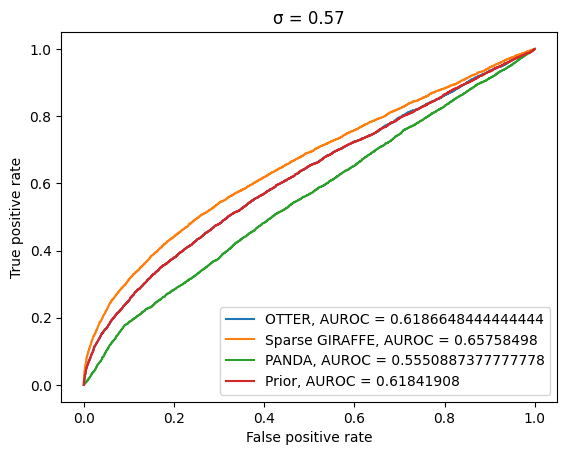

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4060
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.956584 -3.352422  2.803763  0.704205 -1.269170  2.886768  3.436695   
1   -0.919125  0.020642  0.699946  1.535149 -1.877876 -0.295334 -0.985620   
2   -1.009037 -0.275076 -1.091090  0.014083  0.770588  0.681125  1.286057   
3   -1.048109  0.144642 -0.308093 -2.004525 -1.215361 -1.919334 -0.013691   
4    1.395971 -0.224708 -1.148583 -0.890002  0.135905  2.356260 -2.903119   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.141942  2.695197 -0.517657  0.798049 -2.212136 -0.413730 -0.231651   
496  1.795596 -1.603583  0.878585  3.783729 -1.889227  2.442100  0.263296   
497

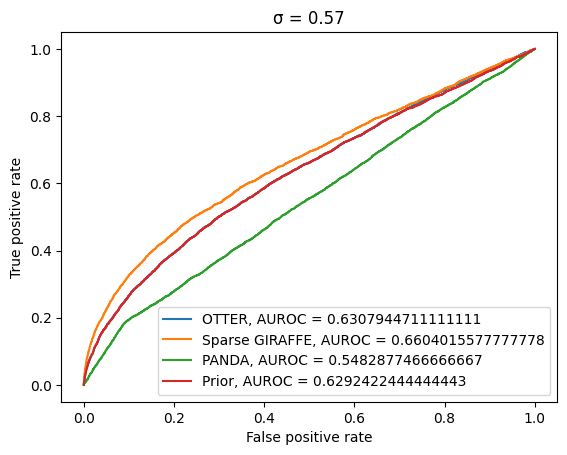

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3920
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.473122  1.286525 -0.186534 -1.712760  0.394479 -3.525129 -0.601690   
1    1.958232  1.460941  2.472049 -1.375085  1.662824  2.094550  0.438988   
2   -1.254321  1.424069 -1.086594 -0.103753  3.831590  0.223951  2.896868   
3   -0.511193  0.854522 -0.939767  0.064307 -0.488467  0.867158 -1.065893   
4   -1.480616  0.074304  0.494611  0.902322 -2.227684 -0.827302  1.585839   
..        ...       ...       ...       ...       ...       ...       ...   
495 -3.429272 -1.660273  1.604164  0.240000 -0.691846  3.731461 -1.339947   
496  1.763835  0.134895 -0.619650  0.808154 -0.284991 -1.697938  1.000817   
497

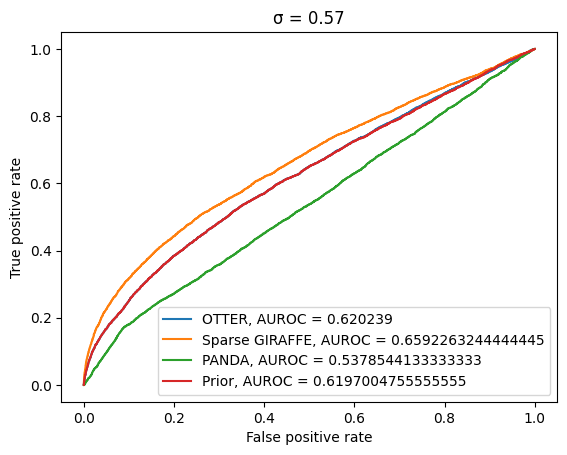

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3858
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.610765 -1.803027  0.313439 -0.899197  0.949563 -0.155882 -0.297848   
1    2.388690 -2.251976  1.628915  0.518205 -1.419416 -1.391384 -1.048945   
2    0.178792 -1.993579  1.319203  2.421558  0.449321  1.069380  0.208800   
3    0.559863  0.067000  0.587990 -1.356276 -0.842052  0.398314  1.741595   
4   -1.566242  0.961975 -0.444519 -1.684959 -2.326374 -0.494435 -2.668209   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.256299  4.845227 -0.672114 -1.392650  1.915651  1.607194  2.163344   
496 -3.793860  0.440184 -2.170610 -1.636364 -1.933863  2.072162  0.825771   
497

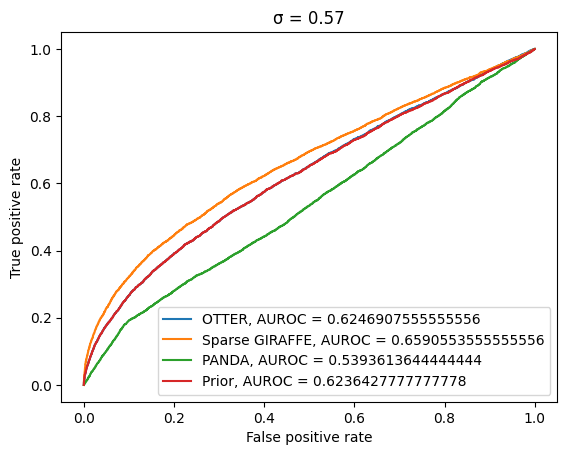

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3850
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.642575  0.108008 -1.785961  0.211950 -0.139405  1.845753 -1.224219   
1   -0.647540  0.944968 -0.125172  0.835389 -0.643771  0.573187  2.593940   
2   -0.655202  0.634849  0.680797 -1.148008  0.037944 -2.203911 -3.240381   
3    3.721244  2.153233 -1.028430 -3.956835  1.371975 -0.605770 -0.679500   
4   -2.171974 -0.181786  2.231016 -2.034344 -2.429924 -4.954203 -2.368690   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.704165 -1.871319  0.828798  6.484763  4.612378  2.956284 -1.174443   
496  0.429835  0.311834  1.372953 -0.541744 -0.790990 -1.107745 -0.051699   
497

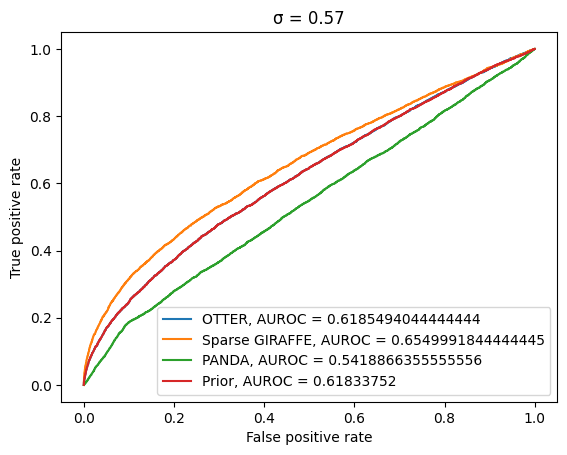

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3898
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.106973  1.090858  0.947399  3.346491  1.003976  0.664435 -0.682109   
1   -1.667043  0.514158  1.769018  0.536605  2.582295  1.348588 -0.803971   
2   -1.358022  1.211233  0.755633 -0.793617 -3.965989 -0.539642 -1.412891   
3   -1.584400  1.344698 -0.864392  0.139044  1.487618  3.928619  3.927678   
4    1.530009  4.276460  0.805049 -4.808439  3.772588 -2.388716 -2.672803   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.337255 -2.586305 -0.824965 -1.015441  2.258867 -0.221764 -1.700055   
496 -0.343101  1.587492 -1.512172 -1.044686 -0.183892  3.033017 -1.414374   
497

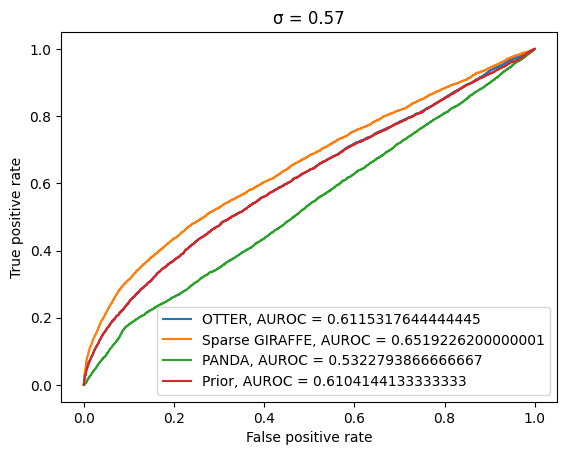

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3880
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.249303  0.294904 -2.013162  0.024785 -1.125068 -0.137086  1.566499   
1   -0.419280  0.435262  0.943037  1.187417  2.569202 -0.023958  0.516503   
2    1.871228  1.303844  0.143587  0.138755 -0.303046  3.510298 -0.892117   
3    0.570415  0.490457  5.621056  2.281250 -4.484240 -0.051342 -0.488127   
4   -3.442587 -0.486913  3.916702 -1.672919 -1.136082  0.124312  1.265862   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.764581  0.292225 -0.544323 -3.237171  0.464281  2.445973 -1.301819   
496 -1.167442  1.288805 -1.360907  1.432660 -1.258174 -1.066362  1.141919   
497

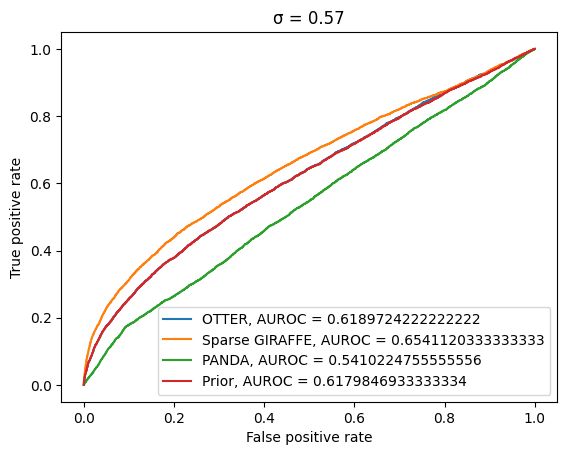

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3938
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.644070  2.235059 -1.360462  0.940579  0.482873  0.874663 -2.011885   
1    0.836144  0.407431  0.959599 -1.097715 -0.885388 -0.691046  1.581407   
2   -0.369637 -0.490772  1.647582 -0.439137  0.076832  2.097878  0.100948   
3    0.341281 -0.309780  2.847060  5.341942  0.971863 -1.847184  0.750505   
4    2.392329  0.824957 -3.222148  0.382724  1.810418 -0.660729 -0.291038   
..        ...       ...       ...       ...       ...       ...       ...   
495 -4.917950 -0.288279  0.070134  1.352580 -2.336206 -2.739415  0.840623   
496 -1.920901  2.340864  1.594880 -1.859334  0.945649 -1.488923 -0.894847   
497

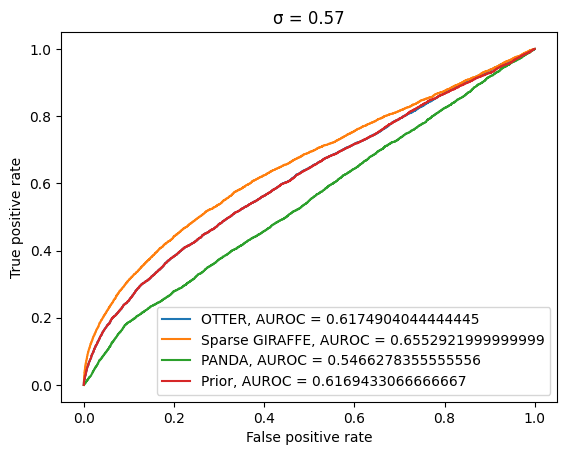

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4038
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.551818  0.292077  0.974623 -0.611393  1.474670  0.765113 -1.696045   
1   -2.062538  0.118288 -0.010443 -2.046706  3.910891  4.734789 -4.210896   
2   -0.558435  0.852493 -1.270173 -1.916122 -0.826025  0.568394  1.293376   
3    0.343124 -1.634352 -1.428847 -0.563381  0.381780  2.033092 -1.399024   
4   -2.169901 -3.180134  1.722805 -0.069164 -0.916946  3.760661 -0.661492   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.723182  3.095478 -1.455981  3.591276 -2.027725 -2.207621  3.274279   
496  2.679256 -1.997211 -4.321228 -0.218583  0.323761  0.374427 -3.060673   
497

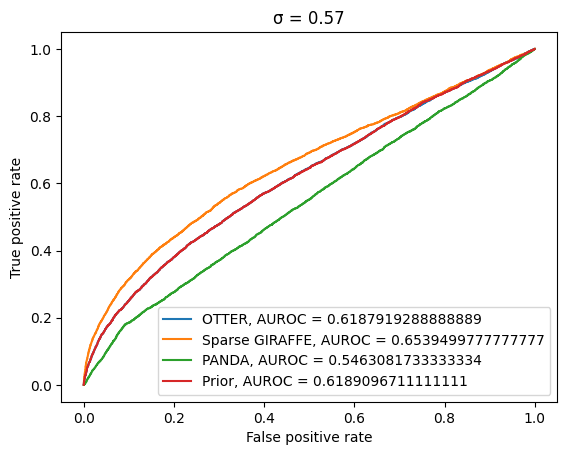

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4098
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.986857  1.634653 -1.093229  2.017427  1.487238  0.352820 -0.210550   
1    1.015710 -2.331648  0.929378 -0.394786 -1.511411  0.388959 -0.134324   
2   -0.729975 -0.551848  2.369695  1.768038  1.151746 -1.091825  0.330437   
3   -3.635706  0.031667  0.750193  0.161070 -0.482768  1.957141  0.563942   
4    1.373911 -1.181916  2.090419 -0.899484 -0.888146 -0.759073  0.884056   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.335524 -0.855784  0.886684  2.752042 -0.803505 -0.338446 -1.663152   
496 -1.280373  1.158900  2.750834  2.085914 -1.397501  2.155938  0.269896   
497

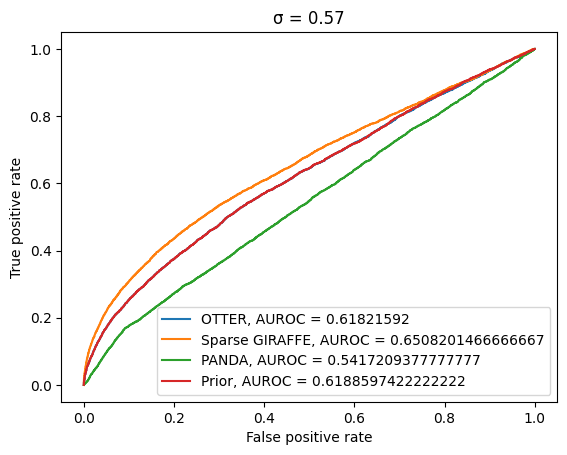

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3810
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.279293  2.118080  0.117765  1.192501  0.814997 -1.056835  0.845741   
1    1.796040 -0.060440 -3.258298  0.393811  0.941475  2.104860 -2.918007   
2   -0.370556  0.410211  1.573776  1.750441 -0.765483 -2.950328 -0.691203   
3   -4.950458 -1.215741 -1.365711  0.292462 -0.168375 -1.308735 -1.397950   
4    1.252357 -0.827223  2.249549  2.565756 -2.014844 -1.649713  0.573490   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.205575  0.962886 -0.908503  1.838668  0.521543  1.226162  0.120078   
496 -0.465203  0.806967 -0.050934 -1.709763  0.281374  0.663670  1.235687   
497

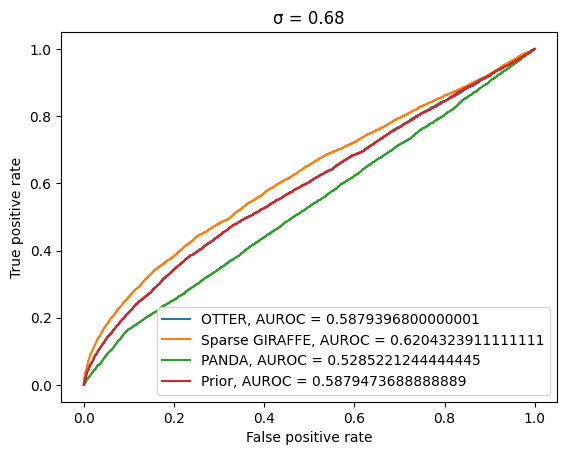

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3846
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.717496 -1.400591 -0.229146 -0.382249 -0.981176 -0.535217  0.375972   
1   -2.131720  1.096241  1.172424 -0.224244  1.825490  0.398388 -0.939997   
2   -1.691703  3.850238  0.806273 -0.722758  0.689679 -0.714735  1.245904   
3    2.061863  1.049281 -2.461037  6.011057  0.867519 -0.669143  0.505452   
4    1.981555 -1.536241 -2.146390  1.132284 -0.243915  1.750567 -2.583042   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.797250  0.316708  0.543825  0.991370  0.877408  0.084914 -0.331136   
496 -2.315106 -0.801243 -0.958776 -0.321658 -0.139107  4.737415 -1.290805   
497

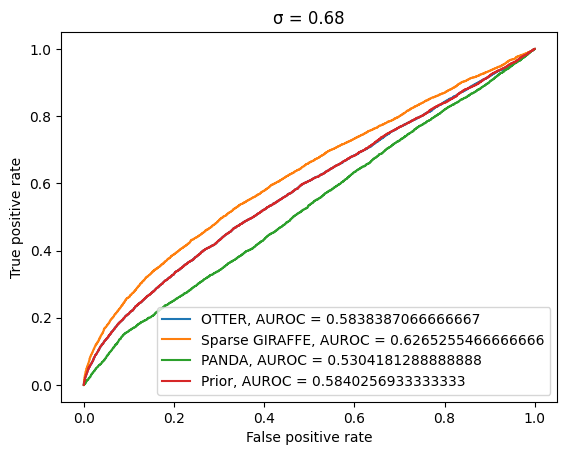

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3800
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.921617  0.503096  1.123496  0.263935  1.107072 -0.314864  1.709648   
1    0.815370  0.140320 -0.376317  0.140124 -0.540100 -3.192551 -1.770711   
2   -1.141352 -0.039127 -0.954997  1.155029 -0.807070  1.087943  1.495227   
3   -1.265399  1.189003  1.561428  1.724696  1.955200  2.962077  1.533379   
4    0.655626 -0.976953 -3.399475 -1.218462 -1.151521  0.970126 -3.230688   
..        ...       ...       ...       ...       ...       ...       ...   
495 -5.021921  4.665988  0.114917  1.883070 -0.525451 -1.827773  0.647298   
496 -1.003555  2.237238 -4.640220  2.049114 -1.217144 -0.479147  1.015795   
497

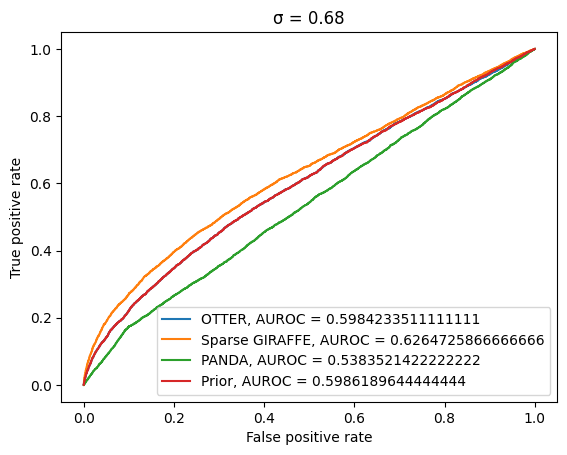

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3836
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.326730 -2.975618  0.819930  1.033617 -0.018465  1.587222  0.537577   
1    3.289487 -0.707338  0.689770 -1.059411 -0.177349 -0.400369 -0.970285   
2    1.008977 -1.216113 -0.224238  1.900768  0.385275  0.712725 -1.636302   
3    1.358124  0.248222  1.340398 -0.004513  1.378859  1.151189 -1.473519   
4   -2.064589 -0.171578 -0.796619  0.636256 -1.538639  0.353492 -0.939345   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.340506  0.337529  0.482990  3.887993 -1.319598  0.030923  0.590715   
496  1.504114 -2.651799  0.280780 -3.380758  0.394059  1.197108 -4.099820   
497

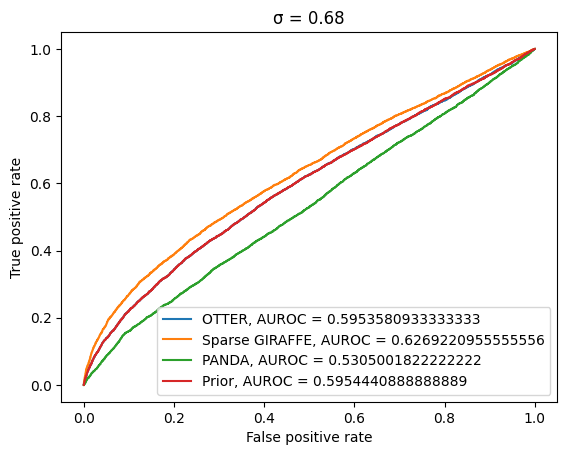

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3898
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.187141  2.847807 -1.417075  2.487993  1.446322 -2.186510 -0.900769   
1   -0.591398 -0.574880 -2.035962 -0.284199 -0.166576  2.482181  0.465959   
2   -5.293366 -0.850796  1.441022  2.867079  1.152079  2.271742 -0.044770   
3   -1.093031 -0.363493  1.302942  2.739867 -2.696451 -3.187412  1.204058   
4   -2.472031  0.901645  0.919130 -1.621457 -2.195170 -1.442371 -3.681828   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.922184  0.525892 -2.988094  4.430366  1.221375 -0.638501  0.539559   
496 -0.935278  0.153152  0.546973  1.486329 -0.683940 -2.247156  0.159889   
497

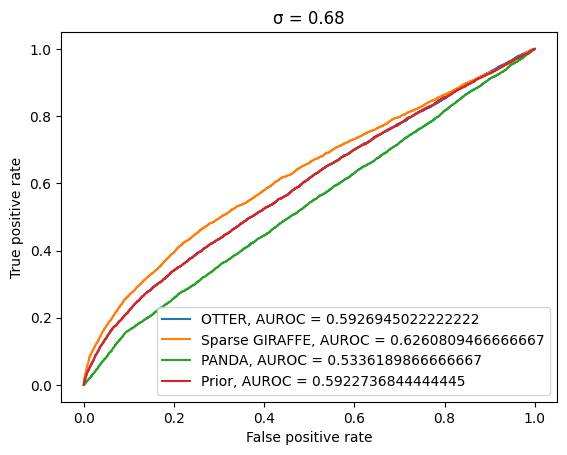

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3796
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.607709 -1.784040  0.213710 -1.329117 -1.423020  0.968831 -1.084323   
1   -3.562982  1.698507 -0.977978  1.106671 -0.433604  4.299134 -0.487418   
2   -1.548904  1.903124  2.270450  0.521921 -0.378258  1.059538 -1.042837   
3    1.964949  1.728857 -2.866596 -0.517565 -1.101701 -1.469882  0.889770   
4    0.788001  2.296765  1.214347  7.310181 -1.699200  0.889181  1.472320   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.312773 -0.771310 -4.092435  0.601260  0.466328 -0.588402  1.734385   
496  0.518852 -2.605852 -0.122986 -1.224993 -2.265727 -0.039376 -1.615019   
497

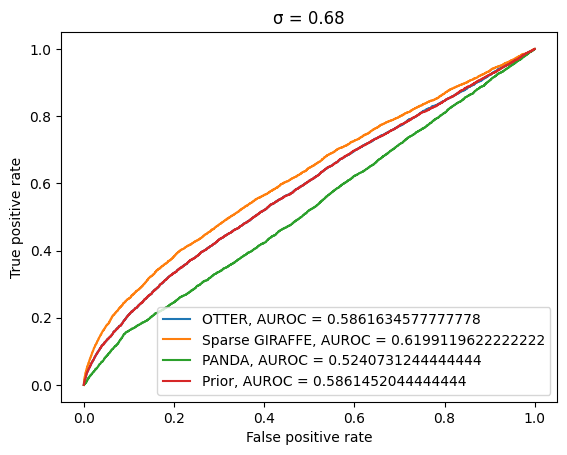

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3944
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.157855  0.023231  0.366813 -0.657126 -1.176849 -0.779568 -0.961848   
1   -0.350338 -0.787675  1.196248  2.036964  1.016749  2.154015 -0.418946   
2   -0.675791  1.090851  2.278841  2.801127  0.726279  2.361795  1.538636   
3    1.352118 -0.587695 -0.657165 -0.023526  0.147872  0.718297  1.086339   
4    0.907535 -1.150048  0.855453  0.709793 -0.269334 -0.561227  0.940546   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.910164 -1.401448 -1.478406 -1.529752  3.837870 -2.098799  2.378592   
496  1.822736 -1.627706  4.459542  2.508074  2.997615  1.600997  1.066005   
497

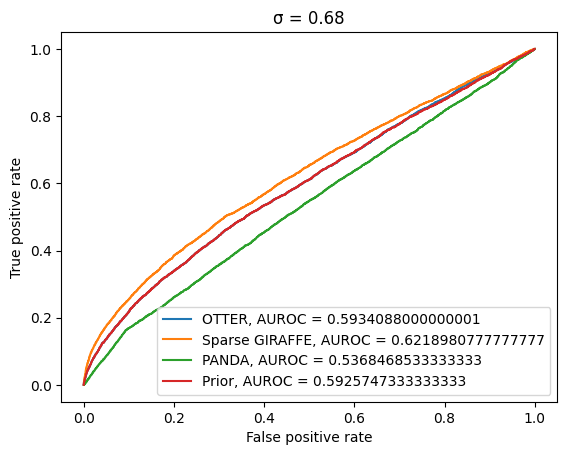

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3884
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.759780 -1.250128  0.072299 -1.089442  0.076620 -1.307033 -0.507211   
1    0.606561 -0.904055  0.042092  0.547160  0.394827 -0.314406 -0.338441   
2    0.864883 -0.460467 -0.864409 -0.212605  1.245940 -0.424566  0.579081   
3   -3.176650  4.479802  2.783833  5.110911 -1.639641 -4.839181  0.871099   
4    2.237241  0.824755 -1.239924  2.037807 -0.665865 -0.665938  2.642750   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.200745 -2.571142 -1.343108  1.276082  0.045747  3.892376 -1.747020   
496 -1.660401  2.401600 -0.074753  1.317411  0.909986 -2.190395  0.209729   
497

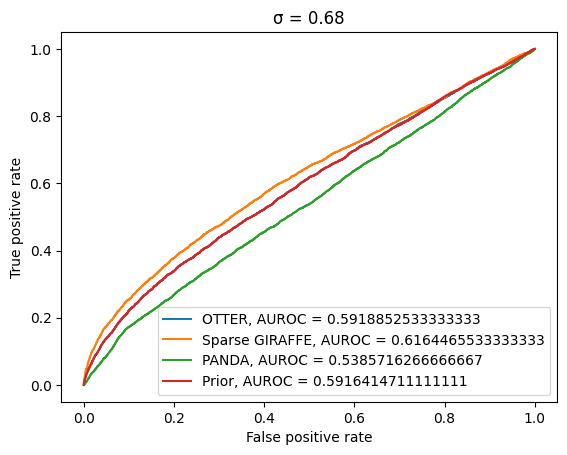

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4018
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.445714  1.342507  1.142127  0.536679  1.192321  0.262735 -0.864284   
1   -0.212864 -0.985499  0.452724  0.018166  1.393140 -1.186788  2.748789   
2   -2.362446 -0.857660  1.300438  4.575280  0.509400  2.142864  0.350824   
3   -0.648416 -1.796814 -1.004370 -0.211753  1.932136  0.045437  1.864038   
4    0.962046  2.245531 -0.527833  1.791107  0.747507 -2.861209  2.132266   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.520521  1.426983  1.026674  0.720274  0.483911  0.960758  2.691918   
496  1.065368 -0.431847 -2.684552 -3.580014 -1.182383 -3.330548  0.134598   
497

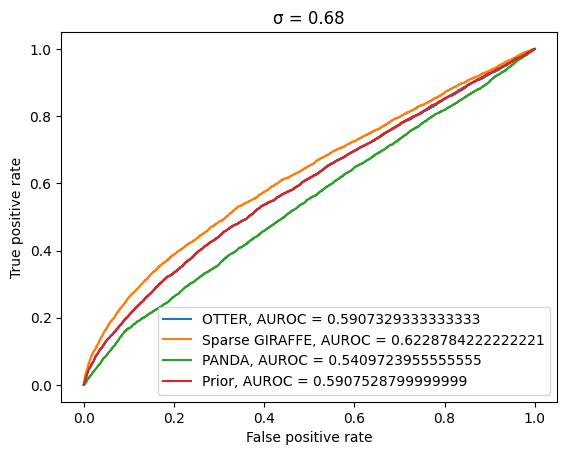

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3822
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.328498 -0.563598 -0.085813 -0.430626 -0.017212  0.263956 -1.200021   
1    0.358531 -3.090145  1.172249  0.627888 -0.543949  1.211672  2.048066   
2   -2.643662  0.965180  2.448859  0.996869  1.156595 -0.456026 -2.925021   
3   -0.217271 -1.725067 -1.644032 -0.943194 -1.245693 -0.690425 -0.446166   
4    0.490657 -0.045168 -0.439105 -3.098083  1.148331 -0.278592 -1.593017   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.809331  1.510138  1.094294 -1.706361 -3.543293  1.175339 -1.648032   
496 -0.129526 -1.946918  2.683345 -1.101491  0.813590  0.259438 -2.198332   
497

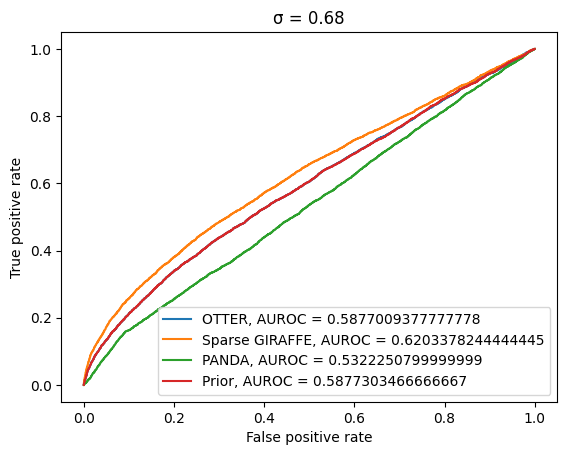

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3912
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.534538 -1.172021  0.778175 -0.797106  2.539993  1.465516 -1.624558   
1   -0.803658  2.443622  2.710067  0.141684  1.227032 -0.203105  1.479956   
2   -0.577916 -3.274926  1.836384 -3.172844  0.921849  1.261152  1.050430   
3   -0.877508  0.092932 -0.531510  1.360620  0.712292 -0.765884  1.096768   
4   -2.633551  0.610369 -1.681802  0.871940  1.641077 -3.841910 -2.495503   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.812415 -1.443071  0.304968 -1.852632 -2.135996  1.491813  0.303038   
496  0.424197  1.573037  1.158286 -2.253736  1.275526  1.279470  0.617382   
497

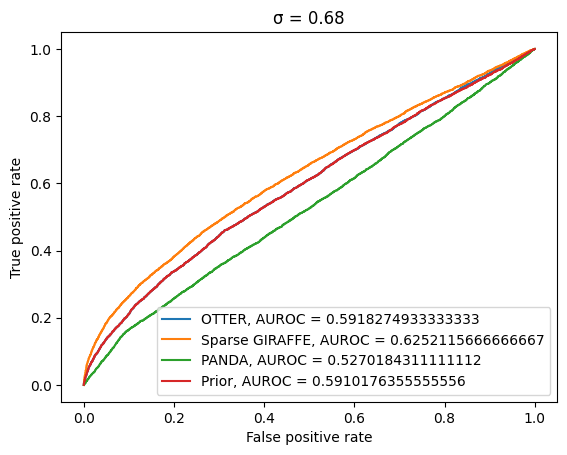

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3892
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.900186  0.381490 -0.430280  0.794036 -0.420931 -0.103366 -0.019149   
1    0.212457  2.551515  1.051620  0.131036  1.605503 -0.880305  0.892946   
2   -0.815083 -0.283530  1.997249  0.264173 -0.023307  2.015460 -0.406418   
3   -0.312983  1.150766 -0.044630  0.503148 -0.491381 -2.618985  1.238478   
4   -4.452459  0.627177  0.397739  0.726772 -0.950029 -0.692310  0.498748   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.032565 -1.006127 -0.598060 -0.667285  0.337849  0.653422  0.411882   
496 -0.834456  0.305576  0.987681 -1.043444  0.028728  1.556878  2.853632   
497

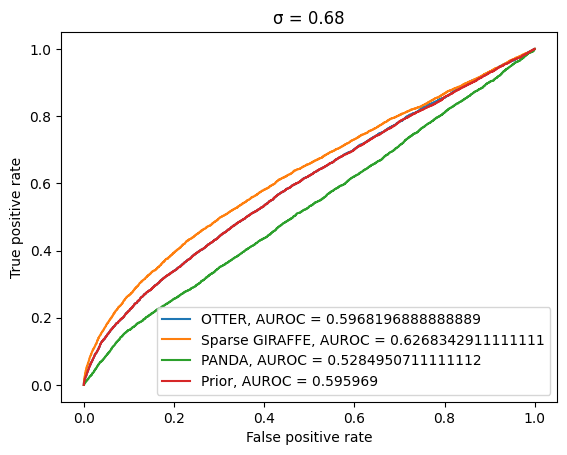

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4030
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.288348 -1.287228 -2.335081 -1.232240 -0.873582  0.053929 -0.653234   
1   -0.273121 -2.702438  2.081350  2.643540  1.370628  5.857334 -3.774663   
2   -0.917718  0.017006  2.532903 -1.481265 -2.273065 -3.403104 -0.645834   
3   -0.191851  0.031973 -1.298463  0.776830 -0.827674 -1.659626  0.060542   
4   -2.080616 -1.591659 -0.747980  3.458140 -0.971294  2.097108 -2.425048   
..        ...       ...       ...       ...       ...       ...       ...   
495 -3.815575 -3.888745  0.658085  2.230890 -0.998884  3.289126 -2.542329   
496 -0.904281  0.207219  2.769584 -0.372185  1.005623 -0.779000 -2.749162   
497

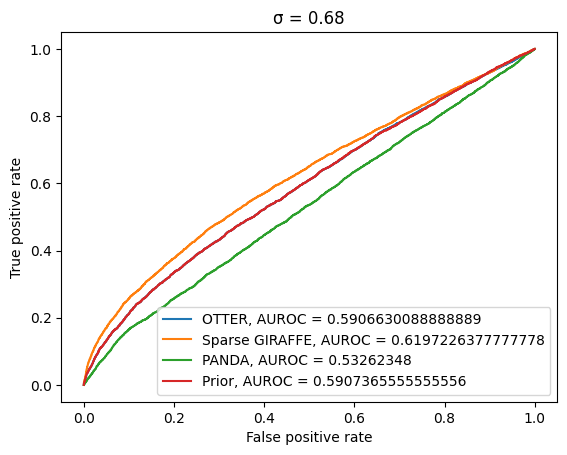

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3894
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.350422  1.311032 -0.186854  0.365406  1.239171 -1.017512  1.105450   
1   -2.518438 -1.053778 -0.335335  0.485184 -2.394583 -0.293284 -1.846849   
2   -0.889430 -4.464885  1.606699  0.312584  1.044531  2.788907 -0.749962   
3   -0.146080 -2.326063 -0.452107  1.188313  0.755189 -1.419536  2.077341   
4   -1.726150 -1.619627 -0.636329 -2.767540  0.839783 -2.503512  3.116959   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.166239 -1.025972 -1.880668  1.785965  0.599847  2.581424 -0.233746   
496  0.847038  3.588435 -2.059899 -2.800505 -2.318568 -2.895999 -2.727824   
497

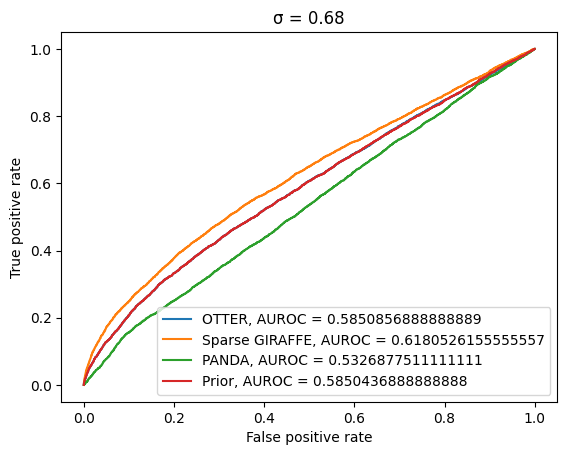

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4068
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.122748  0.311379 -0.002733 -1.922026 -1.331160  1.019750  0.593149   
1   -0.304704 -1.993789 -2.668856  0.429218  0.440678  1.949986 -2.782880   
2    0.780334  2.080819 -2.258768  1.853928  2.502557  2.340559  1.005864   
3    2.046542  1.760489 -1.290210 -3.374981 -1.158092 -0.843202 -1.764816   
4    1.439830  1.310195 -1.705143  2.085309  1.616795  3.644673  2.347176   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.477290 -1.835894 -2.309621 -4.766050  0.634111 -0.706776 -4.079519   
496  0.917718 -1.362692 -2.560132 -2.644956 -2.808188 -1.562867 -1.037589   
497

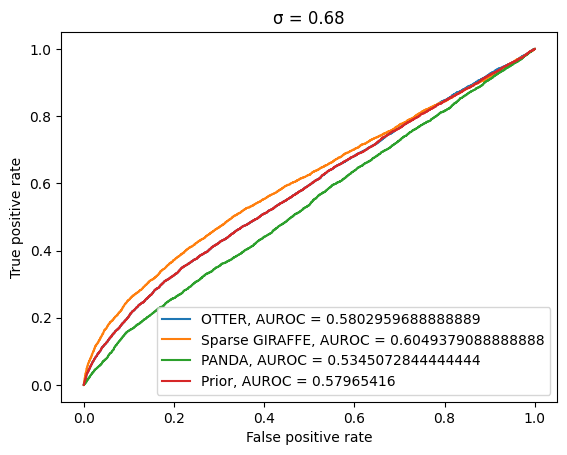

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3890
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.910805 -1.364065 -0.010633  1.793081  0.260884  0.048017  2.075395   
1   -1.231517 -1.083392 -1.594647  1.443018 -0.051046  0.647506 -3.823596   
2    1.409079 -0.248308 -1.606038 -0.308323  2.118035  1.182905 -1.467356   
3   -1.889991 -2.149460  3.212587  1.394659  0.167201 -1.930546  0.688643   
4    3.012439  0.752348 -1.829093 -0.430951  0.845506 -3.916987 -0.801462   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.683575  1.648294  2.535212 -0.068817 -0.721620 -3.434868  0.439700   
496  0.302436  0.236104  0.196470 -1.256695  0.502286 -0.523613 -0.238876   
497

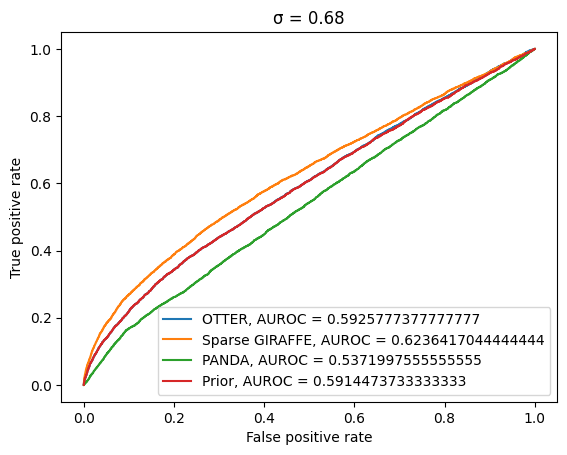

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4010
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.108752  2.707683 -2.242511  1.136279 -1.722897 -2.761973 -1.839870   
1   -1.946934  2.150034 -0.846776  1.092713 -5.241162 -0.529619 -2.801154   
2    1.761813 -0.645496  3.054073  1.744459  0.685416  3.493755 -0.806323   
3   -1.419463  4.068958 -0.195230 -3.458949 -1.701114 -4.455768 -0.716282   
4    3.227557 -0.719761  1.132483  1.347065  1.710695  3.801064  3.812937   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.183539 -0.215914 -2.365439 -1.146701 -1.601846  1.015093 -1.707696   
496  0.205373 -0.497105 -1.013752  3.154829 -0.971010  0.976936 -1.699027   
497

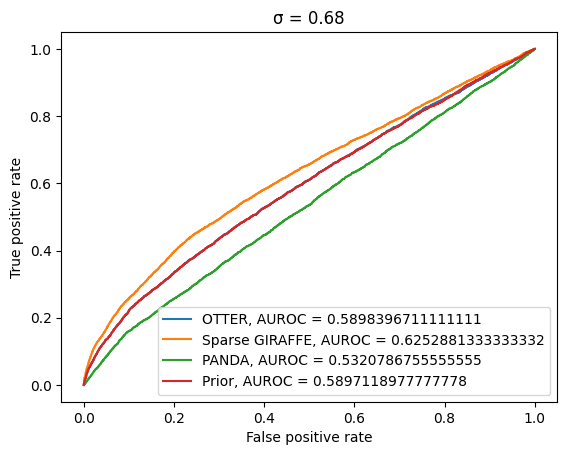

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3800
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.372111  0.119701  1.336182 -1.352430  0.402065 -0.773657 -1.791319   
1   -1.668647  0.482072  2.643664 -0.430397  0.038530 -1.497206 -0.177484   
2   -1.228382 -0.467346  0.682879  0.678078 -0.383181 -2.085498  0.272860   
3    2.931231  0.841068  0.926315  0.505398  1.184619  4.577297 -3.577586   
4   -0.914716  2.435128 -1.806016  3.103361  0.333884 -2.648288  0.845021   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.016177 -0.395876 -4.509086 -1.946611 -2.792821 -1.150191 -1.035147   
496 -1.693421  0.145530  2.730093  0.261068 -0.951271 -0.177008  1.201771   
497

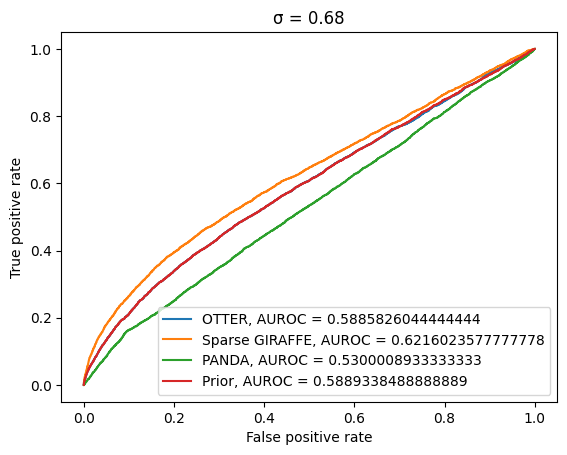

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3936
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.030169 -1.961373  1.952933 -0.648681 -0.122950  0.363096 -0.183332   
1   -2.531947  3.440825  2.620310 -1.318190  3.103209  0.205032 -0.423769   
2    2.279240 -1.184758  1.010009 -1.175470  3.123807  2.456430 -2.318880   
3   -0.486466  3.655785  0.323431  0.131342 -0.062292 -1.882601  0.986346   
4    0.846084 -0.931046 -0.008716 -0.928460 -0.177044  1.075349  1.300688   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.374862  0.535098  0.747991 -2.058128  1.353433 -0.551060 -0.801821   
496  1.645690  3.810179  3.422873 -0.467722 -3.058642 -0.781147 -0.162557   
497

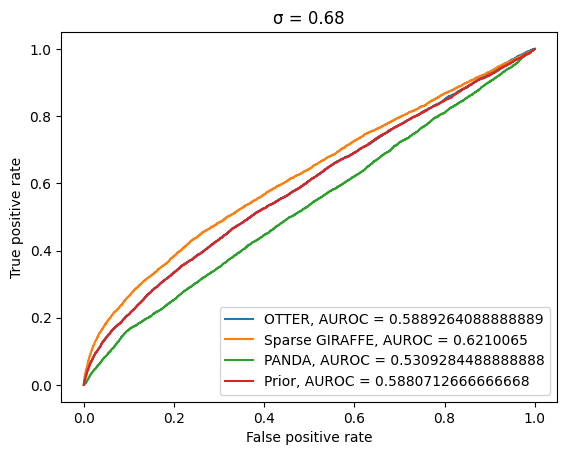

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3878
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.704006 -0.239102  2.356584 -0.866159  1.693196 -1.117784  1.409979   
1   -1.423724  1.417753  0.340593 -3.210099  1.405635 -3.244537  1.896304   
2    4.150210 -0.626275 -2.681811  2.413047  0.663140  0.844460 -0.326847   
3    0.214189  0.125707  0.353061  2.659758  1.175045  0.076452  1.384794   
4    2.178904 -3.407974  2.229066  0.988261 -1.747082 -0.491640  2.496351   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.939584 -1.777836 -0.775434  1.366358 -1.839321  0.164743  0.878073   
496 -0.142546  2.952839 -0.114770 -1.053161  0.580422  0.629689 -1.553029   
497

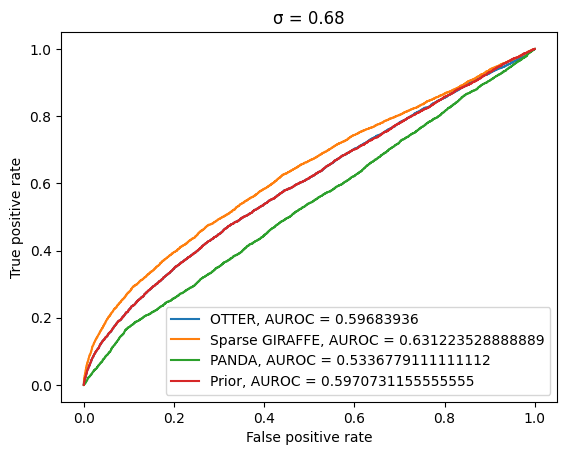

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3912
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.215337  2.690506 -1.521110  1.480434 -2.060998 -1.984831 -3.135759   
1   -0.987213  0.906098  0.151630  0.864752  1.758467 -0.223485  0.364687   
2   -1.376686 -0.610440 -1.918958 -1.581420  0.052734  2.841023 -4.699694   
3    1.371947 -0.466093 -0.688802 -0.649339 -0.976834  0.634023 -0.750663   
4   -3.273636 -0.575894 -0.819769 -0.016346  1.262440  0.319723  0.911369   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.516142 -0.817000  0.829790 -3.226508  1.456885  0.871318 -0.622690   
496 -0.180063 -0.824336  1.094785  0.437817  1.523683  2.885641 -0.187181   
497

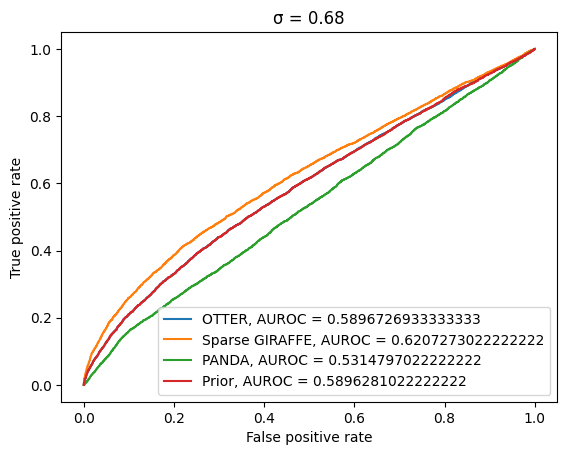

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4028
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.891790  0.767869 -3.513541 -2.761526 -1.009683 -0.649110 -4.149363   
1   -0.301180  0.343715 -1.657638 -0.816246 -0.995286  1.831399 -0.877255   
2    2.675833 -1.562832 -0.082599 -1.934352 -0.914755  0.196995  1.992863   
3   -1.450459  0.487829 -0.783095 -0.878530  1.363795  2.716137 -3.022886   
4   -2.014027 -1.046174 -0.014443  0.911668 -1.600467  2.923256  2.483742   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.833719 -1.281038  0.270397 -0.632913  0.081863  0.895069 -0.223115   
496  0.455741  4.514566 -0.529647 -0.728500  0.522861  0.090043  4.471133   
497

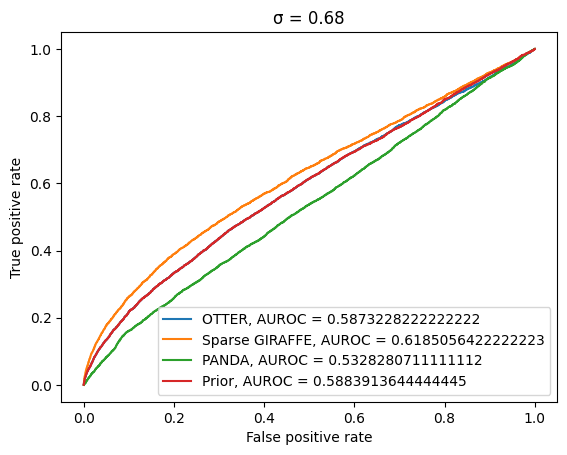

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3792
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.347042  1.740139  1.657357 -0.001046  2.935927  1.039220 -0.759698   
1    4.729725  0.424112 -4.204131  1.403910  2.769130  2.240342  0.404420   
2    2.897421  1.692862  1.719132 -3.784081  2.962427 -1.611143 -3.099166   
3    0.754203 -1.291390 -0.845884 -1.100672 -1.373858 -1.720399 -3.511133   
4   -1.493757  1.260835  2.370898 -0.411516  1.211616  0.803944 -0.858122   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.278534  2.912220 -2.876024 -2.639811 -0.067166  2.957231 -4.903599   
496  1.079857  1.366345 -0.987012  0.930505  3.018925 -2.592637  2.792793   
497

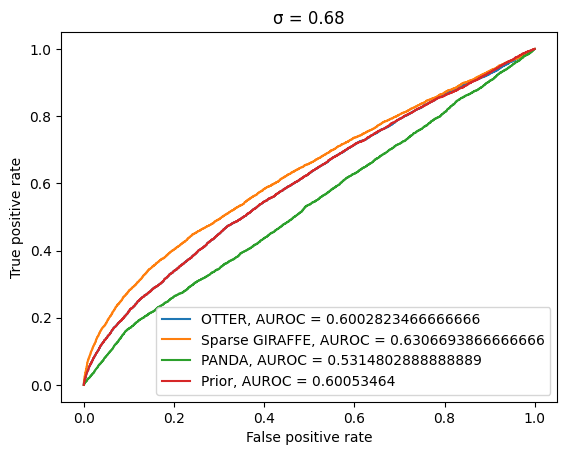

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3930
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.107691 -0.427056 -0.457027  1.370968  0.167592  0.141983  2.263973   
1   -1.111399 -0.504303 -0.247345 -1.245613  0.006672  0.641772 -1.284714   
2    3.261519 -4.250288 -0.212495  4.236490 -0.375104 -3.226289  3.976359   
3   -0.662454 -1.327479 -2.423587 -0.160007  1.446618 -0.323503  0.546508   
4    0.613324  3.181246  1.625548 -0.561865  0.155185 -4.467678 -0.478791   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.898289  0.834254  2.436099  1.285325 -1.217634  1.371207 -0.513817   
496 -0.779530  0.567218  0.537692 -0.903735 -0.846743 -1.736638  0.950726   
497

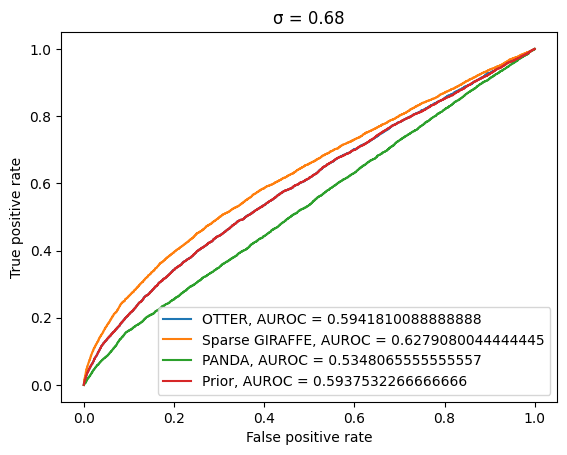

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3906
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.080399  1.308915 -0.207133 -0.671260  1.097965 -0.814383 -1.217568   
1   -2.023582  0.879857 -1.232514  1.746972 -2.562764 -1.769259 -0.283460   
2    0.155612  2.223283  1.100891 -0.461316 -0.161496 -0.385439  0.573057   
3    0.921669  1.847497 -0.391452  0.383014 -5.748992 -1.534682 -1.990078   
4   -1.171930  1.041678  0.522751  0.924924 -0.693650  0.856914 -0.769607   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.320002  0.428600  2.557335  0.046273 -1.036186  1.223089 -0.743582   
496  0.398180  0.823323 -0.072806  0.151537  0.897946 -0.848427 -1.495337   
497

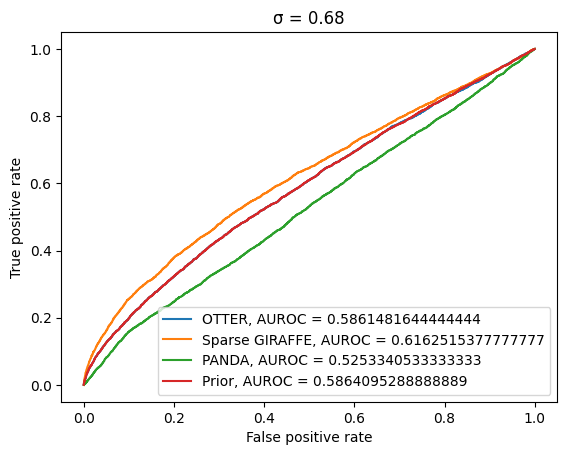

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3834
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.588328 -1.550866 -2.501087 -0.581309  0.750056  0.948858  1.093579   
1    1.586370 -0.079947  1.527277  0.641972  1.121621  2.484518 -0.809873   
2    0.817849 -0.644391  0.165480  0.022949  0.872927  0.436029 -1.166212   
3   -4.106787 -0.566704  0.583918 -0.182717 -0.177229 -0.019977 -0.200869   
4   -0.537948 -3.274677 -1.075211  1.910194  1.404267  1.826549 -0.346199   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.621232  0.419142  0.856919  0.990413  0.344747 -0.663037  0.623349   
496 -0.964209  1.548604 -0.972376  3.374697  0.093913  1.682620 -1.518855   
497

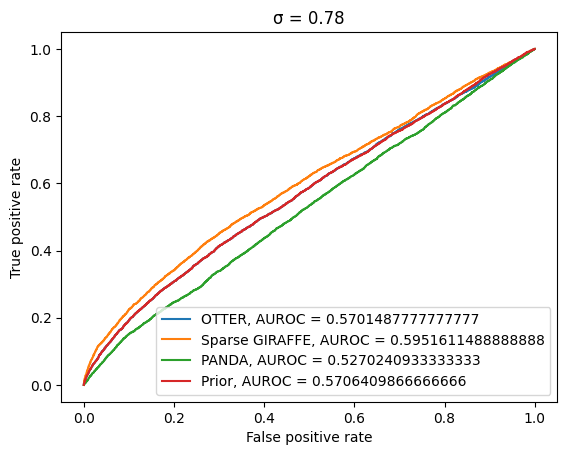

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3964
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.884401  0.221436  0.946784 -2.853474  0.056138  0.199361 -0.952251   
1   -0.317317  1.215082  1.878944 -2.979019  0.309847  0.806246  2.995639   
2   -2.168770  4.308196  0.429008  1.067610 -1.978364 -2.026374  0.515659   
3    1.863289 -1.009240 -1.476450 -0.430974  1.041100 -1.960012 -2.034881   
4   -2.848645  0.241169  1.720548  0.153976 -0.338833 -0.486126  1.335806   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.011998 -0.049066  1.145719 -0.807815  0.597810 -1.725256  3.069718   
496 -0.438191  0.135326  2.648553  3.612502 -0.757315  0.765706  2.691260   
497

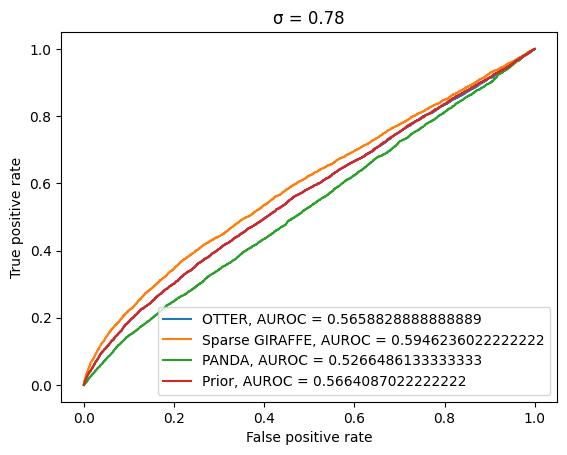

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3918
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.049536  1.261450 -2.745976 -0.980291  0.237244 -0.915452 -3.973243   
1   -0.487238 -0.233443  1.501505 -2.027036 -3.058084  0.461310 -2.534435   
2    0.160720  1.506930  0.925612 -1.238555  1.203459 -0.631397 -0.453268   
3    0.958464  1.838524  0.385369 -2.332201 -0.459747 -1.165115  0.472741   
4   -1.555978  0.881868  2.737971 -2.846534  2.588347  1.276091  2.738472   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.501924 -3.882272  3.443674  1.705430  2.126882  1.855710  2.487228   
496  0.150372  2.287102 -0.081292 -1.577893  0.478710 -1.833163  2.460089   
497

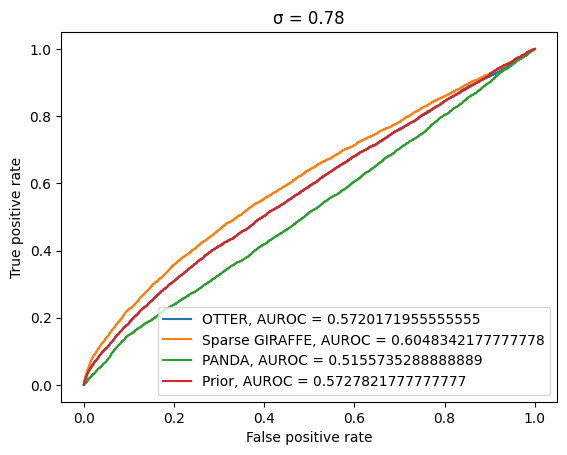

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3954
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.579515 -0.846342  1.157823  1.261265  0.214544 -2.668227  0.611968   
1   -0.734136 -0.515048  1.083809  3.306711 -0.288477 -0.315990  0.194012   
2   -2.184632 -0.192588 -0.709547 -0.410449 -1.131767 -0.850557  1.309826   
3    0.242637  1.174587 -0.840096  1.225959  2.451699 -2.058611  2.119446   
4   -1.040339 -0.165185 -0.711599 -0.827111  0.332576 -1.878656 -0.941926   
..        ...       ...       ...       ...       ...       ...       ...   
495 -2.129622 -1.075000  1.533469 -1.856226 -1.145492 -1.135281  0.241459   
496  0.162509 -0.629748  1.011950  1.479615  0.349344 -0.607686  0.923873   
497

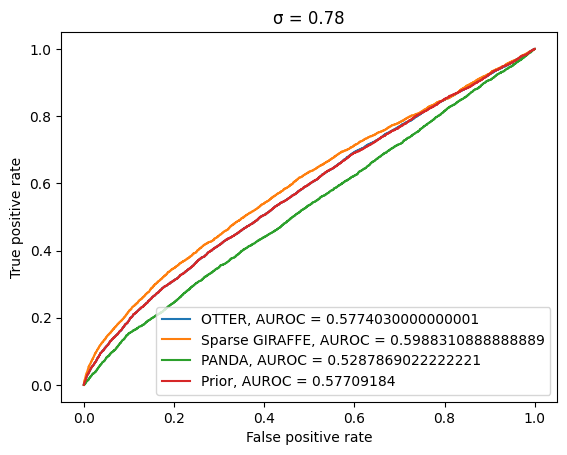

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3952
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.728450 -0.385926  0.743142 -1.438423 -0.967592  2.521039  0.176716   
1   -0.386250  0.455507 -1.399742  0.424933  0.471361  1.731348 -0.848514   
2    1.987000  1.743422  0.330963  0.972780 -0.714866  1.577310  1.957599   
3    0.902287  0.435781 -0.620932  0.627758  0.075453  1.480094 -2.971842   
4   -1.755564  0.030125  1.254520  0.589160 -0.741741 -2.851807 -0.961821   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.135482 -1.401684 -1.709745  2.709362 -0.383973  3.115744  2.103912   
496 -0.868885  0.468690  0.207337  3.480414  1.233187  0.688332  3.798636   
497

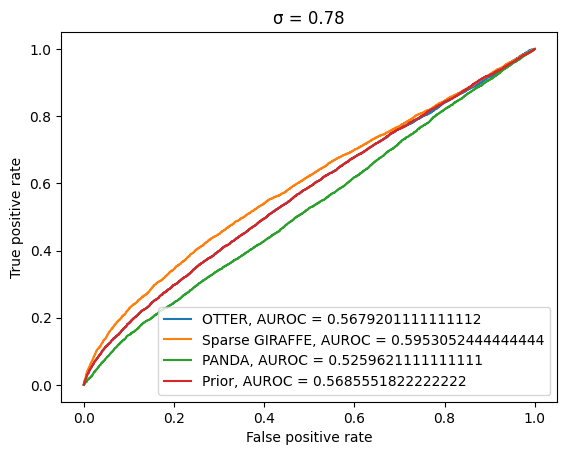

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3940
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.480283  1.516885  1.103763 -0.554618  1.705650 -1.357091  0.776662   
1   -2.664300 -1.239476 -0.443913 -1.736392  0.053100  2.173378 -3.653703   
2    0.624215  3.959828 -2.019304  1.962363 -2.954063 -4.178167 -1.373825   
3   -1.054186 -0.699831  1.900920  1.414224 -0.412769  0.338950  3.186535   
4   -0.756810 -0.167249 -2.841237 -0.483341 -1.908730 -1.787939  0.245683   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.399509 -0.722110  3.034301 -2.805353 -0.805112  4.099101 -0.809291   
496  0.983063 -0.509577  0.460890  0.565598  1.017520  0.699153  2.162150   
497

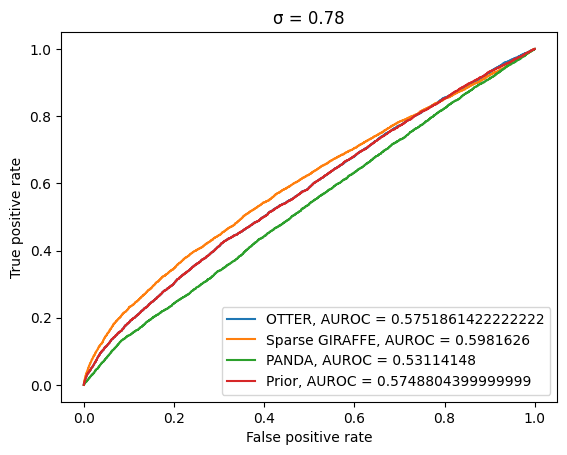

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4038
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.017301 -0.719504 -0.432715 -0.301302  0.241670 -0.770278 -1.047783   
1   -1.671719  3.164385  1.225482  0.774994 -0.773810 -1.104893  1.166471   
2   -0.372430  1.385870  0.269186 -1.567225 -2.506271  1.188566 -1.097165   
3    2.897555  3.034102 -2.810780 -3.183634  0.460006 -2.482210 -1.968767   
4   -2.889236 -3.423886  2.979901 -0.050763 -1.739150  2.161458  0.967709   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.250184  0.849861  0.276196 -0.824181 -0.197613  0.293348  0.252014   
496 -0.412283  0.168019 -0.559829  0.716033 -1.868407  2.030255 -0.037115   
497

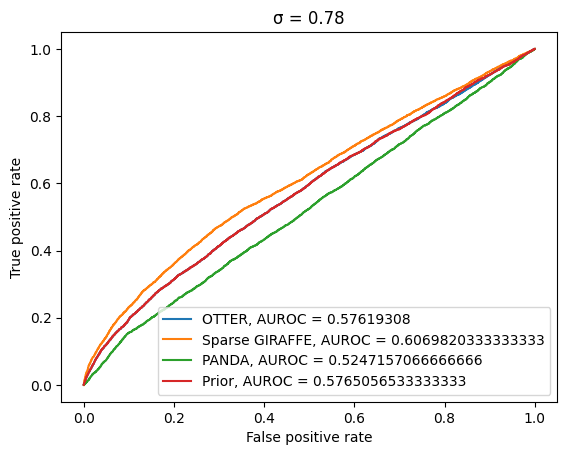

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3858
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.159770  1.229825  0.108323 -3.297192  2.108206 -1.062862 -0.702409   
1   -1.463824  1.111942 -1.789382 -2.024989 -0.878668  2.203849 -1.081927   
2    0.349304  0.477503  0.349010 -1.150932  0.389645  0.405778 -1.253445   
3    0.809915  1.717868 -1.308423 -4.503793  3.461576 -0.019114 -1.039779   
4   -1.428284  1.940437 -2.118067  2.092128 -1.653165 -2.020401  2.408986   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.392621  1.393241  0.918947  1.271176 -0.664539  0.042680  2.638726   
496  1.795527  1.133208 -1.030906 -0.130385  2.283635  1.633383 -2.062747   
497

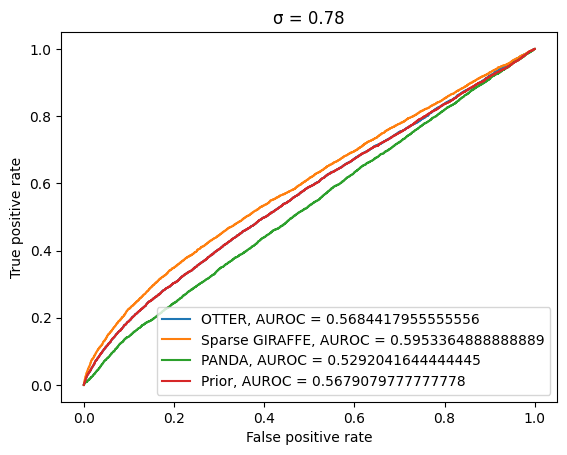

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3970
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.141086 -0.670687 -0.043588  0.871657 -0.195010 -0.713156 -0.236475   
1   -0.029275 -1.282542  3.549012  1.829381  0.934678  0.065893  1.305184   
2   -0.534347  0.640901  0.244310  1.363497  0.019282 -0.062729  3.286400   
3    2.547974  0.002422  0.037305  2.094939  0.214178  0.544150 -1.490076   
4    0.914023 -0.036029  0.464916  0.615322  0.642971 -0.129577  0.522437   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.964441 -1.185847 -1.327124  2.258891  0.590691 -0.591602  0.187336   
496  0.818102 -0.754610 -1.287060 -0.138743  2.181888  2.943495 -1.131002   
497

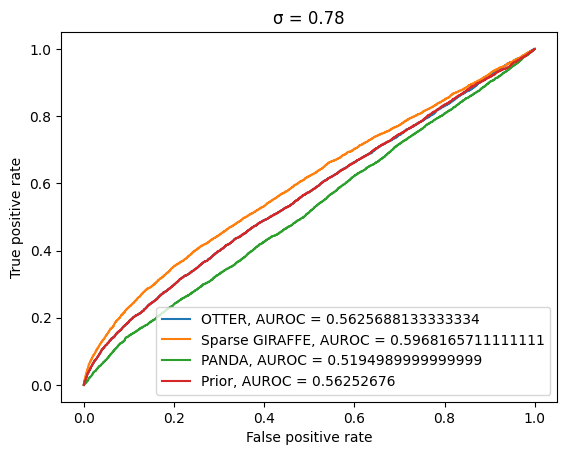

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3908
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.394299  0.507630 -5.234128 -2.299306 -0.068009 -0.210970 -1.972391   
1   -0.047031 -0.100781 -2.389429  2.102959  0.141764  1.310563  0.115462   
2    0.115316 -0.964778 -0.775139 -1.309059  1.027561 -1.888036  0.124135   
3   -1.456713 -2.636712  0.907127  1.817772 -0.761533  1.066113 -0.681008   
4    2.303083 -0.330298 -0.245938  0.622821  1.221020  0.228317 -0.158947   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.020746 -3.799527  1.759464 -0.088370  1.954162  2.634324  1.866965   
496 -3.205022  2.327075 -1.151347 -2.939410 -3.298946  0.606168 -1.679631   
497

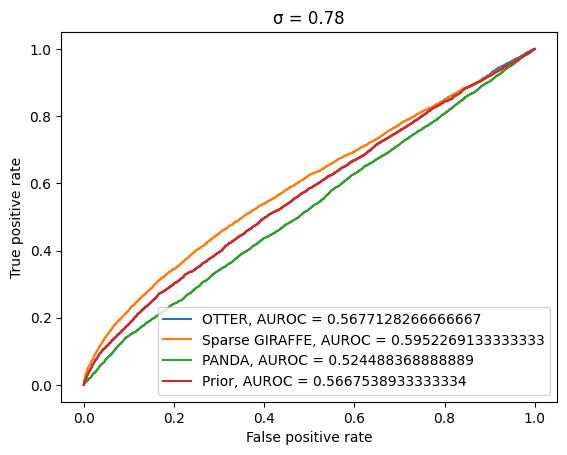

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3970
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.413150 -0.859707 -0.643319 -0.467478 -0.239323 -0.620386  0.678401   
1    1.975279  1.054141  0.787644  3.547276 -2.162727  0.152472 -1.788618   
2    1.657631 -0.006361 -0.858349  1.585099 -0.372684  1.902783  0.479128   
3   -1.985950  4.400377 -0.517106 -0.969251 -0.268743 -4.249639  1.401331   
4    1.386386  0.293081 -0.407399  1.130825  3.850045  0.327623  4.004540   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.641615  2.884968 -0.741313 -2.582241 -3.783232 -1.505956  1.659026   
496 -0.895516  0.019067  0.901340  1.123491  1.758983  1.356379  0.456350   
497

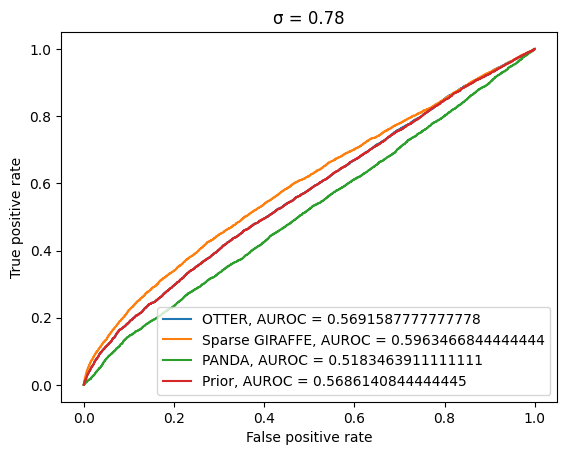

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3964
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.861611 -1.488338 -0.746852 -0.809796 -0.526300 -0.397973 -0.432595   
1    1.280486 -2.310957 -2.715481 -0.356854 -1.761021  4.355765 -0.107750   
2    0.267391  0.633788  1.282543 -0.561368  0.110040 -0.188829 -0.643776   
3    0.437310  1.448295 -1.050293 -1.407604  2.041029  0.336889 -0.786986   
4   -0.670451  0.218008  2.086385  0.228649 -0.082493  1.320888 -2.684844   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.615521 -1.064688  0.084376 -2.263262  0.568391  1.327742 -3.217696   
496  0.533561  2.592522 -0.523407 -2.313934  1.117874  1.895604 -0.356818   
497

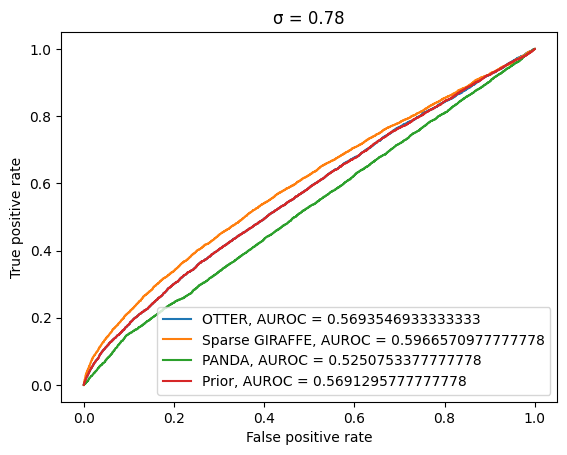

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3816
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.013841 -0.354891 -1.230586  2.718217 -1.118215 -0.230926  0.444291   
1    0.178810 -0.203892  1.482942  1.354238 -2.032002 -1.734102 -0.340847   
2   -0.480662  0.765251  0.015954 -0.373769  0.597148 -1.165823  0.578252   
3    0.963729  1.958666  1.362205  1.347529 -3.154202 -0.632696 -0.142831   
4   -2.725202 -1.047329  1.280854 -1.521911 -3.325010 -1.044749  0.463872   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.019218  0.265412  0.975981  0.963391  0.167782  0.591098  1.306072   
496  1.260586 -1.071250  0.875827 -2.137307  0.372784 -0.919680  1.240073   
497

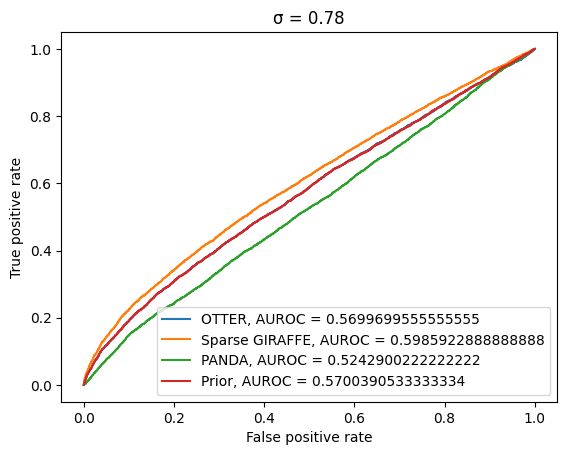

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3974
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.410677 -0.503332  0.330266  0.673193 -0.453671  1.503502  2.926992   
1   -1.659553 -2.544061 -0.914335  0.680080  3.791852 -0.516042  1.818480   
2   -2.699228  2.348797 -1.056064 -0.650297 -1.102698 -3.228833 -2.395706   
3   -2.306415 -0.526458  0.344393  2.206961  0.871214 -1.538794  0.002151   
4    1.649277  0.655721  0.560201  1.712863 -1.046345 -4.837415  2.942684   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.161746  0.436487  1.588562  1.334694  2.133597  4.076053  1.159623   
496 -2.411610  1.736985  1.328099  0.323802 -1.848202  0.337976  1.378832   
497

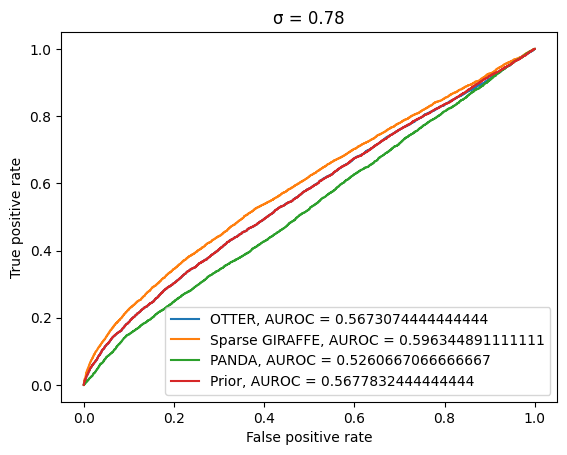

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3886
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.450037 -0.884682  1.132544 -1.253308  1.405222  2.431375  0.434859   
1   -0.452106  0.119081  1.756823  1.369653 -2.179833 -1.219035  0.340181   
2   -0.107870 -1.043566  1.895352  0.583146  2.304355 -0.480590 -2.237862   
3    1.142975 -0.352681  3.041738 -0.694259  0.504751 -1.178489 -1.126619   
4   -4.392572  3.304423 -0.183575 -1.583651  1.288395 -0.105356  0.044064   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.096913  0.745356  0.355030 -1.742696  1.042014 -2.067579 -0.167180   
496 -0.345932 -0.100282 -3.208839 -2.074321 -3.801531 -0.068618 -3.151498   
497

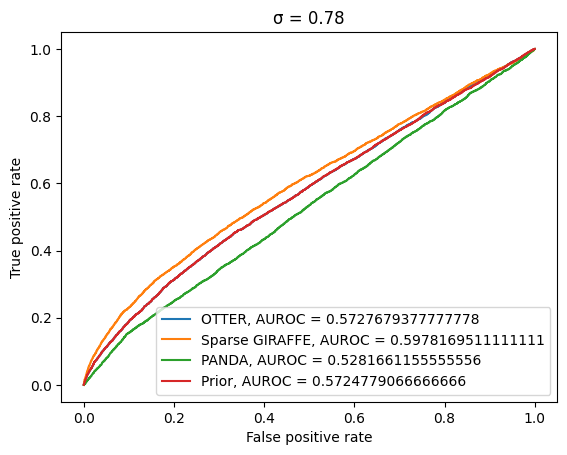

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4010
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.397582  0.159461 -1.626419 -1.281805 -1.493328 -2.681323 -3.778416   
1    0.339969  0.771900  0.393617  1.599414 -2.915916 -1.745913 -0.279357   
2    0.297257  0.167888 -2.301853  0.229972 -1.821926  1.395607 -1.203183   
3    0.630013  0.783670  0.315282 -1.048584 -0.912058  2.863180 -0.508877   
4    2.233445 -1.175226 -2.214604  2.649306  0.844055  1.803983 -3.876340   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.969917  2.113439  0.067186  0.402455  1.295676  0.733225 -1.608004   
496  3.077616 -0.650353 -1.194549 -1.632092 -0.617241  0.085029  0.842733   
497

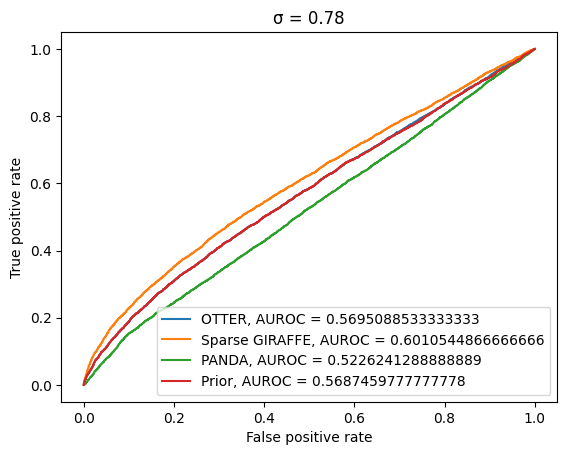

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3990
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    4.435153 -0.182367 -1.344045 -2.884200  2.042320  1.489775  1.709515   
1   -3.169518 -1.365052  3.601876 -1.143243  0.925475 -0.737600 -0.709195   
2    2.855117 -2.514425 -2.840538  0.314586  3.031082  1.633806  1.562683   
3    0.165449  0.757366  0.376450  1.267081  0.912098  0.005108 -0.662200   
4    0.626173 -1.125087  0.184558  0.314959  1.313587  2.375436 -0.743820   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.216301  0.624162 -0.880627 -1.138807  0.753278 -0.101709 -1.216557   
496 -1.031372  0.213202  1.708306 -0.005792  2.428062 -0.533781 -0.186128   
497

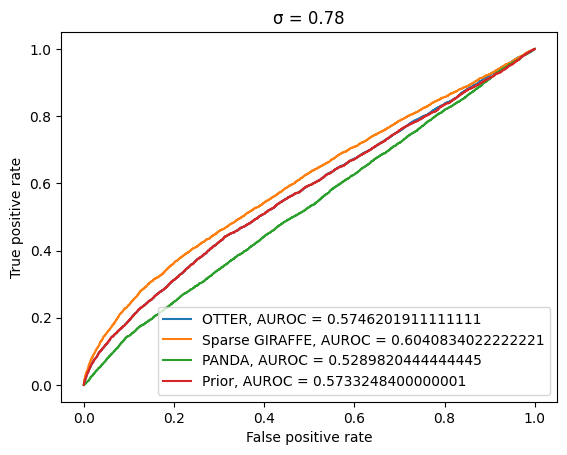

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3902
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.533274  0.873267 -0.445773  1.240997 -1.059390 -2.612972 -0.543463   
1   -1.581212 -3.125778  0.038319 -0.612957 -0.447408 -0.107361 -0.036127   
2   -3.542168  0.633754  1.596026  0.738370 -0.542455 -0.727958  0.429873   
3    0.432104 -1.666937  1.099372  2.341815 -1.729999  1.492364  1.623440   
4    5.465770  0.650118 -6.027980 -0.234954 -0.576579 -3.882000 -1.040879   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.596831  0.407552  0.932660  0.983531 -0.662028 -0.891895 -0.881592   
496 -1.700515 -1.064577 -0.751154  3.802118 -0.299689 -1.481075 -0.388155   
497

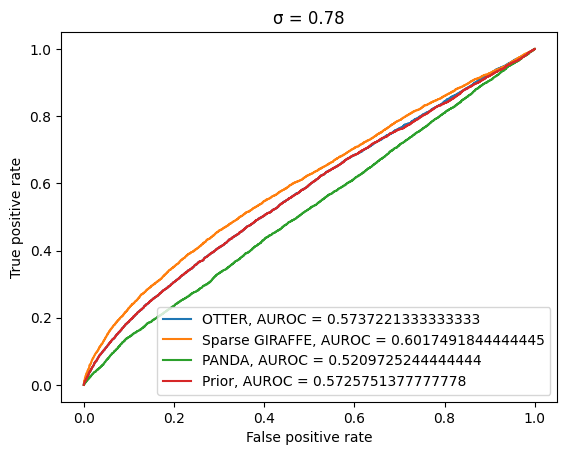

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3912
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.101910  0.898516 -0.382564 -0.073228  1.503256  1.219178 -1.296879   
1    2.914616 -0.225834 -1.678650 -0.822551  0.292256  3.219925 -0.229741   
2   -3.917093 -0.114615 -0.012083  1.401145 -4.384317  1.489440 -1.691291   
3    0.664471 -2.289323  0.472239 -0.743789  0.822200  4.912606  0.228355   
4    0.010483 -1.716809  1.358487  0.497154 -3.148510 -1.929382 -0.525943   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.816019  1.032446  1.549382  0.494551  1.504759 -0.678016  0.319156   
496 -0.957130  0.281759 -1.128178  0.015420 -0.123153 -1.386822 -1.616390   
497

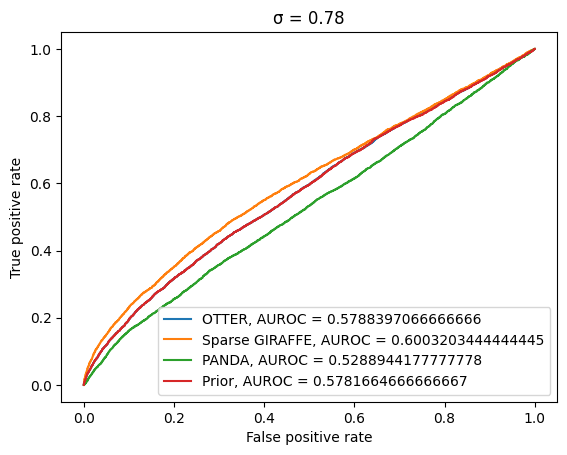

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3872
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.627296  1.568031 -1.161762  0.883727  0.185792  0.858804  1.628010   
1    2.003443 -0.869711 -0.289407  0.579708 -0.787826  1.624737  2.080843   
2    0.251530  0.517167  0.428764  0.735943 -0.787804 -0.444693  0.401625   
3   -0.794254 -1.666328  1.021868  0.116797  0.392798  2.168532 -0.824085   
4    1.269142  0.744354 -0.679448 -1.238797  1.637005  2.296780  1.481476   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.209225  0.277900  0.031971  0.120943 -3.598397 -2.369658  1.774371   
496 -3.187909 -0.806468  1.697470 -2.145084  2.021633 -2.659329 -0.289176   
497

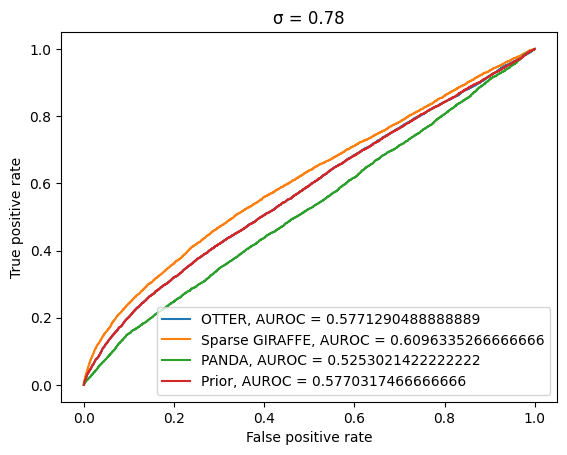

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3874
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.280569  1.948228 -2.669076  0.156701 -2.965525 -1.926151 -1.602103   
1    3.717522  1.110297 -2.614538 -1.132277 -2.728649 -1.222138 -1.122540   
2   -1.789210  0.903020 -2.816646 -2.975891 -1.709966 -2.774025 -0.687301   
3   -4.139313  3.996723  3.397525 -1.471278 -1.695297 -1.687103 -1.582735   
4   -0.569945 -1.601209 -1.209116 -1.188452  2.216634 -4.730672  1.952431   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.109704  1.848780  1.621091 -1.321529 -0.060983  0.040313  0.151733   
496 -1.861525 -1.850103  2.766480  0.281102  0.950329  4.179331  0.013102   
497

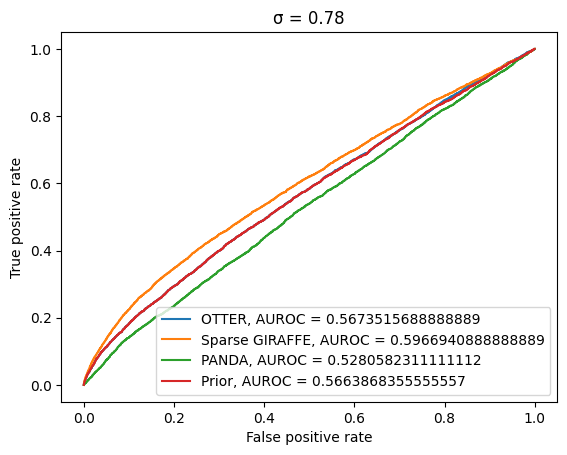

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3998
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.097859 -1.352316  1.428814  2.171271  1.212921  2.759287  1.972672   
1    3.478367  0.091378  0.092041  2.386962 -0.347638 -1.201563  2.105461   
2   -1.926919  0.682717  1.834640 -0.939630 -0.738936  0.273241 -2.213658   
3    1.998118 -0.325057 -2.878427 -0.307099 -2.812365 -1.552971 -1.151341   
4   -2.518006 -2.497507 -1.533601  1.301484 -0.848631  2.522515 -3.058079   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.849698  2.585223 -0.447207  2.575373 -2.574808 -0.655134  1.399391   
496  4.955261 -1.607814 -2.857199  0.643975  0.173873  1.433439  0.389485   
497

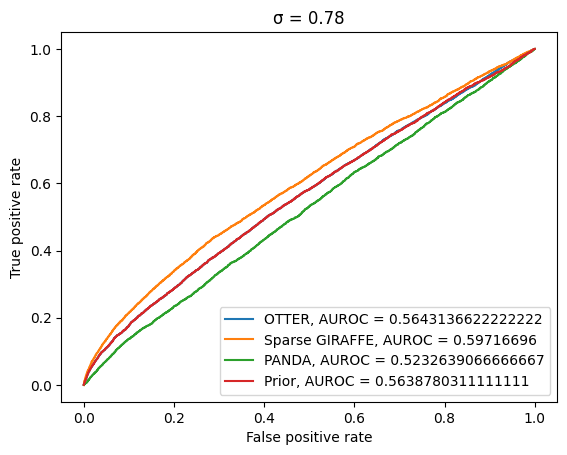

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3896
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.417010  0.204425 -1.072881 -0.105640 -0.792792  0.243673 -0.843141   
1   -0.714087 -0.663693  1.602914  1.915285 -0.662735 -1.228507  1.103531   
2    0.748134  1.058724  0.292109 -1.541599 -0.097686 -1.665025  1.455307   
3    1.278922 -1.840490 -2.490546  2.277481 -0.235646  1.444883 -4.160889   
4   -1.936427 -0.568173  1.386694  1.860357  1.232910 -0.464690  0.409001   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.321763 -1.282855 -0.961269  0.710980 -0.824219  1.847448  2.236371   
496 -0.687332 -1.214953 -0.657818 -2.261170 -0.438992 -0.701183 -1.311356   
497

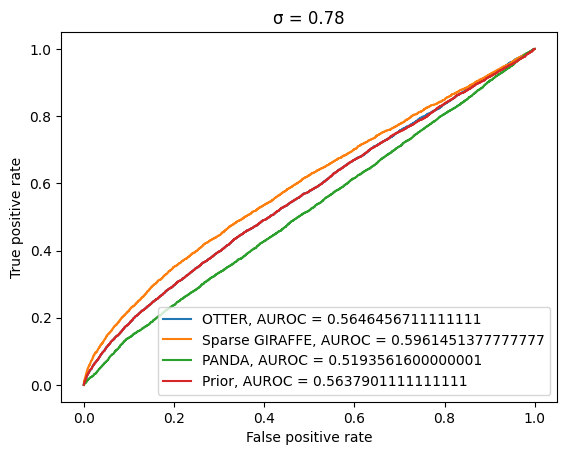

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3996
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.364865 -0.525355  0.803124  0.657629  0.278329  0.902729 -1.774079   
1    0.311915 -0.328752  0.932266  0.463263 -3.273082  0.406668 -1.326643   
2   -1.936397 -0.339777  0.761086  2.044767  0.163127  0.072975 -0.927825   
3    1.276797  2.348076 -0.495156  2.264635 -0.385688 -1.816084  1.078077   
4    0.317652  0.402511  0.746573 -1.309263  1.172338  0.721430 -2.499788   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.197648  0.245892 -1.211277 -1.033904  0.278510 -1.610971 -0.475431   
496  1.069733 -1.193734  1.217943 -0.800465 -0.294796 -1.385660 -2.271407   
497

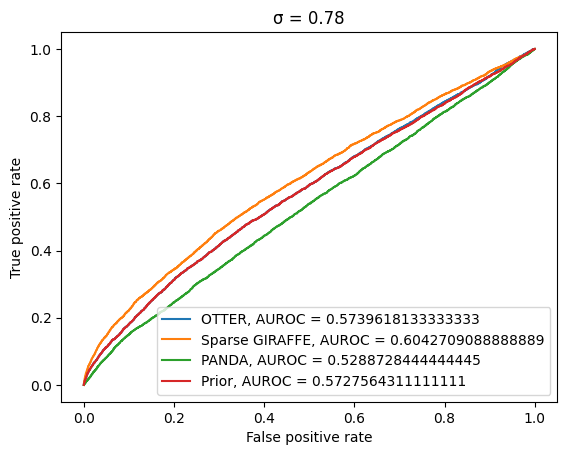

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3878
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.248425  0.073807 -1.011272  1.780068 -0.747766 -2.547419 -0.757034   
1    1.416709 -1.624548  1.140853  3.943433 -1.215515 -0.563526 -0.250443   
2   -1.493922 -0.662641  1.650474 -0.328143  1.220286  2.621537  2.019675   
3    0.836079  1.057971  0.207767  2.344400  0.126372  0.637969  1.357875   
4    3.273900 -0.236807 -1.812659  2.457705  0.030806 -0.500780  3.158572   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.215188  1.279565 -0.472608  2.345641 -0.071802  0.641197 -0.672026   
496 -1.436907  1.494116 -0.621439 -1.928650  1.566886  0.585184  0.343444   
497

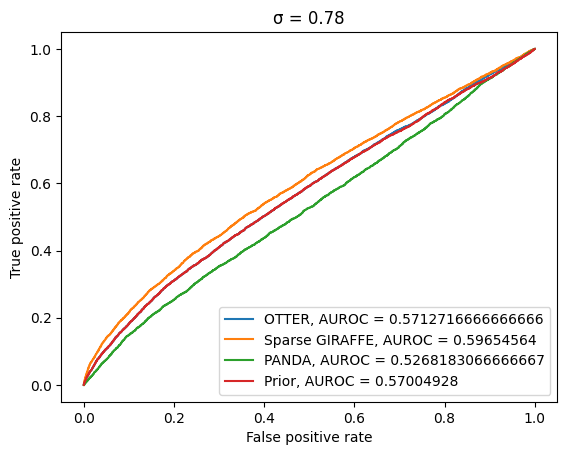

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3856
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.868177  1.725703 -1.311146  0.668875 -0.573012 -1.345328 -1.400938   
1   -0.905468 -1.038610 -0.550491  5.868011 -1.911147  0.149876  1.799380   
2    4.391953 -1.410328 -6.289650 -0.654392 -3.626229  1.778271  2.939698   
3    0.434745  0.418548 -1.827329  0.235585 -0.053176  0.139773  1.836757   
4   -0.413809 -1.655243 -1.895577 -1.545359 -1.196188  2.073543  1.003562   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.335653  1.680301 -0.866569  0.497947 -2.932269  0.066712  0.860825   
496 -1.170043  0.621694 -0.341898 -0.411252 -1.727974  0.995600  0.402088   
497

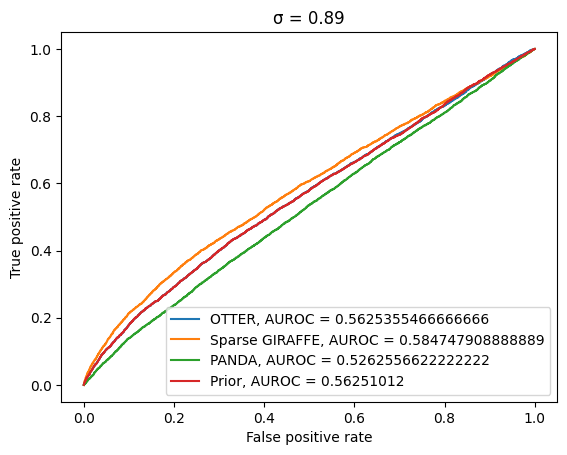

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3818
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.014733  5.809335 -3.899097 -1.081839 -2.015928 -2.808140 -1.766411   
1    1.050187 -0.482973  1.017615  2.130188 -0.340483  0.016794  0.490504   
2   -1.169130 -0.844303 -1.207897  1.130386 -1.628261 -0.368087  0.731889   
3    1.161720 -0.142939  1.572438  2.288649  0.217250 -1.079069  1.236213   
4   -0.570800 -0.427597  0.660129  0.273812  1.267140 -0.355971  1.888238   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.873090 -1.024327 -2.138155  0.629731 -0.527748 -0.213980 -1.271426   
496  1.023756 -0.665613 -1.259422 -0.391375  1.346912 -1.908611  0.759115   
497

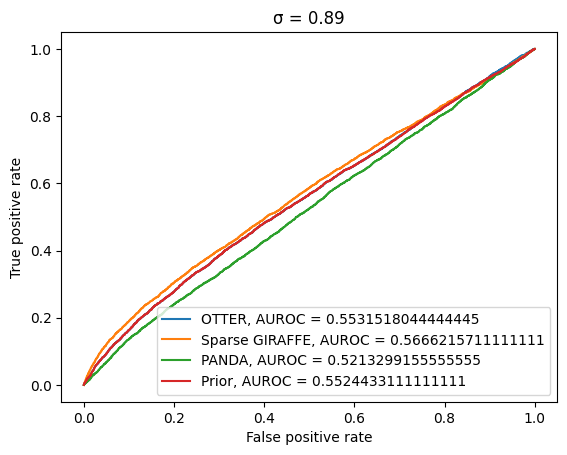

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3934
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.856251  1.876381  0.377325  2.761251  0.709642  1.581386  2.813491   
1   -1.119281 -1.473595  0.843669 -3.620387  1.258671  0.196588 -1.427346   
2   -2.003776 -0.530131  2.612861 -2.031048  0.792415 -0.410548 -0.328278   
3    1.161123  2.296800 -1.980868 -0.756136 -1.460681 -2.476068 -1.347328   
4    2.861541  2.964871 -2.364240  0.817650 -0.559426  0.607494 -2.340796   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.718587  1.039418 -0.799378 -0.862902 -1.851408  0.040040  0.659107   
496 -1.343031 -1.638612  0.145964  1.576378  0.870716 -2.520202 -0.740777   
497

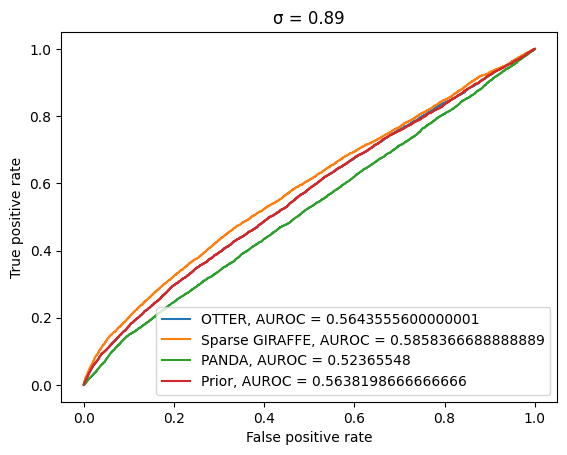

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3866
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.692451  3.160024 -1.900917 -3.061311 -1.674192 -2.110264 -2.939166   
1    0.177351  2.787129  0.091079  0.843185  3.734556 -2.659446  1.997120   
2    0.967871  1.942717  1.836600  0.130553 -4.007290 -1.924634 -2.078397   
3   -0.847369 -0.471891 -2.090910 -2.165964 -2.215771 -1.388551 -3.182428   
4   -1.744755  0.989678 -0.087721  1.443605  1.931220  1.751489  5.808377   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.444303  1.375880 -1.149416 -2.203284  2.265435  0.246299 -0.462933   
496  2.666723  1.648686  1.008492  2.550993 -0.431982 -0.267754 -2.209066   
497

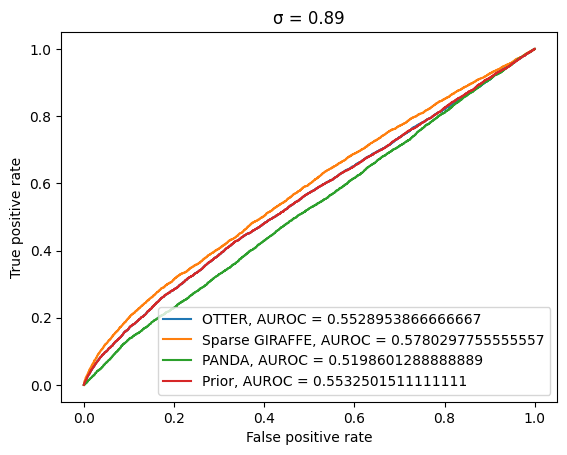

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3870
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.690493  0.002746  2.167379  0.505083 -1.575547 -0.332344  1.557641   
1   -1.345562 -1.413196 -0.697902 -0.818473 -1.777098 -1.419074  0.406808   
2   -3.611869  1.012755 -1.304471  0.098558 -2.255676  0.816137 -0.155080   
3   -2.329420  1.061209  1.657440 -0.970900  0.518416 -1.491843  0.955580   
4    0.717162 -0.016116  1.390183 -0.802830  3.018476 -1.437879  1.954743   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.428595  2.140149 -1.423949 -1.175067 -0.205115 -1.042219 -2.150809   
496 -0.226628  2.852422 -3.005521  2.879520  1.199434 -3.801788  0.218379   
497

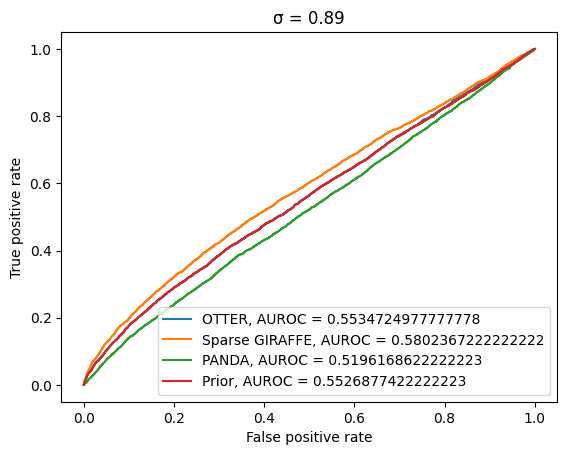

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3882
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.565003 -0.036959  2.058248 -2.574881  0.776163 -0.239569  0.623176   
1    2.520489  2.600942 -0.953597  1.195245 -1.115425 -1.673083  2.057138   
2   -2.403969 -3.137678  1.829148 -0.606405  1.125276  1.715089  0.188944   
3   -1.873998 -1.244992  2.306974  0.396474  0.603465 -0.099254 -0.584611   
4    0.821476 -1.555362 -0.626362 -1.285788  0.108107  2.653884  0.330551   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.423064  1.222756  0.752512 -3.792296  0.290844  0.058296 -2.842105   
496 -1.147590 -0.000609 -0.463353  0.136544 -1.614372  0.747502 -0.928958   
497

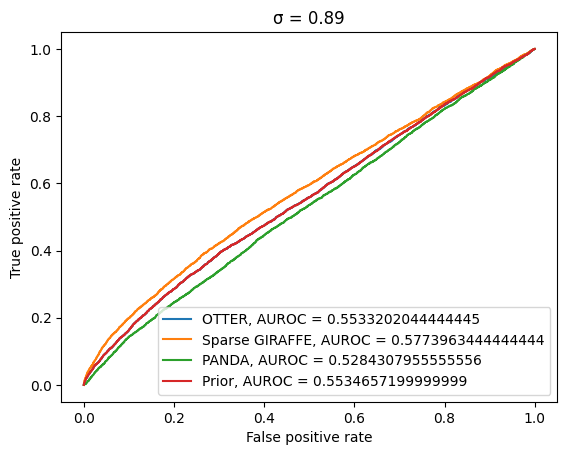

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4188
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.664571  0.181347 -0.605950  1.130812 -0.018716  0.429555  0.110506   
1    0.663420  0.136339  0.234729 -0.244726  0.595574  0.516348 -0.088998   
2   -1.664155  1.227510 -0.572215 -0.430019 -0.719947  0.210518 -1.075649   
3    1.719929 -1.712767 -2.138782 -1.403845  1.892009 -0.755354  2.272893   
4   -2.708343  0.234411 -2.393430 -1.194760 -0.847217  0.690280  3.717015   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.507173  0.108197 -2.662844  2.166760  1.514383 -0.276723  3.554874   
496  0.291711 -1.454028 -0.682597 -3.195291  2.808927  1.827992 -3.168769   
497

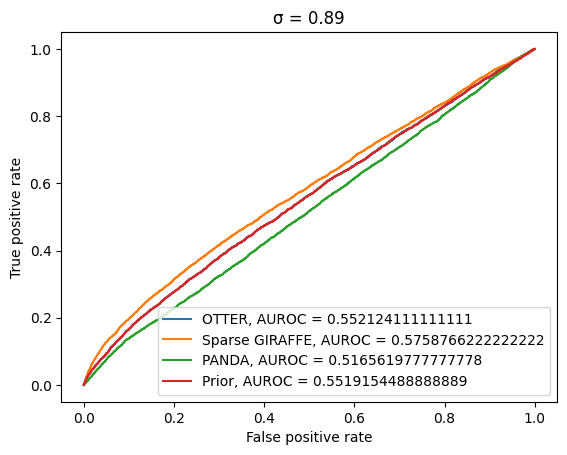

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3866
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.592417  0.480700 -0.180119  0.172771  0.967134 -0.358444 -0.309333   
1   -0.279439 -0.704601  0.078103  3.282489  0.834410  1.037966  3.817370   
2    0.402470 -1.324858 -0.609233  0.778870  0.482206  0.963653 -1.545687   
3    0.150279 -0.990145  2.296954  2.895577  0.213820 -2.988822  2.901660   
4   -0.314884  0.261066  0.792554 -0.128303 -2.990665 -2.142915  2.064451   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.944777 -0.505341 -1.032526  1.818181 -0.389231  0.513647  1.423575   
496 -0.799288  0.937451 -0.567817  2.799385 -0.330052 -0.440503 -0.541033   
497

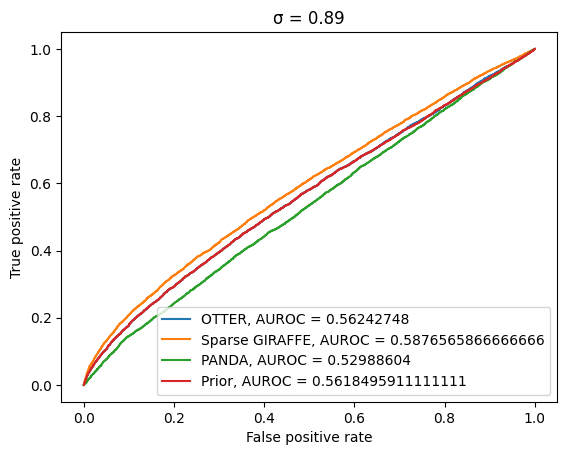

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3874
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.059515 -0.970883  2.077594  0.804628  2.476924  0.864322  2.600522   
1    0.323204  3.319643  5.266373 -1.125752  2.209116 -0.175097 -0.437959   
2    2.175734  0.360656  1.834807  2.045611  1.461640  1.714831  1.083100   
3   -0.629045 -0.870184 -0.384598  1.399489 -0.154198  1.766215  3.403488   
4   -2.388117  2.316857  1.603399 -2.923799  0.195936 -4.169091  0.226685   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.190718 -3.713224  1.983961  1.395499 -0.592617 -0.125621 -2.548126   
496 -0.023343  0.806846  0.020608  0.127138 -0.873943  0.687171 -1.287547   
497

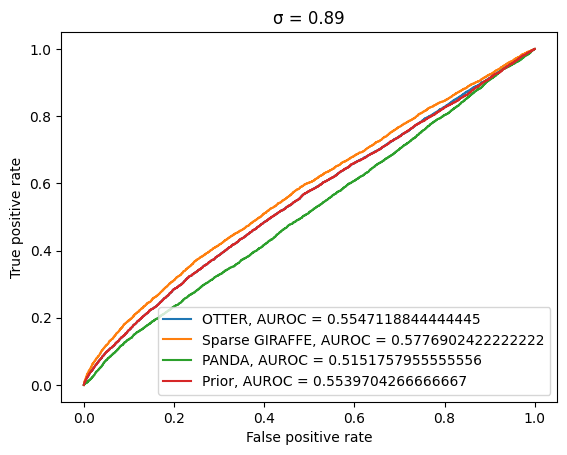

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3966
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.019132  2.007250 -1.984739 -0.872256  0.044774 -3.977701 -0.337929   
1    0.261994  0.653814  0.695816  3.131505 -0.019740 -1.220222  3.834481   
2    0.405067 -3.343570 -0.479019  1.656598 -0.616681  2.818212  1.351654   
3    0.791444 -3.595662 -1.778546 -1.680615 -0.209645 -0.783397 -4.660201   
4   -0.894797  1.894735 -0.267705 -0.889302 -2.328210 -1.096047  0.957156   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.216643 -1.085918  0.423195  0.086705  0.486332  3.133067 -0.353415   
496  0.856279 -1.905029 -1.123488  0.292961  0.043778 -1.943998  0.019554   
497

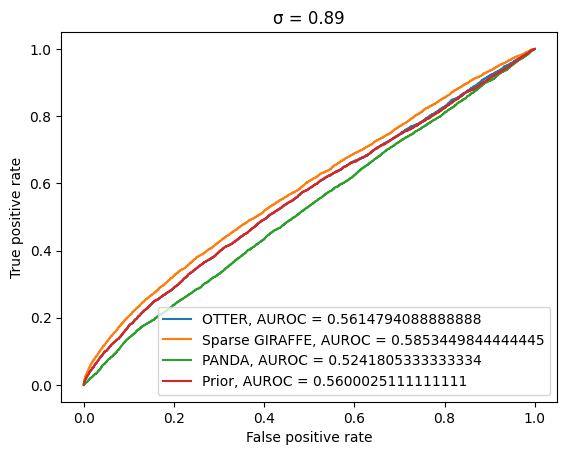

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3872
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.279824  1.865273  2.926844 -3.059312 -1.494329  0.871692 -0.891230   
1    1.166408  0.705221  2.744420 -0.367151 -0.070577  2.291387 -4.070181   
2   -3.166856  0.371969  1.269346 -0.229723 -1.364659  0.185857  1.012622   
3    0.378966 -0.864240  0.247913 -0.897034 -1.329825  0.046455  0.191459   
4   -2.008253  1.686241 -1.722748  0.469616 -1.345467  0.475262  0.931733   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.760459  1.671742 -1.477076  0.362424  0.373719  0.646716  0.259774   
496 -4.406601  2.035569  3.621533 -1.601465  1.941361  2.481032 -0.904466   
497

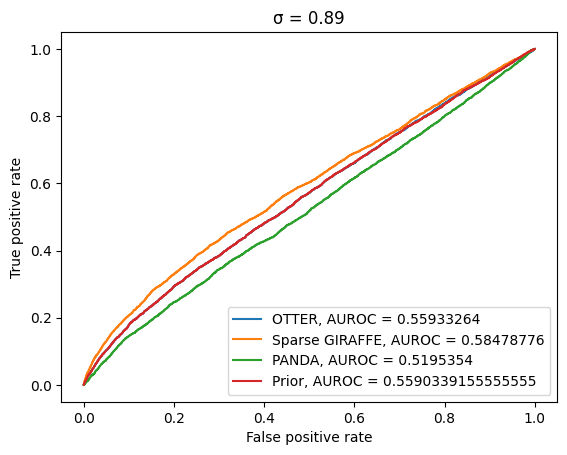

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3900
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.314356 -0.588987  1.023531 -0.178079 -0.323984 -0.511221  0.264761   
1   -1.063323  2.732568  0.233750  0.465365 -2.132561 -1.299654  0.817317   
2   -1.382377  0.622036  3.835678  0.106370 -4.850765 -0.422468 -4.237679   
3   -2.678481 -0.049475  1.153436 -0.026887  1.424745  0.627185 -0.313447   
4    1.966247 -0.889692 -4.184493 -0.004866  0.245025 -4.058988 -1.833108   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.919293 -0.566003  1.503143  0.317334 -0.045546  3.132905 -2.056808   
496 -4.162817  1.085739 -1.809127  0.153954  0.039344  5.412602 -1.565559   
497

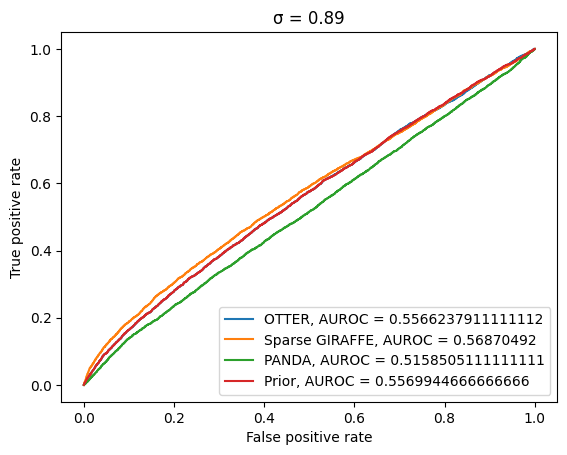

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3894
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.961732 -0.762836  0.129805  0.729989 -0.305426  1.526435  0.355244   
1   -1.351934  0.785044  0.580083 -0.446656  0.310706  3.370052 -1.738764   
2    2.042306 -0.739697  0.961961  0.251110 -1.013733  2.508598 -1.286293   
3   -4.103986  1.753159  1.630215 -0.048298 -2.546529  0.514076  1.108595   
4   -0.815183  1.494875 -0.427397  0.491420 -2.159451 -0.052763  0.991747   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.048526  0.095980  0.769323  1.271575 -0.519916  3.131961  1.805882   
496 -2.306760 -0.218058 -2.667365 -0.036617  1.462911  2.225762 -1.496475   
497

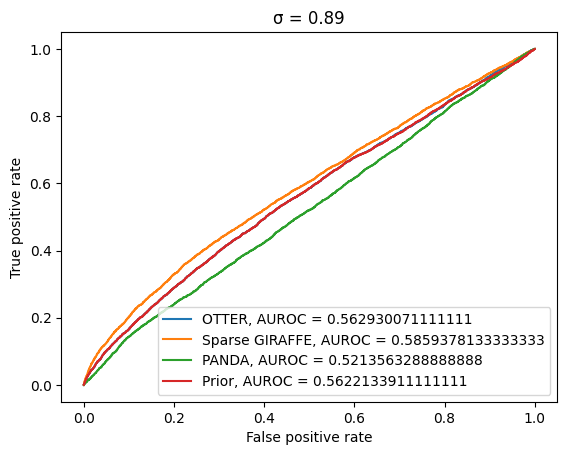

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4022
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.990043  3.547773  0.268643 -1.899867  2.652414  0.777761 -3.706611   
1    0.840661  0.014655 -0.223196 -0.832732  0.674287  1.507206  0.861268   
2    3.643291 -0.522051  1.265967  0.630686 -0.330786  1.372432 -0.059091   
3   -0.016787 -2.091793  1.765246  1.245304  1.378228  0.745857 -0.152671   
4   -1.581929 -1.699444  2.529213 -0.289835 -0.173700 -1.094739  1.069485   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.860665  0.310946 -1.764061  0.009664 -0.645395  0.874734 -0.056746   
496  0.028728  0.164889  1.595538 -0.517215  0.066065  0.875883  0.704333   
497

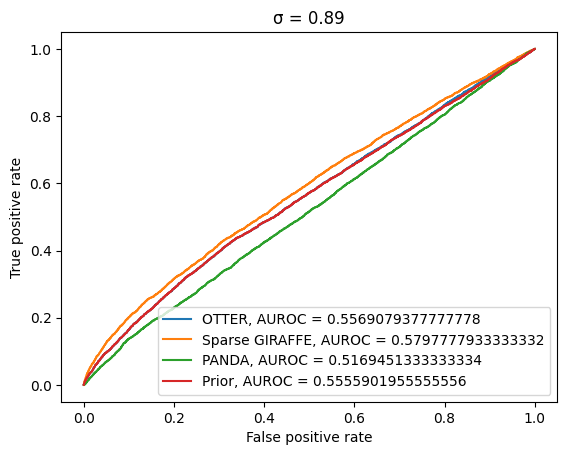

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3850
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.308647 -2.981349  0.771917  0.434215 -2.380910  0.200160  1.642516   
1   -0.689181  2.204340 -0.631687 -0.463121 -0.499604 -0.438049 -2.102085   
2   -0.309697  0.719901 -3.897823 -1.782472  0.222016 -0.956905  2.645184   
3    1.923803  0.927916 -1.204181 -0.606875  1.071005  0.374398  1.049901   
4    0.493049 -0.300736  1.391096 -0.042968 -0.630466  1.640351  2.183874   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.379107 -0.545377 -0.263877  1.926292 -0.735360  1.808603  1.366215   
496 -2.875784  3.902502 -0.717066 -1.972621 -0.969408 -2.722285 -0.902917   
497

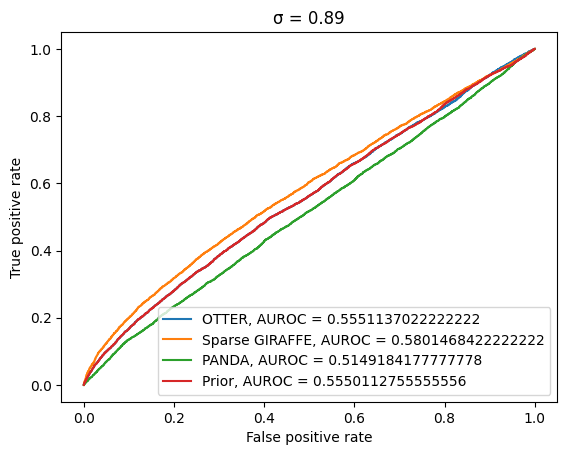

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3908
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.324711 -0.237498  0.725257 -1.313214  0.645962  1.734246  0.544892   
1    0.197702 -0.708970  2.016313 -2.113719  1.019416 -2.715905  0.049398   
2    0.119010 -1.209265 -0.754342  1.198121  0.109258  3.327746 -1.353278   
3   -1.414872  1.362308 -2.703390 -2.682524 -1.061675  1.450297  1.446938   
4    4.318553  0.913774 -0.964775  1.904751 -1.125713  0.717243 -0.325318   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.808731  3.420585  1.988596  1.197071 -0.074211 -0.582456  2.197830   
496  0.141908  0.574829  0.887177 -0.166642  2.347589 -0.331800  0.938704   
497

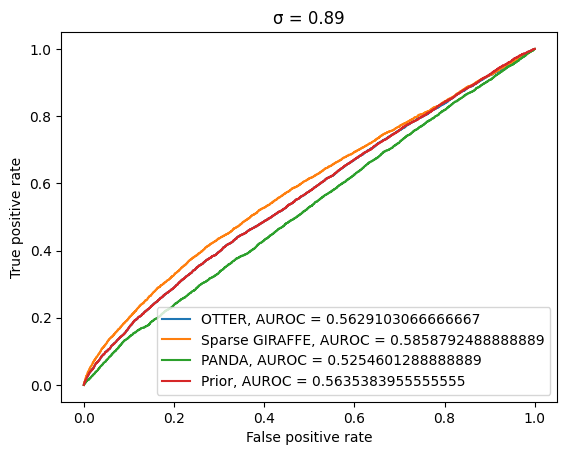

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3826
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.930207  2.192189  1.164999 -2.827882  2.257736 -1.337940 -1.698288   
1   -3.017742  0.350669  3.294223  2.303686  2.432947  1.533688 -0.956268   
2   -1.704911 -0.235718 -1.396726  0.240877 -1.253997 -1.238432  0.474894   
3    3.963079 -0.616876 -0.368516 -1.345446  1.144164  1.568756  0.205000   
4    0.656788  1.600420 -0.295124  2.427242 -0.258423 -6.180132  1.032321   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.670447 -3.235061  1.003448  2.045626  1.291291  0.118781  1.038456   
496  0.114806  1.093292  0.655296  0.125972 -0.224505  0.113591  1.001454   
497

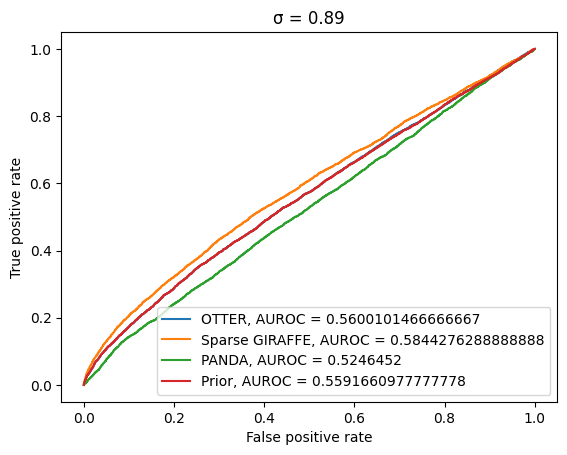

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3818
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.612728  0.094813  1.307627  0.202341  2.601807  1.104614 -1.530322   
1    0.605081 -1.325168 -0.039595  3.106930  0.779749  2.852804  3.232830   
2   -0.497922  0.790123  0.468643  0.082931  3.364943 -0.365410 -1.001132   
3   -0.367394  0.181029 -0.902618  1.148071 -1.269435  0.002707  0.963904   
4    2.202558 -1.507314  5.579964  1.496941 -1.277873 -1.237317 -0.715305   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.259058  0.223671 -4.194532 -3.644933 -0.864571  0.101588 -0.099016   
496 -0.856641 -2.213174 -2.687768 -2.078361 -0.745069 -0.250001 -1.198233   
497

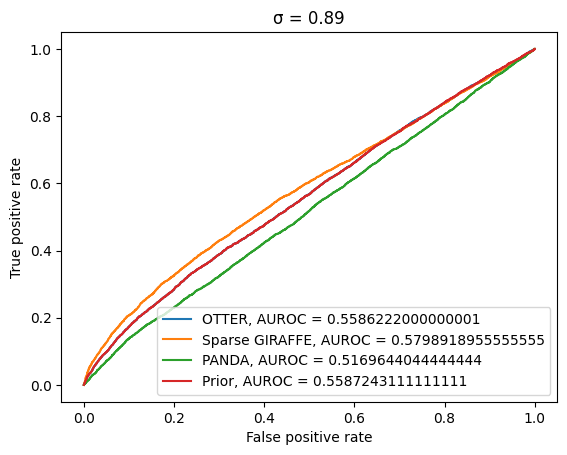

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3886
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.301822  0.737272 -3.747722 -1.838962 -0.994933 -2.092362  0.202544   
1    0.006608  1.907135  0.030591 -1.695761 -1.037493  0.197798 -1.967554   
2    4.381447 -1.841412  3.919945  1.901244 -0.379566 -1.509334  2.853142   
3   -0.347045  0.020669 -0.305900  0.245470 -1.128927  0.762459  0.514146   
4    2.300943  2.736654 -1.148424 -1.076678 -1.884128  2.110605 -2.144976   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.477391  0.478054 -0.927121  0.941694  2.073040  1.576083 -2.000217   
496 -2.277598  0.411777 -1.257960 -0.253294  0.862023 -0.693987  2.196289   
497

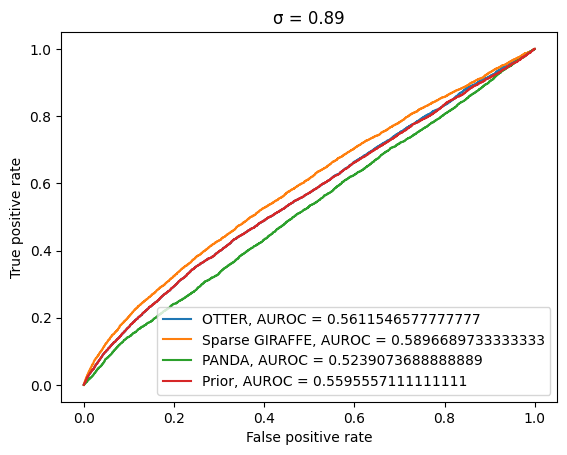

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3786
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.391459 -0.826293 -3.364726  1.119646  0.377876 -1.758776  0.116922   
1   -1.650459 -0.215000 -1.249159 -1.936257 -1.052468  0.115140 -1.521582   
2   -1.854006  0.969825  3.741118  1.042261 -2.127012 -0.622011  0.327073   
3   -1.173533 -1.228741  1.265168 -0.554322  1.163526  0.456375 -0.603500   
4   -0.095040 -0.864440  2.188610 -0.368066 -3.139096  4.634712 -0.751125   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.429264  0.307410  0.920205 -0.728384  1.310884 -2.984932 -1.214981   
496  1.138609  1.172567  0.845095  1.344317 -0.885562 -1.789468  0.403321   
497

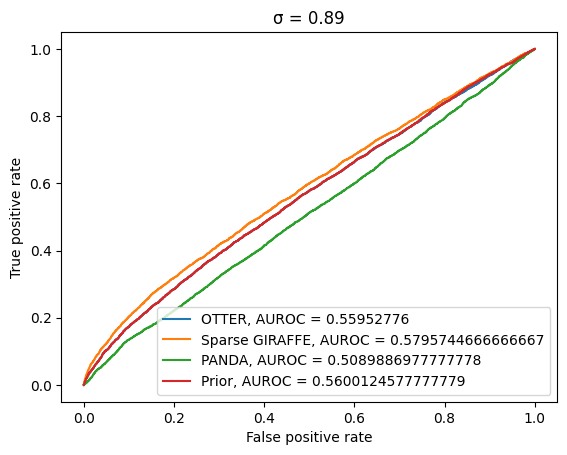

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3892
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.01 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.215433 -0.724216  0.003621 -0.584117  1.461044  1.076368  1.296947   
1    5.057508  1.305874  1.158386  3.360108 -1.459143 -1.528575  1.541300   
2   -0.264154  1.826552  2.290526 -0.154943 -0.580744 -1.345156 -0.947668   
3    2.340842  0.854556  1.082052  0.218579  1.725537 -0.482540  1.521824   
4    0.126993 -0.787750 -1.349578  2.847376  0.222549  3.659635  1.383813   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.239834 -1.675254 -3.037779  0.788469  2.395581  0.671299  2.407278   
496 -1.707924 -1.338885  2.350106  3.068937 -2.872532  0.127065  0.743634   
497

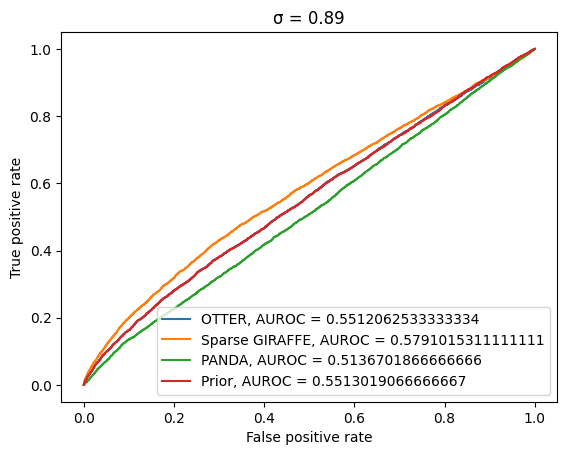

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3956
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.683744  3.097653 -2.622728  0.340845 -2.832609 -0.177860 -0.891294   
1    0.524845  0.398150 -1.413728 -0.330126 -2.458752 -0.826346 -0.227749   
2   -0.083449  1.941997  0.226901 -5.421680  0.520975  2.676752 -3.639250   
3   -1.713615  1.834427 -2.395197  1.489267 -0.357517 -0.298444 -0.625067   
4   -0.600887 -0.792042  1.018901 -1.660034  1.402795  0.876333 -1.013249   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.332412 -1.242856  0.185490 -0.855771 -0.503195  0.692379  1.383236   
496 -1.848445 -1.467918 -3.219570 -1.265695  0.711293 -1.505110  2.453608   
497

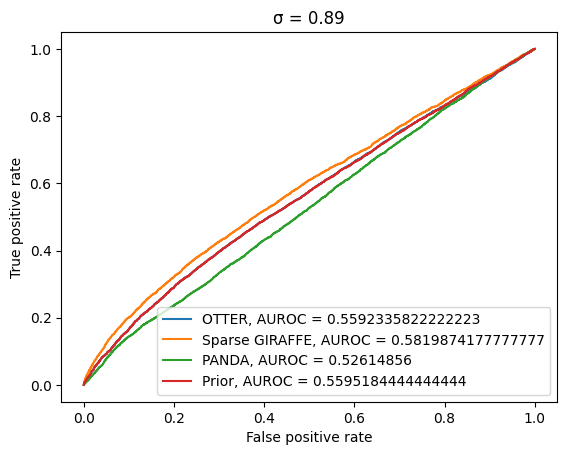

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3916
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.042210 -0.289331  0.447636 -0.064648  2.226438 -0.853948  1.237869   
1   -0.586683  0.188081  0.999412  0.301634 -1.751129 -0.311583  2.841176   
2   -0.732735  0.586181 -1.361285 -0.898490 -0.920506 -0.551931 -0.410610   
3   -0.299672  1.741415 -0.916159 -0.827145  3.358346  0.681298  0.455751   
4   -2.203584  0.627902 -2.968455 -2.524836 -0.216415  3.358237 -5.251742   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.142619 -0.196640 -1.817787  3.888715  0.676603 -0.251509  2.199290   
496  1.265708 -3.139579  1.587362 -1.723481 -1.309556 -0.579395 -2.432593   
497

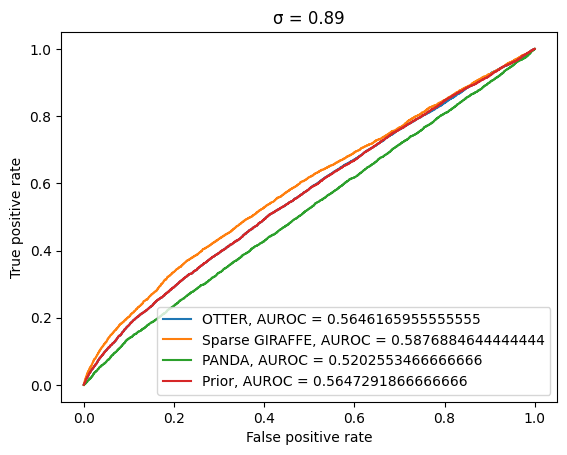

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3790
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.178136 -0.664986  1.173949  3.665555  0.211992 -0.843910  1.191442   
1    1.634354  1.257018 -1.511429 -0.614187 -0.519364 -1.282777  1.168058   
2    0.859142 -0.915843 -1.276337  1.978176 -1.346992  3.164105 -0.456518   
3   -0.357375  0.362880 -0.169665  1.334337  2.228846  0.833731 -0.085271   
4    0.513401  2.078734  1.927585 -0.660526 -1.609025 -1.330185  0.415388   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.620124  0.932178  1.025049  0.639108 -0.096354 -1.120237 -0.079509   
496 -1.151684  2.197205 -2.106756  2.247546 -1.322758 -3.046167  3.361994   
497

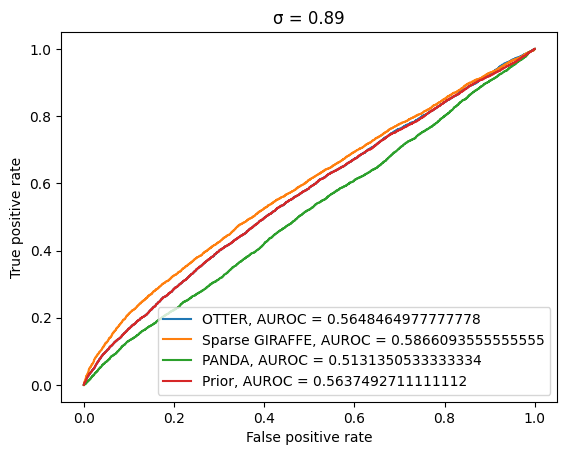

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3916
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.211904 -2.229017 -3.561178  1.070425 -0.579132  1.788812  2.472387   
1    0.935073  0.699405 -3.119647  2.745292 -1.366873  0.967205  2.303493   
2    1.727231 -2.839478  5.255917  6.249442  1.833163 -3.913311  4.451990   
3    0.291071 -0.484616 -0.422527 -1.916255  2.349308  0.057522  0.220924   
4    2.553881 -0.976542  1.774545 -0.883875  1.954492 -0.331542  0.987949   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.779597 -0.441949 -0.503304 -1.270636 -0.821801  1.676388 -1.095599   
496 -0.436074 -2.552454 -2.383712 -0.678357 -1.394519  0.630780  0.644841   
497

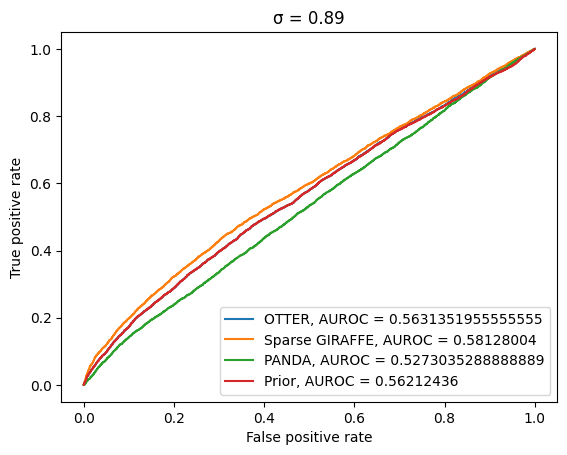

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4006
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.551274  2.450907 -0.910363  1.303603  1.398600 -1.347283 -0.018201   
1   -0.856287 -0.510848  2.017995  3.064683 -0.298830 -2.122755 -1.721051   
2   -2.752993 -1.119237  4.133836  3.204680 -0.285910  0.270997  0.962102   
3    2.593660 -1.575096 -0.442741 -1.449809  1.455020 -0.210950  0.401171   
4    2.137027 -1.572140  0.643823  0.644048  2.004283  1.608596 -3.760169   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.793824  1.553620 -0.976675 -1.488344 -1.244383 -1.543920 -1.711427   
496 -0.373555  0.445773 -0.749727 -2.267506  0.720192  0.158685 -1.482420   
497

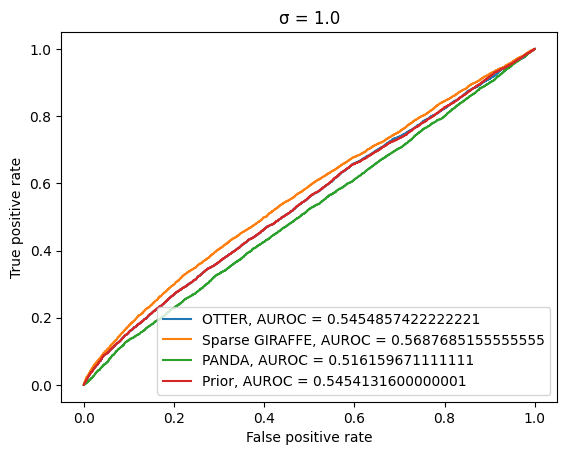

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3878
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.929220 -0.116804 -1.237081  2.479501  1.600412  1.976319 -0.186468   
1   -0.838889  0.021567  0.993378 -1.640238 -1.533765  0.458537 -0.090730   
2    0.024058 -1.384286 -2.163447 -1.457878  1.812841 -1.174222 -0.772226   
3    3.578646 -0.153438 -0.609900  0.793204 -1.897803 -2.813019  3.239184   
4    1.547551  0.659590  0.326450  1.983776  0.171849  0.840479 -1.099944   
..        ...       ...       ...       ...       ...       ...       ...   
495  4.285060 -0.371354 -2.765631 -1.804598  1.064259 -0.897052  1.108774   
496  0.587801 -0.267843  0.455036 -1.446854  1.442016  0.763948  0.705969   
497

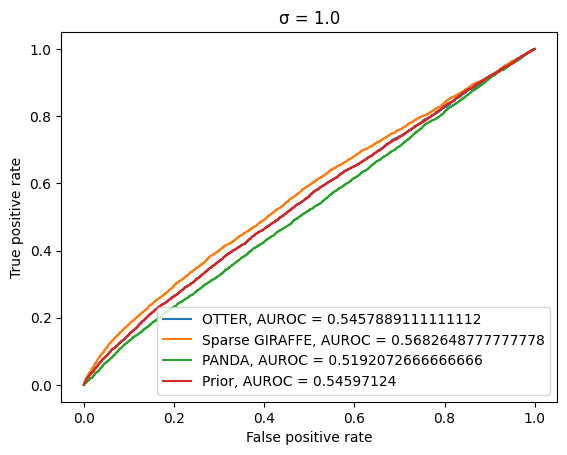

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3888
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.348277 -1.879543 -0.095694 -0.521071  0.605928  1.021454  1.080216   
1    0.808900 -1.769168 -3.785521 -1.861667  2.166091 -2.427205 -0.145689   
2   -0.590804 -1.056833 -0.357401  1.205262 -0.959595  0.499695  2.257864   
3   -3.030976 -2.706957  4.327414 -0.886316  2.222575 -0.191023 -0.514931   
4    1.573078 -0.439722  1.025635 -0.686116  3.604446 -0.570275  0.634289   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.364641  1.637670  0.889569 -3.105518 -0.231536 -0.294650  0.677642   
496  0.650725 -0.008079 -0.514094  1.272924  0.982042  1.612761 -1.305614   
497

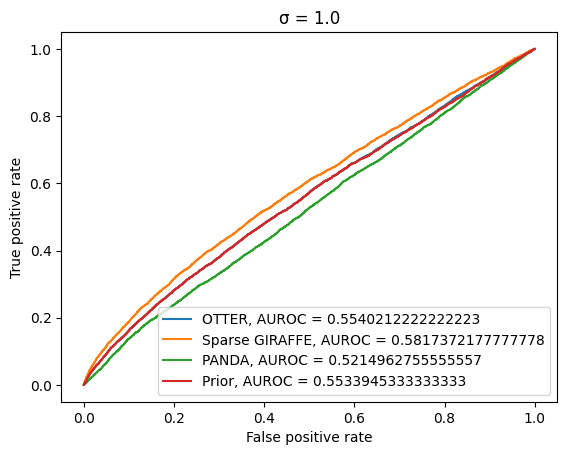

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3872
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    2.301904  0.028091 -1.421450  1.805117 -1.119906  1.245651  3.509227   
1    0.565217 -1.885766  0.081698  0.767555 -0.324212  1.088660 -0.120901   
2   -0.409169 -0.591328  0.909529 -1.268576  1.414575  0.463271 -1.470898   
3   -1.776201  0.235312 -0.798539  1.820932 -0.622862  2.271834  0.007775   
4   -1.362157 -1.242147  0.687595 -1.368695 -0.957825 -2.519734  1.633946   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.815598  1.124208  0.166870  2.498061 -3.201743 -3.189903  1.743613   
496  1.505437 -0.853579  3.260152 -0.935414 -0.086622 -1.051918  1.496460   
497

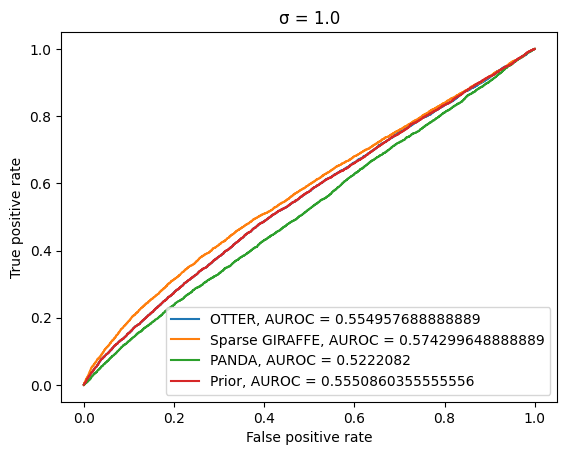

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3972
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.911526 -4.004379  1.319112  0.946408  2.923652  0.475741 -0.345247   
1    1.225993  2.296000  2.181121  0.683227  0.512413 -1.208173  2.275433   
2   -2.518624  2.469728  1.939717  1.483934 -1.455793 -1.515392  0.501868   
3    1.295486  1.076474  1.838509 -0.490068  0.415760 -1.889227  0.974120   
4    0.474938 -0.151794 -2.633824 -2.333820 -0.616270  0.041166 -2.158814   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.061922 -0.481627 -1.916253  0.589489 -0.053956 -0.539549  1.068481   
496  1.339220  0.258740  0.064134 -1.548355  3.292912 -1.765115  0.568276   
497

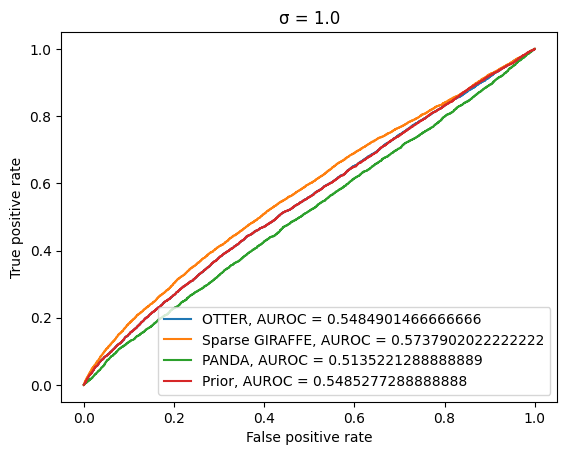

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3802
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.032349 -0.172526  1.003279 -0.367915 -0.486696  0.235286 -1.250599   
1   -4.325235  1.681201  1.273755 -1.892170 -2.590249  1.491391 -5.814517   
2    0.035918 -0.643535  1.010318  3.479910  1.857224 -1.645563  1.715001   
3   -1.859370  1.206917 -0.285520 -2.017862 -1.099710  0.503861 -1.019627   
4   -0.783337  2.130618 -0.016332  1.582232  0.103771  2.512590  0.063353   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.382461 -1.559518  0.161951  0.076596 -0.366675 -2.240287  1.113902   
496 -0.392528  1.619605 -2.270010 -4.124487  2.263393  3.045348 -0.480554   
497

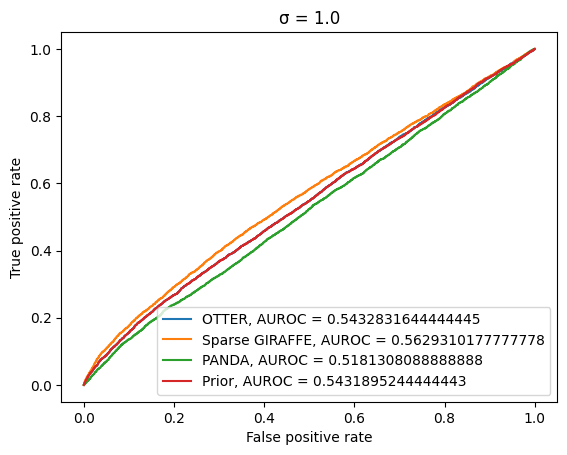

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3992
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.298789  0.484153  1.896557 -1.995422  1.793025 -0.593489 -0.525654   
1    1.946523  1.727863  0.982485 -0.582631  1.291874  0.556972  0.561253   
2    3.397734 -2.926918  0.178909 -0.142566  0.141306  1.876183 -2.653143   
3   -2.456010 -0.198322  0.633822  2.405716  2.812396 -2.926425  3.423347   
4   -1.703124  0.619805 -0.417438 -1.716656 -0.424682  0.672190  2.101825   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.629265  0.048807  1.935974  0.660109  1.252633  0.014017  0.746635   
496  0.835690  1.577444  1.382809 -0.097969  0.578882 -0.840941  1.226250   
497

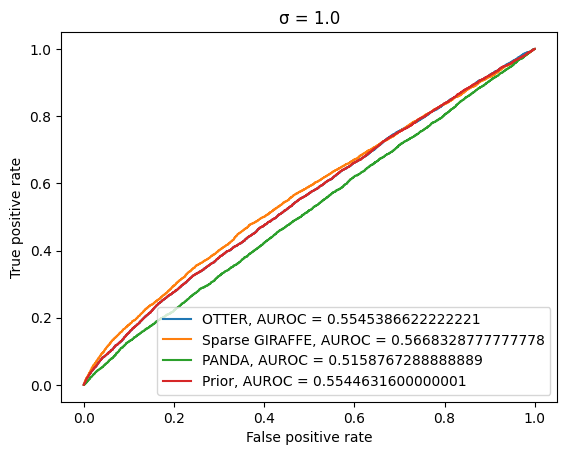

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4094
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.089149 -2.590078  0.472814 -0.349027 -0.161932  2.062338  2.111896   
1    0.426334  1.034421 -0.223887  1.129664  0.391337  0.780646  0.849716   
2    0.218372 -0.231977  0.615245  0.202423 -1.093312 -4.586002  3.101391   
3    1.886333 -1.298904  1.554997 -1.004034  0.399406  2.887217 -4.056066   
4   -0.697915  1.569280  1.552006  0.677586 -0.496061 -0.140565 -0.365308   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.020251 -0.128093 -0.194792  0.261861 -0.071472  0.072167 -0.105401   
496  1.251896 -2.142597 -0.873702  1.120929  2.067110 -0.153455  4.157342   
497

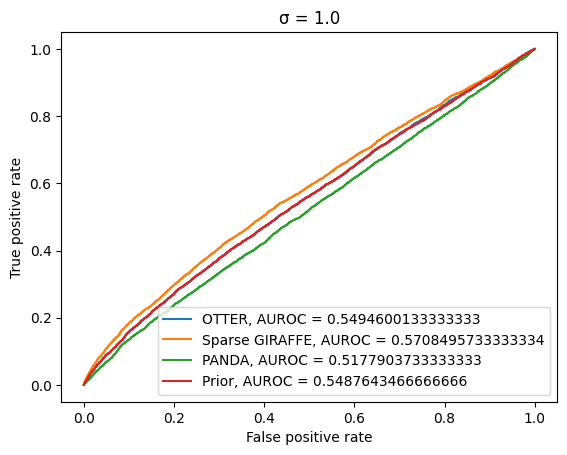

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3840
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.433717 -2.693675 -0.190229 -1.527878 -0.021870  1.827576 -0.099682   
1   -2.950854  2.466269  1.238699 -0.328835 -0.593692 -0.172301 -2.071812   
2    3.761134 -3.522360 -5.576927 -0.561362  0.241651 -1.890646 -1.223599   
3    1.200716 -1.052333 -0.052251 -0.604723 -1.381658 -0.097129 -3.374097   
4   -0.763108  1.740155 -1.845004  3.775844 -1.957322 -0.170477  1.197996   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.408558 -0.254246 -0.028325  0.288656  0.249315 -0.381672 -0.712372   
496 -0.958726 -2.745632  0.127662  1.437798  0.688265  2.821027 -0.040204   
497

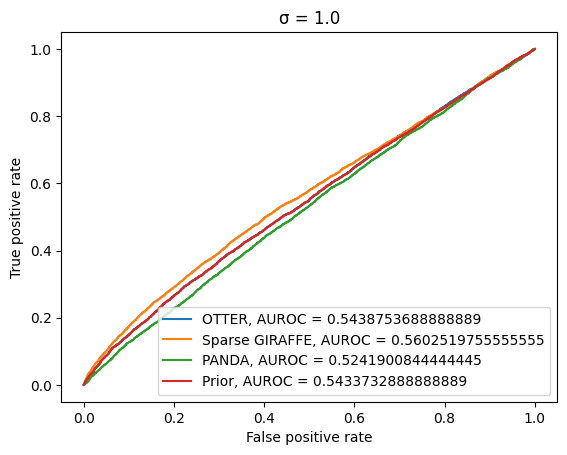

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3952
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.151415 -0.477079  1.529821  0.310156 -1.201256 -0.795122  2.379893   
1    2.138335  1.353789 -0.965437 -3.337219  0.698551  0.943125 -0.395157   
2    1.440666 -1.164847  1.716895 -1.449004  2.874151  4.278246  2.118079   
3    0.828612 -1.845381  1.596490 -1.433621 -1.190937  4.041694 -1.068214   
4   -1.046025 -0.058662 -1.597854  1.719742 -1.502503  0.540567  3.349001   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.084896 -1.277051  0.522796 -1.726049  0.048094 -1.085090  1.150919   
496 -0.053101  0.043849  0.488466  1.263466  1.124256  1.356209  1.083363   
497

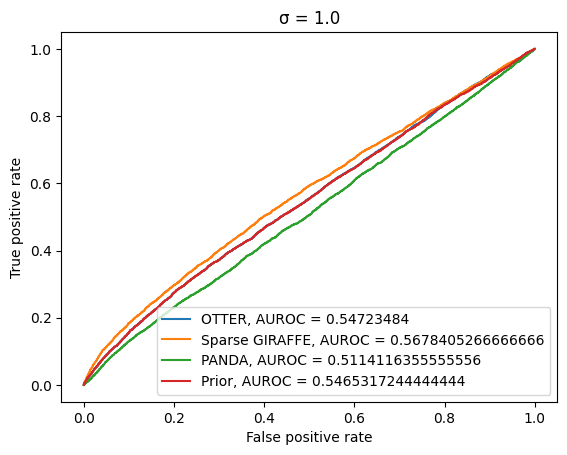

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3916
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.932315  0.879194  1.093052 -1.534310  0.295855 -1.291259 -3.743094   
1    2.695557 -0.574476  1.205784  4.759368  0.990475 -0.531661 -2.060715   
2   -0.108854 -0.150288  0.921778 -0.968989  0.566001  0.195291 -1.344676   
3    1.611600  3.200939  2.781323 -0.722194  2.057252 -0.634050  1.375666   
4    0.661287  1.647041  0.251093 -2.672522  2.121880  1.650759 -1.118188   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.786760 -1.143148  0.658836  2.122633  2.187417  0.171724 -0.270464   
496  1.365157  1.915293 -0.525233 -0.318188 -0.343662 -0.446637 -0.527438   
497

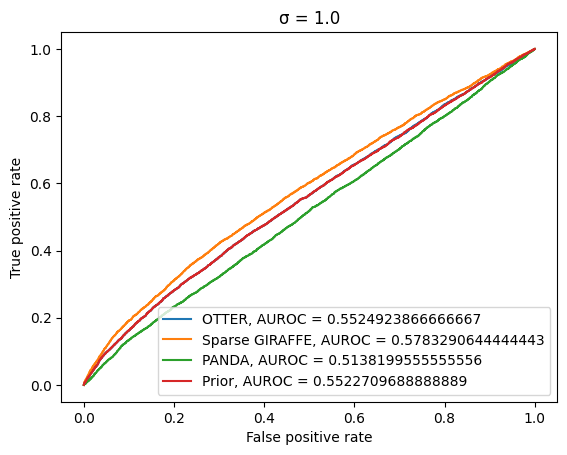

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3998
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.060335 -0.216916  3.696681 -0.774522 -2.456970 -4.076923 -1.213349   
1   -2.181687 -0.465590 -1.374428  1.197472  0.645165 -3.855792  1.388861   
2    0.923714 -2.062546 -0.269671 -2.611287  1.385052  0.751210 -1.103788   
3    0.241478  1.664870  0.890635  1.176942 -1.084071 -2.157720 -0.248938   
4    2.418094 -1.867446 -2.996795  0.860673 -1.082392  0.450902  0.891745   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.487956  0.493546 -0.380804 -2.889510 -0.724077  0.067021 -0.265835   
496 -0.322572  1.612834  2.274754 -0.217330 -0.115736  2.845628  1.832303   
497

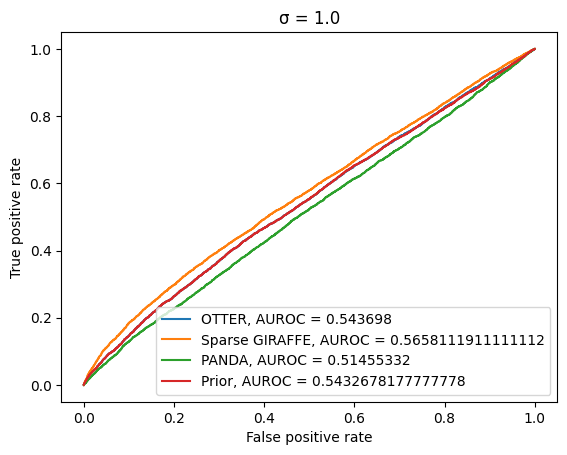

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3872
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.254528 -1.835870  0.079167  0.887969 -0.324063  2.075376 -0.058148   
1    0.979181 -3.947046 -2.710334 -1.571764 -0.169783  1.997101 -0.183587   
2   -3.809482  1.076229  1.760117 -0.606707 -2.451192  1.548135  1.623766   
3   -0.852196  1.715023  1.859053  1.537772 -0.541125 -2.039492  0.774110   
4   -0.095740  0.135795  1.759198 -0.258107  0.486927 -1.312596  2.560880   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.387883  2.092469 -1.184287  0.884728 -0.828007 -0.420481  2.515425   
496 -2.906973  0.581816 -4.569590 -3.819959 -2.036315  0.998977  0.375100   
497

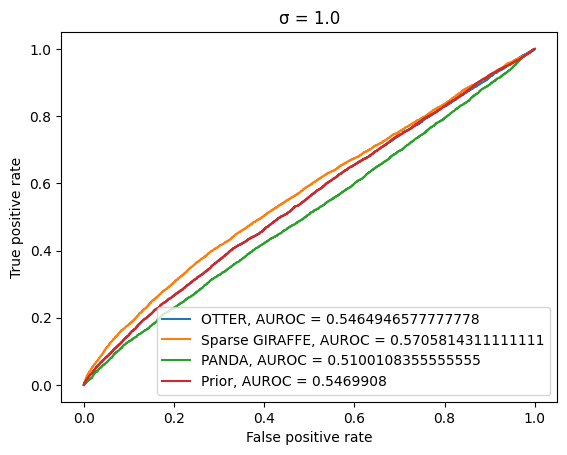

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3882
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.059513 -0.567854  0.996426  0.386714 -0.211614  1.448165 -1.538661   
1   -0.136498 -2.115831  1.954449 -0.546179 -1.148277 -3.058760 -0.134851   
2    1.895087 -0.750802 -3.579990 -0.042501  1.315938 -3.422736  1.618588   
3   -1.459720 -1.308185  1.621060 -1.734942  1.123046  2.823933 -3.096659   
4    2.997821  0.602175 -0.654367  0.109841  0.233024  0.068867  0.014226   
..        ...       ...       ...       ...       ...       ...       ...   
495  3.399374 -0.260537  3.231649  5.669868 -0.388860  0.619246  1.724254   
496 -1.008897  0.962531 -0.252125 -0.276705 -2.844319 -0.504758 -2.329793   
497

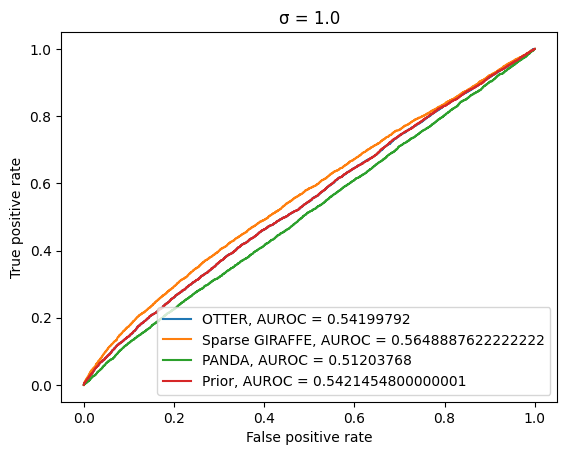

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3914
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.533593 -0.540576  0.495188  1.076248 -0.590486 -1.825598 -0.933243   
1   -0.205366 -2.088017  1.730332  0.306140 -1.186427  3.453406 -0.444079   
2   -0.658857 -1.109883 -2.745445  0.942456 -4.358320 -2.154105 -2.651668   
3    0.188746 -2.629867  5.437169 -1.073045 -1.290613 -0.425337  2.358847   
4    1.412501  0.106895 -0.911371 -0.166526  0.633460 -0.609320  0.930747   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.430388  0.613023  3.497969  0.221865  1.684511  1.473195 -0.198085   
496 -3.395581  1.752571  2.613442 -2.038609 -1.271849 -1.234700  0.501832   
497

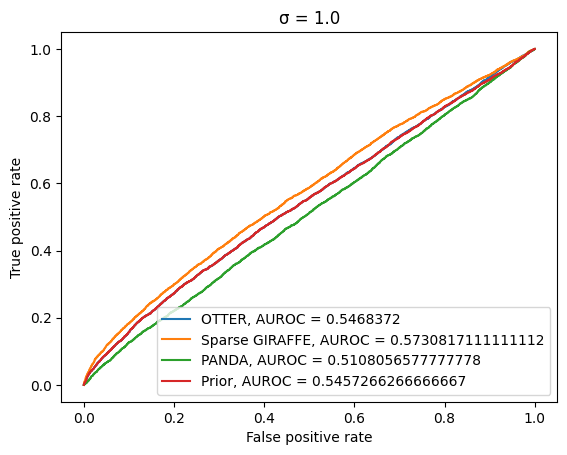

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3900
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.029652  0.408784  0.716597  0.339176 -0.048432 -1.196614 -0.978380   
1   -0.243994  1.257660  0.250900  0.452747  0.351523 -1.552830 -1.370785   
2   -0.519536  0.930382  0.274213  0.002214 -1.360912  0.700249 -1.457229   
3   -0.420789 -0.104871 -3.061130 -0.756097  0.688388 -0.213241 -1.709981   
4   -1.434569  0.906604 -0.622925 -3.185526 -0.466591  0.801580 -1.920391   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.634558 -1.170062  1.794562  1.372996 -0.449597 -0.350997  1.485459   
496  0.389357 -0.028284  1.039531 -0.930366 -1.365681  1.018840 -1.350681   
497

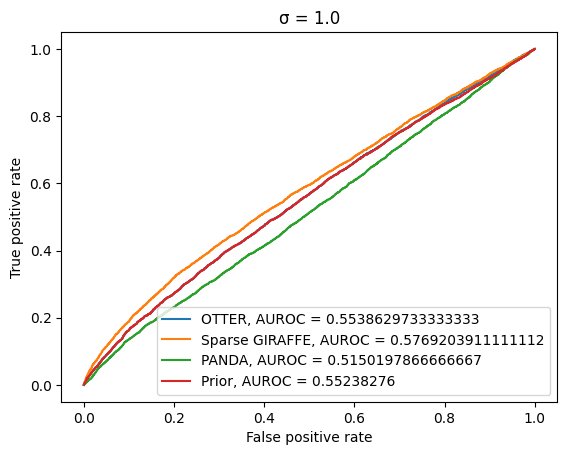

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3834
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.284214 -0.250787  1.597055 -0.467384 -1.313810  2.407729  1.278079   
1    1.252614 -1.304568  1.824591  1.768659  1.925886  3.855234  3.890324   
2   -3.111402  0.978220  0.039979 -3.101910 -1.517137  0.666597 -1.518598   
3    0.955049 -1.168623  0.608319  0.527292  0.098921 -1.333945 -0.069421   
4    0.000233 -0.418313  2.588637  3.669382 -2.356988  1.675336  0.984519   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.894250  0.601254 -0.973491  1.675806  0.370929  0.400706  0.797636   
496  2.453784 -0.886214 -2.694036 -0.519945  1.000879  1.036465 -1.176237   
497

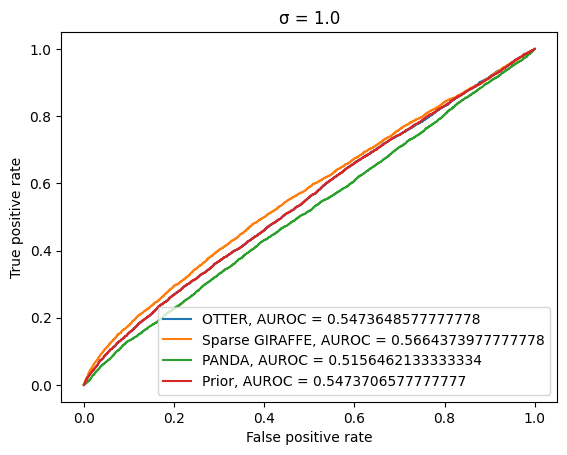

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3962
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.126274 -2.020636  4.570089 -0.686350  1.313386  3.782004  1.176960   
1   -0.950122  1.063148 -2.325300 -1.131352 -1.552915  1.368601 -0.967301   
2   -0.137669 -0.370369 -1.128532  0.908466  2.172806 -0.013910  1.562573   
3   -1.899123  3.733564 -2.937317 -1.410751  0.870266  0.806480  0.765096   
4    0.791181  0.039040 -0.352653  2.092937  0.996896 -0.838801  0.803255   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.252986  0.130869 -1.447755  1.696796 -1.828837  0.527528  0.319077   
496  1.582833 -0.896563  0.105612  2.371832 -1.421929 -1.861375  0.845944   
497

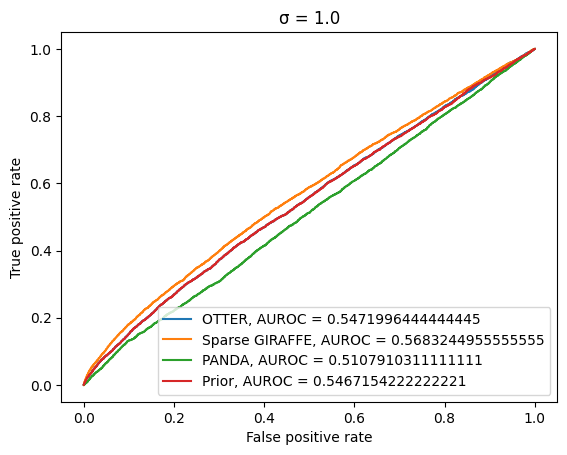

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3884
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.503954 -1.061582  6.035428 -0.405682  3.156658  3.222716  1.580375   
1   -1.975319  2.014453  0.756441  0.665671 -2.997095 -3.249799  1.453742   
2    0.285859 -2.024860 -0.238687 -2.178133 -1.473607  1.700313  1.037544   
3   -0.270813 -0.514051  0.529212  3.767244 -1.104146 -0.795209 -2.165767   
4    0.522146  1.301161 -1.089680  1.544284 -1.453083 -1.464817  1.003927   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.005247 -0.043182 -1.447120 -4.341797  0.313289 -0.492311 -2.279925   
496 -1.491604 -2.630559 -1.809043  1.437228  1.720628  1.397145  1.507650   
497

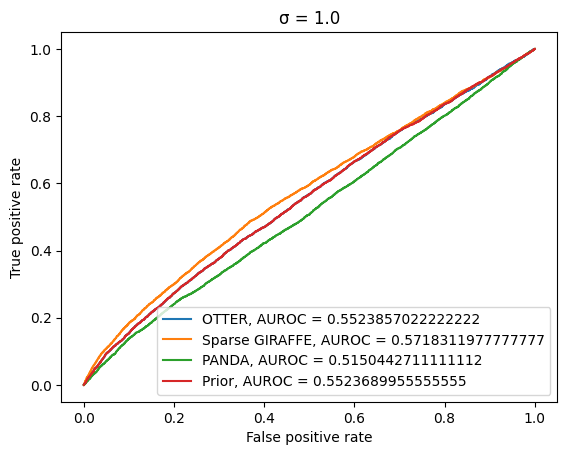

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3910
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.760605 -2.988189  1.690434  1.132559 -0.074825 -1.109933  1.944380   
1    0.088305 -1.049320  0.423604  1.556158 -2.785896 -1.674900  1.054252   
2    0.583071 -0.337767 -1.934547  0.483954  2.729605  1.249815  0.977551   
3    1.139305  0.760157  1.091737  0.527181 -1.045209 -1.252707 -2.893602   
4   -1.754210  0.235572  0.249393 -2.503307 -0.898294 -0.548476 -0.717948   
..        ...       ...       ...       ...       ...       ...       ...   
495 -4.013570  0.295107  3.773187 -0.542700  1.774093 -1.629182 -0.730906   
496  1.810083 -0.811826  1.004157 -1.348115  1.264816 -0.684466 -0.007261   
497

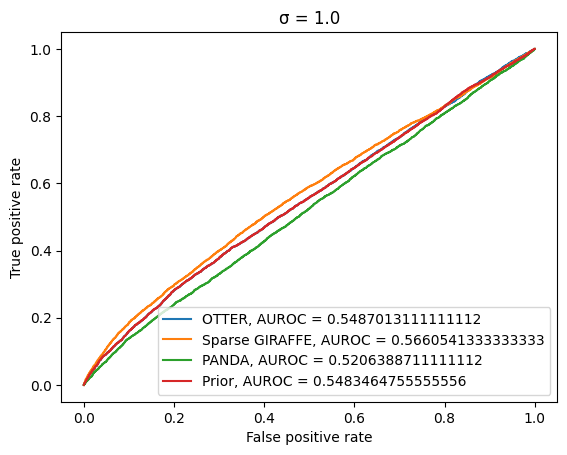

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3854
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.925797  2.551927  1.359861 -0.021166  1.773066 -0.444966  0.114791   
1    3.665280  3.497119  1.566968  0.128643  1.519796 -3.817533  1.576265   
2   -0.557405  0.533868  2.290243  3.132798  0.133626 -0.639536  1.086010   
3   -0.104720  4.948599 -1.019707 -1.293080 -1.507223 -2.720376  1.493633   
4    3.583452 -2.799978  0.158672 -0.924658 -3.421070  0.527969 -0.206335   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.234065  0.609531  1.068952 -0.649116 -0.348003 -1.515592  0.761392   
496  1.260442 -0.518760 -0.941191  1.077257 -2.293219 -0.871192 -1.487721   
497

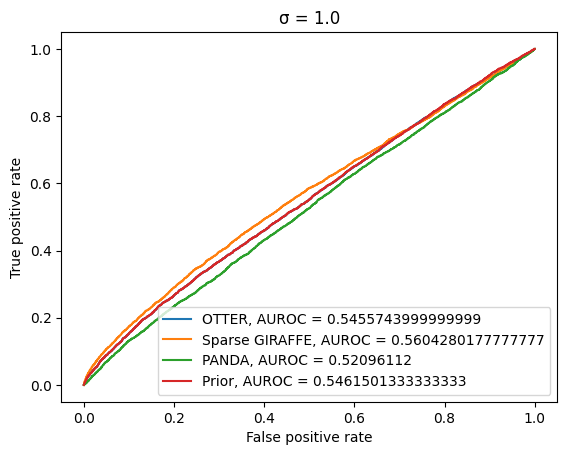

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3822
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.049229  3.097461  1.603680  0.567035  2.921874 -0.806403  1.006916   
1    1.226346  1.767126  0.055083 -1.269033 -1.704248 -0.908544  0.794231   
2    0.947900 -1.709917  4.679561  1.024060 -1.235018  1.507969  1.894235   
3    0.853805 -2.267811  1.207956 -1.502004 -0.247021 -0.269256 -1.091654   
4    3.572508  0.205946 -2.787771 -0.002782 -1.415979  1.103928  1.606887   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.189925 -0.967127 -0.288515 -2.415110 -0.119025  0.644709 -0.153585   
496 -1.807500 -0.558226 -1.354859 -1.715438 -0.205519 -0.585008 -0.167379   
497

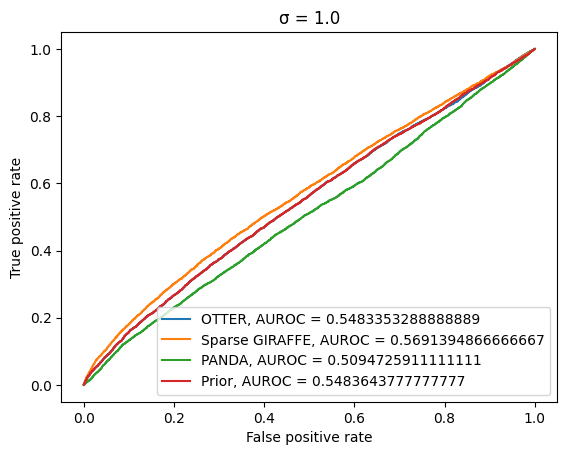

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3914
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.308018 -1.505409  0.891470  0.565831  0.888792 -0.118756  1.485004   
1   -1.607546 -0.407073  2.210668 -1.140246  1.583338  0.366046  2.121327   
2    0.893759 -2.101031 -1.536420 -2.707939 -0.710527 -0.494949 -4.417304   
3    1.897476  0.542057  0.835364  0.238668 -5.059749 -6.162330 -1.472575   
4   -0.391489 -0.018424 -1.479392 -1.520114 -2.941597 -1.559564 -3.005581   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.915274 -1.167855  0.803163  1.245601 -0.627616 -1.125456 -0.119709   
496  1.649615  1.885192 -1.627367 -0.404853 -0.830156 -2.431943 -0.499595   
497

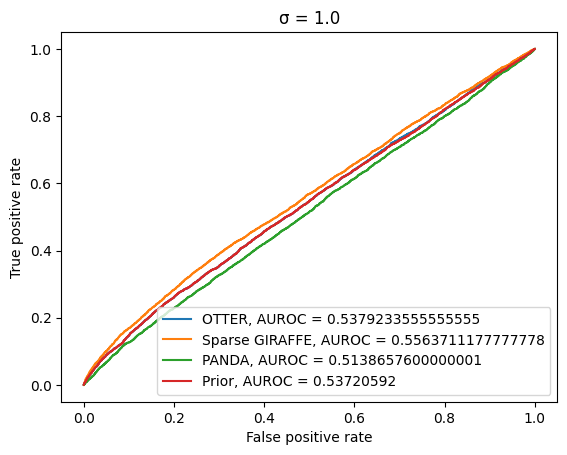

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3870
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    3.946748 -0.181465 -1.145207  0.854951 -0.807136  0.243413 -1.587956   
1    0.121536  0.684902  1.356585 -1.584438  0.700446  1.292995 -0.331278   
2    0.048326  1.564120 -2.604387  3.275684 -3.028874  2.758334 -0.209964   
3   -0.172337  1.168075 -0.522378 -2.275196  0.674933  0.662980 -1.905921   
4   -0.391746 -1.047416  2.045350 -0.934597  0.308494  0.273664  0.016831   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.852780  2.996160  2.161677  3.846593 -0.906259 -1.489953  3.691072   
496  0.052592  0.693892 -0.865587  1.216079 -0.668301 -1.174578  0.815982   
497

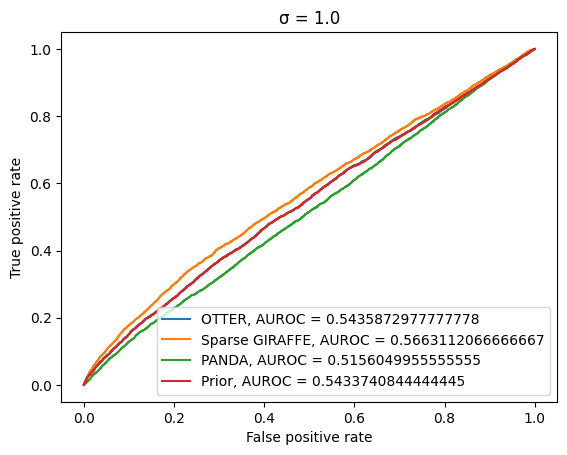

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3856
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.590029  1.533264 -1.226104  0.654496  0.138186 -2.065746  0.001447   
1   -2.891815 -0.089494 -2.576474 -0.307633  0.059979 -0.543117 -0.726942   
2    2.182948  0.566894  3.769280  2.233734  0.053459 -1.521040  2.687117   
3   -0.246797  0.654381  2.069233 -0.295199 -0.773982 -0.575226 -1.232906   
4    0.669016  0.519927 -1.631809  2.326495  1.373638  1.977831 -2.220643   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.573113 -1.241721 -0.506358 -3.571165  1.438400 -2.727520  3.734373   
496 -1.685003  0.174235 -1.655866 -1.564593 -1.358422 -0.025957 -3.285392   
497

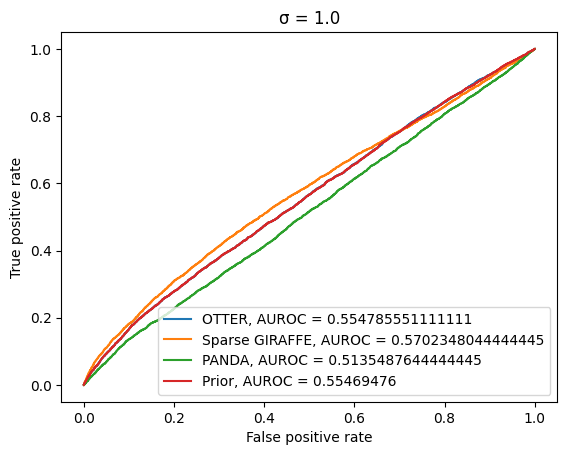

In [9]:
B = 50
noises = np.linspace(.05, 1, 10)
giraffe_scores = []
otter_scores = []
panda_scores = []
prior_scores = []
sign_scores = []
for noise in noises:
    giraffe_s = []
    otter_s = []
    panda_s = []
    prior_s = []
    sign_scores_new = []
    for i in range(B):
        score, sign_score = simulation(noise)
        otter_s.append(score[0])
        giraffe_s.append(score[1])
        panda_s.append(score[2])
        prior_s.append(score[3])
        sign_scores_new.append(sign_score)
    giraffe_scores.append(giraffe_s)
    otter_scores.append(otter_s)
    panda_scores.append(panda_s)
    prior_scores.append(prior_s)
    sign_scores.append(sign_scores_new)

### Table 5.1

In [14]:
giraffe_mean = []
giraffe_sd = []
for l in giraffe_scores:
    giraffe_mean.append(np.mean(l))
    giraffe_sd.append(np.std(l))
print(giraffe_mean)
print(giraffe_sd)

[0.9285025174222222, 0.8764291809777777, 0.812705606488889, 0.7490830685333333, 0.695658755022222, 0.6554014188444445, 0.6223795809777778, 0.5989880600888889, 0.5813960631111111, 0.5688124336888889]
[0.0021220583084612774, 0.0021624708229586406, 0.0023684702904549293, 0.0032530359162763864, 0.002453696064836981, 0.003021248611433839, 0.005371025546027459, 0.004013260783036454, 0.005477174848401469, 0.00564715927796887]


In [15]:
otter_mean = []
otter_sd = []
for l in otter_scores:
    otter_mean.append(np.mean(l))
    otter_sd.append(np.std(l))
print(otter_mean)
print(otter_sd)

[0.9562916529777777, 0.8698502977777778, 0.7884475802666667, 0.712941859911111, 0.6584646958222222, 0.6184322442666667, 0.5906884152888889, 0.5706959102222222, 0.558665808888889, 0.5479350538666666]
[0.0015107172647028687, 0.002588306408974539, 0.003332151692711133, 0.003028974016960847, 0.0030915047648719146, 0.004354330991536152, 0.004662748183692175, 0.004298693722238718, 0.004298435700000949, 0.00441483404001044]


In [17]:
panda_mean = []
panda_sd = []
for l in panda_scores:
    panda_mean.append(np.mean(l))
    panda_sd.append(np.std(l))
print(panda_mean)
print(panda_sd)

[0.6901941994666667, 0.6479440129777778, 0.6109884193777777, 0.5788409207111112, 0.5571403799111111, 0.5425287692444445, 0.532369880711111, 0.5251253299555556, 0.5205614983111111, 0.5156725610666666]
[0.004999154623698619, 0.0029772319502407, 0.0031858541253026425, 0.004124155909390127, 0.004211545034084346, 0.005419113129181707, 0.003996281464589883, 0.0038366145318616545, 0.005283509425385174, 0.003961826853231076]


In [18]:
prior_mean = []
prior_sd = []
for l in prior_scores:
    prior_mean.append(np.mean(l))
    prior_sd.append(np.std(l))
print(prior_mean)
print(prior_sd)

[0.9563606316444445, 0.8691556949333333, 0.7880172209777778, 0.7125077550222223, 0.6582246293333333, 0.6179650862222222, 0.5905411936, 0.570352093511111, 0.5582871310222223, 0.5476836008888888]
[0.0013549122745366085, 0.00258097646522134, 0.00331449074414988, 0.003120814065497654, 0.0030274261478350013, 0.004255501598744241, 0.004639542328858635, 0.00425705119326631, 0.004207491238775415, 0.0044036419633329245]


### Figure 5.1

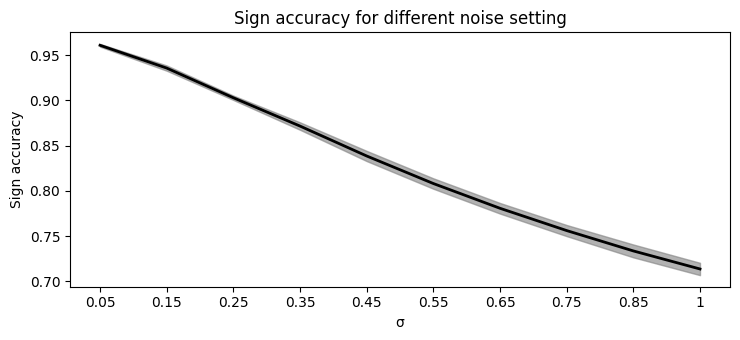

In [25]:
plt.rcParams["figure.figsize"] = [7.50, 3.50]
plt.rcParams["figure.autolayout"] = True

means = np.array([np.mean(l) for l in sign_scores])

plt.plot(means, color='black', lw=2)

plt.fill_between(range(len(means)), means + np.array([np.std(l) for l in sign_scores]), means - np.array([np.std(l) for l in sign_scores]), alpha=.6, color='gray')
plt.title("Sign accuracy for different noise setting")
plt.xlabel("\u03C3")
plt.xticks(range(len(means)), [.05, .15, .25, .35, .45, .55, .65, .75, .85, 1])
plt.ylabel("Sign accuracy")
plt.show()

## 5. Sparsity

We now investigate the ability of GIRAFFE to recover the active set of R. We compute the relevance of each edge 

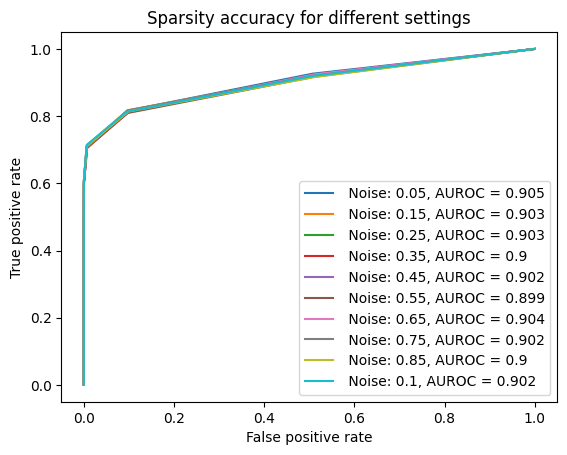

In [11]:
def sparsity_simulation(sparsity = .1, a = 1, noise = .01):
    R = generate_regulation(G, TF, .1, .1)
    ppi = generate_ppi(R.copy())
    motif = generate_motif(R, .01)
    expression = generate_expression(R.dot(R.T))
    B = 1000

    relevance = np.zeros((G, TF))
    lambdas_ = np.linspace(5e-8, 1e-4, B) # The limit values are regularization parameters that set R_hat to 0 or 1
    for l in lambdas_:
        par = giraffe.Giraffe(expression, motif, ppi, lam = [0.000001, 5, 50, 1, 1], regularization = l).get_regulation()
        par[par != 0] = 1
        relevance = relevance + par
    relevance = relevance / B
    R[R != 0] = 1
    fpr, tpr, _ = roc_curve(R.flatten(), relevance.flatten())
    auc_score = auc(fpr, tpr)
    plt.plot(fpr, tpr, label= " Noise: " + str(noise) + ", AUROC = " + str(round(auc_score, 3)))

noises = [.05, .15, .25, .35, .45, .55, .65, .75, .85, .1]

for noise in noises:
    sparsity_simulation(noise = noise)
plt.legend(loc='lower right')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title("Sparsity accuracy for different settings")
plt.show()

## 6. Appendix A.3

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.973349  5.221000  1.779856  3.483758 -4.952032 -1.373031  5.795595   
1   -0.501394 -3.007592 -0.795122  2.114940  0.970235 -1.372783  4.115389   
2   -0.760862 -1.396456 -0.626192  0.140637 -0.744820  0.806733 -1.115344   
3    2.029214 -0.967042  1.730316  0.197335 -3.266697 -4.483599 -1.192306   
4    1.090577 -0.114445 -1.419282 -1.838028  1.133647  0.242150  1.829874   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.761744  1.229011 -0.333654  3.068444 -6.554108  3.472894  3.114483   
496 -1.711867  3.286609  3.849779 -5.217838  2.671614  0.183993 -0.748057   
49

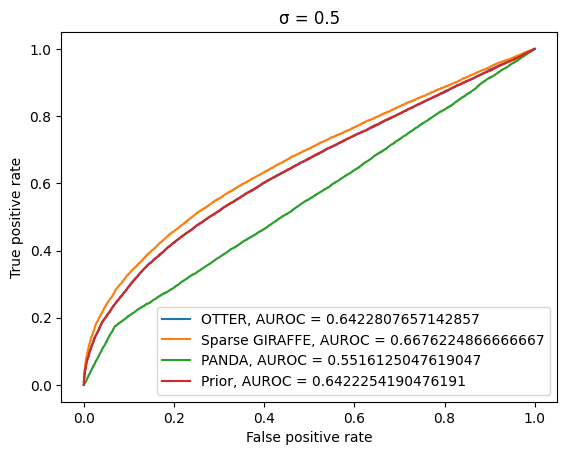

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.643749 -1.589176  0.380675  5.327721  0.608076  2.139811  2.712986   
1   -3.291773  1.433813  2.325693  2.693603 -0.929454 -0.066601  1.096981   
2    2.648292 -5.820011 -0.137282 -0.117418  1.210448  3.235401  0.948334   
3    1.750974  2.363300  5.120881  0.164176  3.164265 -0.496604  0.624220   
4   -4.345018 -0.885145 -2.580678  3.065554 -0.670253 -2.806162 -0.334083   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.560649 -0.152171 -2.017654  0.703648  6.666187  0.552628 -2.641766   
496 -2.315454  6.383537  6.442959 -0.004091  0.129310 -3.169028 -2.888656   
49

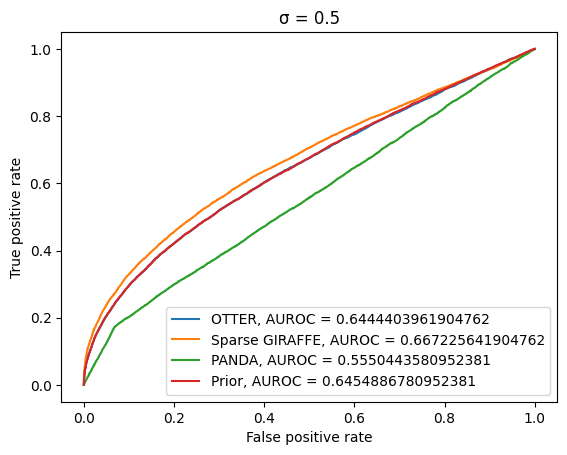

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1         2         3         4         5          6   \
0    2.360617  1.766326 -1.857502 -3.313679  0.194858  2.673768   0.580122   
1    0.660541  1.456881  0.454445 -2.814735  0.892950  0.775980 -10.388626   
2    4.419325  2.031325 -3.858230  4.134293  0.401172  1.740600  -2.500199   
3   -1.132484  1.737962 -1.016155 -0.763955 -0.568500 -1.794983   0.555585   
4    5.205422 -0.990602  1.190074 -1.831411 -3.370047 -0.645950  -1.147405   
..        ...       ...       ...       ...       ...       ...        ...   
495 -1.679276 -2.116780  4.656067  0.142591 -2.662526 -6.189041  -0.507204   
496 -8.261505 -1.414491 -1.203068 -0.700417  1.045620  4.277574  -5.388

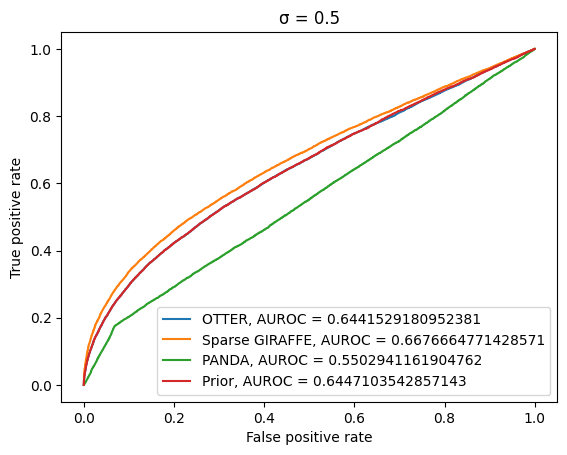

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    0.191469  4.147702  1.258358 -5.073882 -4.912595  1.815049  2.799986   
1    4.442866 -2.052139 -7.419699 -0.531778 -1.380095  5.664961 -6.499611   
2   -1.461648 -3.309098 -0.446674 -0.956963  3.579565  0.788768  0.861173   
3    0.620291 -4.092891 -0.190914  1.125566 -1.969372 -3.045542  2.728415   
4    1.125879  1.009038  2.599300 -4.037318  3.441054 -5.543954 -4.619398   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.145704  1.132110 -2.376698 -0.330744 -0.748471 -1.028116 -0.261561   
496 -1.933280 -1.438018 -3.960460 -0.100531 -0.139899  2.108953  3.542371   
49

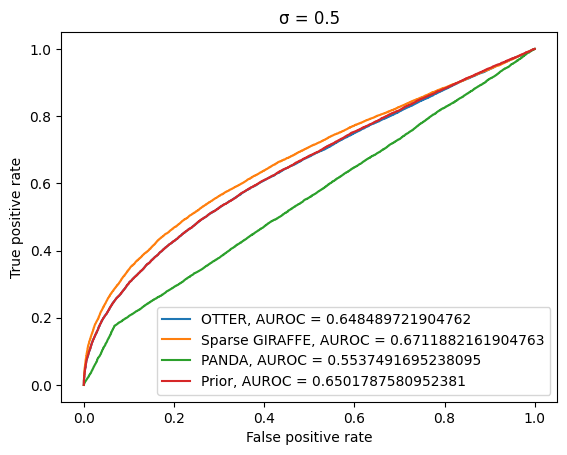

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.584587  1.889434  1.036571  1.849309  2.265149  3.678507  0.704052   
1   -0.530025  5.371737  1.979403 -2.485088 -2.151963 -7.058254 -3.814946   
2   -1.506966  1.604566 -0.116968  0.912462 -3.578265 -1.457098 -6.394886   
3   -3.224119 -0.314793 -2.323917  3.052949  3.237685 -5.124933  2.370560   
4   -2.145295  1.908689  5.007973 -4.423116 -2.128226 -9.217779  2.732338   
..        ...       ...       ...       ...       ...       ...       ...   
495  2.948542 -0.250649  0.549101  0.338790  0.460961  5.263559 -0.371387   
496 -2.799808 -6.672929 -0.017277  1.583314  1.065909  3.249359  0.348397   
49

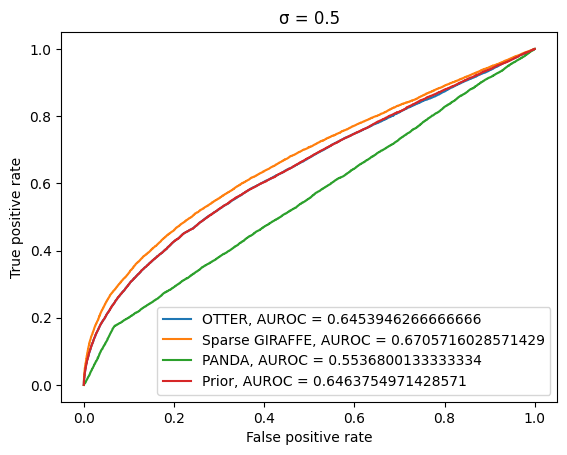

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3          4         5         6   \
0    3.054408  1.223737  0.130140  4.034676  -2.512226 -3.706653 -5.361638   
1    1.562414  4.676184  2.950176  2.303881  -2.125310 -3.357327  2.334176   
2   -3.020830  3.017101 -4.797774  4.417300 -11.477832 -0.571201  6.386196   
3   -3.432540 -4.817278 -1.830392 -0.409264  -1.133874  5.426581  1.006717   
4   -0.513127 -2.765681  1.217969 -6.867667  -3.752268  0.784863 -0.401171   
..        ...       ...       ...       ...        ...       ...       ...   
495 -0.614610 -1.692503 -3.442759  4.514660  -4.521883  2.888185 -1.930113   
496  2.054301  3.929337  5.513720 -0.976660   2.494328 -4.878501 -7.724

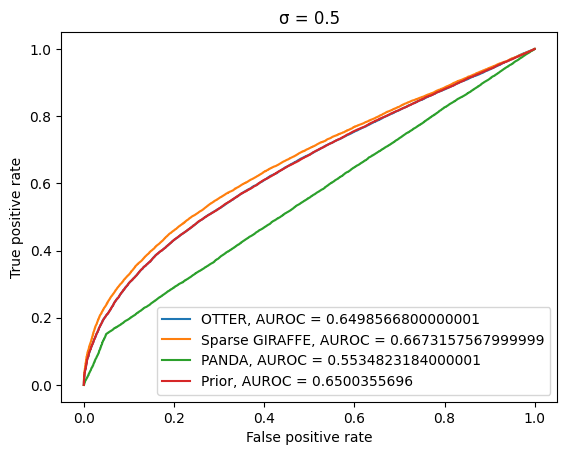

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.947628  4.111933 -1.639800 -0.934048  1.014578  3.046162  3.002858   
1   -4.285265 -0.080536 -1.611342  0.993864 -3.286866 -0.583114 -1.244151   
2   -1.504418  4.018643  3.365377  3.740937 -4.513616 -4.554425 -1.506473   
3   -4.735980 -6.799846 -4.505873  1.082099  0.735092 -0.494614  0.792619   
4    0.864385 -2.798341 -0.807995  5.114078  0.012972  9.177120  0.172275   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.107151 -4.083891 -7.182042  0.610576  2.454492 -2.612472 -1.138046   
496 -6.487221  2.230038 -1.368364 -1.305809  0.351261  2.151230  7.788433   
49

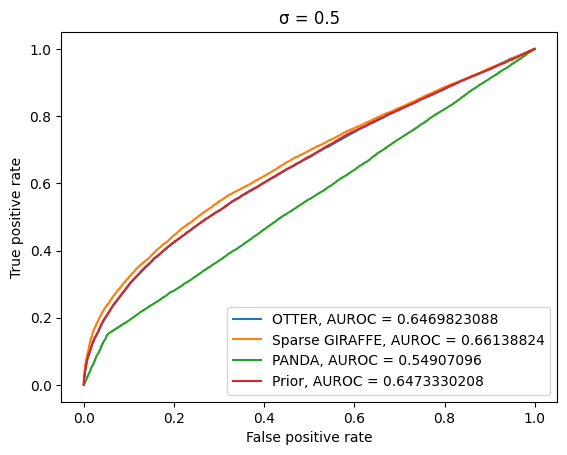

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0          1         2         3         4         5         6   \
0   -1.337854  -5.975051  4.664013 -1.719554  4.567403 -0.466951  0.402455   
1   -0.351360   2.890010  3.089099 -2.513024  2.321780 -1.309844  5.858121   
2    5.443747 -10.354812 -5.070562 -5.894782  1.259613  0.384830 -3.479506   
3    1.514240  -3.176515  2.526382  5.516525 -1.719747 -5.732472 -0.789599   
4    1.351162  -0.066474  2.335377  0.030548  0.125014 -2.322003 -4.370874   
..        ...        ...       ...       ...       ...       ...       ...   
495 -0.740697  -5.438706 -4.563535 -4.144229 -8.299791  9.575393  2.387751   
496 -1.674059   1.855384 -2.304935  0.134455  3.035255 -6.232612 -2.178

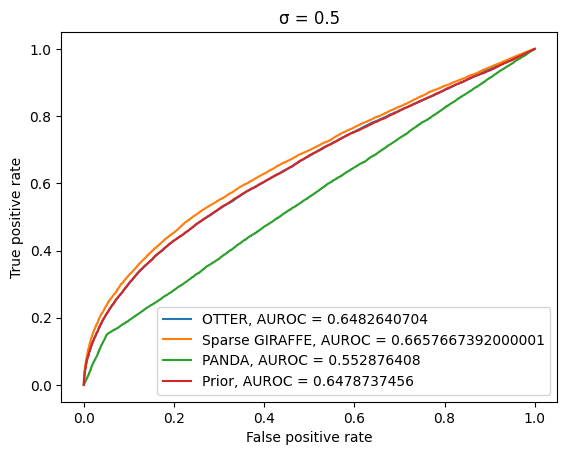

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1         2         3         4          5         6   \
0   -1.766354  1.930172 -0.765872  1.075245 -0.866002  -0.542915  4.118559   
1   -4.713827 -3.585097  4.228581  1.568503 -2.372186 -11.392803 -7.064625   
2   -0.154096 -6.245502  0.016023  3.937356 -1.195007   1.853100  0.236328   
3    0.105011  4.119010 -1.570548 -3.561546 -0.650385   3.258836  0.142555   
4    3.147504 -6.544251 -1.579622  6.139562 -3.802256   5.150036  5.789401   
..        ...       ...       ...       ...       ...        ...       ...   
495 -5.460305 -1.701404  3.825234 -4.611903  5.415339   0.440314  0.905922   
496 -2.116424 -2.349670 -5.779853 -4.741312  1.689616   0.785573 -2.377

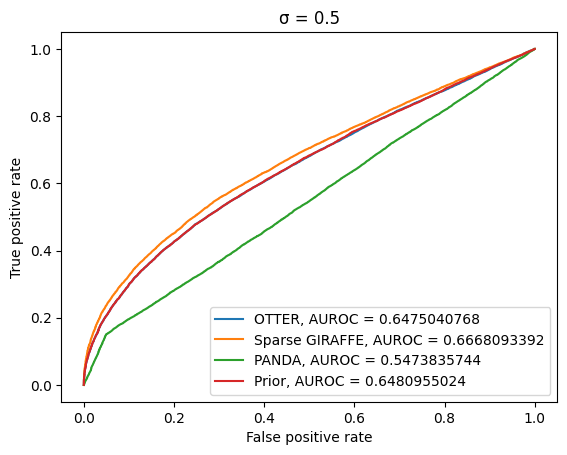

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1          2         3         4         5         6   \
0    7.282096  3.125825  -1.051888  4.143463  3.025080 -8.428966 -2.386517   
1    2.875527  5.717464   9.262663 -3.099767  0.225915  3.652419 -7.174928   
2    1.613023  3.471968  -1.909544 -0.515463  6.386218 -8.923704 -8.200764   
3    0.041206 -0.197208  -1.830422  6.146667  5.031252  5.273523  6.648156   
4   -3.229526 -5.252509  -3.468472  4.456773 -2.348489 -1.653394  5.587467   
..        ...       ...        ...       ...       ...       ...       ...   
495  0.894785 -6.990593  -1.322579 -3.896233  4.491237 -0.661514  0.054472   
496  4.830014 -5.172532  -2.340356  6.616740 -1.550251  3.465378  0.921

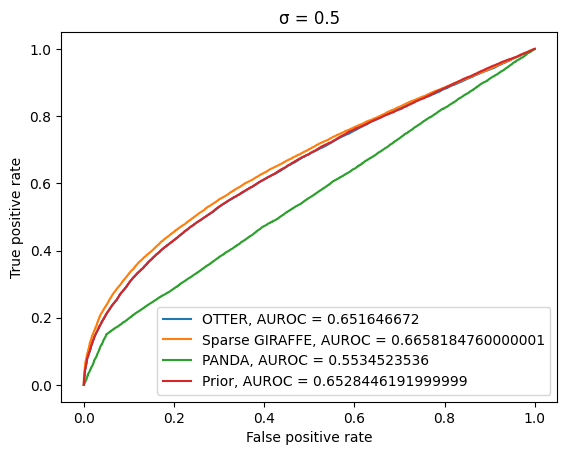

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0          1         2         3         4          5         6   \
0   -4.439025   6.827939  4.706905  0.589032  2.257937  -5.639824  4.407584   
1    0.725663  -4.506682  2.653549 -1.401632 -1.888536  -4.217842  0.818144   
2   -0.902962   4.613886  5.708928  4.112956  4.171211   6.321172 -4.404643   
3    0.364820  -6.665644  3.004305 -2.457505  9.015883 -11.547854  2.827096   
4   -6.218985  -3.567018  7.548088  3.527832 -8.366146  -0.213452  0.686856   
..        ...        ...       ...       ...       ...        ...       ...   
495  2.529314   1.963949 -0.549114 -7.320521  4.393236  -0.290045  6.541810   
496  4.871727   0.463413  2.420723 -1.655914  0.957134 -11.8974

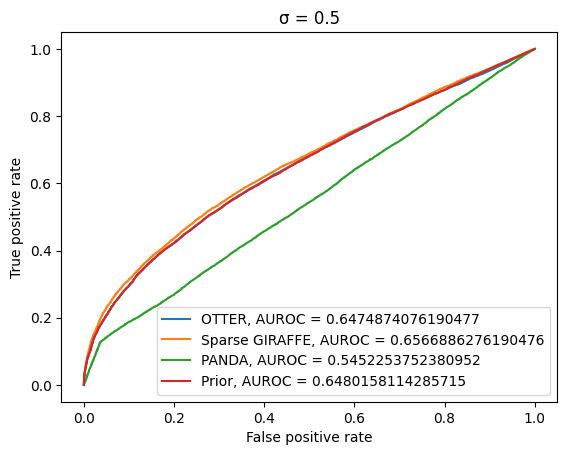

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1         2          3         4         5         6   \
0    6.694270  0.561479 -3.548629  -2.310285  1.372482  0.661408  3.584533   
1    5.775286 -2.143339 -0.655546  -2.806365  2.536940 -4.680876  7.562551   
2    1.255664 -0.331439  0.220165  -3.657029  1.136437 -2.665770  3.520327   
3    7.296564  5.012337 -0.222722  -4.786248 -4.936411 -1.695277  5.673036   
4    5.648703 -4.098230 -3.358762   0.552192  6.792883  3.376637  1.729935   
..        ...       ...       ...        ...       ...       ...       ...   
495  1.467610 -3.786819 -0.740567  11.490489  4.103054 -4.158168 -0.995153   
496 -4.319835  2.035042 -1.605728  -3.343101  1.241970  2.083867  6.275

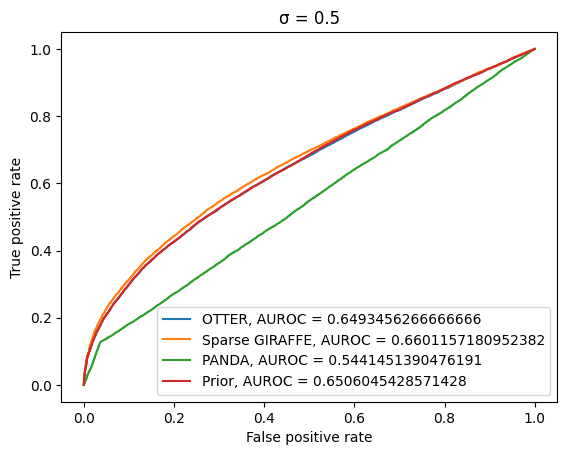

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1          2         3         4          5          6   \
0    6.274732 -0.598298  -3.385848  2.469179 -6.901325   7.537430   1.943086   
1   -1.434266 -6.746440 -11.485906  1.436725 -1.284382   3.590073 -10.065243   
2    2.322305 -0.511992  -2.712265  5.314887 -4.339485   2.145169   1.606742   
3    1.534073 -5.251629   6.792462  7.349250  5.246585  -7.748631  -4.786832   
4   -7.715379  1.806122  -9.324650 -4.381164 -1.701260   5.424801   1.852621   
..        ...       ...        ...       ...       ...        ...        ...   
495 -0.190682 -0.739378  -2.753901  9.451086  2.032532  10.106997  -3.637566   
496 -0.364496 -0.272292   5.430746  1.345351 -7.980710 

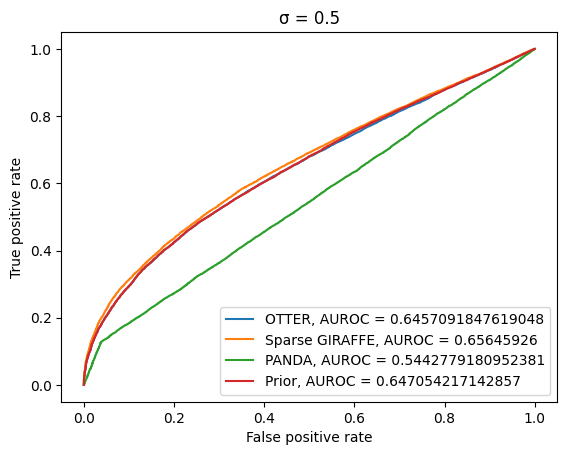

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2          3         4         5          6   \
0    0.514578  2.406482  8.044645   5.522615 -2.211288 -7.899467  -5.100780   
1    0.897285 -1.294664  3.869082   1.564599  2.806157 -4.684361  -0.603425   
2    3.658374  9.067892  0.261629  -8.169879  1.927584  6.335775  11.903078   
3    1.312919 -0.243196 -2.354346   3.700016  2.981066  5.228250  -3.052319   
4    3.759828 -2.245743 -2.666149   2.384844  2.036397  0.934610   0.768566   
..        ...       ...       ...        ...       ...       ...        ...   
495  5.100914 -5.922506 -8.043807   2.501209  7.144440  7.438396  -9.606932   
496  3.678309  2.644662  1.251292   2.853899  2.448446 -2.00896

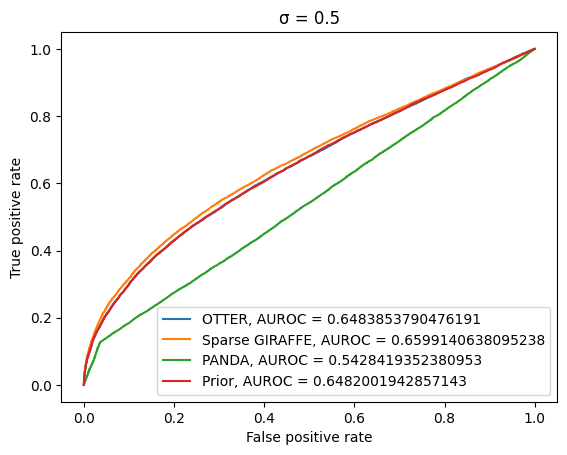

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt            0         1          2         3          4          5         6   \
0   -9.050142  0.778354  -2.184066 -0.783633  -7.608625  -2.231200  4.208954   
1   -0.135038 -5.057267   4.718327  8.572613  -6.767754   0.134838 -1.565864   
2    1.124092  5.929711   9.080812 -2.710727   0.379381   2.302666  9.964033   
3   -0.226556  0.865679  -2.299422 -5.301098   0.784522  -1.990857  1.327567   
4    1.795657  0.247078 -13.584076 -4.906344  -6.393548   1.398485  3.381101   
..        ...       ...        ...       ...        ...        ...       ...   
495  1.186551  3.686724  -2.656274  2.906849   3.285147 -10.004289  9.755476   
496 -7.771900 -0.949075   0.316496 -4.187120   2.200789

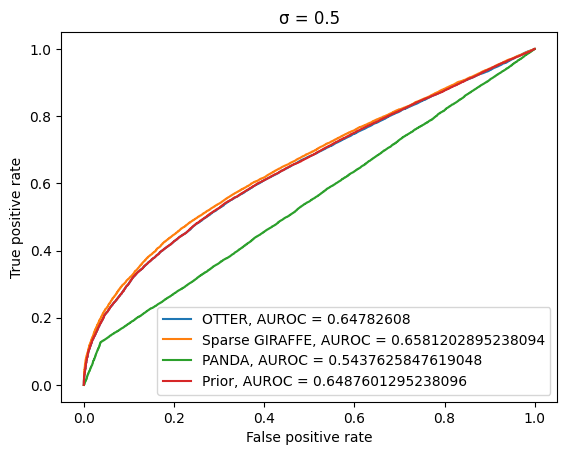

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt             0         1          2         3         4         5         6   \
0    10.834978 -1.994878 -10.785619  3.961581 -0.063907  8.305797 -2.580106   
1     0.415511 -3.395039   3.674406 -1.221636  0.726205 -5.968987  7.631462   
2    -1.350321  2.585045   3.675547 -9.381184 -1.619296 -8.199993 -0.623706   
3     0.042389 -9.328269   1.165850 -2.619855  6.129141  2.650634  2.385747   
4   -11.718633 -1.804371   0.349144 -3.361466 -0.216199  1.070186 -8.892446   
..         ...       ...        ...       ...       ...       ...       ...   
495  -5.199371  4.918983   8.719099 -5.665025  4.404972 -1.712934 -1.605460   
496  -4.392416 -2.369993  -3.104788 -1.656945  5.700264 -8.5792

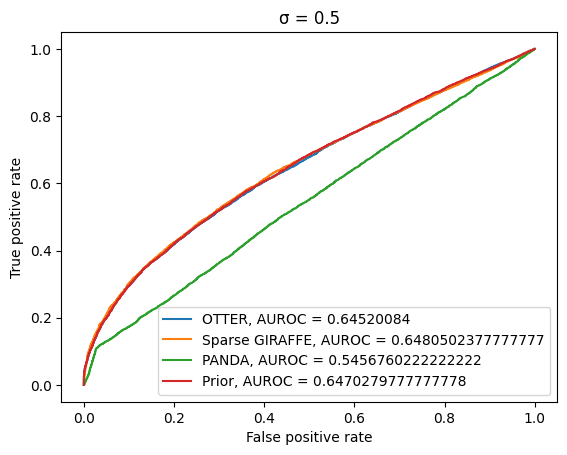

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0         1          2         3          4          5   \
0    13.430993 -5.859373 -10.656333  4.396308  -6.153638 -11.073842   
1    -5.523804  0.330060  10.703593 -9.305498 -12.516645  -4.554175   
2    -8.367515  4.340639   3.669462 -3.425183  -8.443776   4.677557   
3    -1.438378  0.356352 -13.422368 -1.644645   7.347224   7.601321   
4    -1.270987 -0.407476   6.924938 -0.816104  -2.711873  -3.686007   
..         ...       ...        ...       ...        ...        ...   
495   2.788930 -6.808189  -2.264373  2.276861   2.185476  -3.053878   
496  -5.674893 -2.208003 -10.018151 -8.533562   1.019073  -1.307642   
497  -3.160133 -7.943611  -0.169568  5.293099   1.937119

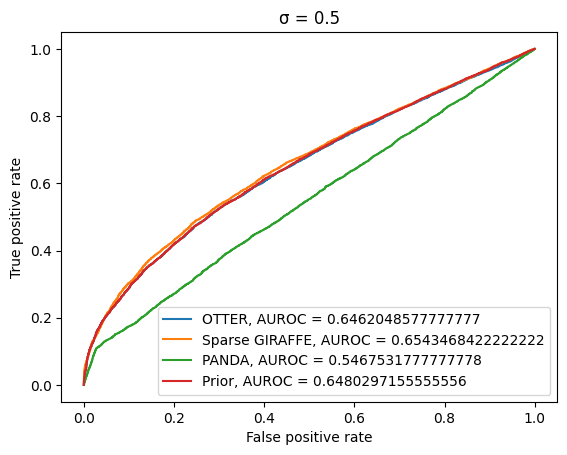

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.02 sec.
union tmp/motif.txt             0          1          2          3         4          5   \
0    -1.057959  -0.628579  -4.236287   4.110401 -9.768992   5.813924   
1    -5.155821  -5.268566  -0.698236  -4.653510  8.365882   8.131159   
2    -8.378890  -5.824430   0.382916  -1.564533 -0.624147  -7.329788   
3    -2.632578   4.483230  -6.324627  -5.728966 -1.353537  -2.409778   
4     4.056166  -2.187222  -1.628868   2.847827 -0.078573  10.815444   
..         ...        ...        ...        ...       ...        ...   
495  -0.412180   3.079792   2.085040 -12.371151  2.498751   9.711454   
496  -0.816810  -5.136780   1.126841   1.666783 -3.304830  -1.678364   
497  18.661909  -0.174090   2.531980  -3.894084

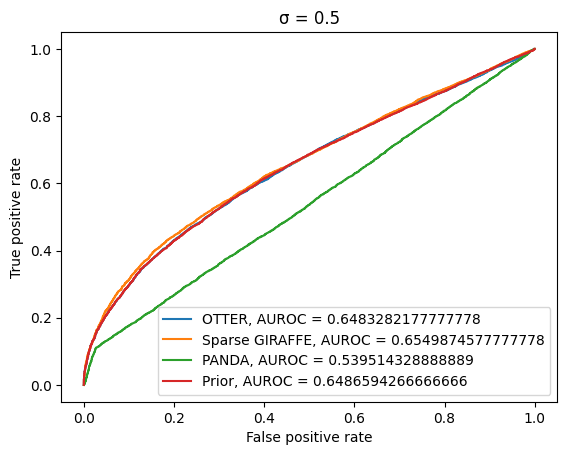

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0          1         2         3          4          5         6   \
0    -3.527238  -1.028137 -8.812259 -5.185126   0.183934   3.196234  2.111059   
1    -6.703827   6.651181  1.340480 -5.435544   2.184894  -6.329067 -3.619270   
2    -4.886378  -2.404539 -6.172730  8.093708  -5.848433  -6.250900  3.888099   
3     4.306674   3.106199  5.934445  2.365452 -10.416701  12.894474  4.395972   
4    -1.804546   2.853369  3.342398  2.099895   1.064160   7.568106  3.515941   
..         ...        ...       ...       ...        ...        ...       ...   
495   8.890287   8.734063 -8.184739  0.726646  -6.534077  -0.248783 -1.738004   
496 -22.759101  -0.535683 -5.207981  1.783221  

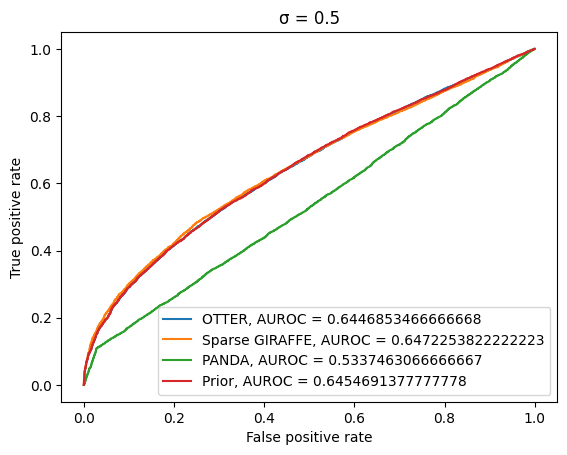

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 10000
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0          1         2          3          4          5   \
0     1.288719  -5.869979 -3.829667   2.966287   3.490466   1.691511   
1     0.263756   3.505878  0.282053  -1.347905   1.808496  -1.613650   
2    -7.732859   2.121675 -1.195944  -9.311788  -4.877149  -8.563810   
3   -15.667853   2.885465  8.116972  -3.422225  10.305177  -6.477791   
4     0.349001  -1.257889  0.940343  -4.136381  -2.013989 -13.201742   
..         ...        ...       ...        ...        ...        ...   
495  -4.215614   0.051261  0.716664   1.899841  -7.970734  -7.205474   
496   3.303454   5.674452 -1.527116  -5.510491  -3.885743  -3.193422   
497   0.304167   7.410676  0.232291  11.165835 

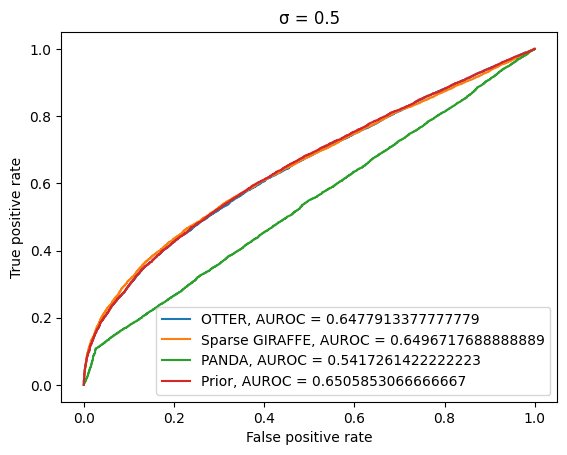

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3884
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.334637 -1.528106  1.755854  0.530363 -1.474949  1.149873  1.957613   
1   -1.600771  0.182442  0.686204 -0.103816 -0.492866  0.713825  0.466813   
2   -0.184168  2.374968 -5.183696 -1.771152  1.057785 -1.077571 -2.986338   
3   -0.231382 -0.610367 -0.410858 -4.459334 -3.520896  3.690257 -0.886944   
4   -1.230908  1.144981 -0.568363 -1.190775  2.031391 -0.898674  1.289776   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.415009 -0.094290  1.673637 -1.001609  1.823261 -0.472651 -0.554738   
496  1.063003 -2.149517 -0.061335  1.106932 -1.639498  1.439514  2.727091   
497

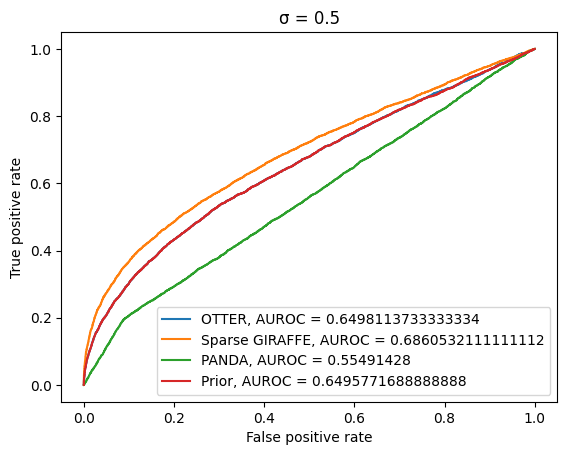

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3740
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -3.218858 -0.071146 -0.953784  0.152049 -1.164104  1.696255 -0.368427   
1   -0.128462  3.398269 -0.216180  0.040864 -2.074801  2.192885 -0.634519   
2   -1.984687 -2.529063  0.135745  0.811083 -0.889085  2.945493 -2.220655   
3   -0.739300 -2.497946 -0.640035 -1.354686  0.842244  2.200613  1.461960   
4    1.375213 -0.033316 -0.413480  0.730512 -0.309163 -0.773445  4.527038   
..        ...       ...       ...       ...       ...       ...       ...   
495 -1.445683 -0.051086  0.912975  0.214387 -1.258014  0.351001  2.748206   
496 -1.707482  2.395524 -1.818863 -2.689537  0.317413 -0.567793 -2.867458   
497

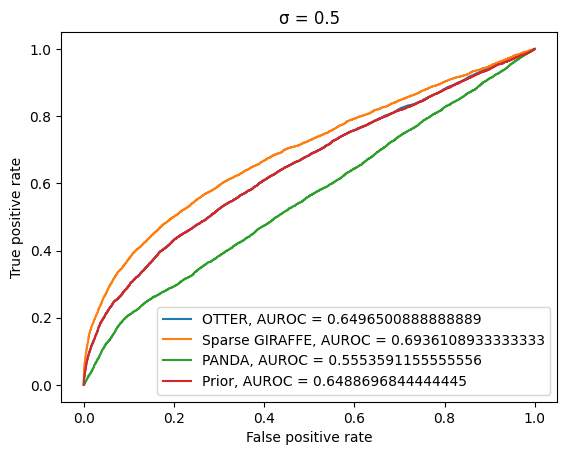

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3832
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -1.716469  0.437101 -1.175554  4.020707  0.795339  1.830434  0.347635   
1    0.686212 -2.181928  0.847538 -0.502500  0.039362  1.004478 -0.989332   
2    1.698914 -2.147575  0.115789  1.193435  1.040471 -0.743503  2.590289   
3   -4.454697  1.163097  0.573929 -2.289235  1.264741  1.397999 -0.601534   
4   -1.622610 -1.709466 -3.207642  1.619424  0.934354 -0.903451  4.173909   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.489802  0.544230  1.535858 -1.032182 -0.954149 -2.565079 -1.138385   
496 -3.684306 -0.922772  3.346332  1.943073  1.019841  1.861965 -1.408021   
497

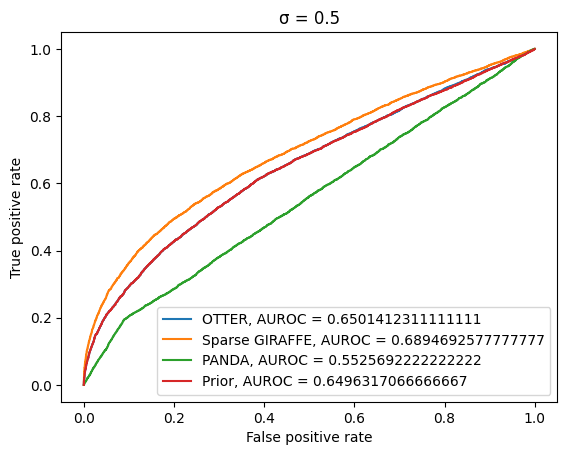

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3910
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.714005  1.281446  0.901762 -1.049660 -1.579782 -1.569711 -3.233829   
1   -2.079812  0.769668 -1.504750 -1.011488 -1.119903  0.537253  2.974008   
2    0.340202 -0.376061 -0.290610  0.385002 -0.886375  0.530091 -1.415857   
3    0.250967  3.246751  0.217161 -0.031870  0.027264  1.588255  2.727707   
4    1.122974  0.336083 -2.732849  0.621905 -0.154703 -0.499129 -0.972995   
..        ...       ...       ...       ...       ...       ...       ...   
495  0.696618 -0.724998 -0.063751  1.644305 -0.555281 -0.108897  1.559804   
496 -0.683761 -2.244900  0.969277  0.308292 -1.594266  3.671100  1.464296   
497

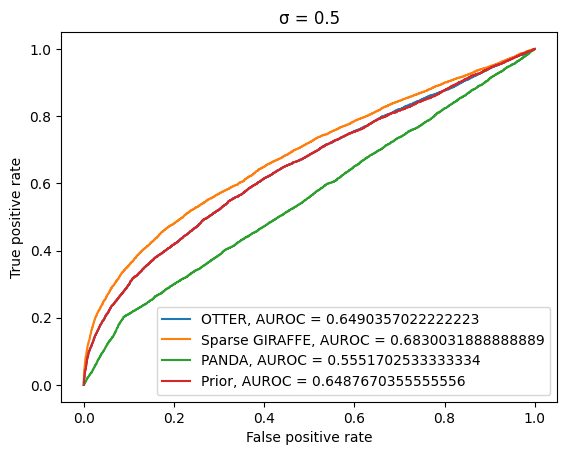

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3854
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.659779  0.197273  4.817018 -1.254676  4.013377  0.687334 -0.155796   
1    1.209012  1.262415 -4.951938 -2.134672  0.087313 -0.851490  0.001955   
2   -1.031281 -0.446866 -2.626953 -0.668384 -0.498480  3.067740  0.434790   
3    2.102637 -0.607375  0.809306  0.114556  0.521766 -0.695808 -0.560246   
4    1.404433  0.579314  1.448388 -0.233267  3.647279  0.124841  0.191665   
..        ...       ...       ...       ...       ...       ...       ...   
495 -0.084218 -1.589778 -0.551769  3.349181 -1.046492 -2.253287 -0.734363   
496  2.647992 -2.758626  0.749449  2.757538  1.238482 -3.007139  0.792670   
497

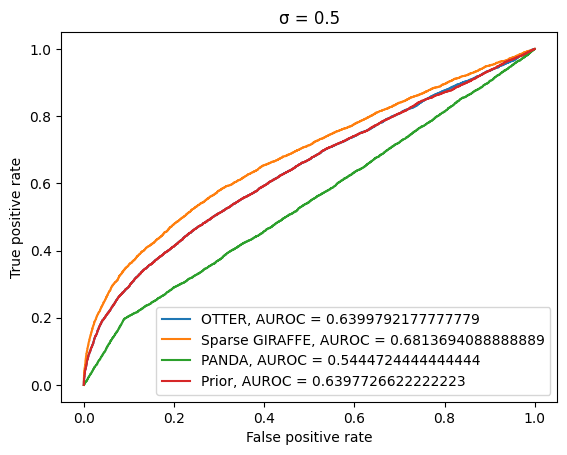

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3872
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0    1.801445  3.092996  4.549582 -3.353865 -2.787358  1.762488 -2.577039   
1   -1.070754 -4.594244  1.686116 -0.613362  1.519035  0.712031  0.345219   
2   -5.717095  1.485536  0.533105 -4.908096  3.964164  2.222066 -2.055737   
3    1.184638  1.560236  0.966876 -2.254881 -3.904604 -5.947673 -4.386894   
4    5.059515 -1.222552 -4.222419 -3.562236  2.023356  4.790118 -2.034889   
..        ...       ...       ...       ...       ...       ...       ...   
495 -5.260850  2.560496  0.071003  3.216804 -7.342374 -2.148525  1.036501   
496  0.258031  0.244234 -4.011383  2.332389  0.449160  2.578257  0.952153   
497

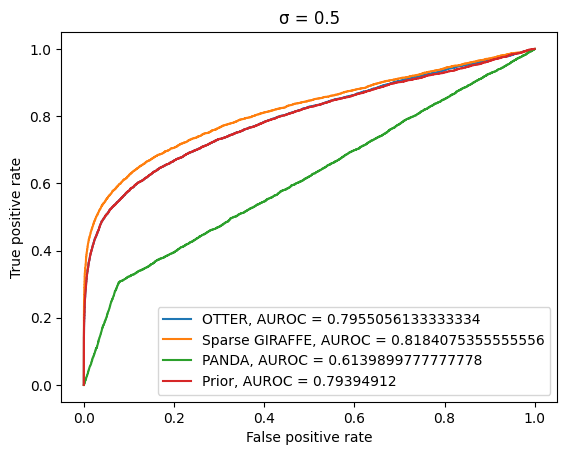

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3866
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -2.185913 -0.270684 -6.893598  3.675003 -1.768317 -2.777056 -4.274708   
1    2.707793  1.864637  6.190449 -1.438074 -7.074582 -1.771216 -5.541007   
2    9.313187  0.299922 -5.970655 -3.668376  0.823641 -4.050358  2.526796   
3    1.585947  0.840582  7.714737  5.567037 -2.980580 -2.303850  1.427349   
4    1.504324 -0.714708  6.046054  3.899545  1.868466 -1.099751  3.923114   
..        ...       ...       ...       ...       ...       ...       ...   
495 -4.976449  4.205616 -4.806797 -3.496120 -5.124484 -4.826033  0.420174   
496 -4.745899 -1.217741  0.271350  3.424911 -4.752315 -3.157967  1.938979   
497

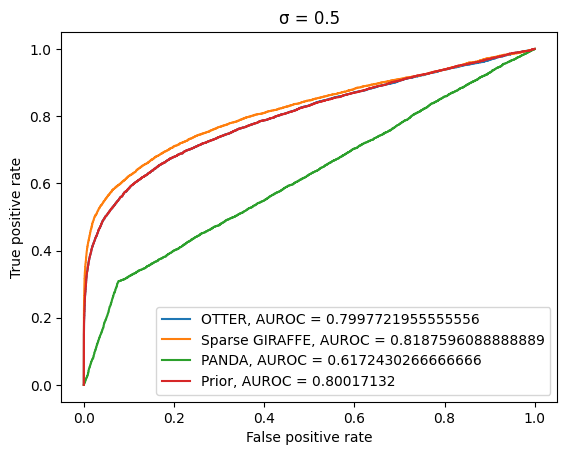

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3894
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3         4         5         6   \
0   -0.260181 -5.239372  0.535978 -2.147736 -0.674053  0.657214  1.427050   
1    4.627205 -0.288404 -8.792825 -4.727525  1.175378  0.655519  1.633069   
2   -5.420175  2.216884 -0.163612 -1.873768 -3.480827  1.747755 -0.259645   
3    4.448237 -0.891043  0.231885 -0.542940 -3.111093  0.477122 -5.250427   
4    0.929116  2.786006 -0.115157  0.197942  3.561070 -0.396663  3.092373   
..        ...       ...       ...       ...       ...       ...       ...   
495  1.258072 -0.504636 -3.633626 -0.498955 -1.460641 -2.511274 -0.446898   
496 -2.587729  1.414403 -1.065442 -3.279995 -3.996985  1.154850 -0.170428   
497

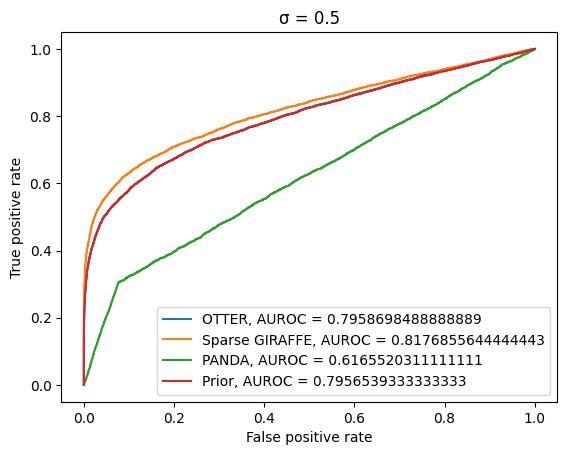

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3910
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2          3         4         5         6   \
0    2.521520 -1.567838 -1.191655   0.717550 -2.520633 -2.015173  1.272663   
1   -8.969455  4.812945  5.319906  -5.184575 -0.588799 -4.696190 -5.568124   
2    6.058769 -0.175596 -2.066389  -0.655818 -0.789818 -2.136949 -4.159240   
3    2.332991  1.128704  2.462383  -2.831592 -0.112718  2.207318  2.462376   
4   -1.331335  0.165042 -1.233700   1.440564 -1.818762 -1.513896  1.232972   
..        ...       ...       ...        ...       ...       ...       ...   
495  2.316016  0.948969  3.759553   2.862346  2.811361 -4.745319  2.762468   
496  1.565120 -2.741106 -1.791125  -9.386931  1.714049 -2.416725  2.8176

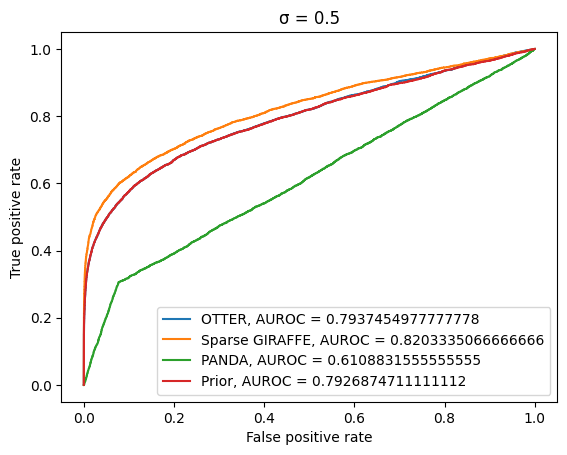

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3912
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2          3         4         5         6   \
0    2.969827 -2.552402  0.506143   1.950482 -2.817058 -0.741287 -0.489794   
1    1.797410  0.145274 -0.280497   1.767803 -1.649194 -1.339216  2.739741   
2    0.868859  0.832336 -1.006344  -2.497610  2.122012  1.505344 -3.723494   
3    2.053426 -0.523265 -4.007591  -3.287970  6.119066  0.248228 -1.561443   
4   -6.469470 -0.847681  8.093766   2.056198  2.251521 -0.131791  3.509863   
..        ...       ...       ...        ...       ...       ...       ...   
495  3.785061  1.305050 -1.729414   3.366887 -0.759213  2.659907  3.859159   
496  6.519907  0.952343 -0.223984   0.874123 -2.380132 -1.241897  0.7017

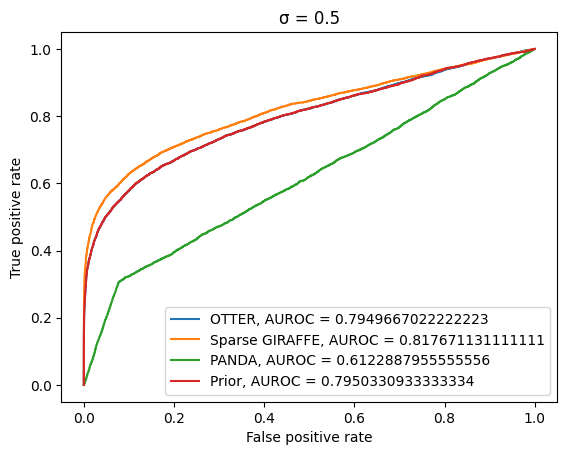

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4026
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0         1         2          3         4         5          6   \
0     4.315317 -5.286911 -2.602288   3.471689 -0.860185  4.440194   4.769233   
1     5.889572 -1.198026 -9.215293   0.251393 -5.197493  9.349730 -12.598030   
2    11.648665  7.089239  1.490674   4.931284 -0.317924 -6.179945  -0.175380   
3     3.284706 -0.555345 -0.455453  15.691753 -7.767603  4.579498  11.509647   
4     5.752105 -2.336530 -6.407769  -1.910184  7.689416 -5.284673  -3.227639   
..         ...       ...       ...        ...       ...       ...        ...   
495  -3.815938  1.221837 -1.181996   3.123192 -4.563519 -7.036604  -2.606012   
496   0.066190 -1.726897  6.050526  -7.347309  0.103002 

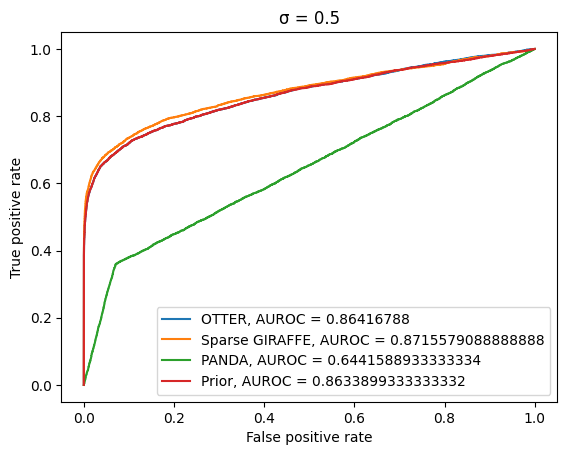

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 4014
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1         2         3          4          5          6   \
0    0.855024  0.033546  1.891816  1.170330  -2.061367  -3.476516  -2.288826   
1    0.118650 -1.881209 -9.472595  4.135375  -5.579971  16.125365 -10.209996   
2   -0.068768 -8.964957 -1.199178  3.018726  10.083685  10.032211   2.798750   
3    3.931066  0.376413  2.168399 -7.249324   3.417573  -3.195158   8.426196   
4   -5.737620 -1.326696  1.201912  5.834306   3.817479   5.512356   1.506810   
..        ...       ...       ...       ...        ...        ...        ...   
495  0.613370  1.634938  3.601305 -1.504166   0.381165  -3.765086  -1.606293   
496 -1.720532 -7.721961 -1.181624 -1.207240   3.849024  

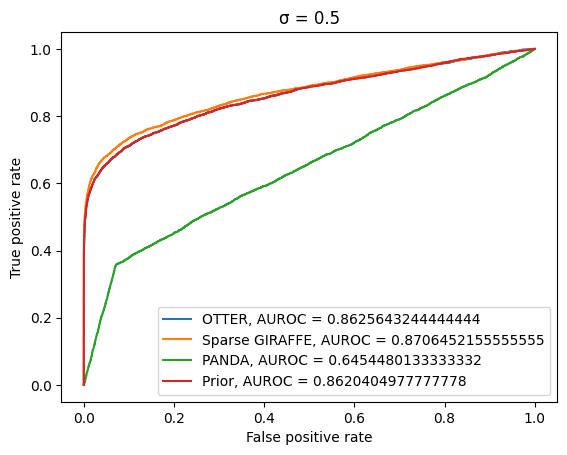

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3968
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0          1          2          3         4         5         6   \
0   -1.585523   6.376956  -8.041868   2.924699 -1.135300  0.907951  2.200409   
1   -0.490315  -3.595968 -12.875279  -0.838250  0.213760 -6.442272 -3.702277   
2   -2.026116   2.446167  -0.486727  -1.102079 -0.296724 -0.848175  0.916471   
3   -4.084388  -5.201301   1.518244   0.533002 -8.919404  0.905267  7.219445   
4   -0.027055  -3.166803   4.903127   0.127435 -1.335906  7.981287 -9.344207   
..        ...        ...        ...        ...       ...       ...       ...   
495  0.727906   0.665917   1.168586   1.692589 -1.233751  1.222238  3.432340   
496 -5.129589   0.531620  -5.428291  -5.558925  4.228371

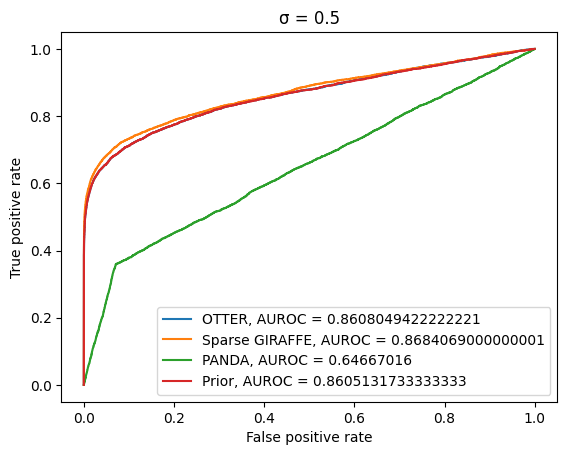

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3748
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0         1          2         3         4          5          6   \
0     3.372847  1.010738   0.077058  0.759917 -5.866991  -0.087418  -0.161397   
1    11.692458 -6.723433  -5.014928  4.232095  3.377401 -10.800382   8.820262   
2     8.151217 -0.122340  -7.151402 -3.982386  3.692488  -1.485680   1.273297   
3    11.541669  2.255171 -12.521330 -9.591465  3.803276  -1.208192  18.003395   
4    -1.353730 -1.438095   4.334393 -1.757698  9.277703  10.891382   4.405712   
..         ...       ...        ...       ...       ...        ...        ...   
495  -3.774120 -8.867247  -8.985463  2.338002  2.268638   2.069271   6.426979   
496   0.862375 -5.614465   6.841648  6.334236 -4

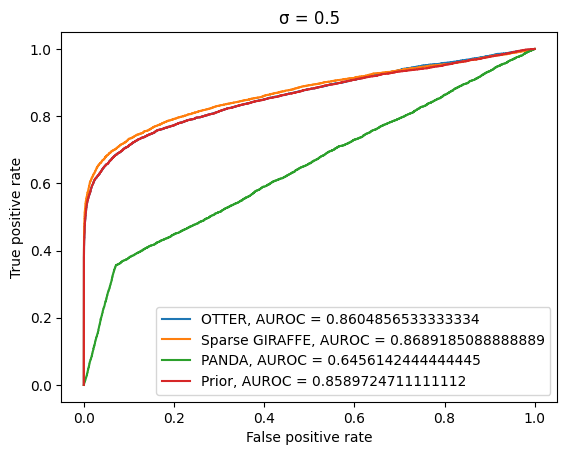

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3938
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt            0         1          2          3          4         5         6   \
0    6.207687 -6.610673  -1.454332  -6.703888  -0.814937  4.556739 -3.220812   
1    0.179861 -1.856069   1.963934  -4.731741  -2.826858 -2.169547 -4.785292   
2   -0.446750 -2.100260  13.557122   0.524672   1.030099  7.613641  0.749566   
3   -2.246548 -6.309087  -0.993662   1.975707   0.771771  1.296426 -1.167108   
4    1.795878 -2.613232   6.092095  -3.195578   1.763915  7.976946  0.567287   
..        ...       ...        ...        ...        ...       ...       ...   
495  6.690997  9.532808   9.080555  -5.416449   0.093039 -6.194460 -5.512755   
496  2.268852  2.889363   5.708530  -0.965140  -0.522007

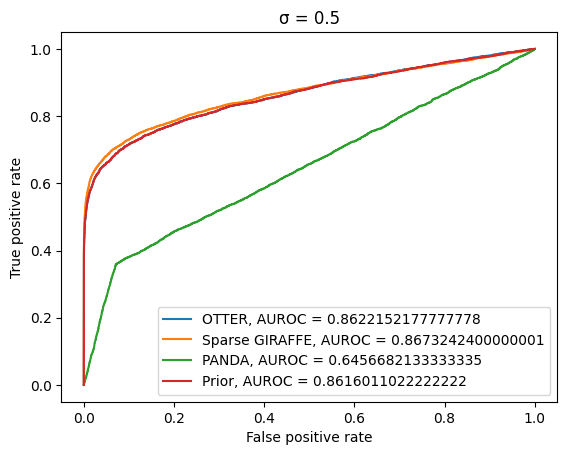

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3754
  Elapsed time: 0.01 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0     0.233241  -4.809921   8.227982  15.991933  -2.408766   8.726276   
1   -14.223843  -6.037629  13.900089  16.334898  -6.564906 -15.634099   
2    -4.524259 -15.381473   1.867338  -3.147765  -6.678081   5.098460   
3    -7.554760   3.801867  -2.185559  -2.376379  -7.276863  -0.854212   
4   -11.817366   6.798194  12.800098  11.773810  -2.215636  -7.357522   
..         ...        ...        ...        ...        ...        ...   
495   0.484240  -1.875266  13.424611   8.532659  -2.367040  -7.660270   
496   4.235579   3.204755  -1.130062   1.038865 -10.599456   7.029219   
497   6.489566   2.344855  -2.854473   

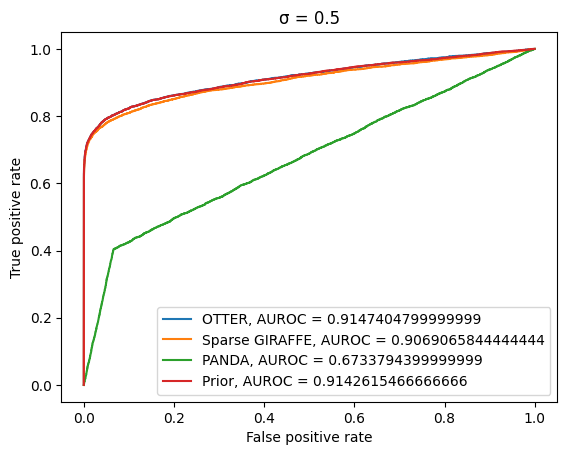

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3980
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0         1          2          3          4          5   \
0     5.715098 -3.116588  -9.343252  -2.318115  10.508764   9.659690   
1     2.702819  0.211148   1.606691   8.305185   7.369199 -11.938012   
2   -15.824754  0.477292  -3.318347  -0.927627  -9.857769  -3.271536   
3     1.224066 -0.046946  -7.811992   5.906348  -6.989982  -3.397158   
4    12.642435  1.532077   7.567991  -1.544723  -5.848698  -8.620395   
..         ...       ...        ...        ...        ...        ...   
495   7.736732  0.628408  13.921370   8.853316  11.592823  15.267299   
496 -10.805838  4.944364   3.227056  11.606249   4.079608  -3.705820   
497 -10.707321  1.704826   7.172989  -1.869321  

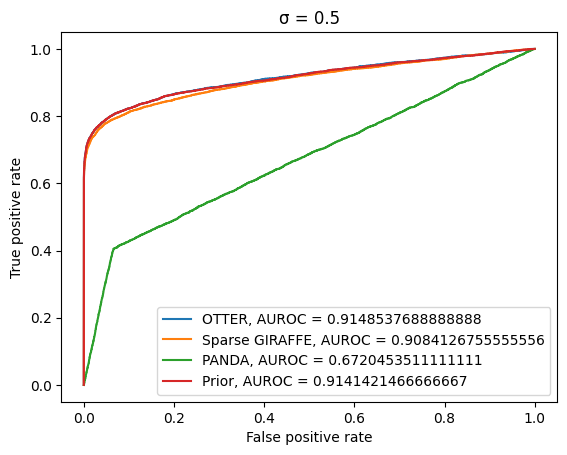

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3854
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0   -12.679914  -4.357700   2.462569  -3.856073  11.675430  10.762654   
1    -7.538588  -6.608152   0.199506 -21.416485  -1.511474   2.730415   
2    -4.086510  -2.336247  -5.351067   4.105024   2.488022   8.550962   
3    13.226818 -10.273130   1.135250   0.825069 -14.455828   0.230007   
4    -7.279039  -4.002050  10.800115  18.483767  -9.624548  -5.126022   
..         ...        ...        ...        ...        ...        ...   
495  -8.012075 -10.513827  -5.305820   8.395111  -7.368815 -16.935813   
496  -6.316568   3.452769   7.591244  -1.726656   7.366380 -10.583098   
497  -4.599318   2.268098  -3.165106  -

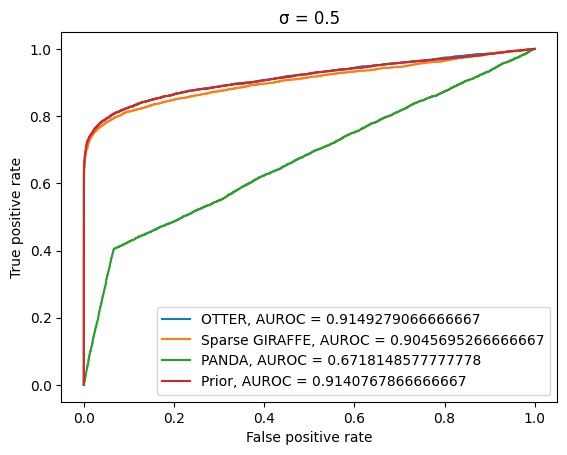

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3818
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0    -7.490056  -3.590035  -0.653852 -10.433992 -12.325156  -5.060600   
1    -2.309802   1.663436  -9.454919  -7.389695  -9.517795  -0.841936   
2     9.285990  -4.401593  -6.710143  -6.835836   8.970409   3.056929   
3    -4.998416  -3.087741  12.264555   2.481466  -3.388661  -0.054499   
4    -9.049801  -4.924026   7.059591   5.964816   0.105855   9.602864   
..         ...        ...        ...        ...        ...        ...   
495 -11.351642  10.040809 -16.489101  -4.932016  -1.727232   4.032609   
496  -9.956336  -6.993282  10.147248   8.729770 -12.932105  15.531708   
497   0.708482  -4.696678   5.735006   

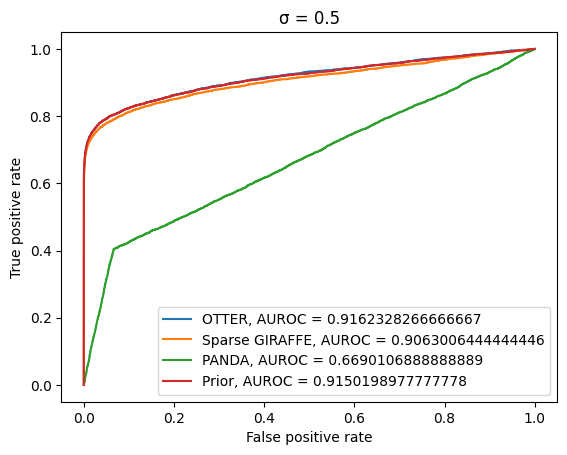

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3896
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3         4          5   \
0     1.244097   1.948539  -2.525848  -6.226553 -6.450567   1.109213   
1     1.185127  -0.096425  14.524181   7.860830 -3.161055  21.964544   
2     3.725921  -1.297346  -3.374980   6.218724  2.325434  13.941106   
3     3.963120   5.992012 -10.213087  16.055413 -2.397313  -0.603128   
4    -8.145572  -3.899114   1.986469  10.162326 -0.391519  -4.596148   
..         ...        ...        ...        ...       ...        ...   
495   7.013212  21.982153   7.765266  -5.654588 -3.276138  -3.178790   
496 -14.276532   2.471835  15.802418   5.534713 -3.755930   3.385848   
497   4.919195  -9.972113  -7.131583   9.912751 

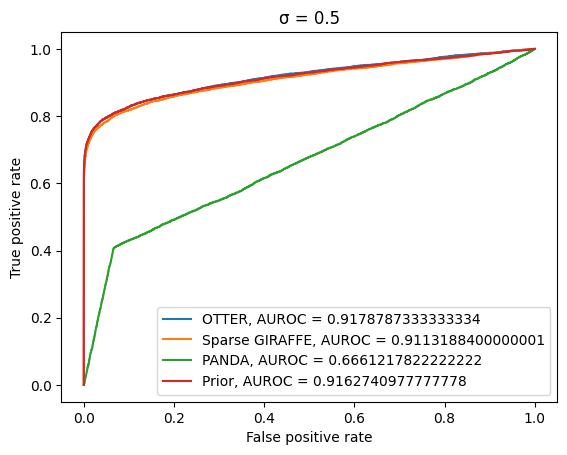

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3946
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0    27.589976 -13.602374 -14.593117   3.547163   5.842046  18.313274   
1    16.387935  -9.524003 -12.456504   4.758471   1.788369  -8.789928   
2    11.545411  17.979685   4.037299  -4.998319  15.616638  12.643540   
3    19.875109  -0.728330 -12.785322   7.508792 -18.613485 -10.877415   
4     3.322722   3.970870  -1.572450 -47.145169  18.002017   6.524749   
..         ...        ...        ...        ...        ...        ...   
495 -21.576982  11.522550   1.290849   1.410687  -4.330030 -10.247455   
496 -33.188487  32.125731  10.725361   9.762377 -40.679225 -37.272316   
497 -21.638992  -8.400407  29.896503  -

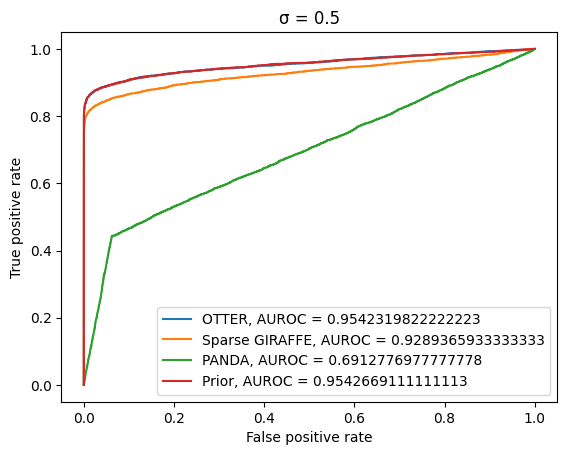

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3824
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0    16.898889 -12.376599   1.778043  42.207377 -32.747006  30.334461   
1    -6.560814  19.923447  -4.226092   6.118783   7.784733  13.244700   
2     8.730883   5.636684 -22.950072  -3.262849   8.910049  -9.801688   
3     8.171636  -9.500872 -10.495311 -17.669621  -7.525654  -4.683062   
4     9.081068  -3.633811  -0.440506   3.709114  -4.114288   1.375107   
..         ...        ...        ...        ...        ...        ...   
495 -24.929674 -16.717793   7.279612   6.370186  41.356238   8.919815   
496  -4.627821   6.590052  -5.578425   6.632589  18.541581 -20.172073   
497 -16.989852  28.562037   0.476459  1

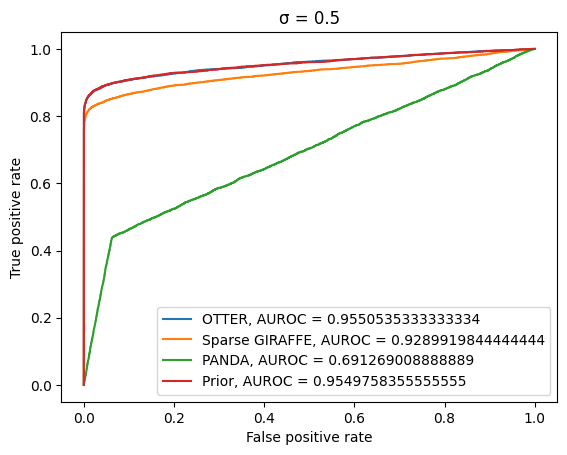

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3958
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.01 sec.
Creating PPI network ...
  Elapsed time: 0.01 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0    -5.928645 -34.407766  18.668095  13.268503  17.756034   9.359089   
1     4.970044   1.852797  19.077877  25.937316 -12.722548   0.476420   
2    -5.784797  40.275752 -37.896507   9.444437  -0.231119   9.333058   
3    12.000338  -7.349274 -22.336117   7.677956 -37.343576 -42.075434   
4   -10.211372   1.142972 -21.804419 -25.912533   3.762569 -11.949207   
..         ...        ...        ...        ...        ...        ...   
495  31.440249 -18.888486  31.548973  18.438696 -39.810765 -29.027185   
496  35.216495  21.653006 -17.116634 -20.244471  12.529398  -8.970174   
497 -10.090364  -9.892689 -12.913177 -5

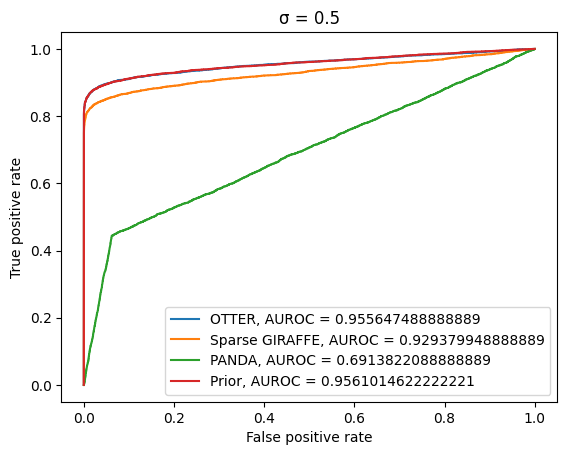

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3910
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0   -11.357571  -7.806253  -3.334401  -2.864375   3.082796  23.197064   
1   -13.181998  -0.636100   9.225970  18.890860 -11.590955  -4.924092   
2     9.243872   9.014228   7.349195   7.157854  14.072053 -26.216368   
3   -13.471034   6.823898 -19.774441  31.057242   3.874648 -10.671062   
4    -9.948021  -2.065524 -16.766047   5.929504  -9.819843  15.223818   
..         ...        ...        ...        ...        ...        ...   
495 -26.244093  30.189495 -38.254097 -41.358847 -17.604698  -4.039549   
496   0.511996  -3.083305  16.413956  10.022040   6.201185   3.910398   
497   9.666467   7.268727 -17.954165 -2

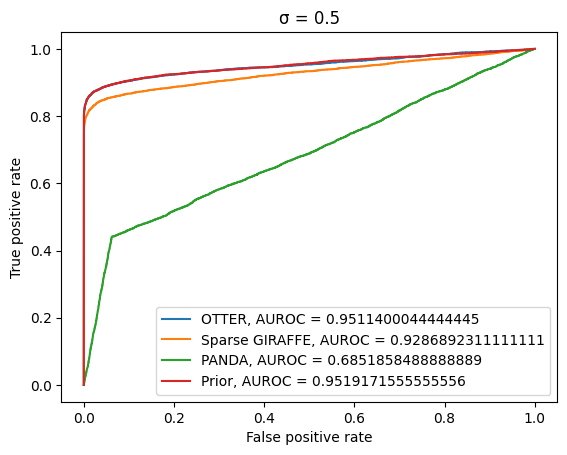

Loading motif data ...
  Elapsed time: 0.00 sec.
Loading PPI data ...
Number of PPIs: 3908
  Elapsed time: 0.00 sec.
Calculating coexpression network ...
  Elapsed time: 0.00 sec.
Creating motif network ...
  Elapsed time: 0.00 sec.
Creating PPI network ...
  Elapsed time: 0.00 sec.
union tmp/motif.txt             0          1          2          3          4          5   \
0     1.361277   0.919849  -0.100843  -6.307050 -26.829909  -4.612908   
1    -3.516437  -8.438839  -6.831903  -7.066704   6.211450 -27.915291   
2     8.838273   4.521447  -3.872687  13.357973  -9.914219   0.567979   
3   -25.341759   3.081903  27.487376   3.243637   3.692721  11.573755   
4    -4.998249  13.935259  -4.884655   4.547663   0.997173  -3.239341   
..         ...        ...        ...        ...        ...        ...   
495   0.044730  -0.812704  14.145245 -12.753491  -2.772478 -19.511629   
496 -13.094980 -49.258317  21.666898  -7.213227 -42.844099  61.177286   
497  28.994952 -34.820741  -4.241272  2

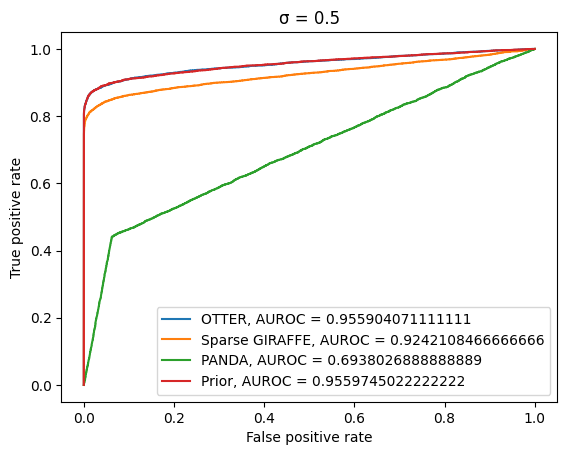

[0.6688548849523809, 0.6654197102399999, 0.6582595918095239, 0.6508563377777777, 0.6867011919999999, 0.8185714693333332, 0.8693705546666667, 0.9075016542222223, 0.928041720888889]
[0.0016719513507148114, 0.0021003931408472617, 0.001543438409930953, 0.0032159294967405443, 0.00442558873037371, 0.0009759592948963919, 0.001531643450150581, 0.0022713331618522295, 0.001928186634700928]
[0.6449516857142857, 0.6488507616, 0.6477507356190475, 0.64644212, 0.6477235226666667, 0.7959719715555555, 0.8620476035555555, 0.915726743111111, 0.954395416]
[0.002037015321749543, 0.0017016385734240722, 0.00119911617859405, 0.001418525670152988, 0.003888757265125478, 0.0020316187337357165, 0.0013247311343388213, 0.001204999673337723, 0.0017263406490938633]
[0.5528760323809523, 0.5512531228800001, 0.5440505904761904, 0.5414831955555555, 0.5524970631111111, 0.6141913973333333, 0.6455119048888889, 0.6704744239999999, 0.6905834906666668]
[0.0016954753613072774, 0.0025367784010793745, 0.0007725970866604037, 0.004

In [137]:
B = 50
sparsities = [.3, .5, .7, .9]
a = [1, 2, 3, 5, 10]

giraffe_scores = []
otter_scores = []
panda_scores = []
prior_scores = []
sign_scores = []

for sparsity in sparsities:
    giraffe_s = []
    otter_s = []
    panda_s = []
    prior_s = []
    sign_scores_new = []
    for i in range(B):
        score, sign_score = simulation(noise = .5, sparsity=sparsity)
        otter_s.append(score[0])
        giraffe_s.append(score[1])
        panda_s.append(score[2])
        prior_s.append(score[3])
        sign_scores_new.append(sign_score)
    giraffe_scores.append(giraffe_s)
    otter_scores.append(otter_s)
    panda_scores.append(panda_s)
    prior_scores.append(prior_s)
    sign_scores.append(sign_scores_new)
for start in a:
    giraffe_s = []
    otter_s = []
    panda_s = []
    prior_s = []
    sign_scores_new = []
    for i in range(B):
        score, sign_score = simulation(noise = .5, a = start)
        otter_s.append(score[0])
        giraffe_s.append(score[1])
        panda_s.append(score[2])
        prior_s.append(score[3])
        sign_scores_new.append(sign_score)
    giraffe_scores.append(giraffe_s)
    otter_scores.append(otter_s)
    panda_scores.append(panda_s)
    prior_scores.append(prior_s)
    sign_scores.append(sign_scores_new)

giraffe_mean = []
giraffe_sd = []
for l in giraffe_scores:
    giraffe_mean.append(np.mean(l))
    giraffe_sd.append(np.std(l))
print(giraffe_mean)
print(giraffe_sd)

otter_mean = []
otter_sd = []
for l in otter_scores:
    otter_mean.append(np.mean(l))
    otter_sd.append(np.std(l))
print(otter_mean)
print(otter_sd)

panda_mean = []
panda_sd = []
for l in panda_scores:
    panda_mean.append(np.mean(l))
    panda_sd.append(np.std(l))
print(panda_mean)
print(panda_sd)

prior_mean = []
prior_sd = []
for l in prior_scores:
    prior_mean.append(np.mean(l))
    prior_sd.append(np.std(l))
print(prior_mean)
print(prior_sd)

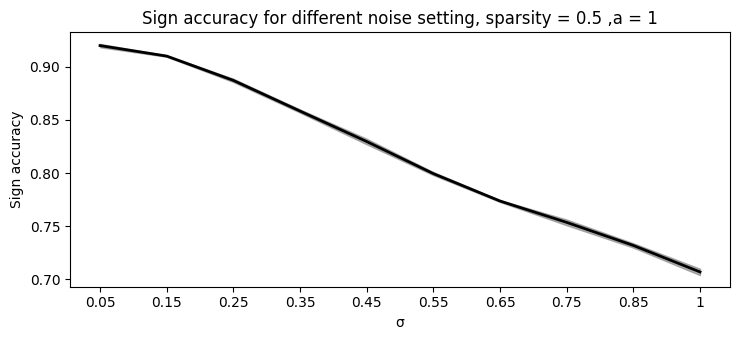

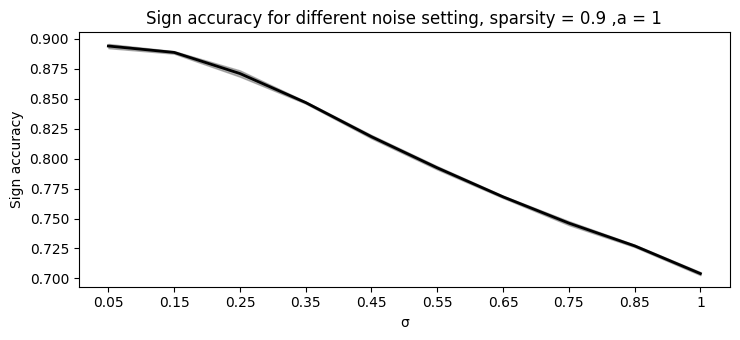

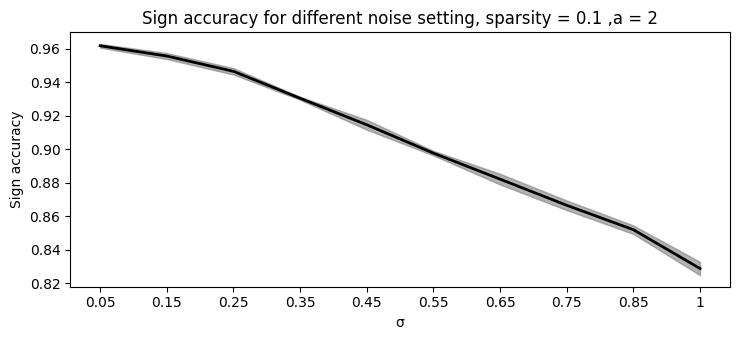

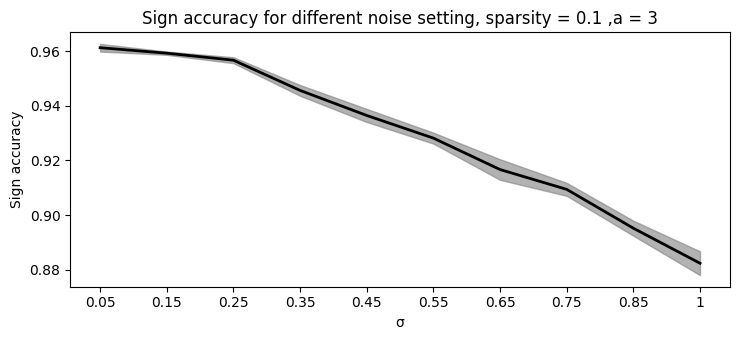

In [141]:
def simul_sign_score(sparsity, a, noise=.5):
    B = 50
    noises = [.05, .15, .25, .35, .45, .55, .65, .75, .85, 1]
    sign_scores = []
    for noise in noises:
        res = []
        for i in range(B):
            R = generate_regulation(G, TF, sparsity, a)
            ppi = generate_ppi(R.copy())
            motif = generate_motif(R, noise)
            expression = generate_expression(R.dot(R.T))

            giraffe_regulation = giraffe.Giraffe(expression, motif, ppi, lam = [0.000001, 5, 50, 1, 1], regularization = 1e-6).get_regulation() # Given the generation process, we assign higher weight to the agreement with the covariance matrix. 
            sign_accuracy = notebooks.utils.get_sign_accuracy(R, giraffe_regulation)
            res.append(sign_accuracy)
        sign_scores.append(res)
    
    plt.rcParams["figure.figsize"] = [7.50, 3.50]
    plt.rcParams["figure.autolayout"] = True

    means = np.array([np.mean(l) for l in sign_scores])

    plt.plot(means, color='black', lw=2)

    plt.fill_between(range(len(means)), means + np.array([np.std(l) for l in sign_scores]), means - np.array([np.std(l) for l in sign_scores]), alpha=.6, color='gray')
    plt.title("Sign accuracy for different noise setting, sparsity = " + str(sparsity) + " ,a = " + str(a))
    plt.xlabel("\u03C3")
    plt.xticks(range(len(means)), [.05, .15, .25, .35, .45, .55, .65, .75, .85, 1])
    plt.ylabel("Sign accuracy")
    plt.show()

simul_sign_score(.5, 1)
simul_sign_score(.9, 1)
simul_sign_score(.1, 2)
simul_sign_score(.1, 3)

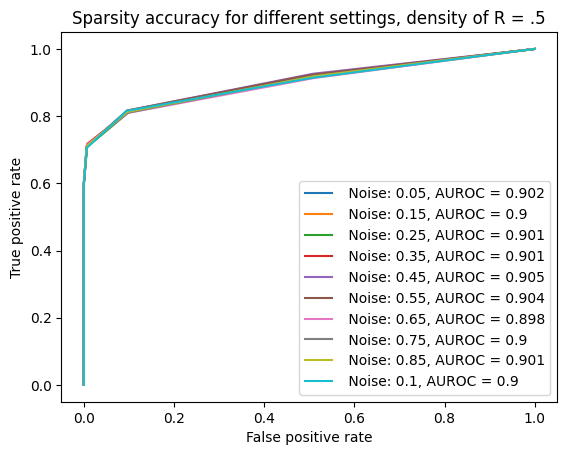

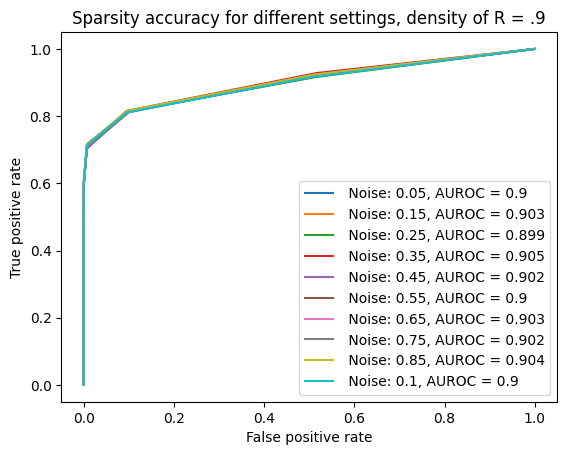

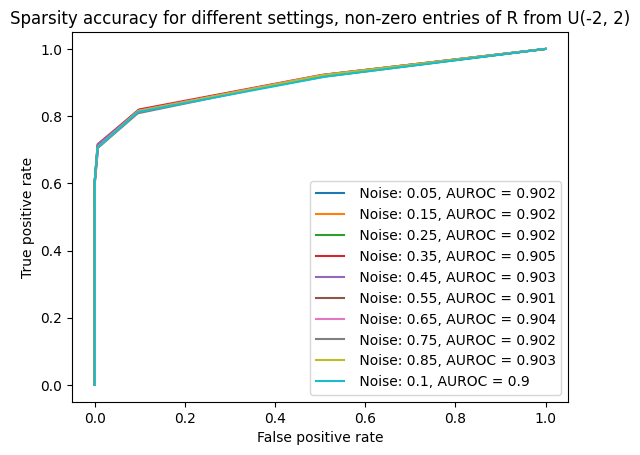

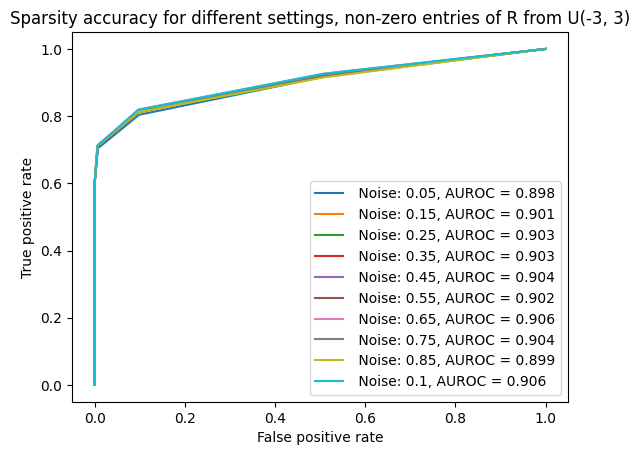

In [12]:
def sparsity_simulation(sparsity = .1, a = 1, noise = .01):
    R = generate_regulation(G, TF, .1, .1)
    ppi = generate_ppi(R.copy())
    motif = generate_motif(R, .01)
    expression = generate_expression(R.dot(R.T))
    B = 1000

    relevance = np.zeros((G, TF))
    lambdas_ = np.linspace(5e-8, 1e-4, B) # The limit values are regularization parameters that set R_hat to 0 or 1
    for l in lambdas_:
        par = giraffe.Giraffe(expression, motif, ppi, lam = [0.000001, 5, 50, 1, 1], regularization = l).get_regulation()
        par[par != 0] = 1
        relevance = relevance + par
    relevance = relevance / B
    R[R != 0] = 1
    fpr, tpr, _ = roc_curve(R.flatten(), relevance.flatten())
    auc_score = auc(fpr, tpr)
    plt.plot(fpr, tpr, label= " Noise: " + str(noise) + ", AUROC = " + str(round(auc_score, 3)))

    
noises = [.05, .15, .25, .35, .45, .55, .65, .75, .85, .1]

for noise in noises:
    sparsity_simulation(sparsity = .5, noise = noise)
plt.legend(loc='lower right')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title("Sparsity accuracy for different settings, density of R = .5")
plt.show()

for noise in noises:
    sparsity_simulation(sparsity = .9, noise = noise)
plt.legend(loc='lower right')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title("Sparsity accuracy for different settings, density of R = .9")
plt.show()

for noise in noises:
    sparsity_simulation(noise = noise, a = 2)
plt.legend(loc='lower right')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title("Sparsity accuracy for different settings, non-zero entries of R from U(-2, 2)")
plt.show()

for noise in noises:
    sparsity_simulation(noise = noise, a = 3)
plt.legend(loc='lower right')
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title("Sparsity accuracy for different settings, non-zero entries of R from U(-3, 3)")
plt.show()

## References

[1] Glass K, Huttenhower C, Quackenbush J, Yuan GC. "Passing Messages Between Biological Networks to Refine Predicted Interactions", PLoS One, 2013 May 31;8(5):e64832

[2] Weighill, Deborah, et al. "Gene regulatory network inference as relaxed graph matching." Proceedings of the... AAAI Conference on Artificial Intelligence. AAAI Conference on Artificial Intelligence. Vol. 35. No. 11. NIH Public Access, 2021.